In [1]:
import numpy as np
from numpy import genfromtxt
from itertools import combinations
import torch
import math 
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt

In [2]:
#data = genfromtxt('small_file_correct_coord.txt', delimiter=',')
#data = genfromtxt('test_output_false_negative.txt', delimiter=',')
#data = genfromtxt('small_file.txt', delimiter=',')
data = genfromtxt('raw_data_test.txt',delimiter=',') ## raw not preclustered data
data[:,4] =(data[:,4]-np.min(data[:,4]))/(np.max(data[:,4])-np.min(data[:,4]))
print(data)

[[0.00000000e+00 4.88235000e-01 6.30803000e+01 3.56992000e+02
  2.89123963e-01]
 [2.00000000e+00 1.29252000e+00 3.96377000e+01 6.41817000e+01
  9.28225006e-01]
 [2.00000000e+00 4.22443000e-01 4.21854000e+01 6.42001000e+01
  9.03797111e-01]
 ...
 [2.41930000e+04 2.97576000e-01 5.81655000e+01 1.83020000e+02
  5.09072751e-01]
 [2.41930000e+04 1.22752000e-01 6.06847000e+01 1.77050000e+02
  4.95073066e-01]
 [2.41950000e+04 1.47413000e+00 7.62503000e+01 2.73345000e+02
  5.83929863e-01]]


#### this step is only needed if you use non preclustered input data

In [3]:
unique_values, continuous_numbers = np.unique(data[:,0], return_inverse=True)
data[:,0] = continuous_numbers
data[:,2] = data[:,2]*math.pi/180.
data[:,3] = data[:,3]*math.pi/180.
print(continuous_numbers)
print(data)


[   0    1    1 ... 8857 8857 8858]
[[0.00000000e+00 4.88235000e-01 1.10095893e+00 6.23068580e+00
  2.89123963e-01]
 [1.00000000e+00 1.29252000e+00 6.91808373e-01 1.12018198e+00
  9.28225006e-01]
 [1.00000000e+00 4.22443000e-01 7.36274126e-01 1.12050313e+00
  9.03797111e-01]
 ...
 [8.85700000e+03 2.97576000e-01 1.01517949e+00 3.19430160e+00
  5.09072751e-01]
 [8.85700000e+03 1.22752000e-01 1.05914782e+00 3.09010544e+00
  4.95073066e-01]
 [8.85800000e+03 1.47413000e+00 1.33081879e+00 4.77077024e+00
  5.83929863e-01]]


#### end of manipulation

In [4]:
ll = []
true_vals = []
print(int(np.min(data,axis=0)[0]))
print(int(np.max(data,axis=0)[0]))

for i in range(int(np.min(data,axis=0)[0]),int(np.max(data,axis=0)[0])+1,3):
    print(i)
    mask = ((data[:,0] == i) | (data[:,0] == i+1) | (data[:,0] == i+2))
    print("This is mask:")
    print(mask)
    evt = data[mask]
    #print(evt)
    #print(evt.shape[0])
    pair_indices = list(combinations(range(evt.shape[0]), 2))
    print("pair indices...")
    print(pair_indices)
    for i, (idx1, idx2) in enumerate(pair_indices):
        l = []
        print("this are the pairs to be compared")
        print(evt[idx1,1:])
        print(evt[idx2,1:])
        ### this is the new stuff....
        time_diff = abs(evt[idx1,4]-evt[idx2,4])
        ene_diff = abs(evt[idx1,1]-evt[idx2,1])
        min_theta = evt[idx1,2] if evt[idx2,2] > evt[idx1,2] else evt[idx2,2]
        max_theta = evt[idx2,2] if evt[idx2,2] > evt[idx1,2] else evt[idx1,2]
        theta_diff = abs(max_theta-min_theta) if (abs(max_theta-min_theta) < abs(max_theta-(min_theta+math.pi))) else abs(max_theta-(min_theta+math.pi)) 
        min_phi = evt[idx1,3] if evt[idx2,3] > evt[idx1,3] else evt[idx2,3]
        max_phi = evt[idx2,3] if evt[idx2,3] > evt[idx1,3] else evt[idx1,3]
        phi_diff = abs(max_phi-min_phi) if (abs(max_phi-min_phi) < abs(max_phi-(min_phi+math.pi))) else abs(max_phi-(min_phi+math.pi))
        #print("energy diff",ene_diff)
        #print("time_diff\t",time_diff)
        #print("theta_diff\t",theta_diff)
        #print("phi_diff\t",phi_diff)
        diff_arr = np.array([ene_diff,theta_diff,phi_diff,time_diff])
        #print("diff_arr\t",diff_arr)
        test_np = np.concatenate((evt[idx1,1:],evt[idx2,1:]))
        #print("fooooo", test_np)
        test_np = np.concatenate((test_np,diff_arr))
        #print("final_arr:\t",test_np)
        l.append(np.concatenate((evt[idx1,1:],evt[idx2,1:],diff_arr)))
        ### end of new stuff
        #l.append(np.concatenate((evt[idx1,1:],evt[idx2,1:])))
        print(l)
        ll.append(l)
        if (evt[idx1,0] == evt[idx2,0]):
            true_vals.append(1)
        else:
            true_vals.append(0)
#print(ll)
input_data = torch.FloatTensor(ll)
input_data = torch.squeeze(input_data)
input_data.shape
truth_class = torch.FloatTensor(true_vals)
print(input_data.shape)
print(truth_class.shape)

0
8858
0
This is mask:
[ True  True  True ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
this are the pairs to be compared
[0.488235   1.10095893 6.2306858  0.28912396]
[1.29252    0.69180837 1.12018198 0.92822501]
[array([0.488235  , 1.10095893, 6.2306858 , 0.28912396, 1.29252   ,
       0.69180837, 1.12018198, 0.92822501, 0.804285  , 0.40915056,
       1.96891117, 0.63910104])]
this are the pairs to be compared
[0.488235   1.10095893 6.2306858  0.28912396]
[0.422443   0.73627413 1.12050313 0.90379711]
[array([0.488235  , 1.10095893, 6.2306858 , 0.28912396, 0.422443  ,
       0.73627413, 1.12050313, 0.90379711, 0.065792  , 0.3646848 ,
       1.96859002, 0.61467315])]
this are the pairs to be compared
[0.488235   1.10095893 6.2306858  0.28912396]
[0.417604   0.73593553 1.2

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[2.12472    1.23776133 2.41316204 0.12802326]
[1.2108     1.05776727 5.25534346 0.50901488]
[array([2.12472   , 1.23776133, 2.41316204, 0.12802326, 1.2108    ,
       1.05776727, 5.25534346, 0.50901488, 0.91392   , 0.17999406,
       0.29941123, 0.38099161])]
this are the pairs to be compared
[2.12472    1.23776133 2.41316204 0.12802326]
[0.881784   1.01380242 5.25384247 0.52760567]
[array([2.12472   , 1.23776133, 2.41316204, 0.12802326, 0.881784  ,
       1.01380242, 5.25384247, 0.52760567, 1.242936  , 0.2239589 ,
       0.30091222, 0.3995824 ])]
this are the pairs to be compared
[2.12472    1.23776133 2.41316204 0.12802326]
[1.67736    1.05700805 1.31612486 0.84717468]
[array([2.12472   , 1.23776133, 2.41316204, 0.12802326, 1.67736   ,
       1.05700805, 1.31612486, 0.84717468, 0.44736   , 0.18075328,
       1.09703717, 0.71915141])]
this are the pairs to

       1.87902671, 0.02097935])]
this are the pairs to be compared
[1.27284    1.28195132 1.11904752 0.58030342]
[1.53399    0.97226184 1.62915141 0.12143819]
[array([1.27284   , 1.28195132, 1.11904752, 0.58030342, 1.53399   ,
       0.97226184, 1.62915141, 0.12143819, 0.26115   , 0.30968948,
       0.51010389, 0.45886523])]
this are the pairs to be compared
[1.27284    1.28195132 1.11904752 0.58030342]
[0.454826   0.97225835 1.51245695 0.21493878]
[array([1.27284   , 1.28195132, 1.11904752, 0.58030342, 0.454826  ,
       0.97225835, 1.51245695, 0.21493878, 0.818014  , 0.30969297,
       0.39340943, 0.36536464])]
this are the pairs to be compared
[1.27284    1.28195132 1.11904752 0.58030342]
[0.113902   1.01250739 1.63016719 0.18345975]
[array([1.27284   , 1.28195132, 1.11904752, 0.58030342, 0.113902  ,
       1.01250739, 1.63016719, 0.18345975, 1.158938  , 0.26944393,
       0.51111967, 0.39684367])]
this are the pairs to be compared
[0.821147   1.33152216 1.0278052  0.57567593]
[2.10

[0.155214   1.05801336 4.06614592 0.81016742]
[0.67042    0.61010427 6.23257076 0.76354021]
[array([0.155214  , 1.05801336, 4.06614592, 0.81016742, 0.67042   ,
       0.61010427, 6.23257076, 0.76354021, 0.515206  , 0.44790908,
       0.97516781, 0.04662722])]
this are the pairs to be compared
[0.139097   1.0996796  5.25422645 0.82851022]
[1.50109    0.56901399 6.23246604 0.74362198]
[array([0.139097  , 1.0996796 , 5.25422645, 0.82851022, 1.50109   ,
       0.56901399, 6.23246604, 0.74362198, 1.361993  , 0.53066561,
       0.97823959, 0.08488825])]
this are the pairs to be compared
[0.139097   1.0996796  5.25422645 0.82851022]
[0.67042    0.61010427 6.23257076 0.76354021]
[array([0.139097  , 1.0996796 , 5.25422645, 0.82851022, 0.67042   ,
       0.61010427, 6.23257076, 0.76354021, 0.531323  , 0.48957533,
       0.97834431, 0.06497002])]
this are the pairs to be compared
[1.50109    0.56901399 6.23246604 0.74362198]
[0.67042    0.61010427 6.23257076 0.76354021]
[array([1.50109000e+00, 5.

[1.23494    1.47453269 5.05916845 0.20327733]
[array([1.1249    , 1.01478853, 5.7504061 , 0.63611429, 1.23494   ,
       1.47453269, 5.05916845, 0.20327733, 0.11004   , 0.45974416,
       0.69123765, 0.43283696])]
this are the pairs to be compared
[1.1249     1.01478853 5.7504061  0.63611429]
[0.919151   1.42789226 5.05951752 0.22207744]
[array([1.1249    , 1.01478853, 5.7504061 , 0.63611429, 0.919151  ,
       1.42789226, 5.05951752, 0.22207744, 0.205749  , 0.41310373,
       0.69088858, 0.41403685])]
this are the pairs to be compared
[0.535957   1.05859106 5.64627976 0.63939206]
[0.517092   0.974817   5.84142502 0.60643552]
[array([0.535957  , 1.05859106, 5.64627976, 0.63939206, 0.517092  ,
       0.974817  , 5.84142502, 0.60643552, 0.018865  , 0.08377406,
       0.19514526, 0.03295654])]
this are the pairs to be compared
[0.535957   1.05859106 5.64627976 0.63939206]
[1.68448    0.85080787 1.82688849 0.16002087]
[array([0.535957  , 1.05859106, 5.64627976, 0.63939206, 1.68448   ,
    

[0.611208   0.77580409 5.35784664 0.5878494 ]
[1.58355    1.47482416 2.50433804 0.91782608]
[array([0.611208  , 0.77580409, 5.35784664, 0.5878494 , 1.58355   ,
       1.47482416, 2.50433804, 0.91782608, 0.972342  , 0.69902007,
       0.28808405, 0.32997669])]
this are the pairs to be compared
[0.611208   0.77580409 5.35784664 0.5878494 ]
[0.277668   1.37775768 2.50428568 0.91165018]
[array([0.611208  , 0.77580409, 5.35784664, 0.5878494 , 0.277668  ,
       1.37775768, 2.50428568, 0.91165018, 0.33354   , 0.60195359,
       0.28803169, 0.32380079])]
this are the pairs to be compared
[0.611208   0.77580409 5.35784664 0.5878494 ]
[0.248334   1.33187297 2.41237664 0.93155638]
[array([0.611208  , 0.77580409, 5.35784664, 0.5878494 , 0.248334  ,
       1.33187297, 2.41237664, 0.93155638, 0.362874  , 0.55606888,
       0.19612265, 0.34370698])]
this are the pairs to be compared
[1.58355    1.47482416 2.50433804 0.91782608]
[0.277668   1.37775768 2.50428568 0.91165018]
[array([1.58355000e+00, 1.

       0.10251366, 0.44205968])]
this are the pairs to be compared
[0.665488   0.81558887 0.83236672 0.8431081 ]
[0.51498    0.81582274 0.72901356 0.85229373]
[array([6.65488000e-01, 8.15588869e-01, 8.32366719e-01, 8.43108102e-01,
       5.14980000e-01, 8.15822743e-01, 7.29013557e-01, 8.52293726e-01,
       1.50508000e-01, 2.33874120e-04, 1.03353162e-01, 9.18562378e-03])]
this are the pairs to be compared
[0.665488   0.81558887 0.83236672 0.8431081 ]
[2.16149    1.05822803 3.97390527 0.45687439]
[array([6.65488000e-01, 8.15588869e-01, 8.32366719e-01, 8.43108102e-01,
       2.16149000e+00, 1.05822803e+00, 3.97390527e+00, 4.56874393e-01,
       1.49600200e+00, 2.42639163e-01, 5.41052068e-05, 3.86233708e-01])]
this are the pairs to be compared
[0.51498    0.81582274 0.72901356 0.85229373]
[2.16149    1.05822803 3.97390527 0.45687439]
[array([0.51498   , 0.81582274, 0.72901356, 0.85229373, 2.16149   ,
       1.05822803, 3.97390527, 0.45687439, 1.64651   , 0.24240529,
       0.10329906, 0.3

[0.719139   1.28291299 2.99936577 0.46421589]
[array([2.08881   , 1.09871967, 1.42085858, 0.4424171 , 0.719139  ,
       1.28291299, 2.99936577, 0.46421589, 1.369671  , 0.18419332,
       1.56308546, 0.02179879])]
this are the pairs to be compared
[2.08881    1.09871967 1.42085858 0.4424171 ]
[0.555221   1.37796362 2.89468092 0.39626788]
[array([2.08881   , 1.09871967, 1.42085858, 0.4424171 , 0.555221  ,
       1.37796362, 2.89468092, 0.39626788, 1.533589  , 0.27924395,
       1.47382234, 0.04614923])]
this are the pairs to be compared
[2.08881    1.09871967 1.42085858 0.4424171 ]
[0.544417   1.33224472 2.99795206 0.46078036]
[array([2.08881   , 1.09871967, 1.42085858, 0.4424171 , 0.544417  ,
       1.33224472, 2.99795206, 0.46078036, 1.544393  , 0.23352505,
       1.56449918, 0.01836326])]
this are the pairs to be compared
[2.08881    1.09871967 1.42085858 0.4424171 ]
[0.363514   1.42847869 2.89504744 0.42866624]
[array([2.08881   , 1.09871967, 1.42085858, 0.4424171 , 0.363514  ,
    

[1.25738    1.47491317 3.47997709 0.73704784]
[0.495951   1.47483463 3.58357983 0.74934822]
[array([1.25738000e+00, 1.47491317e+00, 3.47997709e+00, 7.37047844e-01,
       4.95951000e-01, 1.47483463e+00, 3.58357983e+00, 7.49348221e-01,
       7.61429000e-01, 7.85398163e-05, 1.03602744e-01, 1.23003773e-02])]
this are the pairs to be compared
[1.25738    1.47491317 3.47997709 0.73704784]
[2.23049    1.42820293 5.45087269 0.66984597]
[array([1.25738   , 1.47491317, 3.47997709, 0.73704784, 2.23049   ,
       1.42820293, 5.45087269, 0.66984597, 0.97311   , 0.04671025,
       1.17069705, 0.06720187])]
this are the pairs to be compared
[0.495951   1.47483463 3.58357983 0.74934822]
[2.23049    1.42820293 5.45087269 0.66984597]
[array([0.495951  , 1.47483463, 3.58357983, 0.74934822, 2.23049   ,
       1.42820293, 5.45087269, 0.66984597, 1.734539  , 0.04663171,
       1.27429979, 0.07950225])]
114
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0,

       1.17177915, 0.19269603])]
this are the pairs to be compared
[1.35118    0.8141769  4.96717214 0.65249219]
[0.415157   0.69394466 3.09101301 0.47000209]
[array([1.35118   , 0.8141769 , 4.96717214, 0.65249219, 0.415157  ,
       0.69394466, 3.09101301, 0.47000209, 0.936023  , 0.12023224,
       1.26543352, 0.1824901 ])]
this are the pairs to be compared
[1.35118    0.8141769  4.96717214 0.65249219]
[0.140181   0.69391149 2.99720156 0.46924829]
[array([1.35118   , 0.8141769 , 4.96717214, 0.65249219, 0.140181  ,
       0.69391149, 2.99720156, 0.46924829, 1.210999  , 0.1202654 ,
       1.17162207, 0.18324389])]
this are the pairs to be compared
[1.35118    0.8141769  4.96717214 0.65249219]
[1.77047    0.9314351  0.8332324  0.70888159]
[array([1.35118   , 0.8141769 , 4.96717214, 0.65249219, 1.77047   ,
       0.9314351 , 0.8332324 , 0.70888159, 0.41929   , 0.1172582 ,
       0.99234709, 0.0563894 ])]
this are the pairs to be compared
[1.35118    0.8141769  4.96717214 0.65249219]
[0.33

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.79855    1.19023252 5.84022074 0.4767039 ]
[0.29613    1.14686632 5.84109341 0.45118644]
[array([1.79855000e+00, 1.19023252e+00, 5.84022074e+00, 4.76703897e-01,
       2.96130000e-01, 1.14686632e+00, 5.84109341e+00, 4.51186440e-01,
       1.50242000e+00, 4.33661959e-02, 8.72664626e-04, 2.55174572e-02])]
this are the pairs to be compared
[1.79855    1.19023252 5.84022074 0.4767039 ]
[1.69378    1.19013653 5.75054573 0.13171458]
[array([1.79855000e+00, 1.19023252e+00, 5.84022074e+00, 4.76703897e-01,
       1.69378000e+00, 1.19013653e+00, 5.75054573e+00, 1.31714580e-01,
       1.04770000e-01, 9.59931089e-05, 8.96750170e-02, 3.44989317e-01])]
this are the pairs to be compared
[1.79855    1.19023252 5.84022074 0.4767039 ]
[0.476125   1.19000737 5.64497076 0.1108707

[0.920591   0.61010777 3.19206758 0.95161684]
[0.384925   1.28283096 2.80423796 0.69124663]
[array([0.920591  , 0.61010777, 3.19206758, 0.95161684, 0.384925  ,
       1.28283096, 2.80423796, 0.69124663, 0.535666  , 0.6727232 ,
       0.38782961, 0.2603702 ])]
this are the pairs to be compared
[0.920591   0.61010777 3.19206758 0.95161684]
[1.66723    1.18853257 1.7205386  0.78023537]
[array([0.920591  , 0.61010777, 3.19206758, 0.95161684, 1.66723   ,
       1.18853257, 1.7205386 , 0.78023537, 0.746639  , 0.5784248 ,
       1.47152898, 0.17138146])]
this are the pairs to be compared
[0.920591   0.61010777 3.19206758 0.95161684]
[0.424017   1.23635808 1.62995252 0.75124749]
[array([0.920591  , 0.61010777, 3.19206758, 0.95161684, 0.424017  ,
       1.23635808, 1.62995252, 0.75124749, 0.496574  , 0.62625032,
       1.56211506, 0.20036935])]
this are the pairs to be compared
[0.503337   0.56897908 2.99758554 0.94121135]
[0.311781   0.65367991 3.28570449 0.92282369]
[array([0.503337  , 0.5689

[0.414171   1.33217491 2.80285915 0.68176671]
[0.424017   1.23635808 1.62995252 0.75124749]
[array([0.414171  , 1.33217491, 2.80285915, 0.68176671, 0.424017  ,
       1.23635808, 1.62995252, 0.75124749, 0.009846  , 0.09581683,
       1.17290664, 0.06948078])]
this are the pairs to be compared
[0.384925   1.28283096 2.80423796 0.69124663]
[1.66723    1.18853257 1.7205386  0.78023537]
[array([0.384925  , 1.28283096, 2.80423796, 0.69124663, 1.66723   ,
       1.18853257, 1.7205386 , 0.78023537, 1.282305  , 0.09429839,
       1.08369937, 0.08898874])]
this are the pairs to be compared
[0.384925   1.28283096 2.80423796 0.69124663]
[0.424017   1.23635808 1.62995252 0.75124749]
[array([0.384925  , 1.28283096, 2.80423796, 0.69124663, 0.424017  ,
       1.23635808, 1.62995252, 0.75124749, 0.039092  , 0.04647288,
       1.17428545, 0.06000085])]
this are the pairs to be compared
[1.66723    1.18853257 1.7205386  0.78023537]
[0.424017   1.23635808 1.62995252 0.75124749]
[array([1.66723   , 1.1885

       1.21712281, 0.62134574])]
this are the pairs to be compared
[0.373472   0.97411887 2.30915787 0.69517645]
[0.360282   0.89247411 2.11282578 0.69819712]
[array([0.373472  , 0.97411887, 2.30915787, 0.69517645, 0.360282  ,
       0.89247411, 2.11282578, 0.69819712, 0.01319   , 0.08164476,
       0.19633209, 0.00302067])]
this are the pairs to be compared
[0.373472   0.97411887 2.30915787 0.69517645]
[0.177836   0.9309848  2.11134225 0.71212872]
[array([0.373472  , 0.97411887, 2.30915787, 0.69517645, 0.177836  ,
       0.9309848 , 2.11134225, 0.71212872, 0.195636  , 0.04313407,
       0.19781562, 0.01695227])]
this are the pairs to be compared
[0.373472   0.97411887 2.30915787 0.69517645]
[0.145201   0.97390594 2.21689976 0.70841334]
[array([3.73472000e-01, 9.74118870e-01, 2.30915787e+00, 6.95176453e-01,
       1.45201000e-01, 9.73905940e-01, 2.21689976e+00, 7.08413336e-01,
       2.28271000e-01, 2.12930169e-04, 9.22581043e-02, 1.32368821e-02])]
this are the pairs to be compared
[0.

[0.536772   1.18935811 5.25396465 0.51448128]
[0.325595   1.28209094 5.25382502 0.46619612]
[array([5.36772000e-01, 1.18935811e+00, 5.25396465e+00, 5.14481285e-01,
       3.25595000e-01, 1.28209094e+00, 5.25382502e+00, 4.66196117e-01,
       2.11177000e-01, 9.27328338e-02, 1.39626340e-04, 4.82851679e-02])]
this are the pairs to be compared
[0.536772   1.18935811 5.25396465 0.51448128]
[0.243993   1.23746811 5.35927781 0.47198746]
[array([0.536772  , 1.18935811, 5.25396465, 0.51448128, 0.243993  ,
       1.23746811, 5.35927781, 0.47198746, 0.292779  , 0.04811   ,
       0.10531317, 0.04249383])]
this are the pairs to be compared
[0.325595   1.28209094 5.25382502 0.46619612]
[0.243993   1.23746811 5.35927781 0.47198746]
[array([0.325595  , 1.28209094, 5.25382502, 0.46619612, 0.243993  ,
       1.23746811, 5.35927781, 0.47198746, 0.081602  , 0.04462283,
       0.10545279, 0.00579134])]
189
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0,

[2.08054    1.33165306 2.21689976 0.06557503]
[0.217876   0.8144736  1.22371666 0.81433574]
[array([2.08054   , 1.33165306, 2.21689976, 0.06557503, 0.217876  ,
       0.8144736 , 1.22371666, 0.81433574, 1.862664  , 0.51717945,
       0.9931831 , 0.74876072])]
this are the pairs to be compared
[1.70116    1.42771423 4.86348213 0.66987551]
[0.36851    1.42757461 4.77085751 0.68614181]
[array([1.70116000e+00, 1.42771423e+00, 4.86348213e+00, 6.69875508e-01,
       3.68510000e-01, 1.42757461e+00, 4.77085751e+00, 6.86141808e-01,
       1.33265000e+00, 1.39626340e-04, 9.26246234e-02, 1.62662999e-02])]
this are the pairs to be compared
[1.70116    1.42771423 4.86348213 0.66987551]
[1.64892    0.81416817 1.31603934 0.83092698]
[array([1.70116   , 1.42771423, 4.86348213, 0.66987551, 1.64892   ,
       0.81416817, 1.31603934, 0.83092698, 0.05224   , 0.61354606,
       0.40585014, 0.16105147])]
this are the pairs to be compared
[1.70116    1.42771423 4.86348213 0.66987551]
[0.253618   0.81478253 1

[0.33624    1.18955359 2.21813895 0.81673608]
[array([1.85204000e+00, 1.19044719e+00, 3.08888371e+00, 5.07659974e-02,
       3.36240000e-01, 1.18955359e+00, 2.21813895e+00, 8.16736084e-01,
       1.51580000e+00, 8.93608577e-04, 8.70744764e-01, 7.65970087e-01])]
this are the pairs to be compared
[1.85204    1.19044719 3.08888371 0.050766  ]
[2.23767    1.10093624 0.14258066 0.39226421]
[array([1.85204   , 1.19044719, 3.08888371, 0.050766  , 2.23767   ,
       1.10093624, 0.14258066, 0.39226421, 0.38563   , 0.08951096,
       0.1952896 , 0.34149821])]
this are the pairs to be compared
[0.274348   1.23829714 3.08938986 0.03711228]
[1.78644    1.14589941 2.11329702 0.8606796 ]
[array([0.274348  , 1.23829714, 3.08938986, 0.03711228, 1.78644   ,
       1.14589941, 2.11329702, 0.8606796 , 1.512092  , 0.09239773,
       0.97609284, 0.82356732])]
this are the pairs to be compared
[0.274348   1.23829714 3.08938986 0.03711228]
[0.33624    1.18955359 2.21813895 0.81673608]
[array([0.274348  , 1.23

[1.88834    1.05843573 2.41253372 0.50791789]
[1.2182     0.65371656 3.09092575 0.66181566]
[array([1.88834   , 1.05843573, 2.41253372, 0.50791789, 1.2182    ,
       0.65371656, 3.09092575, 0.66181566, 0.67014   , 0.40471916,
       0.67839203, 0.15389777])]
this are the pairs to be compared
[1.88834    1.05843573 2.41253372 0.50791789]
[0.872306   0.73833187 3.19210248 0.6514605 ]
[array([1.88834   , 1.05843573, 2.41253372, 0.50791789, 0.872306  ,
       0.73833187, 3.19210248, 0.6514605 , 1.016034  , 0.32010386,
       0.77956876, 0.14354261])]
this are the pairs to be compared
[0.271325   1.05859106 2.5046871  0.5604039 ]
[1.4687     0.97390419 0.9247086  0.82206738]
[array([0.271325  , 1.05859106, 2.5046871 , 0.5604039 , 1.4687    ,
       0.97390419, 0.9247086 , 0.82206738, 1.197375  , 0.08468687,
       1.56161415, 0.26166348])]
this are the pairs to be compared
[0.271325   1.05859106 2.5046871  0.5604039 ]
[0.515924   0.81506352 1.02793261 0.85128283]
[array([0.271325  , 1.0585

[0.405374   0.89370632 2.60710302 0.80920028]
[array([1.19377   , 1.14661674, 2.50426822, 0.76277109, 0.405374  ,
       0.89370632, 2.60710302, 0.80920028, 0.788396  , 0.25291043,
       0.1028348 , 0.04642919])]
this are the pairs to be compared
[1.19377    1.14661674 2.50426822 0.76277109]
[0.386175   0.85256716 2.50297668 0.80560524]
[array([1.19377000e+00, 1.14661674e+00, 2.50426822e+00, 7.62771091e-01,
       3.86175000e-01, 8.52567160e-01, 2.50297668e+00, 8.05605244e-01,
       8.07595000e-01, 2.94049582e-01, 1.29154365e-03, 4.28341522e-02])]
this are the pairs to be compared
[0.405374   0.89370632 2.60710302 0.80920028]
[0.386175   0.85256716 2.50297668 0.80560524]
[array([0.405374  , 0.89370632, 2.60710302, 0.80920028, 0.386175  ,
       0.85256716, 2.50297668, 0.80560524, 0.019199  , 0.04113916,
       0.10412634, 0.00359504])]
249
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (

       1.36695583, 0.38120853])]
this are the pairs to be compared
[1.60462    1.23808247 0.44243747 0.41765957]
[0.519554   1.10009499 2.30821539 0.74481011]
[array([1.60462   , 1.23808247, 0.44243747, 0.41765957, 0.519554  ,
       1.10009499, 2.30821539, 0.74481011, 1.085066  , 0.13798748,
       1.27581474, 0.32715054])]
this are the pairs to be compared
[0.493436   1.19000563 0.6382512  0.36462966]
[2.13746    0.77488954 4.36388164 0.58995008]
[array([0.493436  , 1.19000563, 0.6382512 , 0.36462966, 2.13746   ,
       0.77488954, 4.36388164, 0.58995008, 1.644024  , 0.41511609,
       0.58403778, 0.22532042])]
this are the pairs to be compared
[0.493436   1.19000563 0.6382512  0.36462966]
[1.24678    1.05802383 2.2170743  0.7988681 ]
[array([0.493436  , 1.19000563, 0.6382512 , 0.36462966, 1.24678   ,
       1.05802383, 2.2170743 , 0.7988681 , 0.753344  , 0.1319818 ,
       1.56276956, 0.43423844])]
this are the pairs to be compared
[0.493436   1.19000563 0.6382512  0.36462966]
[0.51

[0.665248   1.47468977 0.83262328 0.39952704]
[array([1.29829   , 0.65183335, 2.11572303, 0.79641087, 0.665248  ,
       1.47468977, 0.83262328, 0.39952704, 0.633042  , 0.82285642,
       1.28309974, 0.39688382])]
this are the pairs to be compared
[1.29829    0.65183335 2.11572303 0.79641087]
[0.495853   1.42814882 0.83234228 0.42130625]
[array([1.29829   , 0.65183335, 2.11572303, 0.79641087, 0.495853  ,
       1.42814882, 0.83234228, 0.42130625, 0.802437  , 0.77631547,
       1.28338074, 0.37510462])]
this are the pairs to be compared
[0.823996   0.60850381 2.2176328  0.77623116]
[1.87631    1.05700805 1.31612486 0.57533382]
[array([0.823996  , 0.60850381, 2.2176328 , 0.77623116, 1.87631   ,
       1.05700805, 1.31612486, 0.57533382, 1.052314  , 0.44850424,
       0.90150794, 0.20089734])]
this are the pairs to be compared
[0.823996   0.60850381 2.2176328  0.77623116]
[0.270243   1.01305542 1.31528711 0.55457875]
[array([0.823996  , 0.60850381, 2.2176328 , 0.77623116, 0.270243  ,
    

[0.785052   0.60987913 3.48037851 0.33467464]
[array([0.904353  , 0.69390975, 3.28586157, 0.31734273, 0.785052  ,
       0.60987913, 3.48037851, 0.33467464, 0.119301  , 0.08403062,
       0.19451695, 0.0173319 ])]
this are the pairs to be compared
[0.904353   0.69390975 3.28586157 0.31734273]
[0.442983   0.60972728 3.58152034 0.31347637]
[array([0.904353  , 0.69390975, 3.28586157, 0.31734273, 0.442983  ,
       0.60972728, 3.58152034, 0.31347637, 0.46137   , 0.08418247,
       0.29565878, 0.00386636])]
this are the pairs to be compared
[0.785052   0.60987913 3.48037851 0.33467464]
[0.442983   0.60972728 3.58152034 0.31347637]
[array([7.85052000e-01, 6.09879127e-01, 3.48037851e+00, 3.34674636e-01,
       4.42983000e-01, 6.09727284e-01, 3.58152034e+00, 3.13476369e-01,
       3.42069000e-01, 1.51843645e-04, 1.01141830e-01, 2.11982666e-02])]
306
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (

[0.677089   0.85239612 2.41398234 0.25399409]
[array([0.610148  , 0.47597747, 0.29354693, 0.36141644, 0.677089  ,
       0.85239612, 2.41398234, 0.25399409, 0.066941  , 0.37641865,
       1.02115724, 0.10742235])]
this are the pairs to be compared
[0.610148   0.47597747 0.29354693 0.36141644]
[1.85817    1.18935811 5.25396465 0.41087855]
[array([0.610148  , 0.47597747, 0.29354693, 0.36141644, 1.85817   ,
       1.18935811, 5.25396465, 0.41087855, 1.248022  , 0.71338064,
       1.81882507, 0.04946211])]
this are the pairs to be compared
[0.610148   0.47597747 0.29354693 0.36141644]
[0.315612   1.23712777 5.1635915  0.38960348]
[array([0.610148  , 0.47597747, 0.29354693, 0.36141644, 0.315612  ,
       1.23712777, 5.1635915 , 0.38960348, 0.294536  , 0.7611503 ,
       1.72845192, 0.02818704])]
this are the pairs to be compared
[0.677089   0.85239612 2.41398234 0.25399409]
[1.85817    1.18935811 5.25396465 0.41087855]
[array([0.677089  , 0.85239612, 2.41398234, 0.25399409, 1.85817   ,
    

[1.10735    1.10088213 6.03561035 0.16622522]
[2.16082    1.42844553 2.99803932 0.53340696]
[array([1.10735   , 1.10088213, 6.03561035, 0.16622522, 2.16082   ,
       1.42844553, 2.99803932, 0.53340696, 1.05347   , 0.32756339,
       0.10402162, 0.36718174])]
this are the pairs to be compared
[0.500312   1.01509396 6.03536601 0.12620386]
[0.482681   1.14703038 6.03622122 0.14430269]
[array([5.00312000e-01, 1.01509396e+00, 6.03536601e+00, 1.26203863e-01,
       4.82681000e-01, 1.14703038e+00, 6.03622122e+00, 1.44302692e-01,
       1.76310000e-02, 1.31936419e-01, 8.55211333e-04, 1.80988297e-02])]
this are the pairs to be compared
[0.500312   1.01509396 6.03536601 0.12620386]
[1.56552    1.18987996 3.86958694 0.1002268 ]
[array([0.500312  , 1.01509396, 6.03536601, 0.12620386, 1.56552   ,
       1.18987996, 3.86958694, 0.1002268 , 1.065208  , 0.174786  ,
       0.97581358, 0.02597707])]
this are the pairs to be compared
[0.500312   1.01509396 6.03536601 0.12620386]
[0.46072    1.10010721 3

       0.09232094, 0.01236552])]
342
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.53931    0.52085861 5.99250072 0.33570413]
[0.314292   0.56889531 6.03789673 0.36057184]
[array([1.53931   , 0.52085861, 5.99250072, 0.33570413, 0.314292  ,
       0.56889531, 6.03789673, 0.36057184, 1.225018  , 0.0480367 ,
       0.04539601, 0.0248677 ])]
this are the pairs to be compared
[1.53931    0.52085861 5.99250072 0.33570413]
[0.208163   0.5687871  5.94457398 0.35363448]
[array([1.53931   , 0.52085861, 5.99250072, 0.33570413, 0.208163  ,
       0.5687871 , 5.94457398, 0.35363448, 1.331147  , 0.04792849,
       0.04792674, 0.01793035])]
this are the pairs to be compared
[1.53931    0.52085861 5.99250072 0.33570413]
[1.46383    0.41478622 0.29305823 0.42999211]
[array([1.53931   , 0.52085861, 5.99250072, 0.33570413, 

       1.03761000e-01, 1.31334281e-01, 1.15191731e-03, 1.41920841e-02])]
this are the pairs to be compared
[0.602172   1.058989   3.48022144 0.49982793]
[0.489886   1.01502066 3.47917424 0.55423982]
[array([6.02172000e-01, 1.05898900e+00, 3.48022144e+00, 4.99827928e-01,
       4.89886000e-01, 1.01502066e+00, 3.47917424e+00, 5.54239817e-01,
       1.12286000e-01, 4.39683345e-02, 1.04719755e-03, 5.44118892e-02])]
this are the pairs to be compared
[0.602172   1.058989   3.48022144 0.49982793]
[1.44089    1.14702689 0.24699201 0.52625824]
[array([0.602172  , 1.058989  , 3.48022144, 0.49982793, 1.44089   ,
       1.14702689, 0.24699201, 0.52625824, 0.838718  , 0.0880379 ,
       0.09163677, 0.02643031])]
this are the pairs to be compared
[0.602172   1.058989   3.48022144 0.49982793]
[0.692549   1.190428   0.14236284 0.53576978]
[array([0.602172  , 1.058989  , 3.48022144, 0.49982793, 0.692549  ,
       1.190428  , 0.14236284, 0.53576978, 0.090377  , 0.131439  ,
       0.19626594, 0.03594185]

[0.336467   1.19013653 2.60895307 0.16829516]
[array([1.76941   , 0.7349023 , 1.62899433, 0.070891  , 0.336467  ,
       1.19013653, 2.60895307, 0.16829516, 1.432943  , 0.45523423,
       0.97995874, 0.09740415])]
this are the pairs to be compared
[0.425377   0.77422107 1.72318102 0.07503088]
[1.72027    0.51974858 2.46353224 0.39768751]
[array([0.425377  , 0.77422107, 1.72318102, 0.07503088, 1.72027   ,
       0.51974858, 2.46353224, 0.39768751, 1.294893  , 0.2544725 ,
       0.74035122, 0.32265663])]
this are the pairs to be compared
[0.425377   0.77422107 1.72318102 0.07503088]
[0.400717   0.56736989 2.21820876 0.45166082]
[array([0.425377  , 0.77422107, 1.72318102, 0.07503088, 0.400717  ,
       0.56736989, 2.21820876, 0.45166082, 0.02466   , 0.20685119,
       0.49502774, 0.37662994])]
this are the pairs to be compared
[0.425377   0.77422107 1.72318102 0.07503088]
[1.69664    1.23799695 2.60846438 0.12854075]
[array([0.425377  , 0.77422107, 1.72318102, 0.07503088, 1.69664   ,
    

       1.71123100e+00, 3.84880007e-02, 1.46607657e-03, 9.19984640e-03])]
this are the pairs to be compared
[1.96042    0.89297851 2.30840738 0.63210242]
[1.64366    1.23825874 6.14034756 0.63327852]
[array([1.96042000e+00, 8.92978513e-01, 2.30840738e+00, 6.32102420e-01,
       1.64366000e+00, 1.23825874e+00, 6.14034756e+00, 6.33278522e-01,
       3.16760000e-01, 3.45280231e-01, 6.90347532e-01, 1.17610119e-03])]
this are the pairs to be compared
[1.96042    0.89297851 2.30840738 0.63210242]
[0.509286   1.2382378  6.03590706 0.63535065]
[array([1.96042000e+00, 8.92978513e-01, 2.30840738e+00, 6.32102420e-01,
       5.09286000e-01, 1.23823780e+00, 6.03590706e+00, 6.35350648e-01,
       1.45113400e+00, 3.45259287e-01, 5.85907030e-01, 3.24822737e-03])]
this are the pairs to be compared
[0.249189   0.93146651 2.3069413  0.62290257]
[1.64366    1.23825874 6.14034756 0.63327852]
[array([0.249189  , 0.93146651, 2.3069413 , 0.62290257, 1.64366   ,
       1.23825874, 6.14034756, 0.63327852, 1.3944

       1.26249159, 0.51139724])]
this are the pairs to be compared
[0.61536    1.01276221 1.42122161 0.26281649]
[1.16732    0.93166199 5.55463252 0.15140853]
[array([0.61536   , 1.01276221, 1.42122161, 0.26281649, 1.16732   ,
       0.93166199, 5.55463252, 0.15140853, 0.55196   , 0.08110021,
       0.99181825, 0.11140796])]
this are the pairs to be compared
[0.61536    1.01276221 1.42122161 0.26281649]
[1.20203    1.47489398 0.05176053 0.79133558]
[array([0.61536   , 1.01276221, 1.42122161, 0.26281649, 1.20203   ,
       1.47489398, 0.05176053, 0.79133558, 0.58667   , 0.46213177,
       1.36946108, 0.52851909])]
this are the pairs to be compared
[1.16732    0.93166199 5.55463252 0.15140853]
[1.20203    1.47489398 0.05176053 0.79133558]
[array([1.16732   , 0.93166199, 5.55463252, 0.15140853, 1.20203   ,
       1.47489398, 0.05176053, 0.79133558, 0.03471   , 0.54323198,
       2.36127933, 0.63992705])]
420
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), 

       1.18729164, 0.0804497 ])]
this are the pairs to be compared
[0.425586   1.18852908 1.42108547 0.72237448]
[0.111665   0.974817   2.69983237 0.79885825]
[array([0.425586  , 1.18852908, 1.42108547, 0.72237448, 0.111665  ,
       0.974817  , 2.69983237, 0.79885825, 0.313921  , 0.21371208,
       1.27874689, 0.07648377])]
this are the pairs to be compared
[0.256461   1.28128111 1.51110607 0.70610271]
[1.72774    0.93234616 3.38895817 0.63256192]
[array([0.256461  , 1.28128111, 1.51110607, 0.70610271, 1.72774   ,
       0.93234616, 3.38895817, 0.63256192, 1.471279  , 0.34893495,
       1.26374055, 0.07354079])]
this are the pairs to be compared
[0.256461   1.28128111 1.51110607 0.70610271]
[0.298773   0.81636205 3.58335294 0.63968198]
[array([0.256461  , 1.28128111, 1.51110607, 0.70610271, 0.298773  ,
       0.81636205, 3.58335294, 0.63968198, 0.042312  , 0.46491906,
       1.06934578, 0.06642072])]
this are the pairs to be compared
[0.256461   1.28128111 1.51110607 0.70610271]
[0.10

       0.19620991, 0.02603691])]
this are the pairs to be compared
[1.10527    1.14611234 2.21742336 0.45103054]
[1.12925    0.69383819 0.24532522 0.93490307]
[array([1.10527   , 1.14611234, 2.21742336, 0.45103054, 1.12925   ,
       0.69383819, 0.24532522, 0.93490307, 0.02398   , 0.45227415,
       1.16949452, 0.48387253])]
this are the pairs to be compared
[1.10527    1.14611234 2.21742336 0.45103054]
[0.431187   0.5687836  0.33847345 0.91709307]
[array([1.10527   , 1.14611234, 2.21742336, 0.45103054, 0.431187  ,
       0.5687836 , 0.33847345, 0.91709307, 0.674083  , 0.57732874,
       1.26264274, 0.46606253])]
this are the pairs to be compared
[1.10527    1.14611234 2.21742336 0.45103054]
[0.361807   0.60972728 0.43993293 0.88443247]
[array([1.10527   , 1.14611234, 2.21742336, 0.45103054, 0.361807  ,
       0.60972728, 0.43993293, 0.88443247, 0.743463  , 0.53638506,
       1.36410222, 0.43340193])]
this are the pairs to be compared
[1.10527    1.14611234 2.21742336 0.45103054]
[0.13

[0.201834   0.56889531 6.03789673 0.10523535]
[array([3.85137000e-01, 6.09987338e-01, 6.03787928e+00, 1.41992064e-01,
       2.01834000e-01, 5.68895306e-01, 6.03789673e+00, 1.05235346e-01,
       1.83303000e-01, 4.10920319e-02, 1.74532925e-05, 3.67567177e-02])]
this are the pairs to be compared
[0.385137   0.60998734 6.03787928 0.14199206]
[1.38103    1.23731278 2.11296541 0.77458243]
[array([0.385137  , 0.60998734, 6.03787928, 0.14199206, 1.38103   ,
       1.23731278, 2.11296541, 0.77458243, 0.995893  , 0.62732544,
       0.78332122, 0.63259037])]
this are the pairs to be compared
[0.385137   0.60998734 6.03787928 0.14199206]
[0.755988   1.14589941 2.11329702 0.79170974]
[array([0.385137  , 0.60998734, 6.03787928, 0.14199206, 0.755988  ,
       1.14589941, 2.11329702, 0.79170974, 0.370851  , 0.53591207,
       0.78298961, 0.64971768])]
this are the pairs to be compared
[0.385137   0.60998734 6.03787928 0.14199206]
[1.07899    1.05753514 4.26181478 0.75877782]
[array([0.385137  , 0.60

[1.53216    1.23637728 4.65325723 0.31063622]
[2.15909    0.89162414 4.4569775  0.62905112]
[array([1.53216   , 1.23637728, 4.65325723, 0.31063622, 2.15909   ,
       0.89162414, 4.4569775 , 0.62905112, 0.62693   , 0.34475314,
       0.19627973, 0.3184149 ])]
this are the pairs to be compared
[0.57229    1.14498137 4.56173216 0.33520087]
[2.13991    1.18895843 1.22504835 0.18408445]
[array([0.57229   , 1.14498137, 4.56173216, 0.33520087, 2.13991   ,
       1.18895843, 1.22504835, 0.18408445, 1.56762   , 0.04397706,
       0.19509116, 0.15111642])]
this are the pairs to be compared
[0.57229    1.14498137 4.56173216 0.33520087]
[2.15909    0.89162414 4.4569775  0.62905112]
[array([0.57229   , 1.14498137, 4.56173216, 0.33520087, 2.15909   ,
       0.89162414, 4.4569775 , 0.62905112, 1.5868    , 0.25335723,
       0.10475466, 0.29385025])]
this are the pairs to be compared
[2.13991    1.18895843 1.22504835 0.18408445]
[2.15909    0.89162414 4.4569775  0.62905112]
[array([2.13991   , 1.1889

       1.36299568, 0.6109326 ])]
this are the pairs to be compared
[0.210497   0.6927142  2.31092065 0.73462343]
[0.270671   0.81620846 0.53372169 0.14073391]
[array([0.210497  , 0.6927142 , 2.31092065, 0.73462343, 0.270671  ,
       0.81620846, 0.53372169, 0.14073391, 0.060174  , 0.12349426,
       1.36439369, 0.59388953])]
this are the pairs to be compared
[1.85353    0.85275566 0.53232368 0.12369084]
[0.270671   0.81620846 0.53372169 0.14073391]
[array([1.85353000e+00, 8.52755655e-01, 5.32323677e-01, 1.23690835e-01,
       2.70671000e-01, 8.16208461e-01, 5.33721685e-01, 1.40733909e-01,
       1.58285900e+00, 3.65471945e-02, 1.39800873e-03, 1.70430737e-02])]
495
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[2.04058    0.81382783 4.86346468 0.81041796]
[1.06546    1.01358076 2.02224319 0.73274933]
[array([

[1.73853    1.3773004  4.26160534 0.55522982]
[0.364108   1.42783815 4.36529535 0.55821591]
[array([1.73853000e+00, 1.37730040e+00, 4.26160534e+00, 5.55229821e-01,
       3.64108000e-01, 1.42783815e+00, 4.36529535e+00, 5.58215915e-01,
       1.37442200e+00, 5.05377538e-02, 1.03690011e-01, 2.98609356e-03])]
this are the pairs to be compared
[1.73853    1.3773004  4.26160534 0.55522982]
[0.915287   1.14475448 1.62969944 0.61508013]
[array([1.73853   , 1.3773004 , 4.26160534, 0.55522982, 0.915287  ,
       1.14475448, 1.62969944, 0.61508013, 0.823243  , 0.23254592,
       0.50968676, 0.05985031])]
this are the pairs to be compared
[1.73853    1.3773004  4.26160534 0.55522982]
[0.521125   1.09870745 1.72079167 0.60102775]
[array([1.73853   , 1.3773004 , 4.26160534, 0.55522982, 0.521125  ,
       1.09870745, 1.72079167, 0.60102775, 1.217405  , 0.27859295,
       0.60077898, 0.04579793])]
this are the pairs to be compared
[1.73853    1.3773004  4.26160534 0.55522982]
[0.12881    1.14498486 1

[1.0973     1.19000563 3.77984211 0.62759494]
[1.11602    0.93044201 1.91553376 0.70351747]
[array([1.0973    , 1.19000563, 3.77984211, 0.62759494, 1.11602   ,
       0.93044201, 1.91553376, 0.70351747, 0.01872   , 0.25956362,
       1.27728431, 0.07592253])]
this are the pairs to be compared
[1.0973     1.19000563 3.77984211 0.62759494]
[1.03801    0.97284653 1.82530024 0.68270978]
[array([1.0973    , 1.19000563, 3.77984211, 0.62759494, 1.03801   ,
       0.97284653, 1.82530024, 0.68270978, 0.05929   , 0.2171591 ,
       1.18705078, 0.05511484])]
this are the pairs to be compared
[0.505815   1.2827053  3.67414497 0.65356435]
[0.491125   0.60668343 4.8662223  0.63736041]
[array([0.505815  , 1.2827053 , 3.67414497, 0.65356435, 0.491125  ,
       0.60668343, 4.8662223 , 0.63736041, 0.01469   , 0.67602187,
       1.19207733, 0.01620394])]
this are the pairs to be compared
[0.505815   1.2827053  3.67414497 0.65356435]
[1.36308    0.41980404 0.87666492 0.33133232]
[array([0.505815  , 1.2827

[0.226707   1.33214524 5.84165191 0.1937427 ]
[1.82701    0.93183652 0.63780963 0.32799438]
[array([0.226707  , 1.33214524, 5.84165191, 0.1937427 , 1.82701   ,
       0.93183652, 0.63780963, 0.32799438, 1.600303  , 0.40030872,
       2.06224963, 0.13425168])]
this are the pairs to be compared
[0.226707   1.33214524 5.84165191 0.1937427 ]
[0.231499   0.97451681 0.63703994 0.35796472]
[array([2.26707000e-01, 1.33214524e+00, 5.84165191e+00, 1.93742704e-01,
       2.31499000e-01, 9.74516805e-01, 6.37039941e-01, 3.57964721e-01,
       4.79200000e-03, 3.57628436e-01, 2.06301932e+00, 1.64222017e-01])]
this are the pairs to be compared
[0.226707   1.33214524 5.84165191 0.1937427 ]
[2.14749    0.56862652 3.58141563 0.12387354]
[array([0.226707  , 1.33214524, 5.84165191, 0.1937427 , 2.14749   ,
       0.56862652, 3.58141563, 0.12387354, 1.920783  , 0.76351872,
       0.88135637, 0.06986916])]
this are the pairs to be compared
[1.82701    0.93183652 0.63780963 0.32799438]
[0.231499   0.97451681 0

       0.89128729, 0.16763676])]
this are the pairs to be compared
[0.49761    0.77488954 4.36388164 0.29912793]
[1.02806    1.01380242 5.25384247 0.46735723]
[array([0.49761   , 0.77488954, 4.36388164, 0.29912793, 1.02806   ,
       1.01380242, 5.25384247, 0.46735723, 0.53045   , 0.23891289,
       0.88996084, 0.16822929])]
this are the pairs to be compared
[0.418174   0.81383656 4.56133073 0.35050332]
[1.14365    0.97364589 5.25516892 0.46676469]
[array([0.418174  , 0.81383656, 4.56133073, 0.35050332, 1.14365   ,
       0.97364589, 5.25516892, 0.46676469, 0.725476  , 0.15980933,
       0.69383819, 0.11626138])]
this are the pairs to be compared
[0.418174   0.81383656 4.56133073 0.35050332]
[1.02806    1.01380242 5.25384247 0.46735723]
[array([0.418174  , 0.81383656, 4.56133073, 0.35050332, 1.02806   ,
       1.01380242, 5.25384247, 0.46735723, 0.609886  , 0.19996586,
       0.69251174, 0.11685391])]
this are the pairs to be compared
[1.14365    0.97364589 5.25516892 0.46676469]
[1.02

       0.87372753, 0.00381166])]
this are the pairs to be compared
[0.162855   0.8501778  1.51088615 0.17034212]
[0.773489   1.01446041 0.72815311 0.24514653]
[array([0.162855  , 0.8501778 , 1.51088615, 0.17034212, 0.773489  ,
       1.01446041, 0.72815311, 0.24514653, 0.610634  , 0.16428261,
       0.78273305, 0.07480441])]
this are the pairs to be compared
[0.162855   0.8501778  1.51088615 0.17034212]
[0.529305   0.8935248  0.63632261 0.21567289]
[array([0.162855  , 0.8501778 , 1.51088615, 0.17034212, 0.529305  ,
       0.8935248 , 0.63632261, 0.21567289, 0.36645   , 0.043347  ,
       0.87456354, 0.04533077])]
this are the pairs to be compared
[0.162855   0.8501778  1.51088615 0.17034212]
[0.424589   0.93183652 0.63780963 0.19458293]
[array([0.162855  , 0.8501778 , 1.51088615, 0.17034212, 0.424589  ,
       0.93183652, 0.63780963, 0.19458293, 0.261734  , 0.08165872,
       0.87307652, 0.02424081])]
this are the pairs to be compared
[0.773489   1.01446041 0.72815311 0.24514653]
[0.52

       0.68689178, 0.33115312])]
this are the pairs to be compared
[0.431817   0.60932062 2.50662442 0.44842145]
[1.19971    0.85257589 3.78024353 0.06340772]
[array([0.431817  , 0.60932062, 2.50662442, 0.44842145, 1.19971   ,
       0.85257589, 3.78024353, 0.06340772, 0.767893  , 0.24325526,
       1.27361912, 0.38501374])]
this are the pairs to be compared
[0.431817   0.60932062 2.50662442 0.44842145]
[0.459779   0.81582274 3.87059923 0.02186017]
[array([0.431817  , 0.60932062, 2.50662442, 0.44842145, 0.459779  ,
       0.81582274, 3.87059923, 0.02186017, 0.027962  , 0.20650212,
       1.36397481, 0.42656129])]
this are the pairs to be compared
[0.431817   0.60932062 2.50662442 0.44842145]
[0.422067   0.8935248  3.77792225 0.0557461 ]
[array([0.431817  , 0.60932062, 2.50662442, 0.44842145, 0.422067  ,
       0.8935248 , 3.77792225, 0.0557461 , 0.00975   , 0.28420418,
       1.27129783, 0.39267535])]
this are the pairs to be compared
[0.221562   0.60954926 2.60783606 0.43508348]
[0.77

[0.418939   0.56591254 1.31438826 0.74548623]
[0.264044   0.6070866  1.31505847 0.76366602]
[array([4.18939000e-01, 5.65912538e-01, 1.31438826e+00, 7.45486233e-01,
       2.64044000e-01, 6.07086600e-01, 1.31505847e+00, 7.63666022e-01,
       1.54895000e-01, 4.11740624e-02, 6.70206433e-04, 1.81797892e-02])]
this are the pairs to be compared
[0.418939   0.56591254 1.31438826 0.74548623]
[1.81634    1.0999222  2.21796441 0.83512702]
[array([0.418939  , 0.56591254, 1.31438826, 0.74548623, 1.81634   ,
       1.0999222 , 2.21796441, 0.83512702, 1.397401  , 0.53400966,
       0.90357615, 0.08964079])]
this are the pairs to be compared
[0.418939   0.56591254 1.31438826 0.74548623]
[0.274073   1.05821581 2.30931495 0.9037446 ]
[array([0.418939  , 0.56591254, 1.31438826, 0.74548623, 0.274073  ,
       1.05821581, 2.30931495, 0.9037446 , 0.144866  , 0.49230328,
       0.99492669, 0.15825836])]
this are the pairs to be compared
[0.264044   0.6070866  1.31505847 0.76366602]
[1.81634    1.0999222  2

[1.61903    1.42840189 5.94453907 0.22803344]
[array([0.248161  , 0.5673664 , 4.06483692, 0.87825548, 1.61903   ,
       1.42840189, 5.94453907, 0.22803344, 1.370869  , 0.8610355 ,
       1.2618905 , 0.65022204])]
this are the pairs to be compared
[0.248161   0.5673664  4.06483692 0.87825548]
[0.579847   1.47485907 5.94478342 0.21332178]
[array([0.248161  , 0.5673664 , 4.06483692, 0.87825548, 0.579847  ,
       1.47485907, 5.94478342, 0.21332178, 0.331686  , 0.90749267,
       1.26164616, 0.6649337 ])]
this are the pairs to be compared
[1.61903    1.42840189 5.94453907 0.22803344]
[0.579847   1.47485907 5.94478342 0.21332178]
[array([1.61903000e+00, 1.42840189e+00, 5.94453907e+00, 2.28033438e-01,
       5.79847000e-01, 1.47485907e+00, 5.94478342e+00, 2.13321780e-01,
       1.03918300e+00, 4.64571740e-02, 2.44346095e-04, 1.47116583e-02])]
612
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (

[0.286845   0.77709563 2.89604228 0.67245746]
[array([0.403018  , 1.05900121, 5.94459143, 0.40235198, 0.286845  ,
       0.77709563, 2.89604228, 0.67245746, 0.116173  , 0.28190558,
       0.0930435 , 0.27010548])]
this are the pairs to be compared
[1.33765    1.09922233 1.2248232  0.37664887]
[0.769608   1.01330326 1.22517576 0.34182971]
[array([1.33765000e+00, 1.09922233e+00, 1.22482320e+00, 3.76648867e-01,
       7.69608000e-01, 1.01330326e+00, 1.22517576e+00, 3.41829707e-01,
       5.68042000e-01, 8.59190684e-02, 3.52556509e-04, 3.48191594e-02])]
this are the pairs to be compared
[1.33765    1.09922233 1.2248232  0.37664887]
[1.76234    0.85317802 2.99962757 0.6662925 ]
[array([1.33765   , 1.09922233, 1.2248232 , 0.37664887, 1.76234   ,
       0.85317802, 2.99962757, 0.6662925 , 0.42469   , 0.2460443 ,
       1.36678828, 0.28964364])]
this are the pairs to be compared
[1.33765    1.09922233 1.2248232  0.37664887]
[0.286845   0.77709563 2.89604228 0.67245746]
[array([1.33765   , 1.09

642
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.79879    1.377728   3.77893454 0.74617877]
[0.255958   1.42827099 3.77855056 0.73839462]
[array([1.79879000e+00, 1.37772800e+00, 3.77893454e+00, 7.46178765e-01,
       2.55958000e-01, 1.42827099e+00, 3.77855056e+00, 7.38394616e-01,
       1.54283200e+00, 5.05429898e-02, 3.83972435e-04, 7.78414878e-03])]
this are the pairs to be compared
[1.79879    1.377728   3.77893454 0.74617877]
[1.49595    1.23714872 4.26120392 0.79790315]
[array([1.79879   , 1.377728  , 3.77893454, 0.74617877, 1.49595   ,
       1.23714872, 4.26120392, 0.79790315, 0.30284   , 0.14057929,
       0.48226938, 0.05172438])]
this are the pairs to be compared
[1.79879    1.377728   3.77893454 0.74617877]
[0.556402   1.1456987  4.26146571 0.79457177]
[array([1.79879   , 1.377728  , 3.7789345

[0.987289   1.33211382 0.4416067  0.47490102]
[0.462905   1.33207892 0.53398174 0.46186861]
[array([9.87289000e-01, 1.33211382e+00, 4.41606698e-01, 4.74901016e-01,
       4.62905000e-01, 1.33207892e+00, 5.33981739e-01, 4.61868611e-01,
       5.24384000e-01, 3.49065850e-05, 9.23750413e-02, 1.30324046e-02])]
this are the pairs to be compared
[0.987289   1.33211382 0.4416067  0.47490102]
[1.87552    1.09922233 4.36641236 0.77715344]
[array([0.987289  , 1.33211382, 0.4416067 , 0.47490102, 1.87552   ,
       1.09922233, 4.36641236, 0.77715344, 0.888231  , 0.2328915 ,
       0.78321301, 0.30225243])]
this are the pairs to be compared
[0.987289   1.33211382 0.4416067  0.47490102]
[0.284313   1.05727334 4.36526045 0.77269082]
[array([0.987289  , 1.33211382, 0.4416067 , 0.47490102, 0.284313  ,
       1.05727334, 4.36526045, 0.77269082, 0.702976  , 0.27484049,
       0.78206109, 0.29778981])]
this are the pairs to be compared
[0.704375   1.42836524 0.44171316 0.46649786]
[0.462905   1.33207892 0

[0.877738   0.6938347  2.896147   0.31869607]
[1.58947    0.93183652 0.63780963 0.90391199]
[array([0.877738  , 0.6938347 , 2.896147  , 0.31869607, 1.58947   ,
       0.93183652, 0.63780963, 0.90391199, 0.711732  , 0.23800182,
       0.88325528, 0.58521592])]
this are the pairs to be compared
[0.877738   0.6938347  2.896147   0.31869607]
[0.483322   0.97451681 0.63703994 0.83685343]
[array([0.877738  , 0.6938347 , 2.896147  , 0.31869607, 0.483322  ,
       0.97451681, 0.63703994, 0.83685343, 0.394416  , 0.2806821 ,
       0.88248559, 0.51815736])]
this are the pairs to be compared
[0.58475    0.61010777 3.19206758 0.33711764]
[0.40943    0.69391149 2.99720156 0.29689827]
[array([0.58475   , 0.61010777, 3.19206758, 0.33711764, 0.40943   ,
       0.69391149, 2.99720156, 0.29689827, 0.17532   , 0.08380373,
       0.19486601, 0.04021938])]
this are the pairs to be compared
[0.58475    0.61010777 3.19206758 0.33711764]
[0.259415   0.6536834  2.99735864 0.3416831 ]
[array([0.58475   , 0.6101

       0.28664066, 0.10823741])]
this are the pairs to be compared
[1.58947    0.93183652 0.63780963 0.90391199]
[0.483322   0.97451681 0.63703994 0.83685343]
[array([1.58947000e+00, 9.31836524e-01, 6.37809631e-01, 9.03911986e-01,
       4.83322000e-01, 9.74516805e-01, 6.37039941e-01, 8.36853432e-01,
       1.10614800e+00, 4.26802815e-02, 7.69690200e-04, 6.70585545e-02])]
684
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8), (6, 7), (6, 8), (7, 8)]
this are the pairs to be compared
[1.17593    1.37704384 1.82571912 0.8848318 ]
[0.140717   1.42775612 1.82540496 0.87011576]
[array([1.17593000e+00, 1.37704384e+00, 1.82571912e+00, 8.84831796e-01,
       1.40717000e-01, 1.42775612e+00, 1.82540496e+00, 8.70115

[0.545617   1.33217491 2.80285915 0.60468887]
[1.47832    1.33207892 3.67557614 0.78485554]
[array([5.45617000e-01, 1.33217491e+00, 2.80285915e+00, 6.04688869e-01,
       1.47832000e+00, 1.33207892e+00, 3.67557614e+00, 7.84855536e-01,
       9.32703000e-01, 9.59931089e-05, 8.72716986e-01, 1.80166667e-01])]
this are the pairs to be compared
[0.545617   1.33217491 2.80285915 0.60468887]
[0.390105   1.33196198 3.77842839 0.78310506]
[array([5.45617000e-01, 1.33217491e+00, 2.80285915e+00, 6.04688869e-01,
       3.90105000e-01, 1.33196198e+00, 3.77842839e+00, 7.83105060e-01,
       1.55512000e-01, 2.12930169e-04, 9.75569239e-01, 1.78416191e-01])]
this are the pairs to be compared
[0.545617   1.33217491 2.80285915 0.60468887]
[0.235642   1.377728   3.77893454 0.75819141]
[array([0.545617  , 1.33217491, 2.80285915, 0.60468887, 0.235642  ,
       1.377728  , 3.77893454, 0.75819141, 0.309975  , 0.04555309,
       0.97607538, 0.15350254])]
this are the pairs to be compared
[1.47832    1.33207892

[0.321153   1.28193212 5.16413255 0.66757144]
[0.388737   0.56897908 6.13917819 0.94538514]
[array([0.321153  , 1.28193212, 5.16413255, 0.66757144, 0.388737  ,
       0.56897908, 6.13917819, 0.94538514, 0.067584  , 0.71295304,
       0.97504564, 0.2778137 ])]
this are the pairs to be compared
[0.321153   1.28193212 5.16413255 0.66757144]
[0.25434    0.52042053 5.79892625 0.92936172]
[array([0.321153  , 1.28193212, 5.16413255, 0.66757144, 0.25434   ,
       0.52042053, 5.79892625, 0.92936172, 0.066813  , 0.76151159,
       0.6347937 , 0.26179028])]
this are the pairs to be compared
[0.250634   1.18896017 5.05817361 0.66393483]
[0.988854   0.56901399 6.23246604 0.94794959]
[array([0.250634  , 1.18896017, 5.05817361, 0.66393483, 0.988854  ,
       0.56901399, 6.23246604, 0.94794959, 0.73822   , 0.61994619,
       1.17429243, 0.28401476])]
this are the pairs to be compared
[0.250634   1.18896017 5.05817361 0.66393483]
[0.434497   0.47565982 5.79950221 0.94315329]
[array([0.250634  , 1.1889

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[0.424953   1.37782749 0.53353319 0.45019086]
[1.03156    0.73829522 0.14430051 0.89594294]
[array([0.424953  , 1.37782749, 0.53353319, 0.45019086, 1.03156   ,
       0.73829522, 0.14430051, 0.89594294, 0.606607  , 0.63953227,
       0.38923268, 0.44575209])]
this are the pairs to be compared
[0.424953   1.37782749 0.53353319 0.45019086]
[0.669841   0.65360661 0.24532522 0.90395465]
[array([0.424953  , 1.37782749, 0.53353319, 0.45019086, 0.669841  ,
       0.65360661, 0.24532522, 0.90395465, 0.244888  , 0.72422088,
       0.28820796, 0.4537638 ])]
this are the pairs to be compared
[0.424953   1.37782749 0.53353319 0.45019086]
[0.220962   0.65372005 0.05053828 0.86059098]
[array([0.424953  , 1.37782749, 0.53353319, 0

[2.12545    0.85302967 2.80449976 0.94528777]
[1.48638    1.14686632 5.84109341 0.35804021]
[array([2.12545   , 0.85302967, 2.80449976, 0.94528777, 1.48638   ,
       1.14686632, 5.84109341, 0.35804021, 0.63907   , 0.29383665,
       0.10499901, 0.58724756])]
this are the pairs to be compared
[2.12545    0.85302967 2.80449976 0.94528777]
[0.646844   0.6938347  6.03773965 0.33500723]
[array([2.12545   , 0.85302967, 2.80449976, 0.94528777, 0.646844  ,
       0.6938347 , 6.03773965, 0.33500723, 1.478606  , 0.15919497,
       0.09164724, 0.61028055])]
this are the pairs to be compared
[1.85938    0.974817   5.84142502 0.40581683]
[0.275148   0.97468959 5.74930654 0.39607368]
[array([1.85938000e+00, 9.74817002e-01, 5.84142502e+00, 4.05816832e-01,
       2.75148000e-01, 9.74689593e-01, 5.74930654e+00, 3.96073682e-01,
       1.58423200e+00, 1.27409035e-04, 9.21184779e-02, 9.74315044e-03])]
this are the pairs to be compared
[1.85938    0.974817   5.84142502 0.40581683]
[1.48638    1.14686632 5

       0.36211219, 0.02059424])]
this are the pairs to be compared
[1.72827   0.690735  4.865402  0.5455708]
[0.402495   0.65003741 4.77145092 0.52828562]
[array([1.72827   , 0.690735  , 4.865402  , 0.5455708 , 0.402495  ,
       0.65003741, 4.77145092, 0.52828562, 1.325775  , 0.04069759,
       0.09395107, 0.01728519])]
801
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[0.170627   1.10095893 3.08909315 0.69452112]
[0.812268   1.33220458 0.33880681 0.74297321]
[array([0.170627  , 1.10095893, 3.08909315, 0.69452112, 0.812268  ,
       1.33220458, 0.33880681, 0.74297321, 0.641641  , 0.23124565,
       0.39130631, 0.04845209])]
this are the pairs to be compared
[0.170627   1.10095893 3.08909315 0.69452112]
[0.596374   1.37793046 0.33834778 0.73532691]
[array([0.17

[array([0.450247  , 0.93183652, 0.63780963, 0.85967636, 2.13301   ,
       1.23675253, 1.82610309, 0.4140654 , 1.682763  , 0.304916  ,
       1.18829346, 0.44561095])]
this are the pairs to be compared
[0.450247   0.93183652 0.63780963 0.85967636]
[1.0376     0.97364589 5.25516892 0.51444286]
[array([0.450247  , 0.93183652, 0.63780963, 0.85967636, 1.0376    ,
       0.97364589, 5.25516892, 0.51444286, 0.587353  , 0.04180936,
       1.47576664, 0.3452335 ])]
this are the pairs to be compared
[0.450247   0.93183652 0.63780963 0.85967636]
[1.03501    0.9309848  5.2529349  0.44362701]
[array([4.50247000e-01, 9.31836524e-01, 6.37809631e-01, 8.59676359e-01,
       1.03501000e+00, 9.30984803e-01, 5.25293490e+00, 4.43627009e-01,
       5.84763000e-01, 8.51720675e-04, 1.47353262e+00, 4.16049350e-01])]
this are the pairs to be compared
[2.13301    1.23675253 1.82610309 0.4140654 ]
[1.0376     0.97364589 5.25516892 0.51444286]
[array([2.13301   , 1.23675253, 1.82610309, 0.4140654 , 1.0376    ,
  

[1.44478    0.69390975 0.14427049 0.37618827]
[array([1.24368   , 1.01405375, 5.35953961, 0.52899412, 1.44478   ,
       0.69390975, 0.14427049, 0.37618827, 0.2011    , 0.320144  ,
       2.07367647, 0.15280585])]
this are the pairs to be compared
[1.24368    1.01405375 5.35953961 0.52899412]
[0.532691   0.6939464  0.05046009 0.35955437]
[array([1.24368   , 1.01405375, 5.35953961, 0.52899412, 0.532691  ,
       0.6939464 , 0.05046009, 0.35955437, 0.710989  , 0.32010735,
       2.16748687, 0.16943975])]
this are the pairs to be compared
[1.24368    1.01405375 5.35953961 0.52899412]
[0.114504   0.73829522 0.14430051 0.3966323 ]
[array([1.24368   , 1.01405375, 5.35953961, 0.52899412, 0.114504  ,
       0.73829522, 0.14430051, 0.3966323 , 1.129176  , 0.27575853,
       2.07364645, 0.13236182])]
this are the pairs to be compared
[0.424133   1.18971241 5.4495637  0.51213433]
[0.405382   1.0999222  5.35955707 0.47968343]
[array([0.424133  , 1.18971241, 5.4495637 , 0.51213433, 0.405382  ,
    

[2.14891    0.81649295 2.80305114 0.57629078]
[array([1.77999   , 1.37750809, 4.06591903, 0.47063631, 2.14891   ,
       0.81649295, 2.80305114, 0.57629078, 0.36892   , 0.56101514,
       1.26286789, 0.10565448])]
this are the pairs to be compared
[0.3298     1.42814882 3.97394017 0.45676346]
[1.33524    1.14498137 4.56173216 0.72499472]
[array([0.3298    , 1.42814882, 3.97394017, 0.45676346, 1.33524   ,
       1.14498137, 4.56173216, 0.72499472, 1.00544   , 0.28316745,
       0.58779199, 0.26823126])]
this are the pairs to be compared
[0.3298     1.42814882 3.97394017 0.45676346]
[0.74079    1.23637728 4.65325723 0.69769823]
[array([0.3298    , 1.42814882, 3.97394017, 0.45676346, 0.74079   ,
       1.23637728, 4.65325723, 0.69769823, 0.41099   , 0.19177154,
       0.67931705, 0.24093478])]
this are the pairs to be compared
[0.3298     1.42814882 3.97394017 0.45676346]
[2.14891    0.81649295 2.80305114 0.57629078]
[array([0.3298    , 1.42814882, 3.97394017, 0.45676346, 2.14891   ,
    

       0.10405653, 0.00611901])]
this are the pairs to be compared
[0.637715   1.1005959  3.67447658 0.17451154]
[0.354495   0.42141498 0.0994054  0.70381505]
[array([0.637715  , 1.1005959 , 3.67447658, 0.17451154, 0.354495  ,
       0.42141498, 0.0994054 , 0.70381505, 0.28322   , 0.67918092,
       0.43347853, 0.52930352])]
this are the pairs to be compared
[0.449913   1.05860153 3.77853311 0.18063054]
[0.354495   0.42141498 0.0994054  0.70381505]
[array([0.449913  , 1.05860153, 3.77853311, 0.18063054, 0.354495  ,
       0.42141498, 0.0994054 , 0.70381505, 0.095418  , 0.63718655,
       0.53753506, 0.52318451])]
879
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.46077    1.2381645  5.9452372  0.64152326]
[0.461888   1.23810341 5.84077925 0.68760893]
[array([1.46077000e+00, 1.23816450e+00, 5.94523720e+00, 

[0.512095   1.10009499 5.44980804 0.75282401]
[array([1.76274   , 1.37704384, 4.96731177, 0.66586692, 0.512095  ,
       1.10009499, 5.44980804, 0.75282401, 1.250645  , 0.27694885,
       0.48249627, 0.08695709])]
this are the pairs to be compared
[0.402936   1.42757461 4.77085751 0.65075374]
[1.44086    1.3312813  5.05965714 0.81634441]
[array([0.402936  , 1.42757461, 4.77085751, 0.65075374, 1.44086   ,
       1.3312813 , 5.05965714, 0.81634441, 1.037924  , 0.09629331,
       0.28879963, 0.16559067])]
this are the pairs to be compared
[0.402936   1.42757461 4.77085751 0.65075374]
[0.645986   1.37718172 5.05911609 0.81840013]
[array([0.402936  , 1.42757461, 4.77085751, 0.65075374, 0.645986  ,
       1.37718172, 5.05911609, 0.81840013, 0.24305   , 0.05039289,
       0.28825858, 0.16764639])]
this are the pairs to be compared
[0.402936   1.42757461 4.77085751 0.65075374]
[1.57426    1.14611234 5.35901601 0.72582839]
[array([0.402936  , 1.42757461, 4.77085751, 0.65075374, 1.57426   ,
    

       1.22670000e-02, 2.58121979e-01, 5.75958653e-04, 1.50973648e-01])]
this are the pairs to be compared
[0.340937   0.93201455 2.60837711 0.3738678 ]
[1.19588    0.814793   2.02147525 0.37653071]
[array([0.340937  , 0.93201455, 2.60837711, 0.3738678 , 1.19588   ,
       0.814793  , 2.02147525, 0.37653071, 0.854943  , 0.11722155,
       0.58690187, 0.00266291])]
this are the pairs to be compared
[0.340937   0.93201455 2.60837711 0.3738678 ]
[0.523004   0.89233449 2.02063749 0.39106951]
[array([0.340937  , 0.93201455, 2.60837711, 0.3738678 , 0.523004  ,
       0.89233449, 2.02063749, 0.39106951, 0.182067  , 0.03968006,
       0.58773963, 0.01720171])]
this are the pairs to be compared
[0.340937   0.93201455 2.60837711 0.3738678 ]
[0.460374   0.85139953 2.0228017  0.36228293]
[array([0.340937  , 0.93201455, 2.60837711, 0.3738678 , 0.460374  ,
       0.85139953, 2.0228017 , 0.36228293, 0.119437  , 0.08061501,
       0.58557542, 0.01158487])]
this are the pairs to be compared
[1.05063   

[0.799806   0.42180419 6.18720965 0.8363622 ]
[array([1.05389   , 0.47610837, 5.99281488, 0.8113479 , 0.799806  ,
       0.42180419, 6.18720965, 0.8363622 , 0.254084  , 0.05430417,
       0.19439477, 0.0250143 ])]
this are the pairs to be compared
[1.05389    0.47610837 5.99281488 0.8113479 ]
[0.281904   0.41492236 5.9937399  0.81768462]
[array([1.05389000e+00, 4.76108367e-01, 5.99281488e+00, 8.11347899e-01,
       2.81904000e-01, 4.14922359e-01, 5.99373990e+00, 8.17684623e-01,
       7.71986000e-01, 6.11860076e-02, 9.25024504e-04, 6.33672379e-03])]
this are the pairs to be compared
[0.799806   0.42180419 6.18720965 0.8363622 ]
[0.281904   0.41492236 5.9937399  0.81768462]
[array([0.799806  , 0.42180419, 6.18720965, 0.8363622 , 0.281904  ,
       0.41492236, 5.9937399 , 0.81768462, 0.517902  , 0.00688183,
       0.19346975, 0.01867758])]
933
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (

       4.94281000e-01, 3.66571503e-02, 1.29677963e-03, 1.22774023e-02])]
this are the pairs to be compared
[0.991635   0.81352065 1.51218293 0.34005516]
[1.79002    0.51866997 1.07315234 0.43354995]
[array([0.991635  , 0.81352065, 1.51218293, 0.34005516, 1.79002   ,
       0.51866997, 1.07315234, 0.43354995, 0.798385  , 0.29485069,
       0.43903059, 0.09349479])]
this are the pairs to be compared
[0.991635   0.81352065 1.51218293 0.34005516]
[0.358526   0.51802768 1.26774608 0.49322128]
[array([0.991635  , 0.81352065, 1.51218293, 0.34005516, 0.358526  ,
       0.51802768, 1.26774608, 0.49322128, 0.633109  , 0.29549297,
       0.24443685, 0.15316612])]
this are the pairs to be compared
[0.561916   0.89111799 1.62858069 0.36281682]
[0.497354   0.8501778  1.51088615 0.35233256]
[array([0.561916  , 0.89111799, 1.62858069, 0.36281682, 0.497354  ,
       0.8501778 , 1.51088615, 0.35233256, 0.064562  , 0.04094019,
       0.11769453, 0.01048426])]
this are the pairs to be compared
[0.561916  

[1.13598    0.56591254 1.31438826 0.55525739]
[0.535119   0.65183684 1.02575095 0.53622589]
[array([1.13598   , 0.56591254, 1.31438826, 0.55525739, 0.535119  ,
       0.65183684, 1.02575095, 0.53622589, 0.600861  , 0.0859243 ,
       0.28863732, 0.01903151])]
this are the pairs to be compared
[1.13598    0.56591254 1.31438826 0.55525739]
[0.347737   0.65079314 1.31551225 0.54309038]
[array([1.13598000e+00, 5.65912538e-01, 1.31438826e+00, 5.55257391e-01,
       3.47737000e-01, 6.50793135e-01, 1.31551225e+00, 5.43090378e-01,
       7.88243000e-01, 8.48805975e-02, 1.12399204e-03, 1.21670129e-02])]
this are the pairs to be compared
[1.13598    0.56591254 1.31438826 0.55525739]
[0.126596   0.6070866  1.31505847 0.5854019 ]
[array([1.13598000e+00, 5.65912538e-01, 1.31438826e+00, 5.55257391e-01,
       1.26596000e-01, 6.07086600e-01, 1.31505847e+00, 5.85401904e-01,
       1.00938400e+00, 4.11740624e-02, 6.70206433e-04, 3.01445127e-02])]
this are the pairs to be compared
[1.13598    0.56591254

[1.4321     1.23637728 1.51166457 0.54592746]
[0.330584   1.18833011 1.51122126 0.57708298]
[array([1.43210000e+00, 1.23637728e+00, 1.51166457e+00, 5.45927462e-01,
       3.30584000e-01, 1.18833011e+00, 1.51122126e+00, 5.77082985e-01,
       1.10151600e+00, 4.80471690e-02, 4.43313630e-04, 3.11555222e-02])]
this are the pairs to be compared
[1.4321     1.23637728 1.51166457 0.54592746]
[0.308322   1.23635808 1.62995252 0.53907665]
[array([1.43210000e+00, 1.23637728e+00, 1.51166457e+00, 5.45927462e-01,
       3.08322000e-01, 1.23635808e+00, 1.62995252e+00, 5.39076646e-01,
       1.12377800e+00, 1.91986218e-05, 1.18287945e-01, 6.85081676e-03])]
this are the pairs to be compared
[1.4321     1.23637728 1.51166457 0.54592746]
[0.706455   0.89370632 2.60710302 0.18548264]
[array([1.4321    , 1.23637728, 1.51166457, 0.54592746, 0.706455  ,
       0.89370632, 2.60710302, 0.18548264, 0.725645  , 0.34267096,
       1.09543845, 0.36044482])]
this are the pairs to be compared
[1.4321     1.23637728

[0.905382   1.42845251 0.05150694 0.57039157]
[0.337126   0.85164214 2.11197057 0.54638642]
[array([0.905382  , 1.42845251, 0.05150694, 0.57039157, 0.337126  ,
       0.85164214, 2.11197057, 0.54638642, 0.568256  , 0.57681037,
       1.08112902, 0.02400516])]
this are the pairs to be compared
[0.905382   1.42845251 0.05150694 0.57039157]
[0.204513   1.47489398 0.05176053 0.5837942 ]
[array([9.05382000e-01, 1.42845251e+00, 5.15069352e-02, 5.70391571e-01,
       2.04513000e-01, 1.47489398e+00, 5.17605315e-02, 5.83794201e-01,
       7.00869000e-01, 4.64414661e-02, 2.53596340e-04, 1.34026303e-02])]
this are the pairs to be compared
[0.905382   1.42845251 0.05150694 0.57039157]
[0.169835   0.8150548  2.11368099 0.57663563]
[array([0.905382  , 1.42845251, 0.05150694, 0.57039157, 0.169835  ,
       0.8150548 , 2.11368099, 0.57663563, 0.735547  , 0.61339771,
       1.0794186 , 0.00624406])]
this are the pairs to be compared
[0.494464   1.47494633 6.23140139 0.56701031]
[0.337126   0.85164214 2

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.2275     0.47240303 4.60339317 0.20665137]
[0.956479   0.41742342 4.82508489 0.18536449]
[array([1.2275    , 0.47240303, 4.60339317, 0.20665137, 0.956479  ,
       0.41742342, 4.82508489, 0.18536449, 0.271021  , 0.05497962,
       0.22169172, 0.02128688])]
this are the pairs to be compared
[1.2275     0.47240303 4.60339317 0.20665137]
[1.4345     1.33096191 4.56120856 0.33073059]
[array([1.2275    , 0.47240303, 4.60339317, 0.20665137, 1.4345    ,
       1.33096191, 4.56120856, 0.33073059, 0.207     , 0.85855887,
       0.04218461, 0.12407922])]
this are the pairs to be compared
[1.2275     0.47240303 4.60339317 0.20665137]
[0.401175   1.37691643 4.56173216 0.31421704]
[array([1.2275    , 0.47240303, 4.60339317, 0.20665137, 0.401175  ,
       1.37691643, 4.56173216, 0.31421704, 0.826325  , 0.90451339,
       0.04166

       1.66804258, 0.14600394])]
this are the pairs to be compared
[2.13527    1.09870745 4.86238258 0.39183534]
[0.532662   1.14707925 0.14316657 0.22736607]
[array([2.13527   , 1.09870745, 4.86238258, 0.39183534, 0.532662  ,
       1.14707925, 0.14316657, 0.22736607, 1.602608  , 0.0483718 ,
       1.57762336, 0.16446927])]
this are the pairs to be compared
[2.13527    1.09870745 4.86238258 0.39183534]
[0.201604   1.190428   0.14236284 0.23220942]
[array([2.13527   , 1.09870745, 4.86238258, 0.39183534, 0.201604  ,
       1.190428  , 0.14236284, 0.23220942, 1.933666  , 0.09172054,
       1.57842708, 0.15962592])]
this are the pairs to be compared
[2.12397    1.01276046 4.86198115 0.27520877]
[1.43362    1.19044545 0.05274734 0.24583141]
[array([2.12397   , 1.01276046, 4.86198115, 0.27520877, 1.43362   ,
       1.19044545, 0.05274734, 0.24583141, 0.69035   , 0.17768499,
       1.66764116, 0.02937737])]
this are the pairs to be compared
[2.12397    1.01276046 4.86198115 0.27520877]
[0.53

[0.424315   0.47578024 3.6284697  0.45579665]
[array([0.767667  , 0.93041233, 1.22464692, 0.78099027, 0.424315  ,
       0.47578024, 3.6284697 , 0.45579665, 0.343352  , 0.45463209,
       0.73776987, 0.32519362])]
this are the pairs to be compared
[0.767667   0.93041233 1.22464692 0.78099027]
[0.244382   0.56862652 3.58141563 0.50041457]
[array([0.767667  , 0.93041233, 1.22464692, 0.78099027, 0.244382  ,
       0.56862652, 3.58141563, 0.50041457, 0.523285  , 0.36178581,
       0.78482395, 0.2805757 ])]
this are the pairs to be compared
[1.76001    0.52053921 0.48718946 0.17194599]
[0.364581   0.56862652 0.43982297 0.18463476]
[array([1.76001   , 0.52053921, 0.48718946, 0.17194599, 0.364581  ,
       0.56862652, 0.43982297, 0.18463476, 1.395429  , 0.04808731,
       0.04736649, 0.01268876])]
this are the pairs to be compared
[1.76001    0.52053921 0.48718946 0.17194599]
[0.424315   0.47578024 3.6284697  0.45579665]
[array([1.76001000e+00, 5.20539213e-01, 4.87189462e-01, 1.71945993e-01,


       2.84224739, 0.18370143])]
this are the pairs to be compared
[0.347647   0.97510498 0.05152596 0.3926701 ]
[1.01037    1.05900121 5.94459143 0.58025047]
[array([0.347647  , 0.97510498, 0.05152596, 0.3926701 , 1.01037   ,
       1.05900121, 5.94459143, 0.58025047, 0.662723  , 0.08389623,
       2.75147282, 0.18758037])]
this are the pairs to be compared
[1.12018    1.01509396 6.03536601 0.57637153]
[1.01037    1.05900121 5.94459143 0.58025047]
[array([1.12018000e+00, 1.01509396e+00, 6.03536601e+00, 5.76371525e-01,
       1.01037000e+00, 1.05900121e+00, 5.94459143e+00, 5.80250471e-01,
       1.09810000e-01, 4.39072480e-02, 9.07745744e-02, 3.87894582e-03])]
1095
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[0.152429   1.28142074 1.42120416 0.05609948]
[2.15918    1.01517949 3.1943016  0.45934738]
[array([0.152429  , 1.28142074, 1.42120416, 0.0

       0.60114375, 0.41324804])]
this are the pairs to be compared
[0.281004   1.01357727 4.26095957 0.27548775]
[0.258942   1.01380591 4.17095294 0.26023564]
[array([2.81004000e-01, 1.01357727e+00, 4.26095957e+00, 2.75487754e-01,
       2.58942000e-01, 1.01380591e+00, 4.17095294e+00, 2.60235636e-01,
       2.20620000e-02, 2.28638132e-04, 9.00066295e-02, 1.52521178e-02])]
this are the pairs to be compared
[0.281004   1.01357727 4.26095957 0.27548775]
[1.73649    1.33099158 4.86362176 0.68644267]
[array([0.281004  , 1.01357727, 4.26095957, 0.27548775, 1.73649   ,
       1.33099158, 4.86362176, 0.68644267, 1.455486  , 0.3174143 ,
       0.60266219, 0.41095492])]
this are the pairs to be compared
[0.281004   1.01357727 4.26095957 0.27548775]
[0.404001   1.33081879 4.77077024 0.68307191]
[array([0.281004  , 1.01357727, 4.26095957, 0.27548775, 0.404001  ,
       1.33081879, 4.77077024, 0.68307191, 0.122997  , 0.31724152,
       0.50981067, 0.40758416])]
this are the pairs to be compared
[0.

[0.960045   1.10060637 2.60876109 0.15610528]
[array([1.86986   , 1.23801614, 0.53315271, 0.51704253, 0.960045  ,
       1.10060637, 2.60876109, 0.15610528, 0.909815  , 0.13740977,
       1.06598428, 0.36093725])]
this are the pairs to be compared
[1.86986    1.23801614 0.53315271 0.51704253]
[0.180807   1.14675637 2.60818513 0.17947523]
[array([1.86986   , 1.23801614, 0.53315271, 0.51704253, 0.180807  ,
       1.14675637, 2.60818513, 0.17947523, 1.689053  , 0.09125978,
       1.06656023, 0.3375673 ])]
this are the pairs to be compared
[1.86986    1.23801614 0.53315271 0.51704253]
[2.18652    0.9750788  6.13963198 0.38167055]
[array([1.86986   , 1.23801614, 0.53315271, 0.51704253, 2.18652   ,
       0.9750788 , 6.13963198, 0.38167055, 0.31666   , 0.26293734,
       2.46488661, 0.13537198])]
this are the pairs to be compared
[0.278563   1.19013827 0.53267274 0.5223515 ]
[0.972286   1.23799695 2.60846438 0.17091868]
[array([0.278563  , 1.19013827, 0.53267274, 0.5223515 , 0.972286  ,
    

       0.58545324, 0.01421715])]
1182
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[2.08828    1.01509396 2.89377335 0.85885364]
[1.79779    1.05646525 1.62936609 0.92206552]
[array([2.08828   , 1.01509396, 2.89377335, 0.85885364, 1.79779   ,
       1.05646525, 1.62936609, 0.92206552, 0.29049   , 0.04137128,
       1.26440727, 0.06321188])]
this are the pairs to be compared
[2.08828    1.01509396 2.89377335 0.85885364]
[0.360732   1.09848056 1.63023526 0.96269516]
[array([2.08828   , 1.01509396, 2.89377335, 0.85885364, 0.360732  ,
       1.09848056, 1.63023526, 0.96269516, 1.727548  , 0.0833866 ,
       1.26353809, 0.10384153])]
this are the pairs to be compared
[2.08828    1.01509396 2.89377335 0.85885364]
[1.55917    1.33228836 3.09024507 0.04063402]
[array([2.08828   , 1.01509396, 2.89377335, 0.85885364, 1.55917   ,
       1.33228836, 3.090245

[0.544213   1.28160574 4.9682368  0.26110869]
[0.218396   1.14545784 5.05909864 0.26938078]
[array([0.544213  , 1.28160574, 4.9682368 , 0.26110869, 0.218396  ,
       1.14545784, 5.05909864, 0.26938078, 0.325817  , 0.1361479 ,
       0.09086184, 0.00827209])]
this are the pairs to be compared
[0.544213   1.28160574 4.9682368  0.26110869]
[1.21085    1.47480845 5.74958579 0.31758671]
[array([0.544213  , 1.28160574, 4.9682368 , 0.26110869, 1.21085   ,
       1.47480845, 5.74958579, 0.31758671, 0.666637  , 0.19320271,
       0.781349  , 0.05647802])]
this are the pairs to be compared
[0.544213   1.28160574 4.9682368  0.26110869]
[0.108779   1.42847869 6.0366401  0.25087387]
[array([0.544213  , 1.28160574, 4.9682368 , 0.26110869, 0.108779  ,
       1.42847869, 6.0366401 , 0.25087387, 0.435434  , 0.14687295,
       1.0684033 , 0.01023482])]
this are the pairs to be compared
[0.544213   1.28160574 4.9682368  0.26110869]
[2.13131    0.65216322 4.0657794  0.54388433]
[array([0.544213  , 1.2816

this are the pairs to be compared
[1.42024    0.41742342 1.68349049 0.3835162 ]
[0.446922   0.47320937 1.26700781 0.3935716 ]
[array([1.42024   , 0.41742342, 1.68349049, 0.3835162 , 0.446922  ,
       0.47320937, 1.26700781, 0.3935716 , 0.973318  , 0.05578596,
       0.41648268, 0.01005539])]
this are the pairs to be compared
[1.42024    0.41742342 1.68349049 0.3835162 ]
[0.175586   0.47203826 1.68290057 0.37547167]
[array([1.42024000e+00, 4.17423416e-01, 1.68349049e+00, 3.83516203e-01,
       1.75586000e-01, 4.72038259e-01, 1.68290057e+00, 3.75471671e-01,
       1.24465400e+00, 5.46148430e-02, 5.89921287e-04, 8.04453211e-03])]
this are the pairs to be compared
[0.446922   0.47320937 1.26700781 0.3935716 ]
[0.175586   0.47203826 1.68290057 0.37547167]
[array([4.46922000e-01, 4.73209375e-01, 1.26700781e+00, 3.93571595e-01,
       1.75586000e-01, 4.72038259e-01, 1.68290057e+00, 3.75471671e-01,
       2.71336000e-01, 1.17111593e-03, 4.15892762e-01, 1.80999237e-02])]
1215
This is mask:
[Fa

       2.84226904, 0.08464209])]
this are the pairs to be compared
[0.295962   0.8939367  6.03578489 0.08838154]
[0.654098   1.01515331 6.14078389 0.1082024 ]
[array([0.295962  , 0.8939367 , 6.03578489, 0.08838154, 0.654098  ,
       1.01515331, 6.14078389, 0.1082024 , 0.358136  , 0.12121661,
       0.10499901, 0.01982086])]
this are the pairs to be compared
[0.295962   0.8939367  6.03578489 0.08838154]
[0.109932   1.10095893 6.2306858  0.16395398]
[array([0.295962  , 0.8939367 , 6.03578489, 0.08838154, 0.109932  ,
       1.10095893, 6.2306858 , 0.16395398, 0.18603   , 0.20702223,
       0.19490092, 0.07557243])]
this are the pairs to be compared
[0.295962   0.8939367  6.03578489 0.08838154]
[1.13631    0.89297851 5.45000003 0.87755966]
[array([2.95962000e-01, 8.93936699e-01, 6.03578489e+00, 8.83815425e-02,
       1.13631000e+00, 8.92978513e-01, 5.45000003e+00, 8.77559661e-01,
       8.40348000e-01, 9.58185759e-04, 5.85784857e-01, 7.89178119e-01])]
this are the pairs to be compared
[0.

       1.56098758, 0.15280607])]
this are the pairs to be compared
[0.53323    0.56796679 2.41333657 0.46412191]
[0.355166   1.42827099 0.72916365 0.6369775 ]
[array([0.53323   , 0.56796679, 2.41333657, 0.46412191, 0.355166  ,
       1.42827099, 0.72916365, 0.6369775 , 0.178064  , 0.8603042 ,
       1.45741974, 0.17285558])]
this are the pairs to be compared
[0.53323    0.56796679 2.41333657 0.46412191]
[0.284851   1.42800396 1.0279169  0.60088498]
[array([0.53323   , 0.56796679, 2.41333657, 0.46412191, 0.284851  ,
       1.42800396, 1.0279169 , 0.60088498, 0.248379  , 0.86003717,
       1.38541967, 0.13676306])]
this are the pairs to be compared
[0.53323    0.56796679 2.41333657 0.46412191]
[0.208794   1.33168273 0.92475572 0.5835255 ]
[array([0.53323   , 0.56796679, 2.41333657, 0.46412191, 0.208794  ,
       1.33168273, 0.92475572, 0.5835255 , 0.324436  , 0.76371594,
       1.48858085, 0.11940359])]
this are the pairs to be compared
[0.524501   0.51974858 2.46353224 0.45323515]
[1.22

[0.157719   0.89333456 2.41178323 0.6572491 ]
[0.283538   1.47448033 1.2239994  0.12790511]
[array([0.157719  , 0.89333456, 2.41178323, 0.6572491 , 0.283538  ,
       1.47448033, 1.2239994 , 0.12790511, 0.125819  , 0.58114577,
       1.18778382, 0.529344  ])]
this are the pairs to be compared
[1.8907     0.65334655 5.84287364 0.6347336 ]
[0.30279    0.69373522 5.94391075 0.63949599]
[array([1.89070000e+00, 6.53346552e-01, 5.84287364e+00, 6.34733605e-01,
       3.02790000e-01, 6.93735216e-01, 5.94391075e+00, 6.39495994e-01,
       1.58791000e+00, 4.03886642e-02, 1.01037110e-01, 4.76238927e-03])]
this are the pairs to be compared
[1.8907     0.65334655 5.84287364 0.6347336 ]
[1.89534    1.47447684 1.31594509 0.12642267]
[array([1.89070000e+00, 6.53346552e-01, 5.84287364e+00, 6.34733605e-01,
       1.89534000e+00, 1.47447684e+00, 1.31594509e+00, 1.26422672e-01,
       4.64000000e-03, 8.21130289e-01, 1.38533590e+00, 5.08310933e-01])]
this are the pairs to be compared
[1.8907     0.65334655

[1.20488    1.37707351 1.31591019 0.48677318]
[0.74956    1.05907626 3.38819022 0.19485863]
[array([1.20488   , 1.37707351, 1.31591019, 0.48677318, 0.74956   ,
       1.05907626, 3.38819022, 0.19485863, 0.45532   , 0.31799724,
       1.06931262, 0.29191455])]
this are the pairs to be compared
[1.20488    1.37707351 1.31591019 0.48677318]
[0.386312   1.01509571 3.38942941 0.17387808]
[array([1.20488   , 1.37707351, 1.31591019, 0.48677318, 0.386312  ,
       1.01509571, 3.38942941, 0.17387808, 0.818568  , 0.3619778 ,
       1.06807343, 0.3128951 ])]
this are the pairs to be compared
[1.20488    1.37707351 1.31591019 0.48677318]
[1.79867    0.60668343 4.8662223  0.27085446]
[array([1.20488   , 1.37707351, 1.31591019, 0.48677318, 1.79867   ,
       0.60668343, 4.8662223 , 0.27085446, 0.59379   , 0.77039008,
       0.40871946, 0.21591872])]
this are the pairs to be compared
[1.20488    1.37707351 1.31591019 0.48677318]
[0.385032   0.690735   4.865402   0.25181913]
[array([1.20488   , 1.3770

       0.20820033, 0.02754484])]
this are the pairs to be compared
[0.301107   1.01276221 4.56281426 0.336005  ]
[0.338287   1.14523793 4.96743394 0.32870004]
[array([0.301107  , 1.01276221, 4.56281426, 0.336005  , 0.338287  ,
       1.14523793, 4.96743394, 0.32870004, 0.03718   , 0.13247573,
       0.40461968, 0.00730496])]
this are the pairs to be compared
[0.301107   1.01276221 4.56281426 0.336005  ]
[2.18564    0.42081459 0.68061558 0.05810815]
[array([0.301107  , 1.01276221, 4.56281426, 0.336005  , 2.18564   ,
       0.42081459, 0.68061558, 0.05810815, 1.884533  , 0.59194761,
       0.74060603, 0.27789685])]
this are the pairs to be compared
[1.47714    0.81352938 4.77101459 0.36354983]
[0.338287   1.14523793 4.96743394 0.32870004]
[array([1.47714   , 0.81352938, 4.77101459, 0.36354983, 0.338287  ,
       1.14523793, 4.96743394, 0.32870004, 1.138853  , 0.33170855,
       0.19641935, 0.03484979])]
this are the pairs to be compared
[1.47714    0.81352938 4.77101459 0.36354983]
[2.18

[1.20897    1.14589767 4.1699232  0.22192865]
[array([0.203619  , 0.85107316, 1.91617953, 0.32663557, 1.20897   ,
       1.14589767, 4.1699232 , 0.22192865, 1.005351  , 0.29482451,
       0.88784899, 0.10470692])]
this are the pairs to be compared
[0.203619   0.85107316 1.91617953 0.32663557]
[0.665059   1.1454561  4.36571423 0.22780588]
[array([0.203619  , 0.85107316, 1.91617953, 0.32663557, 0.665059  ,
       1.1454561 , 4.36571423, 0.22780588, 0.46144   , 0.29438294,
       0.69205796, 0.0988297 ])]
this are the pairs to be compared
[0.203619   0.85107316 1.91617953 0.32663557]
[0.166625   1.18918009 4.26075013 0.2742285 ]
[array([0.203619  , 0.85107316, 1.91617953, 0.32663557, 0.166625  ,
       1.18918009, 4.26075013, 0.2742285 , 0.036994  , 0.33810693,
       0.79702206, 0.05240707])]
this are the pairs to be compared
[1.12594    1.05906579 6.0366401  0.62942857]
[0.310024   0.5688988  3.3867416  0.62211267]
[array([1.12594   , 1.05906579, 6.0366401 , 0.62942857, 0.310024  ,
    

[0.665059   1.1454561  4.36571423 0.22780588]
[array([1.20897000e+00, 1.14589767e+00, 4.16992320e+00, 2.21928653e-01,
       6.65059000e-01, 1.14545610e+00, 4.36571423e+00, 2.27805877e-01,
       5.43911000e-01, 4.41568301e-04, 1.95791035e-01, 5.87722379e-03])]
this are the pairs to be compared
[1.20897    1.14589767 4.1699232  0.22192865]
[0.166625   1.18918009 4.26075013 0.2742285 ]
[array([1.20897   , 1.14589767, 4.1699232 , 0.22192865, 0.166625  ,
       1.18918009, 4.26075013, 0.2742285 , 1.042345  , 0.04328242,
       0.09082693, 0.05229985])]
this are the pairs to be compared
[0.665059   1.1454561  4.36571423 0.22780588]
[0.166625   1.18918009 4.26075013 0.2742285 ]
[array([0.665059  , 1.1454561 , 4.36571423, 0.22780588, 0.166625  ,
       1.18918009, 4.26075013, 0.2742285 , 0.498434  , 0.04372399,
       0.1049641 , 0.04642263])]
1329
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), 

[0.310671   0.9301453  1.82592856 0.12433523]
[array([0.234603  , 0.97507706, 0.14357305, 0.56331013, 0.310671  ,
       0.9301453 , 1.82592856, 0.12433523, 0.076068  , 0.04493176,
       1.45923715, 0.4389749 ])]
this are the pairs to be compared
[1.54934    1.37779956 5.74969051 0.8720566 ]
[0.58413    1.33204925 5.74927164 0.93886024]
[array([1.54934000e+00, 1.37779956e+00, 5.74969051e+00, 8.72056602e-01,
       5.84130000e-01, 1.33204925e+00, 5.74927164e+00, 9.38860243e-01,
       9.65210000e-01, 4.57503157e-02, 4.18879020e-04, 6.68036414e-02])]
this are the pairs to be compared
[1.54934    1.37779956 5.74969051 0.8720566 ]
[1.91349    0.93044201 1.91553376 0.15591054]
[array([1.54934   , 1.37779956, 5.74969051, 0.8720566 , 1.91349   ,
       0.93044201, 1.91553376, 0.15591054, 0.36415   , 0.44735756,
       0.6925641 , 0.71614606])]
this are the pairs to be compared
[1.54934    1.37779956 5.74969051 0.8720566 ]
[0.310671   0.9301453  1.82592856 0.12433523]
[array([1.54934   , 1.37

[1.79593    0.51724054 1.46265922 0.43836989]
[0.303238   0.56510969 1.51045331 0.44254204]
[array([1.79593   , 0.51724054, 1.46265922, 0.43836989, 0.303238  ,
       0.56510969, 1.51045331, 0.44254204, 1.492692  , 0.04786915,
       0.0477941 , 0.00417215])]
this are the pairs to be compared
[1.79593    0.51724054 1.46265922 0.43836989]
[0.934505   1.10089435 0.24763604 0.58385656]
[array([1.79593   , 0.51724054, 1.46265922, 0.43836989, 0.934505  ,
       1.10089435, 0.24763604, 0.58385656, 0.861425  , 0.58365381,
       1.21502318, 0.14548667])]
this are the pairs to be compared
[1.79593    0.51724054 1.46265922 0.43836989]
[0.350306   0.51688275 4.82337447 0.58591654]
[array([1.79593000e+00, 5.17240541e-01, 1.46265922e+00, 4.38369891e-01,
       3.50306000e-01, 5.16882749e-01, 4.82337447e+00, 5.85916544e-01,
       1.44562400e+00, 3.57792497e-04, 2.19122597e-01, 1.47546653e-01])]
this are the pairs to be compared
[1.79593    0.51724054 1.46265922 0.43836989]
[2.0714     1.37796886 3

[1.72854    0.85257589 0.63864215 0.61031435]
[array([2.14343   , 1.2382378 , 2.89431441, 0.79255873, 1.72854   ,
       0.85257589, 0.63864215, 0.61031435, 0.41489   , 0.38566191,
       0.8859204 , 0.18224437])]
this are the pairs to be compared
[2.14343    1.2382378  2.89431441 0.79255873]
[0.47663    0.85238739 0.72765045 0.62325158]
[array([2.14343   , 1.2382378 , 2.89431441, 0.79255873, 0.47663   ,
       0.85238739, 0.72765045, 0.62325158, 1.6668    , 0.38585041,
       0.9749287 , 0.16930715])]
this are the pairs to be compared
[2.14343    1.2382378  2.89431441 0.79255873]
[1.35602    1.37790079 5.94487068 0.26838848]
[array([2.14343   , 1.2382378 , 2.89431441, 0.79255873, 1.35602   ,
       1.37790079, 5.94487068, 0.26838848, 0.78741   , 0.13966299,
       0.09103637, 0.52417025])]
this are the pairs to be compared
[2.14343    1.2382378  2.89431441 0.79255873]
[0.504381   1.33224472 6.03677972 0.24325055]
[array([2.14343000e+00, 1.23823780e+00, 2.89431441e+00, 7.92558726e-01,


[0.293039   1.37795839 2.99838839 0.8136454 ]
[array([1.49849000e+00, 1.33224472e+00, 2.99795206e+00, 8.23846299e-01,
       2.93039000e-01, 1.37795839e+00, 2.99838839e+00, 8.13645399e-01,
       1.20545100e+00, 4.57136638e-02, 4.36332313e-04, 1.02009000e-02])]
this are the pairs to be compared
[1.49849    1.33224472 2.99795206 0.8238463 ]
[1.81515    1.19044545 3.1943365  0.82380801]
[array([1.49849000e+00, 1.33224472e+00, 2.99795206e+00, 8.23846299e-01,
       1.81515000e+00, 1.19044545e+00, 3.19433650e+00, 8.23808008e-01,
       3.16660000e-01, 1.41799275e-01, 1.96384447e-01, 3.82916665e-05])]
this are the pairs to be compared
[1.49849    1.33224472 2.99795206 0.8238463 ]
[0.327214   1.1471002  3.1935162  0.83216544]
[array([1.49849   , 1.33224472, 2.99795206, 0.8238463 , 0.327214  ,
       1.1471002 , 3.1935162 , 0.83216544, 1.171276  , 0.18514453,
       0.19556414, 0.00831914])]
this are the pairs to be compared
[1.49849    1.33224472 2.99795206 0.8238463 ]
[0.311563   0.97311182

       0.49391247, 0.50105422])]
this are the pairs to be compared
[0.227165   1.23808247 0.44243747 0.12243159]
[0.227102   1.23801614 0.53315271 0.1100415 ]
[array([2.27165000e-01, 1.23808247e+00, 4.42437475e-01, 1.22431586e-01,
       2.27102000e-01, 1.23801614e+00, 5.33152708e-01, 1.10041497e-01,
       6.30000000e-05, 6.63225116e-05, 9.07152332e-02, 1.23900892e-02])]
this are the pairs to be compared
[0.227165   1.23808247 0.44243747 0.12243159]
[2.15762    0.56766659 2.31179331 0.19801168]
[array([0.227165  , 1.23808247, 0.44243747, 0.12243159, 2.15762   ,
       0.56766659, 2.31179331, 0.19801168, 1.930455  , 0.67041587,
       1.27223681, 0.07558009])]
this are the pairs to be compared
[0.227165   1.23808247 0.44243747 0.12243159]
[1.67881    1.01380591 4.17095294 0.63142739]
[array([0.227165  , 1.23808247, 0.44243747, 0.12243159, 1.67881   ,
       1.01380591, 4.17095294, 0.63142739, 1.451645  , 0.22427655,
       0.58692281, 0.50899581])]
this are the pairs to be compared
[0.

       2.16583492, 0.2049312 ])]
this are the pairs to be compared
[0.669124   1.37799853 6.23136648 0.23053771]
[0.182192   1.37737196 1.02831309 0.43842547]
[array([6.69124000e-01, 1.37799853e+00, 6.23136648e+00, 2.30537713e-01,
       1.82192000e-01, 1.37737196e+00, 1.02831309e+00, 4.38425469e-01,
       4.86932000e-01, 6.26573201e-04, 2.06146074e+00, 2.07887755e-01])]
this are the pairs to be compared
[0.669124   1.37799853 6.23136648 0.23053771]
[0.173109   1.33152216 1.0278052  0.45041142]
[array([0.669124  , 1.37799853, 6.23136648, 0.23053771, 0.173109  ,
       1.33152216, 1.0278052 , 0.45041142, 0.496015  , 0.04647637,
       2.06196863, 0.2198737 ])]
this are the pairs to be compared
[0.475233   1.47459378 4.26164025 0.87530373]
[1.76568    1.23748905 0.92393891 0.43546891]
[array([0.475233  , 1.47459378, 4.26164025, 0.87530373, 1.76568   ,
       1.23748905, 0.92393891, 0.43546891, 1.290447  , 0.23710472,
       0.19610869, 0.43983482])]
this are the pairs to be compared
[0.

[array([1.22419   , 0.93243517, 0.05224207, 0.49438437, 0.893631  ,
       0.89415137, 0.05086081, 0.50049534, 0.330559  , 0.0382838 ,
       0.00138125, 0.00611097])]
this are the pairs to be compared
[1.22419    0.93243517 0.05224207 0.49438437]
[1.2633     1.05801336 0.92456199 0.57265428]
[array([1.22419   , 0.93243517, 0.05224207, 0.49438437, 1.2633    ,
       1.05801336, 0.92456199, 0.57265428, 0.03911   , 0.12557819,
       0.87231992, 0.07826991])]
this are the pairs to be compared
[1.22419    0.93243517 0.05224207 0.49438437]
[0.24905    1.09991173 0.92367885 0.58377845]
[array([1.22419   , 0.93243517, 0.05224207, 0.49438437, 0.24905   ,
       1.09991173, 0.92367885, 0.58377845, 0.97514   , 0.16747656,
       0.87143679, 0.08939407])]
this are the pairs to be compared
[1.22419    0.93243517 0.05224207 0.49438437]
[2.15066    1.05906579 2.89504744 0.69851111]
[array([1.22419   , 0.93243517, 0.05224207, 0.49438437, 2.15066   ,
       1.05906579, 2.89504744, 0.69851111, 0.92647

[0.338939   0.89297851 5.45000003 0.94240496]
[array([3.34011000e-01, 5.19748579e-01, 2.46353224e+00, 3.88159341e-01,
       3.38939000e-01, 8.92978513e-01, 5.45000003e+00, 9.42404957e-01,
       4.92800000e-03, 3.73229934e-01, 1.55124864e-01, 5.54245616e-01])]
this are the pairs to be compared
[0.334011   0.51974858 2.46353224 0.38815934]
[0.165822   0.85214654 5.44916227 0.97008983]
[array([0.334011  , 0.51974858, 2.46353224, 0.38815934, 0.165822  ,
       0.85214654, 5.44916227, 0.97008983, 0.168189  , 0.33239796,
       0.15596262, 0.58193049])]
this are the pairs to be compared
[0.334011   0.51974858 2.46353224 0.38815934]
[1.225      1.42766013 1.41973808 0.46825851]
[array([0.334011  , 0.51974858, 2.46353224, 0.38815934, 1.225     ,
       1.42766013, 1.41973808, 0.46825851, 0.890989  , 0.90791155,
       1.04379416, 0.08009916])]
this are the pairs to be compared
[0.334011   0.51974858 2.46353224 0.38815934]
[0.865717   1.4743599  1.4200313  0.46143668]
[array([0.334011  , 0.51

       0.10091319, 0.18964878])]
this are the pairs to be compared
[0.433745   0.56767008 0.82965797 0.82205316]
[0.57421    1.10029221 3.86979638 0.66840948]
[array([0.433745  , 0.56767008, 0.82965797, 0.82205316, 0.57421   ,
       1.10029221, 3.86979638, 0.66840948, 0.140465  , 0.53262213,
       0.10145424, 0.15364367])]
this are the pairs to be compared
[0.433745   0.56767008 0.82965797 0.82205316]
[0.323733   1.10045278 3.77963267 0.65045288]
[array([0.433745  , 0.56767008, 0.82965797, 0.82205316, 0.323733  ,
       1.10045278, 3.77963267, 0.65045288, 0.110012  , 0.5327827 ,
       0.19161795, 0.17160027])]
this are the pairs to be compared
[1.1758     1.14647188 3.87033743 0.63240438]
[0.57421    1.10029221 3.86979638 0.66840948]
[array([1.17580000e+00, 1.14647188e+00, 3.87033743e+00, 6.32404378e-01,
       5.74210000e-01, 1.10029221e+00, 3.86979638e+00, 6.68409485e-01,
       6.01590000e-01, 4.61796667e-02, 5.41052068e-04, 3.60051070e-02])]
this are the pairs to be compared
[1.

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[2.13795    0.77550564 5.25653028 0.57489369]
[1.57738    1.2381645  5.9452372  0.75340386]
[array([2.13795   , 0.77550564, 5.25653028, 0.57489369, 1.57738   ,
       1.2381645 , 5.9452372 , 0.75340386, 0.56057   , 0.46265886,
       0.68870692, 0.17851017])]
this are the pairs to be compared
[2.13795    0.77550564 5.25653028 0.57489369]
[0.415573   1.33217491 5.94445181 0.76027994]
[array([2.13795   , 0.77550564, 5.25653028, 0.57489369, 0.415573  ,
       1.33217491, 5.94445181, 0.76027994, 1.722377  , 0.55666927,
       0.68792152, 0.18538626])]
this are the pairs to be compared
[2.13795    0.77550564 5.25653028 0.57489369]
[0.192668   1.28283096 5.94583062 0.76269998]
[array([2.13795   , 0.77550564, 5.25653028, 0.57489369, 0.192668  ,
       1.28283096, 5.94583062, 0.76269998, 1.945282  , 0.50732533

[1.80756    1.14710194 3.08970401 0.14703891]
[array([1.82282   , 1.18876644, 4.45666334, 0.18496954, 1.80756   ,
       1.14710194, 3.08970401, 0.14703891, 0.01526   , 0.0416645 ,
       1.36695932, 0.03793063])]
this are the pairs to be compared
[1.82282    1.18876644 4.45666334 0.18496954]
[0.310907   1.19044719 3.08888371 0.15682516]
[array([1.82282000e+00, 1.18876644e+00, 4.45666334e+00, 1.84969536e-01,
       3.10907000e-01, 1.19044719e+00, 3.08888371e+00, 1.56825161e-01,
       1.51191300e+00, 1.68075207e-03, 1.36777963e+00, 2.81443749e-02])]
this are the pairs to be compared
[0.312932   1.23677347 4.45711712 0.18085154]
[1.61826    0.56767008 3.97125237 0.20918628]
[array([0.312932  , 1.23677347, 4.45711712, 0.18085154, 1.61826   ,
       0.56767008, 3.97125237, 0.20918628, 1.305328  , 0.66910338,
       0.48586476, 0.02833474])]
this are the pairs to be compared
[0.312932   1.23677347 4.45711712 0.18085154]
[0.529096   0.5679633  3.86970911 0.19508729]
[array([0.312932  , 1.23

[2.10924    1.28224802 4.06495909 0.39659718]
[1.86368    0.97501771 0.246622   0.1748496 ]
[array([2.10924   , 1.28224802, 4.06495909, 0.39659718, 1.86368   ,
       0.97501771, 0.246622  , 0.1748496 , 0.24556   , 0.30723031,
       0.67674444, 0.22174759])]
this are the pairs to be compared
[2.10924    1.28224802 4.06495909 0.39659718]
[0.247547   0.93234616 0.24735679 0.18403631]
[array([2.10924   , 1.28224802, 4.06495909, 0.39659718, 0.247547  ,
       0.93234616, 0.24735679, 0.18403631, 1.861693  , 0.34990186,
       0.67600965, 0.21256087])]
this are the pairs to be compared
[2.10924    1.28224802 4.06495909 0.39659718]
[1.11621    1.09846834 4.65301288 0.13359634]
[array([2.10924   , 1.28224802, 4.06495909, 0.39659718, 1.11621   ,
       1.09846834, 4.65301288, 0.13359634, 0.99303   , 0.18377968,
       0.58805378, 0.26300084])]
this are the pairs to be compared
[2.10924    1.28224802 4.06495909 0.39659718]
[0.50143    1.28128111 4.65269872 0.2093843 ]
[array([2.10924000e+00, 1.

       0.09100147, 0.00377096])]
this are the pairs to be compared
[0.515834   1.14686632 2.69950075 0.57950127]
[0.363424   1.23810341 2.69918659 0.52725754]
[array([5.15834000e-01, 1.14686632e+00, 2.69950075e+00, 5.79501267e-01,
       3.63424000e-01, 1.23810341e+00, 2.69918659e+00, 5.27257540e-01,
       1.52410000e-01, 9.12370866e-02, 3.14159265e-04, 5.22437276e-02])]
1641
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.51691    0.81558887 3.97395763 0.57723418]
[0.574621   0.69271594 3.97214248 0.57107809]
[array([1.51691000e+00, 8.15588869e-01, 3.97395763e+00, 5.77234182e-01,
       5.74621000e-01, 6.92715944e-01, 3.97214248e+00, 5.71078085e-01,
       9.42289000e-01, 1.22872925e-01, 1.81514242e-03, 6.15609653e-03])]
this are the pairs to be compared
[1.

       0.70678853, 0.26785349])]
this are the pairs to be compared
[0.992196   0.69111548 1.82545732 0.62805444]
[0.778307   0.56702082 4.1665198  0.35951717]
[array([0.992196  , 0.69111548, 1.82545732, 0.62805444, 0.778307  ,
       0.56702082, 4.1665198 , 0.35951717, 0.213889  , 0.12409466,
       0.80053017, 0.26853727])]
this are the pairs to be compared
[1.33351    0.56667525 4.26026144 0.36020095]
[0.778307   0.56702082 4.1665198  0.35951717]
[array([1.33351000e+00, 5.66675247e-01, 4.26026144e+00, 3.60200955e-01,
       7.78307000e-01, 5.67020822e-01, 4.16651980e+00, 3.59517175e-01,
       5.55203000e-01, 3.45575192e-04, 9.37416341e-02, 6.83779759e-04])]
1674
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.65242    1.4284176  5.84151229 0.47657699]
[0.494756   1.37788159 5.84112831 0.48343076]
[array([1.65242000e+00, 1.42841760e+00, 5.84151

[0.96127    0.56862303 5.84322271 0.20323576]
[0.340896   0.85319722 6.23009239 0.21051445]
[array([0.96127   , 0.56862303, 5.84322271, 0.20323576, 0.340896  ,
       0.85319722, 6.23009239, 0.21051445, 0.620374  , 0.28457419,
       0.38686968, 0.0072787 ])]
this are the pairs to be compared
[0.96127    0.56862303 5.84322271 0.20323576]
[0.285528   0.81667795 0.0515853  0.21778987]
[array([0.96127   , 0.56862303, 5.84322271, 0.20323576, 0.285528  ,
       0.81667795, 0.0515853 , 0.21778987, 0.675742  , 0.24805492,
       2.65004476, 0.01455412])]
this are the pairs to be compared
[0.96127    0.56862303 5.84322271 0.20323576]
[0.112591   0.73832838 6.23255331 0.19411577]
[array([0.96127   , 0.56862303, 5.84322271, 0.20323576, 0.112591  ,
       0.73832838, 6.23255331, 0.19411577, 0.848679  , 0.16970534,
       0.3893306 , 0.00911998])]
this are the pairs to be compared
[0.96127    0.56862303 5.84322271 0.20323576]
[1.70489    1.37727073 5.16320753 0.4939151 ]
[array([0.96127   , 0.5686

       6.34240000e-02, 4.57538063e-02, 9.18217719e-02, 5.10592022e-03])]
this are the pairs to be compared
[0.399305   1.37799853 6.23136648 0.69578146]
[1.53025    1.37750809 4.06591903 0.26608004]
[array([3.99305000e-01, 1.37799853e+00, 6.23136648e+00, 6.95781462e-01,
       1.53025000e+00, 1.37750809e+00, 4.06591903e+00, 2.66080038e-01,
       1.13094500e+00, 4.90437520e-04, 9.76145197e-01, 4.29701423e-01])]
this are the pairs to be compared
[0.399305   1.37799853 6.23136648 0.69578146]
[0.590136   1.37756569 3.97432415 0.23242932]
[array([3.99305000e-01, 1.37799853e+00, 6.23136648e+00, 6.95781462e-01,
       5.90136000e-01, 1.37756569e+00, 3.97432415e+00, 2.32429322e-01,
       1.90831000e-01, 4.32841654e-04, 8.84550318e-01, 4.63352140e-01])]
this are the pairs to be compared
[0.36742    1.33225869 0.0514078  0.7163408 ]
[0.335881   1.33224472 6.13954471 0.69067554]
[array([3.67420000e-01, 1.33225869e+00, 5.14078005e-02, 7.16340805e-01,
       3.35881000e-01, 1.33224472e+00, 6.1395

[1.08009    1.01357727 4.26095957 0.33699511]
[0.307029   1.28177853 5.05801653 0.64456472]
[array([1.08009   , 1.01357727, 4.26095957, 0.33699511, 0.307029  ,
       1.28177853, 5.05801653, 0.64456472, 0.773061  , 0.26820126,
       0.79705696, 0.30756961])]
this are the pairs to be compared
[1.08009    1.01357727 4.26095957 0.33699511]
[0.189486   1.23695149 5.05874957 0.64727248]
[array([1.08009   , 1.01357727, 4.26095957, 0.33699511, 0.189486  ,
       1.23695149, 5.05874957, 0.64727248, 0.890604  , 0.22337422,
       0.79779   , 0.31027737])]
this are the pairs to be compared
[1.08009    1.01357727 4.26095957 0.33699511]
[1.1932     0.6938347  2.896147   0.25020541]
[array([1.08009   , 1.01357727, 4.26095957, 0.33699511, 1.1932    ,
       0.6938347 , 2.896147  , 0.25020541, 0.11311   , 0.31974257,
       1.36481257, 0.0867897 ])]
this are the pairs to be compared
[1.08009    1.01357727 4.26095957 0.33699511]
[0.494681   0.5687871  2.80298133 0.19693842]
[array([1.08009   , 1.0135

[1.49331    1.05671832 1.7219366  0.215174  ]
[array([1.25719   , 0.85276613, 2.60930214, 0.31282869, 1.49331   ,
       1.05671832, 1.7219366 , 0.215174  , 0.23612   , 0.2039522 ,
       0.88736553, 0.09765469])]
this are the pairs to be compared
[1.25719    0.85276613 2.60930214 0.31282869]
[0.556874   1.1887647  1.82655688 0.20873334]
[array([1.25719   , 0.85276613, 2.60930214, 0.31282869, 0.556874  ,
       1.1887647 , 1.82655688, 0.20873334, 0.700316  , 0.33599857,
       0.78274526, 0.10409535])]
this are the pairs to be compared
[1.25719    0.85276613 2.60930214 0.31282869]
[0.131824   1.14523793 1.82584129 0.2195491 ]
[array([1.25719   , 0.85276613, 2.60930214, 0.31282869, 0.131824  ,
       1.14523793, 1.82584129, 0.2195491 , 1.125366  , 0.2924718 ,
       0.78346085, 0.09327959])]
this are the pairs to be compared
[1.25719    0.85276613 2.60930214 0.31282869]
[2.09317    1.14703038 2.89462856 0.60659558]
[array([1.25719   , 0.85276613, 2.60930214, 0.31282869, 2.09317   ,
    

       1.47157436, 0.54494512])]
this are the pairs to be compared
[0.207684   1.33217491 2.80285915 0.28737896]
[1.09452    0.56628778 1.22050526 0.20136165]
[array([0.207684  , 1.33217491, 2.80285915, 0.28737896, 1.09452   ,
       0.56628778, 1.22050526, 0.20136165, 0.886836  , 0.76588713,
       1.55923876, 0.08601731])]
this are the pairs to be compared
[0.207684   1.33217491 2.80285915 0.28737896]
[0.510489   0.47240303 1.46179353 0.2382595 ]
[array([0.207684  , 1.33217491, 2.80285915, 0.28737896, 0.510489  ,
       0.47240303, 1.46179353, 0.2382595 , 0.302805  , 0.85977188,
       1.34106562, 0.04911946])]
this are the pairs to be compared
[0.207684   1.33217491 2.80285915 0.28737896]
[0.317699   0.73627413 1.12050313 0.20050611]
[array([0.207684  , 1.33217491, 2.80285915, 0.28737896, 0.317699  ,
       0.73627413, 1.12050313, 0.20050611, 0.110015  , 0.59590079,
       1.45923663, 0.08687285])]
this are the pairs to be compared
[0.207684   1.33217491 2.80285915 0.28737896]
[0.20

[1.69586    1.23825874 6.14034756 0.20524552]
[0.42159    1.33224472 6.13954471 0.15972767]
[array([1.69586000e+00, 1.23825874e+00, 6.14034756e+00, 2.05245521e-01,
       4.21590000e-01, 1.33224472e+00, 6.13954471e+00, 1.59727670e-01,
       1.27427000e+00, 9.39859802e-02, 8.02851456e-04, 4.55178510e-02])]
this are the pairs to be compared
[1.69586    1.23825874 6.14034756 0.20524552]
[2.19081    1.09870745 1.72079167 0.6205449 ]
[array([1.69586   , 1.23825874, 6.14034756, 0.20524552, 2.19081   ,
       1.09870745, 1.72079167, 0.6205449 , 0.49495   , 0.13955129,
       1.27796324, 0.41529938])]
this are the pairs to be compared
[1.69586    1.23825874 6.14034756 0.20524552]
[1.79767    0.97434053 2.41239409 0.21268286]
[array([1.69586   , 1.23825874, 6.14034756, 0.20524552, 1.79767   ,
       0.97434053, 2.41239409, 0.21268286, 0.10181   , 0.26391822,
       0.58636082, 0.00743734])]
this are the pairs to be compared
[1.69586    1.23825874 6.14034756 0.20524552]
[0.314233   0.56591254 1

[0.196921   0.81635158 5.84144247 0.38167492]
[1.59308    0.41492236 5.9937399  0.34899572]
[array([0.196921  , 0.81635158, 5.84144247, 0.38167492, 1.59308   ,
       0.41492236, 5.9937399 , 0.34899572, 1.396159  , 0.40142922,
       0.15229743, 0.0326792 ])]
this are the pairs to be compared
[0.196921   0.81635158 5.84144247 0.38167492]
[1.46446    1.4280825  5.35857968 0.18444002]
[array([0.196921  , 0.81635158, 5.84144247, 0.38167492, 1.46446   ,
       1.4280825 , 5.35857968, 0.18444002, 1.267539  , 0.61173092,
       0.48286279, 0.1972349 ])]
this are the pairs to be compared
[0.196921   0.81635158 5.84144247 0.38167492]
[0.577749   1.42805632 5.25530855 0.16174072]
[array([0.196921  , 0.81635158, 5.84144247, 0.38167492, 0.577749  ,
       1.42805632, 5.25530855, 0.16174072, 0.380828  , 0.61170474,
       0.58613392, 0.2199342 ])]
this are the pairs to be compared
[1.59308    0.41492236 5.9937399  0.34899572]
[1.46446    1.4280825  5.35857968 0.18444002]
[array([1.59308   , 0.4149

[1.23119    1.05777948 4.16948686 0.8058514 ]
[0.356212   1.01357727 4.26095957 0.77276084]
[array([1.23119   , 1.05777948, 4.16948686, 0.8058514 , 0.356212  ,
       1.01357727, 4.26095957, 0.77276084, 0.874978  , 0.04420221,
       0.09147271, 0.03309056])]
this are the pairs to be compared
[1.23119    1.05777948 4.16948686 0.8058514 ]
[0.141685   0.93074744 4.25992983 0.81988913]
[array([1.23119   , 1.05777948, 4.16948686, 0.8058514 , 0.141685  ,
       0.93074744, 4.25992983, 0.81988913, 1.089505  , 0.12703204,
       0.09044296, 0.01403772])]
this are the pairs to be compared
[1.23119    1.05777948 4.16948686 0.8058514 ]
[1.64175    1.2381837  3.47955821 0.06350618]
[array([1.23119   , 1.05777948, 4.16948686, 0.8058514 , 1.64175   ,
       1.2381837 , 3.47955821, 0.06350618, 0.41056   , 0.18040421,
       0.68992865, 0.74234522])]
this are the pairs to be compared
[0.38334    0.93095513 4.17042934 0.81300976]
[0.356212   1.01357727 4.26095957 0.77276084]
[array([0.38334   , 0.9309

       8.96915000e-01, 5.23598776e-06, 1.03707464e-01, 2.69299820e-02])]
this are the pairs to be compared
[1.2537     1.37796362 2.89468092 0.23726392]
[2.12858    1.23695149 5.05874957 0.76567798]
[array([1.2537    , 1.37796362, 2.89468092, 0.23726392, 2.12858   ,
       1.23695149, 5.05874957, 0.76567798, 0.87488   , 0.14101213,
       0.97752401, 0.52841406])]
this are the pairs to be compared
[1.2537     1.37796362 2.89468092 0.23726392]
[1.85709    0.69111548 1.82545732 0.20770932]
[array([1.2537    , 1.37796362, 2.89468092, 0.23726392, 1.85709   ,
       0.69111548, 1.82545732, 0.20770932, 0.60339   , 0.68684815,
       1.06922361, 0.0295546 ])]
this are the pairs to be compared
[1.2537     1.37796362 2.89468092 0.23726392]
[0.269069   0.65114395 1.92005416 0.24829411]
[array([1.2537    , 1.37796362, 2.89468092, 0.23726392, 0.269069  ,
       0.65114395, 1.92005416, 0.24829411, 0.984631  , 0.72681968,
       0.97462676, 0.01103019])]
this are the pairs to be compared
[0.531413  

       1.35561600e+00, 3.36848546e-04, 1.01459480e-01, 1.12927595e-02])]
this are the pairs to be compared
[1.73603    0.60816521 1.02528145 0.64062833]
[2.06943    1.01478853 2.60881345 0.59286189]
[array([1.73603   , 0.60816521, 1.02528145, 0.64062833, 2.06943   ,
       1.01478853, 2.60881345, 0.59286189, 0.3334    , 0.40662332,
       1.55806066, 0.04776645])]
this are the pairs to be compared
[1.73603    0.60816521 1.02528145 0.64062833]
[2.017      0.51724054 4.60424838 0.04135281]
[array([1.73603   , 0.60816521, 1.02528145, 0.64062833, 2.017     ,
       0.51724054, 4.60424838, 0.04135281, 0.28097   , 0.09092467,
       0.43737427, 0.59927552])]
this are the pairs to be compared
[0.380414   0.60850206 0.92382197 0.65192109]
[2.06943    1.01478853 2.60881345 0.59286189]
[array([0.380414  , 0.60850206, 0.92382197, 0.65192109, 2.06943   ,
       1.01478853, 2.60881345, 0.59286189, 1.689016  , 0.40628647,
       1.45660118, 0.05905921])]
this are the pairs to be compared
[0.380414  

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8), (6, 7), (6, 8), (7, 8)]
this are the pairs to be compared
[1.74014    1.37775768 2.50428568 0.2441958 ]
[0.126653   1.4283251  2.60776625 0.2478915 ]
[array([1.74014   , 1.37775768, 2.50428568, 0.2441958 , 0.126653  ,
       1.4283251 , 2.60776625, 0.2478915 , 1.613487  , 0.05056742,
       0.10348057, 0.00369569])]
this are the pairs to be compared
[1.74014    1.37775768 2.50428568 0.2441958 ]
[0.743901   1.14686632 2.69950075 0.9231541 ]
[array([1.74014   , 1.37775768, 2.50428568, 0.2441958 , 0.743901  ,
       1.14686632, 2.69950075, 0.9231541 , 0.996239  , 0.23089135,
       0.19521508, 0.67895829])]
this are the pairs to be compared
[1.74014    1.37775768 2.50428568 0.2441958 ]
[0.739144   1.19023252 2.69

[0.203355   1.09947016 4.26095957 0.64582178]
[array([2.16142000e+00, 9.73399794e-01, 4.26198931e+00, 4.92118153e-01,
       2.03355000e-01, 1.09947016e+00, 4.26095957e+00, 6.45821777e-01,
       1.95806500e+00, 1.26070368e-01, 1.02974426e-03, 1.53703625e-01])]
this are the pairs to be compared
[2.16142    0.97339979 4.26198931 0.49211815]
[0.139758   1.18918009 4.26075013 0.68702689]
[array([2.16142000e+00, 9.73399794e-01, 4.26198931e+00, 4.92118153e-01,
       1.39758000e-01, 1.18918009e+00, 4.26075013e+00, 6.87026893e-01,
       2.02166200e+00, 2.15780291e-01, 1.23918377e-03, 1.94908740e-01])]
this are the pairs to be compared
[0.986758   1.18935636 4.17083077 0.6532055 ]
[0.744622   1.1456987  4.26146571 0.64946714]
[array([9.86758000e-01, 1.18935636e+00, 4.17083077e+00, 6.53205505e-01,
       7.44622000e-01, 1.14569870e+00, 4.26146571e+00, 6.49467144e-01,
       2.42136000e-01, 4.36576659e-02, 9.06349481e-02, 3.73836070e-03])]
this are the pairs to be compared
[0.986758   1.189356

       0.88913879, 0.34298929])]
this are the pairs to be compared
[0.251307   1.42771423 1.72188773 0.44940292]
[0.476684   1.18955533 4.06508127 0.11723924]
[array([0.251307  , 1.42771423, 1.72188773, 0.44940292, 0.476684  ,
       1.18955533, 4.06508127, 0.11723924, 0.225377  , 0.2381589 ,
       0.79839912, 0.33216369])]
this are the pairs to be compared
[0.251307   1.42771423 1.72188773 0.44940292]
[0.26096    1.18970892 3.97524917 0.07082427]
[array([0.251307  , 1.42771423, 1.72188773, 0.44940292, 0.26096   ,
       1.18970892, 3.97524917, 0.07082427, 0.009653  , 0.23800531,
       0.88823122, 0.37857866])]
this are the pairs to be compared
[1.40349    1.14628687 3.9743416  0.10641364]
[0.476684   1.18955533 4.06508127 0.11723924]
[array([1.40349   , 1.14628687, 3.9743416 , 0.10641364, 0.476684  ,
       1.18955533, 4.06508127, 0.11723924, 0.926806  , 0.04326846,
       0.09073967, 0.0108256 ])]
this are the pairs to be compared
[1.40349    1.14628687 3.9743416  0.10641364]
[0.26

[0.54024    1.05822803 3.97390527 0.15571033]
[0.421388   1.05842525 3.8706865  0.19477877]
[array([5.40240000e-01, 1.05822803e+00, 3.97390527e+00, 1.55710327e-01,
       4.21388000e-01, 1.05842525e+00, 3.87068650e+00, 1.94778767e-01,
       1.18852000e-01, 1.97222205e-04, 1.03218772e-01, 3.90684403e-02])]
this are the pairs to be compared
[0.54024    1.05822803 3.97390527 0.15571033]
[0.123706   1.10010721 3.97503973 0.16051648]
[array([5.40240000e-01, 1.05822803e+00, 3.97390527e+00, 1.55710327e-01,
       1.23706000e-01, 1.10010721e+00, 3.97503973e+00, 1.60516478e-01,
       4.16534000e-01, 4.18791754e-02, 1.13446401e-03, 4.80615117e-03])]
this are the pairs to be compared
[0.54024    1.05822803 3.97390527 0.15571033]
[1.23139    0.60932062 2.50662442 0.88575955]
[array([0.54024   , 1.05822803, 3.97390527, 0.15571033, 1.23139   ,
       0.60932062, 2.50662442, 0.88575955, 0.69115   , 0.44890741,
       1.46728085, 0.73004922])]
this are the pairs to be compared
[0.54024    1.05822803

[0.473452   1.37727073 5.16320753 0.6373637 ]
[2.12678    0.69212079 5.25707133 0.51925841]
[array([0.473452  , 1.37727073, 5.16320753, 0.6373637 , 2.12678   ,
       0.69212079, 5.25707133, 0.51925841, 1.653328  , 0.68514994,
       0.09386381, 0.11810528])]
this are the pairs to be compared
[0.184696   1.37718172 5.05911609 0.65249109]
[2.12678    0.69212079 5.25707133 0.51925841]
[array([0.184696  , 1.37718172, 5.05911609, 0.65249109, 2.12678   ,
       0.69212079, 5.25707133, 0.51925841, 1.942084  , 0.68506093,
       0.19795524, 0.13323268])]
2139
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.84939    1.28143994 1.72039024 0.26920354]
[0.296739   1.33099158 1.72203609 0.25455972]
[array([1.84939000e+00, 1.28143994e+00, 1.72039024e+00, 2.69203544e-01,
       2.96739000e-01, 1.33099158e+00, 1.72203609e+00, 2.54559717e-01,
       1.55265100e+

       0.50925217, 0.5866152 ])]
this are the pairs to be compared
[0.258133   1.3773004  4.26160534 0.70194204]
[0.112664   1.3769461  1.72148631 0.12847401]
[array([2.58133000e-01, 1.37730040e+00, 4.26160534e+00, 7.01942044e-01,
       1.12664000e-01, 1.37694610e+00, 1.72148631e+00, 1.28474011e-01,
       1.45469000e-01, 3.54301838e-04, 6.01473621e-01, 5.73468032e-01])]
this are the pairs to be compared
[0.258133   1.3773004  4.26160534 0.70194204]
[1.57789    0.69212428 4.16758445 0.95667024]
[array([0.258133  , 1.3773004 , 4.26160534, 0.70194204, 1.57789   ,
       0.69212428, 4.16758445, 0.95667024, 1.319757  , 0.68517612,
       0.09402089, 0.2547282 ])]
this are the pairs to be compared
[0.258133   1.3773004  4.26160534 0.70194204]
[0.368546   0.65216322 4.0657794  0.9140921 ]
[array([0.258133  , 1.3773004 , 4.26160534, 0.70194204, 0.368546  ,
       0.65216322, 4.0657794 , 0.9140921 , 0.110413  , 0.72513718,
       0.19582594, 0.21215006])]
this are the pairs to be compared
[0.

       0.43233551, 0.05530498])]
this are the pairs to be compared
[2.09486    1.14611409 0.92420769 0.87780801]
[1.68607    1.14589767 4.1699232  0.49051515]
[array([2.09486000e+00, 1.14611409e+00, 9.24207689e-01, 8.77808010e-01,
       1.68607000e+00, 1.14589767e+00, 4.16992320e+00, 4.90515154e-01,
       4.08790000e-01, 2.16420827e-04, 1.04122853e-01, 3.87292856e-01])]
this are the pairs to be compared
[2.09486    1.14611409 0.92420769 0.87780801]
[0.46743    1.18935636 4.17083077 0.52598571]
[array([2.09486   , 1.14611409, 0.92420769, 0.87780801, 0.46743   ,
       1.18935636, 4.17083077, 0.52598571, 1.62743   , 0.04324228,
       0.10503042, 0.3518223 ])]
this are the pairs to be compared
[1.68607    1.14589767 4.1699232  0.49051515]
[0.46743    1.18935636 4.17083077 0.52598571]
[array([1.68607000e+00, 1.14589767e+00, 4.16992320e+00, 4.90515154e-01,
       4.67430000e-01, 1.18935636e+00, 4.17083077e+00, 5.25985710e-01,
       1.21864000e+00, 4.34586984e-02, 9.07571211e-04, 3.54705

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[1.13258    0.41478622 0.29305823 0.40163856]
[1.17731    1.05876559 5.74942872 0.56199716]
[array([1.13258   , 0.41478622, 0.29305823, 0.40163856, 1.17731   ,
       1.05876559, 5.74942872, 0.56199716, 0.04473   , 0.64397937,
       2.31477783, 0.16035861])]
this are the pairs to be compared
[1.13258    0.41478622 0.29305823 0.40163856]
[0.272362   1.10060637 5.75035374 0.47970378]
[array([1.13258   , 0.41478622, 0.29305823, 0.40163856, 0.272362  ,
       1.10060637, 5.75035374, 0.47970378, 0.860218  , 0.68582015,
       2.31570285, 0.07806522])]
this are the pairs to be compared
[1.13258    0.41478622 0.29305823 0.40163856]
[2.10228    0.89174282 1.82472428 0.48894148]
[array([1.13258   , 0.41478622, 0.29305823, 0.40163856, 2.10228   ,
       0.89174282, 1.82472428, 0.48894148, 0.9697    , 0.4769566 ,
       1.53166604, 0.08730292]

[2.08709    1.37775768 5.64587833 0.56486247]
[2.16652    0.41193436 4.40767195 0.41249009]
[array([2.08709   , 1.37775768, 5.64587833, 0.56486247, 2.16652   ,
       0.41193436, 4.40767195, 0.41249009, 0.07943   , 0.96582332,
       1.23820638, 0.15237239])]
this are the pairs to be compared
[2.08709    1.37775768 5.64587833 0.56486247]
[0.763479   0.51724054 1.46265922 0.554784  ]
[array([2.08709   , 1.37775768, 5.64587833, 0.56486247, 0.763479  ,
       0.51724054, 1.46265922, 0.554784  , 1.323611  , 0.86051713,
       1.04162646, 0.01007848])]
this are the pairs to be compared
[2.08709    1.37775768 5.64587833 0.56486247]
[0.477093   0.56591254 1.31438826 0.54497323]
[array([2.08709   , 1.37775768, 5.64587833, 0.56486247, 0.477093  ,
       0.56591254, 1.31438826, 0.54497323, 1.609997  , 0.81184514,
       1.18989742, 0.01988924])]
this are the pairs to be compared
[2.08709    1.37775768 5.64587833 0.56486247]
[0.443661   0.51688275 1.68178705 0.50411315]
[array([2.08709   , 1.3777

[0.326776   1.23729183 4.17025481 0.76270107]
[0.533248   0.6529556  2.50629281 0.83939928]
[array([0.326776  , 1.23729183, 4.17025481, 0.76270107, 0.533248  ,
       0.6529556 , 2.50629281, 0.83939928, 0.206472  , 0.58433623,
       1.47763065, 0.07669821])]
this are the pairs to be compared
[0.326776   1.23729183 4.17025481 0.76270107]
[0.504846   0.61007111 2.99739355 0.83885554]
[array([0.326776  , 1.23729183, 4.17025481, 0.76270107, 0.504846  ,
       0.61007111, 2.99739355, 0.83885554, 0.17807   , 0.62722072,
       1.17286126, 0.07615447])]
this are the pairs to be compared
[1.7659     0.77605891 0.83100885 0.74735158]
[0.310917   0.7368815  0.92490059 0.75535892]
[array([1.7659    , 0.77605891, 0.83100885, 0.74735158, 0.310917  ,
       0.7368815 , 0.92490059, 0.75535892, 1.454983  , 0.03917741,
       0.09389173, 0.00800733])]
this are the pairs to be compared
[1.7659     0.77605891 0.83100885 0.74735158]
[1.10228    0.60998734 2.89628663 0.84286741]
[array([1.7659    , 0.7760

       1.56158797, 0.43250109])]
this are the pairs to be compared
[0.446795   1.33096191 1.41962289 0.72343023]
[0.444342   0.73829871 2.99718411 0.28730347]
[array([4.46795000e-01, 1.33096191e+00, 1.41962289e+00, 7.23430233e-01,
       4.44342000e-01, 7.38298708e-01, 2.99718411e+00, 2.87303468e-01,
       2.45300000e-03, 5.92663199e-01, 1.56403143e+00, 4.36126765e-01])]
this are the pairs to be compared
[0.316534   1.42780848 1.31621388 0.73862108]
[1.00386    0.81666923 3.09001817 0.25325671]
[array([0.316534  , 1.42780848, 1.31621388, 0.73862108, 1.00386   ,
       0.81666923, 3.09001817, 0.25325671, 0.687326  , 0.61113925,
       1.36778835, 0.48536438])]
this are the pairs to be compared
[0.316534   1.42780848 1.31621388 0.73862108]
[0.694065   0.85317802 2.99962757 0.29092914]
[array([0.316534  , 1.42780848, 1.31621388, 0.73862108, 0.694065  ,
       0.85317802, 2.99962757, 0.29092914, 0.377531  , 0.57463046,
       1.45817896, 0.44769194])]
this are the pairs to be compared
[0.

       1.36826832, 0.20458307])]
this are the pairs to be compared
[1.17459    0.93217686 2.69765071 0.61201844]
[0.860808   1.47478751 3.87047706 0.82105648]
[array([1.17459   , 0.93217686, 2.69765071, 0.61201844, 0.860808  ,
       1.47478751, 3.87047706, 0.82105648, 0.313782  , 0.54261065,
       1.17282635, 0.20903804])]
this are the pairs to be compared
[0.153708   0.97493743 2.80291151 0.61544883]
[1.69883    0.56862652 0.43982297 0.04927153]
[array([0.153708  , 0.97493743, 2.80291151, 0.61544883, 1.69883   ,
       0.56862652, 0.43982297, 0.04927153, 1.545122  , 0.4063109 ,
       0.77850411, 0.5661773 ])]
this are the pairs to be compared
[0.153708   0.97493743 2.80291151 0.61544883]
[0.377362   0.56844152 0.53320507 0.10841027]
[array([0.153708  , 0.97493743, 2.80291151, 0.61544883, 0.377362  ,
       0.56844152, 0.53320507, 0.10841027, 0.223654  , 0.40649591,
       0.87188621, 0.50703856])]
this are the pairs to be compared
[0.153708   0.97493743 2.80291151 0.61544883]
[1.26

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (1, 2)]
this are the pairs to be compared
[2.11258    0.8141769  1.82557949 0.75294436]
[0.954408   1.28160574 1.82664414 0.16931262]
[array([2.11258000e+00, 8.14176897e-01, 1.82557949e+00, 7.52944356e-01,
       9.54408000e-01, 1.28160574e+00, 1.82664414e+00, 1.69312621e-01,
       1.15817200e+00, 4.67428844e-01, 1.06465084e-03, 5.83631735e-01])]
this are the pairs to be compared
[2.11258    0.8141769  1.82557949 0.75294436]
[2.15836    1.33142791 1.12042808 0.79021309]
[array([2.11258   , 0.8141769 , 1.82557949, 0.75294436, 2.15836   ,
       1.33142791, 1.12042808, 0.79021309, 0.04578   , 0.51725101,
       0.70515142, 0.03726873])]
this are the pairs to be compared
[0.954408   1.28160574 1.82664414 0.16931262]
[2.15836    1.33142791 1.12042808 0.79021309]
[array([0.954408  , 1.28160574, 1.82664414, 0.16931262, 2.15836   ,
       1.33142791, 1.12042808, 0.79021309, 1.203952  , 0.04982217,
      

[0.539232   0.93201455 5.74996977 0.91367964]
[array([1.5742    , 0.97451506, 5.64615758, 0.86575051, 0.539232  ,
       0.93201455, 5.74996977, 0.91367964, 1.034968  , 0.04250051,
       0.10381218, 0.04792913])]
this are the pairs to be compared
[1.5742     0.97451506 5.64615758 0.86575051]
[1.67036    1.058989   0.33863751 0.11816371]
[array([1.5742    , 0.97451506, 5.64615758, 0.86575051, 1.67036   ,
       1.058989  , 0.33863751, 0.11816371, 0.09616   , 0.08447394,
       2.16592742, 0.7475868 ])]
this are the pairs to be compared
[1.5742     0.97451506 5.64615758 0.86575051]
[0.485452   1.19023077 0.44299249 0.09783302]
[array([1.5742    , 0.97451506, 5.64615758, 0.86575051, 0.485452  ,
       1.19023077, 0.44299249, 0.09783302, 1.088748  , 0.21571571,
       2.06157244, 0.76791749])]
this are the pairs to be compared
[1.5742     0.97451506 5.64615758 0.86575051]
[1.16981    1.1005959  0.53288044 0.06810118]
[array([1.5742    , 0.97451506, 5.64615758, 0.86575051, 1.16981   ,
    

[1.54505    1.42821689 5.55405656 0.49483438]
[array([1.6268    , 1.01425097, 3.97533644, 0.31307485, 1.54505   ,
       1.42821689, 5.55405656, 0.49483438, 0.08175   , 0.41396592,
       1.56287253, 0.18175952])]
this are the pairs to be compared
[1.6268     1.01425097 3.97533644 0.31307485]
[0.488328   1.33187297 5.55396929 0.48536121]
[array([1.6268    , 1.01425097, 3.97533644, 0.31307485, 0.488328  ,
       1.33187297, 5.55396929, 0.48536121, 1.138472  , 0.317622  ,
       1.5629598 , 0.17228635])]
this are the pairs to be compared
[1.6268     1.01425097 3.97533644 0.31307485]
[0.113495   1.37765645 5.55437072 0.44607166]
[array([1.6268    , 1.01425097, 3.97533644, 0.31307485, 0.113495  ,
       1.37765645, 5.55437072, 0.44607166, 1.513305  , 0.36340548,
       1.56255837, 0.1329968 ])]
this are the pairs to be compared
[0.424645   0.97433878 3.87080867 0.36043508]
[1.54505    1.42821689 5.55405656 0.49483438]
[array([0.424645  , 0.97433878, 3.87080867, 0.36043508, 1.54505   ,
    

[0.624902   1.2382762  3.1938129  0.30054801]
[array([1.53767000e+00, 1.28293394e+00, 3.28381953e+00, 3.03257964e-01,
       6.24902000e-01, 1.23827620e+00, 3.19381290e+00, 3.00548008e-01,
       9.12768000e-01, 4.46577396e-02, 9.00066295e-02, 2.70995594e-03])]
this are the pairs to be compared
[1.53767    1.28293394 3.28381953 0.30325796]
[1.64708    0.93122042 2.21752808 0.59220797]
[array([1.53767   , 1.28293394, 3.28381953, 0.30325796, 1.64708   ,
       0.93122042, 2.21752808, 0.59220797, 0.10941   , 0.35171351,
       1.06629145, 0.28895001])]
this are the pairs to be compared
[1.53767    1.28293394 3.28381953 0.30325796]
[0.524465   0.97411887 2.30915787 0.60074297]
[array([1.53767   , 1.28293394, 3.28381953, 0.30325796, 0.524465  ,
       0.97411887, 2.30915787, 0.60074297, 1.013205  , 0.30881507,
       0.97466167, 0.297485  ])]
this are the pairs to be compared
[0.624902   1.2382762  3.1938129  0.30054801]
[1.64708    0.93122042 2.21752808 0.59220797]
[array([0.624902  , 1.23

       0.09023352, 0.00594396])]
this are the pairs to be compared
[0.815923   0.93044201 1.91553376 0.71164515]
[2.10535    0.77686874 0.4405054  0.38559161]
[array([0.815923  , 0.93044201, 1.91553376, 0.71164515, 2.10535   ,
       0.77686874, 0.4405054 , 0.38559161, 1.289427  , 0.15357327,
       1.47502837, 0.32605354])]
this are the pairs to be compared
[0.168532   0.65114744 4.36300897 0.68432241]
[0.105243   0.97284653 1.82530024 0.70570119]
[array([0.168532  , 0.65114744, 4.36300897, 0.68432241, 0.105243  ,
       0.97284653, 1.82530024, 0.70570119, 0.063289  , 0.32169909,
       0.60388392, 0.02137878])]
this are the pairs to be compared
[0.168532   0.65114744 4.36300897 0.68432241]
[2.10535    0.77686874 0.4405054  0.38559161]
[array([0.168532  , 0.65114744, 4.36300897, 0.68432241, 2.10535   ,
       0.77686874, 0.4405054 , 0.38559161, 1.936818  , 0.1257213 ,
       0.78091092, 0.2987308 ])]
this are the pairs to be compared
[0.105243   0.97284653 1.82530024 0.70570119]
[2.10

       0.74197437, 0.11194733])]
this are the pairs to be compared
[0.218503   1.18896017 5.05817361 0.37790812]
[0.651782   0.60932062 5.64821707 0.25015289]
[array([0.218503  , 1.18896017, 5.05817361, 0.37790812, 0.651782  ,
       0.60932062, 5.64821707, 0.25015289, 0.433279  , 0.57963955,
       0.59004346, 0.12775522])]
this are the pairs to be compared
[1.44948    0.41445985 5.80014798 0.26596079]
[0.651782   0.60932062 5.64821707 0.25015289]
[array([1.44948   , 0.41445985, 5.80014798, 0.26596079, 0.651782  ,
       0.60932062, 5.64821707, 0.25015289, 0.797698  , 0.19486077,
       0.15193091, 0.01580789])]
2505
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[2.12514    1.01380242 2.11224982 0.74886465]
[1.68666    0.51952169 2.2656119  0.61479787]
[array([2.12514   , 1.01380242, 2.11224982, 0.74886465, 1.68666   ,
       0.51952169, 2.265611

[0.573414   1.14675637 5.74977778 0.77950674]
[array([0.495503  , 1.47468977, 0.83262328, 0.50855625, 0.573414  ,
       1.14675637, 5.74977778, 0.77950674, 0.077911  , 0.3279334 ,
       1.77556185, 0.27095049])]
this are the pairs to be compared
[0.495503   1.47468977 0.83262328 0.50855625]
[0.5233     1.19013653 5.75054573 0.80515997]
[array([0.495503  , 1.47468977, 0.83262328, 0.50855625, 0.5233    ,
       1.19013653, 5.75054573, 0.80515997, 0.027797  , 0.28455325,
       1.77632979, 0.29660372])]
this are the pairs to be compared
[0.495503   1.47468977 0.83262328 0.50855625]
[1.44883    1.05888951 0.44171316 0.3881856 ]
[array([0.495503  , 1.47468977, 0.83262328, 0.50855625, 1.44883   ,
       1.05888951, 0.44171316, 0.3881856 , 0.953327  , 0.41580026,
       0.39091012, 0.12037065])]
this are the pairs to be compared
[0.495503   1.47468977 0.83262328 0.50855625]
[0.649197   1.05875338 0.53380372 0.40103147]
[array([0.495503  , 1.47468977, 0.83262328, 0.50855625, 0.649197  ,
    

[2.14558    0.65079488 1.82594601 0.41663631]
[1.60321    0.93244215 0.14144969 0.4809011 ]
[array([2.14558   , 0.65079488, 1.82594601, 0.41663631, 1.60321   ,
       0.93244215, 0.14144969, 0.4809011 , 0.54237   , 0.28164727,
       1.45709633, 0.06426479])]
this are the pairs to be compared
[2.14558    0.65079488 1.82594601 0.41663631]
[0.528658   0.7771637  0.14442565 0.50570471]
[array([2.14558   , 0.65079488, 1.82594601, 0.41663631, 0.528658  ,
       0.7771637 , 0.14442565, 0.50570471, 1.616922  , 0.12636882,
       1.46007229, 0.08906841])]
this are the pairs to be compared
[1.60321    0.93244215 0.14144969 0.4809011 ]
[0.528658   0.7771637  0.14442565 0.50570471]
[array([1.60321   , 0.93244215, 0.14144969, 0.4809011 , 0.528658  ,
       0.7771637 , 0.14442565, 0.50570471, 1.074552  , 0.15527845,
       0.00297596, 0.02480361])]
2544
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2

[1.75578    0.8939367  6.03578489 0.2979956 ]
[array([1.05995   , 0.52067709, 0.10009027, 0.83607009, 1.75578   ,
       0.8939367 , 6.03578489, 0.2979956 , 0.69583   , 0.3732596 ,
       2.79410196, 0.5380745 ])]
this are the pairs to be compared
[1.05995    0.52067709 0.10009027 0.83607009]
[0.19482    0.93240899 6.14033011 0.34997708]
[array([1.05995   , 0.52067709, 0.10009027, 0.83607009, 0.19482   ,
       0.93240899, 6.14033011, 0.34997708, 0.86513   , 0.4117319 ,
       2.89864719, 0.48609301])]
this are the pairs to be compared
[1.05995    0.52067709 0.10009027 0.83607009]
[0.18485    0.89412345 6.1389862  0.32821428]
[array([1.05995   , 0.52067709, 0.10009027, 0.83607009, 0.18485   ,
       0.89412345, 6.1389862 , 0.32821428, 0.8751    , 0.37344635,
       2.89730328, 0.50785581])]
this are the pairs to be compared
[1.42976    0.42081459 3.82220125 0.29475831]
[0.712427   0.47534042 3.82193945 0.27678639]
[array([1.42976000e+00, 4.20814591e-01, 3.82220125e+00, 2.94758308e-01,


[1.25131    0.81416817 4.45762327 0.60723756]
[1.09451    0.85319722 6.23009239 0.44120873]
[array([1.25131   , 0.81416817, 4.45762327, 0.60723756, 1.09451   ,
       0.85319722, 6.23009239, 0.44120873, 0.1568    , 0.03902905,
       1.36912353, 0.16602884])]
this are the pairs to be compared
[1.25131    0.81416817 4.45762327 0.60723756]
[0.539241   0.81666923 6.23161083 0.51802257]
[array([1.25131000e+00, 8.14168171e-01, 4.45762327e+00, 6.07237563e-01,
       5.39241000e-01, 8.16669228e-01, 6.23161083e+00, 5.18022575e-01,
       7.12069000e-01, 2.50105682e-03, 1.36760510e+00, 8.92149880e-02])]
this are the pairs to be compared
[1.25131    0.81416817 4.45762327 0.60723756]
[0.507464   0.89403095 6.23086034 0.46430188]
[array([1.25131   , 0.81416817, 4.45762327, 0.60723756, 0.507464  ,
       0.89403095, 6.23086034, 0.46430188, 0.743846  , 0.07986278,
       1.36835559, 0.14293568])]
this are the pairs to be compared
[0.859638   0.73524438 4.55967267 0.61526503]
[1.09451    0.85319722 6

[0.949649   0.89372377 2.69904697 0.22473598]
[array([1.52181   , 1.0996796 , 2.11263379, 0.05077256, 0.949649  ,
       0.89372377, 2.69904697, 0.22473598, 0.572161  , 0.20595583,
       0.58641318, 0.17396342])]
this are the pairs to be compared
[1.52181    1.0996796  2.11263379 0.05077256]
[0.677194   0.81649295 2.80305114 0.25277751]
[array([1.52181   , 1.0996796 , 2.11263379, 0.05077256, 0.677194  ,
       0.81649295, 2.80305114, 0.25277751, 0.844616  , 0.28318665,
       0.69041735, 0.20200495])]
this are the pairs to be compared
[1.52181    1.0996796  2.11263379 0.05077256]
[0.238102   0.89370632 2.60710302 0.23644338]
[array([1.52181   , 1.0996796 , 2.11263379, 0.05077256, 0.238102  ,
       0.89370632, 2.60710302, 0.23644338, 1.283708  , 0.20597329,
       0.49446923, 0.18567082])]
this are the pairs to be compared
[1.52181    1.0996796  2.11263379 0.05077256]
[0.145242   0.85289005 2.69824412 0.18924836]
[array([1.52181   , 1.0996796 , 2.11263379, 0.05077256, 0.145242  ,
    

[0.476912   1.33224472 6.03677972 0.31149614]
[0.210025   1.18955359 2.21813895 0.82344807]
[array([0.476912  , 1.33224472, 6.03677972, 0.31149614, 0.210025  ,
       1.18955359, 2.21813895, 0.82344807, 0.266887  , 0.14269114,
       0.67704812, 0.51195192])]
this are the pairs to be compared
[0.476912   1.33224472 6.03677972 0.31149614]
[2.02699    1.01380591 1.02935854 0.61281589]
[array([0.476912  , 1.33224472, 6.03677972, 0.31149614, 2.02699   ,
       1.01380591, 1.02935854, 0.61281589, 1.550078  , 0.31843881,
       1.86582853, 0.30131975])]
this are the pairs to be compared
[0.220371   1.37796362 6.03627358 0.31804949]
[0.374243   1.23746811 2.21768516 0.80218306]
[array([0.220371  , 1.37796362, 6.03627358, 0.31804949, 0.374243  ,
       1.23746811, 2.21768516, 0.80218306, 0.153872  , 0.14049551,
       0.67699576, 0.48413357])]
this are the pairs to be compared
[0.220371   1.37796362 6.03627358 0.31804949]
[0.210025   1.18955359 2.21813895 0.82344807]
[array([0.220371  , 1.3779

       0.39207076, 0.05246287])]
this are the pairs to be compared
[0.867062   0.93201455 5.74996977 0.12938317]
[0.621796   0.93122042 5.35912073 0.06410463]
[array([8.67062000e-01, 9.32014547e-01, 5.74996977e+00, 1.29383165e-01,
       6.21796000e-01, 9.31220422e-01, 5.35912073e+00, 6.41046260e-02,
       2.45266000e-01, 7.94124810e-04, 3.90849033e-01, 6.52785391e-02])]
this are the pairs to be compared
[0.867062   0.93201455 5.74996977 0.12938317]
[1.22159    1.18987647 5.55522593 0.47994775]
[array([0.867062  , 0.93201455, 5.74996977, 0.12938317, 1.22159   ,
       1.18987647, 5.55522593, 0.47994775, 0.354528  , 0.25786193,
       0.19474384, 0.35056458])]
this are the pairs to be compared
[0.867062   0.93201455 5.74996977 0.12938317]
[0.954732   1.37765645 5.55437072 0.45211758]
[array([0.867062  , 0.93201455, 5.74996977, 0.12938317, 0.954732  ,
       1.37765645, 5.55437072, 0.45211758, 0.08767   , 0.4456419 ,
       0.19559905, 0.32273442])]
this are the pairs to be compared
[1.

       0.78409789, 0.37285909])]
this are the pairs to be compared
[0.47717    1.18987996 3.86958694 0.73620214]
[1.7195     0.65151047 1.11971249 0.38918775]
[array([0.47717   , 1.18987996, 3.86958694, 0.73620214, 1.7195    ,
       0.65151047, 1.11971249, 0.38918775, 1.24233   , 0.5383695 ,
       0.39171821, 0.3470144 ])]
this are the pairs to be compared
[0.47717    1.18987996 3.86958694 0.73620214]
[0.1496     0.65040218 4.8656987  0.41979471]
[array([0.47717   , 1.18987996, 3.86958694, 0.73620214, 0.1496    ,
       0.65040218, 4.8656987 , 0.41979471, 0.32757   , 0.53947778,
       0.99611176, 0.31640743])]
this are the pairs to be compared
[0.269792   1.10010721 3.97503973 0.73962214]
[0.160112   1.09969182 4.17062133 0.75603395]
[array([2.69792000e-01, 1.10010721e+00, 3.97503973e+00, 7.39622138e-01,
       1.60112000e-01, 1.09969182e+00, 4.17062133e+00, 7.56033946e-01,
       1.09680000e-01, 4.15388362e-04, 1.95581596e-01, 1.64118083e-02])]
this are the pairs to be compared
[0.

       0.62692558, 0.63702892])]
this are the pairs to be compared
[2.15031    1.37798806 0.14324249 0.10301443]
[0.343084   0.51974858 2.46353224 0.74382766]
[array([2.15031   , 1.37798806, 0.14324249, 0.10301443, 0.343084  ,
       0.51974858, 2.46353224, 0.74382766, 1.807226  , 0.85823948,
       0.8213029 , 0.64081323])]
this are the pairs to be compared
[1.13663    0.47610837 5.99281488 0.82697199]
[0.51688    0.41445985 5.80014798 0.78911685]
[array([1.13663   , 0.47610837, 5.99281488, 0.82697199, 0.51688   ,
       0.41445985, 5.80014798, 0.78911685, 0.61975   , 0.06164852,
       0.1926669 , 0.03785514])]
this are the pairs to be compared
[1.13663    0.47610837 5.99281488 0.82697199]
[0.502414   0.52104536 6.18591811 0.82020969]
[array([1.13663   , 0.47610837, 5.99281488, 0.82697199, 0.502414  ,
       0.52104536, 6.18591811, 0.82020969, 0.634216  , 0.04493699,
       0.19310323, 0.00676231])]
this are the pairs to be compared
[1.13663    0.47610837 5.99281488 0.82697199]
[1.75

[1.54634    1.33155183 2.11385552 0.39711784]
[1.60785    1.33225869 3.1929926  0.09268224]
[array([1.54634000e+00, 1.33155183e+00, 2.11385552e+00, 3.97117841e-01,
       1.60785000e+00, 1.33225869e+00, 3.19299260e+00, 9.26822437e-02,
       6.15100000e-02, 7.06858347e-04, 1.07913708e+00, 3.04435597e-01])]
this are the pairs to be compared
[1.54634    1.33155183 2.11385552 0.39711784]
[0.236228   1.37799853 3.08977383 0.09676961]
[array([1.54634   , 1.33155183, 2.11385552, 0.39711784, 0.236228  ,
       1.37799853, 3.08977383, 0.09676961, 1.310112  , 0.0464467 ,
       0.9759183 , 0.30034824])]
this are the pairs to be compared
[1.54634    1.33155183 2.11385552 0.39711784]
[0.153585   1.42844553 2.99803932 0.08453049]
[array([1.54634   , 1.33155183, 2.11385552, 0.39711784, 0.153585  ,
       1.42844553, 2.99803932, 0.08453049, 1.392755  , 0.0968937 ,
       0.8841838 , 0.31258735])]
this are the pairs to be compared
[1.54634    1.33155183 2.11385552 0.39711784]
[0.141771   1.47494633 3

[0.37885    1.18987647 2.41363328 0.07464577]
[0.312879   1.23693055 4.36604584 0.73044308]
[array([0.37885   , 1.18987647, 2.41363328, 0.07464577, 0.312879  ,
       1.23693055, 4.36604584, 0.73044308, 0.065971  , 0.04705408,
       1.18918009, 0.6557973 ])]
this are the pairs to be compared
[0.231848   1.23746811 2.21768516 0.07577811]
[1.63475    0.69320813 2.50615318 0.75490598]
[array([0.231848  , 1.23746811, 2.21768516, 0.07577811, 1.63475   ,
       0.69320813, 2.50615318, 0.75490598, 1.402902  , 0.54425998,
       0.28846802, 0.67912787])]
this are the pairs to be compared
[0.231848   1.23746811 2.21768516 0.07577811]
[0.31608    0.77651444 2.50580411 0.73798435]
[array([0.231848  , 1.23746811, 2.21768516, 0.07577811, 0.31608   ,
       0.77651444, 2.50580411, 0.73798435, 0.084232  , 0.46095367,
       0.28811895, 0.66220623])]
this are the pairs to be compared
[0.231848   1.23746811 2.21768516 0.07577811]
[0.170062   0.73762152 2.50590883 0.74537026]
[array([0.231848  , 1.2374

[0.20209    0.60879702 0.82994071 0.60702346]
[1.2518     0.97311182 1.91776778 0.83485789]
[array([0.20209   , 0.60879702, 0.82994071, 0.60702346, 1.2518    ,
       0.97311182, 1.91776778, 0.83485789, 1.04971   , 0.36431479,
       1.08782707, 0.22783443])]
this are the pairs to be compared
[0.20209    0.60879702 0.82994071 0.60702346]
[0.874561   0.89190514 1.91703474 0.82264504]
[array([0.20209   , 0.60879702, 0.82994071, 0.60702346, 0.874561  ,
       0.89190514, 1.91703474, 0.82264504, 0.672471  , 0.28310811,
       1.08709403, 0.21562158])]
this are the pairs to be compared
[0.130287   0.65272521 0.72891407 0.56027152]
[1.7767     1.0996796  2.11263379 0.81881259]
[array([0.130287  , 0.65272521, 0.72891407, 0.56027152, 1.7767    ,
       1.0996796 , 2.11263379, 0.81881259, 1.646413  , 0.44695439,
       1.38371972, 0.25854107])]
this are the pairs to be compared
[0.130287   0.65272521 0.72891407 0.56027152]
[0.32816    1.01380242 2.11224982 0.81502828]
[array([0.130287  , 0.6527

[1.76361    0.52053921 0.48718946 0.17364505]
[0.35685    0.56844152 0.53320507 0.17844026]
[array([1.76361   , 0.52053921, 0.48718946, 0.17364505, 0.35685   ,
       0.56844152, 0.53320507, 0.17844026, 1.40676   , 0.04790231,
       0.04601561, 0.00479521])]
this are the pairs to be compared
[1.76361    0.52053921 0.48718946 0.17364505]
[0.192627   0.93201455 2.60837711 0.83497823]
[array([1.76361   , 0.52053921, 0.48718946, 0.17364505, 0.192627  ,
       0.93201455, 2.60837711, 0.83497823, 1.570983  , 0.41147533,
       1.020405  , 0.66133318])]
this are the pairs to be compared
[0.35685    0.56844152 0.53320507 0.17844026]
[0.192627   0.93201455 2.60837711 0.83497823]
[array([0.35685   , 0.56844152, 0.53320507, 0.17844026, 0.192627  ,
       0.93201455, 2.60837711, 0.83497823, 0.164223  , 0.36357303,
       1.06642061, 0.65653797])]
2688
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1

       0.43366894, 0.39807163])]
2712
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
this are the pairs to be compared
[1.14894    0.89333456 5.55337588 0.76943822]
[0.954811   0.89297851 5.45000003 0.7702139 ]
[array([1.14894000e+00, 8.93334560e-01, 5.55337588e+00, 7.69438217e-01,
       9.54811000e-01, 8.92978513e-01, 5.45000003e+00, 7.70213897e-01,
       1.94129000e-01, 3.56047167e-04, 1.03375852e-01, 7.75679759e-04])]
this are the pairs to be compared
[1.14894    0.89333456 5.55337588 0.76943822]
[1.4933     1.14523968 4.45737892 0.74923772]
[array([1.14894   , 0.89333456, 5.55337588, 0.76943822, 1.4933    ,
       1.14523968, 4.45737892, 0.74923772, 0.34436   , 0.25190512,
       1.09599696, 0.0202005 ])]
this are the pairs to be comp

[1.64774    1.05906579 2.89504744 0.1894234 ]
[1.62738    0.93044201 5.05712641 0.45574348]
[array([1.64774   , 1.05906579, 2.89504744, 0.1894234 , 1.62738   ,
       0.93044201, 5.05712641, 0.45574348, 0.02036   , 0.12862378,
       0.97951368, 0.26632007])]
this are the pairs to be compared
[1.64774    1.05906579 2.89504744 0.1894234 ]
[0.465048   0.89190514 5.0586274  0.45651686]
[array([1.64774   , 1.05906579, 2.89504744, 0.1894234 , 0.465048  ,
       0.89190514, 5.0586274 , 0.45651686, 1.182692  , 0.16716065,
       0.9780127 , 0.26709345])]
this are the pairs to be compared
[1.64774    1.05906579 2.89504744 0.1894234 ]
[1.19405    1.09848056 1.63023526 0.74822026]
[array([1.64774   , 1.05906579, 2.89504744, 0.1894234 , 1.19405   ,
       1.09848056, 1.63023526, 0.74822026, 0.45369   , 0.03941477,
       1.26481218, 0.55879685])]
this are the pairs to be compared
[1.64774    1.05906579 2.89504744 0.1894234 ]
[0.503988   1.09846834 1.51141324 0.75853822]
[array([1.64774   , 1.0590

[0.999464   1.33085021 4.65406008 0.54244019]
[array([1.48942   , 1.10089435, 0.24763604, 0.80060216, 0.999464  ,
       1.33085021, 4.65406008, 0.54244019, 0.489956  , 0.22995586,
       1.26483138, 0.25816198])]
this are the pairs to be compared
[0.606206   1.01502066 0.3375746  0.8203913 ]
[1.82784    1.28234925 3.97537134 0.58848285]
[array([0.606206  , 1.01502066, 0.3375746 , 0.8203913 , 1.82784   ,
       1.28234925, 3.97537134, 0.58848285, 1.221634  , 0.26732859,
       0.49620409, 0.23190845])]
this are the pairs to be compared
[0.606206   1.01502066 0.3375746  0.8203913 ]
[0.319481   1.28250284 3.86946476 0.57424163]
[array([0.606206  , 1.01502066, 0.3375746 , 0.8203913 , 0.319481  ,
       1.28250284, 3.86946476, 0.57424163, 0.286725  , 0.26748218,
       0.39029751, 0.24614966])]
this are the pairs to be compared
[0.606206   1.01502066 0.3375746  0.8203913 ]
[1.14464    1.33096191 4.56120856 0.49399192]
[array([0.606206  , 1.01502066, 0.3375746 , 0.8203913 , 1.14464   ,
    

[0.945547   1.33176127 0.83223058 0.51020059]
[array([1.48682000e+00, 1.05822803e+00, 8.32319595e-01, 6.49089698e-01,
       9.45547000e-01, 1.33176127e+00, 8.32230583e-01, 5.10200594e-01,
       5.41273000e-01, 2.73533236e-01, 8.90117919e-05, 1.38889104e-01])]
this are the pairs to be compared
[0.338255   1.10010721 0.83343835 0.6525086 ]
[0.287634   1.2381645  2.80364455 0.61447731]
[array([0.338255  , 1.10010721, 0.83343835, 0.6525086 , 0.287634  ,
       1.2381645 , 2.80364455, 0.61447731, 0.050621  , 0.13805729,
       1.17138645, 0.03803128])]
this are the pairs to be compared
[0.338255   1.10010721 0.83343835 0.6525086 ]
[2.17406    0.65371656 6.2325184  0.44318206]
[array([0.338255  , 1.10010721, 0.83343835, 0.6525086 , 2.17406   ,
       0.65371656, 6.2325184 , 0.44318206, 1.835805  , 0.44639065,
       2.25748739, 0.20932654])]
this are the pairs to be compared
[0.338255   1.10010721 0.83343835 0.6525086 ]
[1.1726     1.28234925 0.83377345 0.5799134 ]
[array([3.38255000e-01, 

[2.14302    0.60668692 4.55841603 0.37222344]
[0.246874   1.33214524 2.70005926 0.4211242 ]
[array([2.14302   , 0.60668692, 4.55841603, 0.37222344, 0.246874  ,
       1.33214524, 2.70005926, 0.4211242 , 1.896146  , 0.72545832,
       1.28323588, 0.04890076])]
this are the pairs to be compared
[2.14302    0.60668692 4.55841603 0.37222344]
[0.178424   1.33217491 2.80285915 0.41906761]
[array([2.14302   , 0.60668692, 4.55841603, 0.37222344, 0.178424  ,
       1.33217491, 2.80285915, 0.41906761, 1.964596  , 0.72548799,
       1.38603577, 0.04684416])]
this are the pairs to be compared
[2.14302    0.60668692 4.55841603 0.37222344]
[0.935759   0.9301453  4.96752121 0.24676025]
[array([2.14302   , 0.60668692, 4.55841603, 0.37222344, 0.935759  ,
       0.9301453 , 4.96752121, 0.24676025, 1.207261  , 0.32345838,
       0.40910518, 0.12546319])]
this are the pairs to be compared
[2.14302    0.60668692 4.55841603 0.37222344]
[0.844387   1.05726286 5.05955242 0.20919722]
[array([2.14302   , 0.6066

[0.178424   1.33217491 2.80285915 0.41906761]
[0.14255    0.97284653 4.96689289 0.23650465]
[array([0.178424  , 1.33217491, 2.80285915, 0.41906761, 0.14255   ,
       0.97284653, 4.96689289, 0.23650465, 0.035874  , 0.35932839,
       0.97755891, 0.18256296])]
this are the pairs to be compared
[0.935759   0.9301453  4.96752121 0.24676025]
[0.844387   1.05726286 5.05955242 0.20919722]
[array([0.935759  , 0.9301453 , 4.96752121, 0.24676025, 0.844387  ,
       1.05726286, 5.05955242, 0.20919722, 0.091372  , 0.12711757,
       0.09203121, 0.03756303])]
this are the pairs to be compared
[0.935759   0.9301453  4.96752121 0.24676025]
[0.231713   1.01305717 4.96792264 0.23135497]
[array([9.35759000e-01, 9.30145300e-01, 4.96752121e+00, 2.46760251e-01,
       2.31713000e-01, 1.01305717e+00, 4.96792264e+00, 2.31354967e-01,
       7.04046000e-01, 8.29118661e-02, 4.01425728e-04, 1.54052845e-02])]
this are the pairs to be compared
[0.935759   0.9301453  4.96752121 0.24676025]
[0.14255    0.97284653 4

       2.23544000e-01, 1.06465084e-03, 1.48829461e+00, 3.69490513e-01])]
this are the pairs to be compared
[0.912666   1.14675986 3.67503509 0.62816057]
[0.954945   1.23712777 2.02199885 0.25182679]
[array([0.912666  , 1.14675986, 3.67503509, 0.62816057, 0.954945  ,
       1.23712777, 2.02199885, 0.25182679, 0.042279  , 0.09036791,
       1.48855641, 0.37633378])]
this are the pairs to be compared
[0.199491   0.9746861  3.67548887 0.62900298]
[2.03322    0.47565982 5.79950221 0.34534488]
[array([0.199491  , 0.9746861 , 3.67548887, 0.62900298, 2.03322   ,
       0.47565982, 5.79950221, 0.34534488, 1.833729  , 0.49902629,
       1.01757931, 0.2836581 ])]
this are the pairs to be compared
[0.199491   0.9746861  3.67548887 0.62900298]
[1.13621    1.14569521 2.02173705 0.25867005]
[array([0.199491  , 0.9746861 , 3.67548887, 0.62900298, 1.13621   ,
       1.14569521, 2.02173705, 0.25867005, 0.936719  , 0.17100911,
       1.48784083, 0.37033293])]
this are the pairs to be compared
[0.199491  

[0.316158   0.8531117  0.24821724 0.38617255]
[array([5.04754000e-01, 7.76868739e-01, 4.40505395e-01, 3.86809287e-01,
       3.16158000e-01, 8.53111702e-01, 2.48217236e-01, 3.86172551e-01,
       1.88596000e-01, 7.62429630e-02, 1.92288160e-01, 6.36735712e-04])]
this are the pairs to be compared
[0.504754   0.77686874 0.4405054  0.38680929]
[0.148481   0.81658196 0.24664295 0.38133905]
[array([0.504754  , 0.77686874, 0.4405054 , 0.38680929, 0.148481  ,
       0.81658196, 0.24664295, 0.38133905, 0.356273  , 0.03971322,
       0.19386245, 0.00547024])]
this are the pairs to be compared
[0.504754   0.77686874 0.4405054  0.38680929]
[1.15372    0.65114744 4.36300897 0.7867187 ]
[array([0.504754  , 0.77686874, 0.4405054 , 0.38680929, 1.15372   ,
       0.65114744, 4.36300897, 0.7867187 , 0.648966  , 0.1257213 ,
       0.78091092, 0.39990941])]
this are the pairs to be compared
[0.504754   0.77686874 0.4405054  0.38680929]
[0.706997   0.69145582 4.36328822 0.79175351]
[array([0.504754  , 0.77

[1.50767    1.05912339 0.1435556  0.52409038]
[array([2.18047   , 0.97493568, 3.48029125, 0.51858393, 1.50767   ,
       1.05912339, 0.1435556 , 0.52409038, 0.6728    , 0.0841877 ,
       0.19514299, 0.00550645])]
this are the pairs to be compared
[2.18047    0.97493568 3.48029125 0.51858393]
[0.621096   1.01517949 0.05270947 0.52495621]
[array([2.18047   , 0.97493568, 3.48029125, 0.51858393, 0.621096  ,
       1.01517949, 0.05270947, 0.52495621, 1.559374  , 0.0402438 ,
       0.28598913, 0.00637228])]
this are the pairs to be compared
[1.50767    1.05912339 0.1435556  0.52409038]
[0.621096   1.01517949 0.05270947 0.52495621]
[array([1.50767000e+00, 1.05912339e+00, 1.43555600e-01, 5.24090381e-01,
       6.21096000e-01, 1.01517949e+00, 5.27094670e-02, 5.24956211e-01,
       8.86574000e-01, 4.39438999e-02, 9.08461329e-02, 8.65829283e-04])]
2820
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), 

[0.150828   1.10097115 3.19414452 0.42286603]
[array([9.90840000e-01, 1.05916004e+00, 3.19313223e+00, 4.48939813e-01,
       1.50828000e-01, 1.10097115e+00, 3.19414452e+00, 4.22866033e-01,
       8.40012000e-01, 4.18111076e-02, 1.01229097e-03, 2.60737804e-02])]
this are the pairs to be compared
[0.99084    1.05916004 3.19313223 0.44893981]
[0.141384   1.01517949 3.1943016  0.39966095]
[array([9.90840000e-01, 1.05916004e+00, 3.19313223e+00, 4.48939813e-01,
       1.41384000e-01, 1.01517949e+00, 3.19430160e+00, 3.99660955e-01,
       8.49456000e-01, 4.39805518e-02, 1.16937060e-03, 4.92788585e-02])]
this are the pairs to be compared
[0.805481   1.14707925 3.28476201 0.46396612]
[0.150828   1.10097115 3.19414452 0.42286603]
[array([0.805481  , 1.14707925, 3.28476201, 0.46396612, 0.150828  ,
       1.10097115, 3.19414452, 0.42286603, 0.654653  , 0.04610811,
       0.09061749, 0.04110009])]
this are the pairs to be compared
[0.805481   1.14707925 3.28476201 0.46396612]
[0.141384   1.01517949

       0.3917566 , 0.29362323])]
this are the pairs to be compared
[0.774396   1.33214524 2.70005926 0.13313903]
[0.304702   1.23810341 2.69918659 0.11275911]
[array([7.74396000e-01, 1.33214524e+00, 2.70005926e+00, 1.33139030e-01,
       3.04702000e-01, 1.23810341e+00, 2.69918659e+00, 1.12759112e-01,
       4.69694000e-01, 9.40418308e-02, 8.72664626e-04, 2.03799190e-02])]
this are the pairs to be compared
[0.774396   1.33214524 2.70005926 0.13313903]
[1.59086    0.97493568 0.33869161 0.57362656]
[array([0.774396  , 1.33214524, 2.70005926, 0.13313903, 1.59086   ,
       0.97493568, 0.33869161, 0.57362656, 0.816464  , 0.35720956,
       0.78022501, 0.44048753])]
this are the pairs to be compared
[0.774396   1.33214524 2.70005926 0.13313903]
[0.373077   0.93214545 0.44253172 0.57693474]
[array([0.774396  , 1.33214524, 2.70005926, 0.13313903, 0.373077  ,
       0.93214545, 0.44253172, 0.57693474, 0.401319  , 0.39999979,
       0.88406512, 0.44379571])]
this are the pairs to be compared
[0.

[0.351932   0.9314351  0.8332324  0.89059961]
[array([0.387185  , 1.05702026, 4.96710233, 0.67783252, 0.351932  ,
       0.9314351 , 0.8332324 , 0.89059961, 0.035253  , 0.12558517,
       0.99227728, 0.2127671 ])]
this are the pairs to be compared
[0.387185   1.05702026 4.96710233 0.67783252]
[0.180719   0.97433878 0.72921776 0.90513623]
[array([0.387185  , 1.05702026, 4.96710233, 0.67783252, 0.180719  ,
       0.97433878, 0.72921776, 0.90513623, 0.206466  , 0.08268148,
       1.09629192, 0.22730371])]
this are the pairs to be compared
[0.387185   1.05702026 4.96710233 0.67783252]
[1.06737    1.42783815 1.22370968 0.26905913]
[array([0.387185  , 1.05702026, 4.96710233, 0.67783252, 1.06737   ,
       1.42783815, 1.22370968, 0.26905913, 0.680185  , 0.37081789,
       0.6018    , 0.40877339])]
this are the pairs to be compared
[0.387185   1.05702026 4.96710233 0.67783252]
[0.509676   1.37715205 1.22410936 0.31186484]
[array([0.387185  , 1.05702026, 4.96710233, 0.67783252, 0.509676  ,
    

[1.47711    1.37775768 5.64587833 0.31049618]
[0.633782   1.4283251  5.7493589  0.29597817]
[array([1.47711   , 1.37775768, 5.64587833, 0.31049618, 0.633782  ,
       1.4283251 , 5.7493589 , 0.29597817, 0.843328  , 0.05056742,
       0.10348057, 0.01451801])]
this are the pairs to be compared
[1.47711    1.37775768 5.64587833 0.31049618]
[1.82641    1.14589767 1.02832356 0.33730363]
[array([1.47711   , 1.37775768, 5.64587833, 0.31049618, 1.82641   ,
       1.14589767, 1.02832356, 0.33730363, 0.3493    , 0.23186001,
       1.47596212, 0.02680745])]
this are the pairs to be compared
[1.47711    1.37775768 5.64587833 0.31049618]
[0.334283   0.93125882 0.92264387 0.39831571]
[array([1.47711   , 1.37775768, 5.64587833, 0.31049618, 0.334283  ,
       0.93125882, 0.92264387, 0.39831571, 1.142827  , 0.44649886,
       1.5816418 , 0.08781953])]
this are the pairs to be compared
[1.47711    1.37775768 5.64587833 0.31049618]
[1.10959    1.05727334 4.36526045 0.80940815]
[array([1.47711   , 1.3777

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8), (6, 7), (6, 8), (7, 8)]
this are the pairs to be compared
[1.16466    0.81666923 3.09001817 0.60898213]
[0.32102    0.81664828 2.99812659 0.61240759]
[array([1.16466000e+00, 8.16669228e-01, 3.09001817e+00, 6.08982131e-01,
       3.21020000e-01, 8.16648284e-01, 2.99812659e+00, 6.12407594e-01,
       8.43640000e-01, 2.09439510e-05, 9.18915851e-02, 3.42546308e-03])]
this are the pairs to be compared
[1.16466    0.81666923 3.09001817 0.60898213]
[0.309584   0.73833187 3.19210248 0.6248456 ]
[array([1.16466   , 0.81666923, 3.09001817, 0.60898213, 0.309584  ,
       0.73833187, 3.19210248, 0.6248456 , 0.855076  , 0.07833736,
       0.10208431, 0.01586347])]
this are the pairs to be compared
[1.16466    0.81666923 3.

[1.47576    1.014052   4.0652558  0.14947316]
[0.655811   0.97364763 4.16962649 0.13798019]
[array([1.47576   , 1.014052  , 4.0652558 , 0.14947316, 0.655811  ,
       0.97364763, 4.16962649, 0.13798019, 0.819949  , 0.04040437,
       0.10437069, 0.01149297])]
this are the pairs to be compared
[1.47576    1.014052   4.0652558  0.14947316]
[1.48209    0.65040567 4.55895709 0.53564199]
[array([1.47576   , 1.014052  , 4.0652558 , 0.14947316, 1.48209   ,
       0.65040567, 4.55895709, 0.53564199, 0.00633   , 0.36364633,
       0.49370129, 0.38616883])]
this are the pairs to be compared
[1.47576    1.014052   4.0652558  0.14947316]
[0.644161   0.690735   4.865402   0.57627328]
[array([1.47576   , 1.014052  , 4.0652558 , 0.14947316, 0.644161  ,
       0.690735  , 4.865402  , 0.57627328, 0.831599  , 0.32331701,
       0.8001462 , 0.42680012])]
this are the pairs to be compared
[1.47576    1.014052   4.0652558  0.14947316]
[1.70653    0.93125882 0.92264387 0.21470794]
[array([1.47576000e+00, 1.

[0.747746   0.89333456 2.41178323 0.36126327]
[1.50248    1.4747718  3.77881236 0.93601463]
[array([0.747746  , 0.89333456, 2.41178323, 0.36126327, 1.50248   ,
       1.4747718 , 3.77881236, 0.93601463, 0.754734  , 0.58143724,
       1.36702914, 0.57475135])]
this are the pairs to be compared
[0.747746   0.89333456 2.41178323 0.36126327]
[0.67491    1.33190264 3.87087848 0.96343146]
[array([0.747746  , 0.89333456, 2.41178323, 0.36126327, 0.67491   ,
       1.33190264, 3.87087848, 0.96343146, 0.072836  , 0.43856808,
       1.45909525, 0.60216818])]
this are the pairs to be compared
[1.50248    1.4747718  3.77881236 0.93601463]
[0.67491    1.33190264 3.87087848 0.96343146]
[array([1.50248   , 1.4747718 , 3.77881236, 0.93601463, 0.67491   ,
       1.33190264, 3.87087848, 0.96343146, 0.82757   , 0.14286916,
       0.09206612, 0.02741683])]
2940
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (1, 2)]
this are the pairs to be compared
[0.298801   1.09

[1.10079    1.19042451 2.99926105 0.4734467 ]
[0.51041    1.14628687 0.83274895 0.21733803]
[array([1.10079   , 1.19042451, 2.99926105, 0.4734467 , 0.51041   ,
       1.14628687, 0.83274895, 0.21733803, 0.59038   , 0.04413763,
       0.97508055, 0.25610867])]
this are the pairs to be compared
[0.527705   1.2382378  2.89431441 0.46613026]
[0.503132   1.14710194 3.08970401 0.44570537]
[array([0.527705  , 1.2382378 , 2.89431441, 0.46613026, 0.503132  ,
       1.14710194, 3.08970401, 0.44570537, 0.024573  , 0.09113586,
       0.19538961, 0.02042488])]
this are the pairs to be compared
[0.527705   1.2382378  2.89431441 0.46613026]
[1.8255     0.69244018 4.06621573 0.92839896]
[array([0.527705  , 1.2382378 , 2.89431441, 0.46613026, 1.8255    ,
       0.69244018, 4.06621573, 0.92839896, 1.297795  , 0.54579762,
       1.17190133, 0.4622687 ])]
this are the pairs to be compared
[0.527705   1.2382378  2.89431441 0.46613026]
[0.266621   0.65183684 4.16734011 0.93349503]
[array([0.527705  , 1.2382

[0.639669   0.85046404 1.72013368 0.82139126]
[0.273109   0.85047276 1.42149214 0.81146496]
[array([6.39669000e-01, 8.50464038e-01, 1.72013368e+00, 8.21391257e-01,
       2.73109000e-01, 8.50472765e-01, 1.42149214e+00, 8.11464963e-01,
       3.66560000e-01, 8.72664626e-06, 2.98641543e-01, 9.92629401e-03])]
this are the pairs to be compared
[0.639669   0.85046404 1.72013368 0.82139126]
[0.205326   0.77389121 1.5128671  0.81626455]
[array([0.639669  , 0.85046404, 1.72013368, 0.82139126, 0.205326  ,
       0.77389121, 1.5128671 , 0.81626455, 0.434343  , 0.07657283,
       0.20726658, 0.00512671])]
this are the pairs to be compared
[0.639669   0.85046404 1.72013368 0.82139126]
[2.11746    1.09846834 4.65301288 0.19132486]
[array([0.639669  , 0.85046404, 1.72013368, 0.82139126, 2.11746   ,
       1.09846834, 4.65301288, 0.19132486, 1.477791  , 0.24800431,
       0.20871345, 0.6300664 ])]
this are the pairs to be compared
[0.273109   0.85047276 1.42149214 0.81146496]
[0.205326   0.77389121 1

[1.54422    0.89397161 5.94387585 0.81026917]
[array([4.26268000e-01, 8.92030799e-01, 4.36468449e+00, 1.93705506e-01,
       1.54422000e+00, 8.93971606e-01, 5.94387585e+00, 8.10269169e-01,
       1.11795200e+00, 1.94080613e-03, 1.56240129e+00, 6.16563662e-01])]
this are the pairs to be compared
[0.426268   0.8920308  4.36468449 0.19370551]
[0.307395   0.93226587 5.94518484 0.81227456]
[array([0.426268  , 0.8920308 , 4.36468449, 0.19370551, 0.307395  ,
       0.93226587, 5.94518484, 0.81227456, 0.118873  , 0.04023508,
       1.5610923 , 0.61856905])]
this are the pairs to be compared
[0.426268   0.8920308  4.36468449 0.19370551]
[0.207806   0.974817   5.84142502 0.7947698 ]
[array([0.426268  , 0.8920308 , 4.36468449, 0.19370551, 0.207806  ,
       0.974817  , 5.84142502, 0.7947698 , 0.218462  , 0.0827862 ,
       1.47674053, 0.60106429])]
this are the pairs to be compared
[0.426268   0.8920308  4.36468449 0.19370551]
[0.121092   1.01490721 5.84018584 0.81715073]
[array([0.426268  , 0.89

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (1, 2)]
this are the pairs to be compared
[2.13216    1.23801614 3.67473838 0.50856633]
[2.14295    0.93166199 2.41303986 0.43732125]
[array([2.13216   , 1.23801614, 3.67473838, 0.50856633, 2.14295   ,
       0.93166199, 2.41303986, 0.43732125, 0.01079   , 0.30635415,
       1.26169852, 0.07124508])]
this are the pairs to be compared
[2.13216    1.23801614 3.67473838 0.50856633]
[2.11023    1.09921185 1.9168253  0.31114058]
[array([2.13216   , 1.23801614, 3.67473838, 0.50856633, 2.11023   ,
       1.09921185, 1.9168253 , 0.31114058, 0.02193   , 0.13880429,
       1.38367958, 0.19742575])]
this are the pairs to be compared
[2.14295    0.93166199 2.41303986 0.43732125]
[2.11023    1.09921185 1.9168253  0.31114058]
[array([2.14295   , 0.93166199, 2.41303986, 0.43732125, 2.11023   ,
       1.09921185, 1.9168253 , 0.31114058, 0.03272   , 0.16754986,
       0.49621456, 0.12618067])]
3003
This is mask:
[F

[0.169158   0.65372005 3.19213739 0.96295445]
[0.706623   0.56844152 3.67479074 0.89996466]
[array([0.169158  , 0.65372005, 3.19213739, 0.96295445, 0.706623  ,
       0.56844152, 3.67479074, 0.89996466, 0.537465  , 0.08527853,
       0.48265335, 0.06298979])]
this are the pairs to be compared
[0.169158   0.65372005 3.19213739 0.96295445]
[0.273809   0.52010812 3.8224805  0.89632586]
[array([0.169158  , 0.65372005, 3.19213739, 0.96295445, 0.273809  ,
       0.52010812, 3.8224805 , 0.89632586, 0.104651  , 0.13361194,
       0.63034311, 0.06662859])]
this are the pairs to be compared
[0.169158   0.65372005 3.19213739 0.96295445]
[1.66707    1.05700805 1.31612486 0.54726143]
[array([0.169158  , 0.65372005, 3.19213739, 0.96295445, 1.66707   ,
       1.05700805, 1.31612486, 0.54726143, 1.497912  , 0.40328799,
       1.26558013, 0.41569302])]
this are the pairs to be compared
[0.169158   0.65372005 3.19213739 0.96295445]
[0.474496   1.01380591 1.02935854 0.47160115]
[array([0.169158  , 0.6537

       0.00137357, 0.0040866 ])]
this are the pairs to be compared
[1.03222    1.05860153 0.63694046 0.39797656]
[0.420152   1.1005959  0.53288044 0.36437146]
[array([1.03222   , 1.05860153, 0.63694046, 0.39797656, 0.420152  ,
       1.1005959 , 0.53288044, 0.36437146, 0.612068  , 0.04199437,
       0.10406002, 0.03360509])]
this are the pairs to be compared
[1.03222    1.05860153 0.63694046 0.39797656]
[1.08359    0.9301837  4.45584303 0.49334525]
[array([1.03222   , 1.05860153, 0.63694046, 0.39797656, 1.08359   ,
       0.9301837 , 4.45584303, 0.49334525, 0.05137   , 0.12841784,
       0.67730992, 0.09536869])]
this are the pairs to be compared
[1.03222    1.05860153 0.63694046 0.39797656]
[1.06294    0.93041233 4.36623783 0.54779084]
[array([1.03222   , 1.05860153, 0.63694046, 0.39797656, 1.06294   ,
       0.93041233, 4.36623783, 0.54779084, 0.03072   , 0.1281892 ,
       0.58770472, 0.14981429])]
this are the pairs to be compared
[1.03222    1.05860153 0.63694046 0.39797656]
[0.67

[0.540748   0.81416817 4.45762327 0.55288221]
[array([0.937959  , 0.73627413, 4.26209403, 0.57194632, 0.540748  ,
       0.81416817, 4.45762327, 0.55288221, 0.397211  , 0.07789404,
       0.19552924, 0.01906411])]
this are the pairs to be compared
[0.937959   0.73627413 4.26209403 0.57194632]
[1.74096    0.77630674 3.87138463 0.6493468 ]
[array([0.937959  , 0.73627413, 4.26209403, 0.57194632, 1.74096   ,
       0.77630674, 3.87138463, 0.6493468 , 0.803001  , 0.04003262,
       0.39070941, 0.07740048])]
this are the pairs to be compared
[0.937959   0.73627413 4.26209403 0.57194632]
[0.403444   0.81582274 3.87059923 0.65294293]
[array([0.937959  , 0.73627413, 4.26209403, 0.57194632, 0.403444  ,
       0.81582274, 3.87059923, 0.65294293, 0.534515  , 0.07954862,
       0.3914948 , 0.08099661])]
this are the pairs to be compared
[0.655254   0.77457014 4.4583214  0.56734257]
[0.540748   0.81416817 4.45762327 0.55288221]
[array([6.55254000e-01, 7.74570141e-01, 4.45832140e+00, 5.67342569e-01,


[0.215377   0.69320813 2.50615318 0.81265966]
[array([1.10476   , 1.19037913, 0.24784024, 0.5940858 , 0.215377  ,
       0.69320813, 2.50615318, 0.81265966, 0.889383  , 0.497171  ,
       0.88327972, 0.21857387])]
this are the pairs to be compared
[0.501205   1.2381837  0.33796905 0.55353383]
[0.493454   1.10097115 0.05254994 0.55634225]
[array([0.501205  , 1.2381837 , 0.33796905, 0.55353383, 0.493454  ,
       1.10097115, 0.05254994, 0.55634225, 0.007751  , 0.13721255,
       0.2854191 , 0.00280842])]
this are the pairs to be compared
[0.501205   1.2381837  0.33796905 0.55353383]
[1.27102    1.23693055 4.36604584 0.54679023]
[array([5.01205000e-01, 1.23818370e+00, 3.37969047e-01, 5.53533828e-01,
       1.27102000e+00, 1.23693055e+00, 4.36604584e+00, 5.46790228e-01,
       7.69815000e-01, 1.25314640e-03, 8.86484143e-01, 6.74360009e-03])]
this are the pairs to be compared
[0.501205   1.2381837  0.33796905 0.55353383]
[0.622822   1.09922233 4.36641236 0.48125885]
[array([0.501205  , 1.23

[0.577632   1.28222708 2.21822621 0.45141761]
[1.78048    0.60998734 6.03787928 0.43347107]
[array([0.577632  , 1.28222708, 2.21822621, 0.45141761, 1.78048   ,
       0.60998734, 6.03787928, 0.43347107, 1.202848  , 0.67223974,
       0.67806041, 0.01794654])]
this are the pairs to be compared
[0.577632   1.28222708 2.21822621 0.45141761]
[0.290187   0.56897908 6.13917819 0.44237028]
[array([0.577632  , 1.28222708, 2.21822621, 0.45141761, 0.290187  ,
       0.56897908, 6.13917819, 0.44237028, 0.287445  , 0.713248  ,
       0.77935932, 0.00904734])]
this are the pairs to be compared
[1.78048    0.60998734 6.03787928 0.43347107]
[0.290187   0.56897908 6.13917819 0.44237028]
[array([1.78048   , 0.60998734, 6.03787928, 0.43347107, 0.290187  ,
       0.56897908, 6.13917819, 0.44237028, 1.490293  , 0.04100826,
       0.10129891, 0.0088992 ])]
3087
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1

       0.19652407, 0.33182289])]
this are the pairs to be compared
[2.15045    1.3312813  1.91806449 0.23559987]
[0.449794   1.33221505 0.24647714 0.08898327]
[array([2.15045000e+00, 1.33128130e+00, 1.91806449e+00, 2.35599872e-01,
       4.49794000e-01, 1.33221505e+00, 2.46477142e-01, 8.89832687e-02,
       1.70065600e+00, 9.33751150e-04, 1.47000531e+00, 1.46616603e-01])]
this are the pairs to be compared
[1.29442    1.42775612 4.96699761 0.50751557]
[0.614472   1.47442448 4.9672245  0.50957085]
[array([1.29442000e+00, 1.42775612e+00, 4.96699761e+00, 5.07515571e-01,
       6.14472000e-01, 1.47442448e+00, 4.96722450e+00, 5.09570849e-01,
       6.79948000e-01, 4.66683589e-02, 2.26892803e-04, 2.05527785e-03])]
this are the pairs to be compared
[1.29442    1.42775612 4.96699761 0.50751557]
[0.228312   1.47441226 4.86313307 0.56742276]
[array([1.29442   , 1.42775612, 4.96699761, 0.50751557, 0.228312  ,
       1.47441226, 4.86313307, 0.56742276, 1.066108  , 0.04665614,
       0.10386454, 0.0

       0.1046674 , 0.01766515])]
this are the pairs to be compared
[1.60323    1.19038087 2.89379081 0.62645932]
[1.78513    0.97433878 3.87080867 0.82265816]
[array([1.60323   , 1.19038087, 2.89379081, 0.62645932, 1.78513   ,
       0.97433878, 3.87080867, 0.82265816, 0.1819    , 0.21604209,
       0.97701786, 0.19619884])]
this are the pairs to be compared
[1.60323    1.19038087 2.89379081 0.62645932]
[0.294121   0.93183652 3.77940578 0.80877908]
[array([1.60323   , 1.19038087, 2.89379081, 0.62645932, 0.294121  ,
       0.93183652, 3.77940578, 0.80877908, 1.309109  , 0.25854435,
       0.88561497, 0.18231975])]
this are the pairs to be compared
[0.549667   1.14707751 2.9984582  0.60879417]
[1.78513    0.97433878 3.87080867 0.82265816]
[array([0.549667  , 1.14707751, 2.9984582 , 0.60879417, 1.78513   ,
       0.97433878, 3.87080867, 0.82265816, 1.235463  , 0.17273873,
       0.87235047, 0.21386399])]
this are the pairs to be compared
[0.549667   1.14707751 2.9984582  0.60879417]
[0.29

       0.77954782, 0.37823086])]
this are the pairs to be compared
[0.26969    0.65367991 0.14410835 0.34058468]
[0.500407   0.65151396 5.16334715 0.70782802]
[array([2.69690000e-01, 6.53679910e-01, 1.44108346e-01, 3.40584681e-01,
       5.00407000e-01, 6.51513956e-01, 5.16334715e+00, 7.07828020e-01,
       2.30717000e-01, 2.16595360e-03, 1.87764615e+00, 3.67243339e-01])]
this are the pairs to be compared
[1.06652    0.56862303 2.70163006 0.71220421]
[0.51169    0.69320813 2.50615318 0.71881554]
[array([1.06652   , 0.56862303, 2.70163006, 0.71220421, 0.51169   ,
       0.69320813, 2.50615318, 0.71881554, 0.55483   , 0.12458509,
       0.19547688, 0.00661133])]
this are the pairs to be compared
[1.06652    0.56862303 2.70163006 0.71220421]
[0.500407   0.65151396 5.16334715 0.70782802]
[array([1.06652000e+00, 5.68623034e-01, 2.70163006e+00, 7.12204211e-01,
       5.00407000e-01, 6.51513956e-01, 5.16334715e+00, 7.07828020e-01,
       5.66113000e-01, 8.28909222e-02, 6.79875557e-01, 4.37619

[0.190412   1.33204925 2.60767898 0.76895902]
[array([2.17185000e-01, 1.37779956e+00, 2.60809786e+00, 7.18073776e-01,
       1.90412000e-01, 1.33204925e+00, 2.60767898e+00, 7.68959025e-01,
       2.67730000e-02, 4.57503157e-02, 4.18879020e-04, 5.08852486e-02])]
3186
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[0.575607   0.92983114 4.56227321 0.27428211]
[0.402157   0.92959028 4.65200059 0.24049136]
[array([5.75607000e-01, 9.29831140e-01, 4.56227321e+00, 2.74282113e-01,
       4.02157000e-01, 9.29590285e-01, 4.65200059e+00, 2.40491359e-01,
       1.73450000e-01, 2.40855437e-04, 8.97273768e-02, 3.37907546e-02])]
this are the pairs to be compared
[0.575607   0.92983114 4.56227321 0.27428211]
[2.13592    1.28207174 1.02936378 0.73631264]
[array([0.575607  , 0.92983114, 4.56227321, 0.27428211, 2.13592   ,
       1.28207174, 1.02936378, 0.73631264, 1.560313  , 0.3522406 ,
       0.

[1.7454     1.42821689 2.41246391 0.81013679]
[array([2.12828   , 1.01276221, 1.42122161, 0.48316283, 1.7454    ,
       1.42821689, 2.41246391, 0.81013679, 0.38288   , 0.41545468,
       0.9912423 , 0.32697396])]
this are the pairs to be compared
[2.12828    1.01276221 1.42122161 0.48316283]
[0.374469   1.47474213 2.30894843 0.81628643]
[array([2.12828   , 1.01276221, 1.42122161, 0.48316283, 0.374469  ,
       1.47474213, 2.30894843, 0.81628643, 1.753811  , 0.46197993,
       0.88772682, 0.3331236 ])]
this are the pairs to be compared
[2.12828    1.01276221 1.42122161 0.48316283]
[2.13347    0.65079314 4.45709967 0.3212452 ]
[array([2.12828   , 1.01276221, 1.42122161, 0.48316283, 2.13347   ,
       0.65079314, 4.45709967, 0.3212452 , 0.00519   , 0.36196907,
       0.10571459, 0.16191762])]
this are the pairs to be compared
[1.7454     1.42821689 2.41246391 0.81013679]
[0.374469   1.47474213 2.30894843 0.81628643]
[array([1.7454    , 1.42821689, 2.41246391, 0.81013679, 0.374469  ,
    

[0.380377   1.42845251 0.05150694 0.3527669 ]
[0.240598   1.37796886 0.05186141 0.36028738]
[array([3.80377000e-01, 1.42845251e+00, 5.15069352e-02, 3.52766901e-01,
       2.40598000e-01, 1.37796886e+00, 5.18614115e-02, 3.60287384e-01,
       1.39779000e-01, 5.04836486e-02, 3.54476371e-04, 7.52048331e-03])]
3231
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[1.4197     0.60783011 5.16376603 0.88415677]
[0.390519   0.65151396 5.16334715 0.85452886]
[array([1.41970000e+00, 6.07830111e-01, 5.16376603e+00, 8.84156768e-01,
       3.90519000e-01, 6.51513956e-01, 5.16334715e+00, 8.54528865e-01,
       1.02918100e+00, 4.36838458e-02, 4.18879020e-04, 2.96279035e-02])]
this are the pairs to be compared
[1.4197     0.60783011 5.16376603 0.88415677]
[2.11454    1.18955533 0.92347989 0.64294115]
[array([1.4197    , 0.60783011, 5.16376603, 0.88415677, 2.11454   ,
       1.18955533, 0.92347989,

[0.278993   1.2824819  5.5553132  0.08207983]
[0.868186   0.81636205 0.44176029 0.62267282]
[array([0.278993  , 1.2824819 , 5.5553132 , 0.08207983, 0.868186  ,
       0.81636205, 0.44176029, 0.62267282, 0.589193  , 0.46611985,
       1.97196026, 0.540593  ])]
this are the pairs to be compared
[0.278993   1.2824819  5.5553132  0.08207983]
[0.697144   0.77686874 0.4405054  0.57103115]
[array([0.278993  , 1.2824819 , 5.5553132 , 0.08207983, 0.697144  ,
       0.77686874, 0.4405054 , 0.57103115, 0.418151  , 0.50561316,
       1.97321515, 0.48895132])]
this are the pairs to be compared
[0.278993   1.2824819  5.5553132  0.08207983]
[0.507419   0.73798804 0.44045653 0.6048277 ]
[array([0.278993  , 1.2824819 , 5.5553132 , 0.08207983, 0.507419  ,
       0.73798804, 0.44045653, 0.6048277 , 0.228426  , 0.54449386,
       1.97326402, 0.52274788])]
this are the pairs to be compared
[0.278993   1.2824819  5.5553132  0.08207983]
[1.06674    1.2381645  2.80364455 0.62076152]
[array([0.278993  , 1.2824

[0.520186   0.81658196 3.38824258 0.81633347]
[0.159945   0.85289877 3.5849761  0.79855739]
[array([0.520186  , 0.81658196, 3.38824258, 0.81633347, 0.159945  ,
       0.85289877, 3.5849761 , 0.79855739, 0.360241  , 0.03631681,
       0.19673351, 0.01777609])]
this are the pairs to be compared
[0.520186   0.81658196 3.38824258 0.81633347]
[1.15633    1.01425097 3.97533644 0.22784417]
[array([0.520186  , 0.81658196, 3.38824258, 0.81633347, 1.15633   ,
       1.01425097, 3.97533644, 0.22784417, 0.636144  , 0.19766901,
       0.58709385, 0.58848931])]
this are the pairs to be compared
[0.520186   0.81658196 3.38824258 0.81633347]
[0.944406   1.014052   4.0652558  0.18732174]
[array([0.520186  , 0.81658196, 3.38824258, 0.81633347, 0.944406  ,
       1.014052  , 4.0652558 , 0.18732174, 0.42422   , 0.19747004,
       0.67701322, 0.62901174])]
this are the pairs to be compared
[0.159945   0.85289877 3.5849761  0.79855739]
[1.15633    1.01425097 3.97533644 0.22784417]
[array([0.159945  , 0.8528

[1.63812    1.10093624 0.14258066 0.90641736]
[0.454456   1.10089435 0.24763604 0.91006163]
[array([1.63812000e+00, 1.10093624e+00, 1.42580659e-01, 9.06417355e-01,
       4.54456000e-01, 1.10089435e+00, 2.47636041e-01, 9.10061628e-01,
       1.18366400e+00, 4.18879020e-05, 1.05055382e-01, 3.64427261e-03])]
this are the pairs to be compared
[1.63812    1.10093624 0.14258066 0.90641736]
[1.64976    0.52067709 3.24168729 0.24180203]
[array([1.63812   , 1.10093624, 0.14258066, 0.90641736, 1.64976   ,
       0.52067709, 3.24168729, 0.24180203, 0.01164   , 0.58025914,
       0.04248603, 0.66461533])]
this are the pairs to be compared
[1.63812    1.10093624 0.14258066 0.90641736]
[0.511095   0.56901399 3.09087339 0.21700106]
[array([1.63812   , 1.10093624, 0.14258066, 0.90641736, 0.511095  ,
       0.56901399, 3.09087339, 0.21700106, 1.127025  , 0.53192225,
       0.19329993, 0.68941629])]
this are the pairs to be compared
[0.454456   1.10089435 0.24763604 0.91006163]
[1.64976    0.52067709 3

[0.424109   0.65295909 0.63517767 0.57897044]
[0.404475   0.65335004 0.440186   0.5666496 ]
[array([4.24109000e-01, 6.52959089e-01, 6.35177675e-01, 5.78970436e-01,
       4.04475000e-01, 6.53350043e-01, 4.40186000e-01, 5.66649600e-01,
       1.96340000e-02, 3.90953752e-04, 1.94991675e-01, 1.23208360e-02])]
this are the pairs to be compared
[0.424109   0.65295909 0.63517767 0.57897044]
[0.222548   0.65317551 0.53384037 0.58445008]
[array([4.24109000e-01, 6.52959089e-01, 6.35177675e-01, 5.78970436e-01,
       2.22548000e-01, 6.53175510e-01, 5.33840368e-01, 5.84450082e-01,
       2.01561000e-01, 2.16420827e-04, 1.01337307e-01, 5.47964689e-03])]
this are the pairs to be compared
[0.424109   0.65295909 0.63517767 0.57897044]
[0.380054   1.47473515 5.55428345 0.4729011 ]
[array([0.424109  , 0.65295909, 0.63517767, 0.57897044, 0.380054  ,
       1.47473515, 5.55428345, 0.4729011 , 0.044055  , 0.82177606,
       1.77751312, 0.10606934])]
this are the pairs to be compared
[0.424109   0.65295909

[0.402348   1.01425097 0.83374727 0.43918944]
[array([0.882161  , 0.9301837 , 4.45584303, 0.79448972, 0.402348  ,
       1.01425097, 0.83374727, 0.43918944, 0.479813  , 0.08406727,
       0.48050311, 0.35530028])]
this are the pairs to be compared
[0.882161   0.9301837  4.45584303 0.79448972]
[0.228067   0.85192488 0.92313955 0.41727293]
[array([0.882161  , 0.9301837 , 4.45584303, 0.79448972, 0.228067  ,
       0.85192488, 0.92313955, 0.41727293, 0.654094  , 0.07825882,
       0.39111083, 0.37721679])]
this are the pairs to be compared
[0.882161   0.9301837  4.45584303 0.79448972]
[0.604246   1.1007076  5.84046509 0.45063602]
[array([0.882161  , 0.9301837 , 4.45584303, 0.79448972, 0.604246  ,
       1.1007076 , 5.84046509, 0.45063602, 0.277915  , 0.1705239 ,
       1.38462206, 0.3438537 ])]
this are the pairs to be compared
[0.882161   0.9301837  4.45584303 0.79448972]
[0.356631   1.14686632 5.84109341 0.45704769]
[array([0.882161  , 0.9301837 , 4.45584303, 0.79448972, 0.356631  ,
    

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.22341    1.14686632 5.84109341 0.39477122]
[0.897071   1.01502241 5.94562118 0.51085676]
[array([1.22341   , 1.14686632, 5.84109341, 0.39477122, 0.897071  ,
       1.01502241, 5.94562118, 0.51085676, 0.326339  , 0.13184392,
       0.10452777, 0.11608554])]
this are the pairs to be compared
[1.22341    1.14686632 5.84109341 0.39477122]
[1.2407     1.42827099 3.77855056 0.94643762]
[array([1.22341   , 1.14686632, 5.84109341, 0.39477122, 1.2407    ,
       1.42827099, 3.77855056, 0.94643762, 0.01729   , 0.28140467,
       1.07904981, 0.5516664 ])]
this are the pairs to be compared
[1.22341    1.14686632 5.84109341 0.39477122]
[0.496396   1.33190264 3.87087848 0.92641545]
[array([1.22341   , 1.14686632, 5.84109341, 0.39477122, 0.496396  ,
       1.33190264, 3.8708

[0.13984    1.33139824 2.0212309  0.16512679]
[1.50288    1.14661674 5.64586088 0.60677762]
[array([0.13984   , 1.33139824, 2.0212309 , 0.16512679, 1.50288   ,
       1.14661674, 5.64586088, 0.60677762, 1.36304   , 0.1847815 ,
       0.48303732, 0.44165083])]
this are the pairs to be compared
[0.13984    1.33139824 2.0212309  0.16512679]
[0.63053    1.14675637 5.74977778 0.5985133 ]
[array([0.13984   , 1.33139824, 2.0212309 , 0.16512679, 0.63053   ,
       1.14675637, 5.74977778, 0.5985133 , 0.49069   , 0.18464187,
       0.58695423, 0.4333865 ])]
this are the pairs to be compared
[1.50288    1.14661674 5.64586088 0.60677762]
[0.63053    1.14675637 5.74977778 0.5985133 ]
[array([1.50288000e+00, 1.14661674e+00, 5.64586088e+00, 6.06777625e-01,
       6.30530000e-01, 1.14675637e+00, 5.74977778e+00, 5.98513299e-01,
       8.72350000e-01, 1.39626340e-04, 1.03916904e-01, 8.26432628e-03])]
3387
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0

[0.346607   0.93240899 2.99873745 0.54648849]
[array([2.095     , 1.18917834, 2.02245263, 0.28042738, 0.346607  ,
       0.93240899, 2.99873745, 0.54648849, 1.748393  , 0.25676935,
       0.97628482, 0.26606111])]
this are the pairs to be compared
[1.85656    0.89412345 2.99739355 0.47457499]
[0.346607   0.93240899 2.99873745 0.54648849]
[array([1.85656000e+00, 8.94123449e-01, 2.99739355e+00, 4.74574990e-01,
       3.46607000e-01, 9.32408992e-01, 2.99873745e+00, 5.46488490e-01,
       1.50995300e+00, 3.82855425e-02, 1.34390352e-03, 7.19135002e-02])]
3423
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8), (6, 7), (6, 8), (7, 8)]
this are the pairs to be compared
[0.896921   1.37775768 2.50428568 0.51057075

       0.97716272, 0.10593225])]
this are the pairs to be compared
[1.26715    0.6934228  5.74892257 0.33288696]
[0.216259   0.97226184 1.62915141 0.22918109]
[array([1.26715   , 0.6934228 , 5.74892257, 0.33288696, 0.216259  ,
       0.97226184, 1.62915141, 0.22918109, 1.050891  , 0.27883904,
       0.97817851, 0.10370587])]
this are the pairs to be compared
[0.856504   0.69320813 5.64774583 0.35644618]
[1.23183    1.23635808 1.62995252 0.64981177]
[array([0.856504  , 0.69320813, 5.64774583, 0.35644618, 1.23183   ,
       1.23635808, 1.62995252, 0.64981177, 0.375326  , 0.54314995,
       0.87620066, 0.29336559])]
this are the pairs to be compared
[0.856504   0.69320813 5.64774583 0.35644618]
[0.951556   1.28126017 1.63049008 0.62729518]
[array([0.856504  , 0.69320813, 5.64774583, 0.35644618, 0.951556  ,
       1.28126017, 1.63049008, 0.62729518, 0.095052  , 0.58805204,
       0.8756631 , 0.27084899])]
this are the pairs to be compared
[0.856504   0.69320813 5.64774583 0.35644618]
[1.92

[0.220651   0.65350189 5.94413765 0.12510106]
[0.377007   0.97507706 3.28516344 0.13864209]
[array([0.220651  , 0.65350189, 5.94413765, 0.12510106, 0.377007  ,
       0.97507706, 3.28516344, 0.13864209, 0.156356  , 0.32157517,
       0.48261844, 0.01354103])]
this are the pairs to be compared
[0.220651   0.65350189 5.94413765 0.12510106]
[2.11685    0.77671341 2.60692849 0.58020857]
[array([0.220651  , 0.65350189, 5.94413765, 0.12510106, 2.11685   ,
       0.77671341, 2.60692849, 0.58020857, 1.896199  , 0.12321152,
       0.1956165 , 0.45510751])]
this are the pairs to be compared
[0.204099   0.60988262 5.94425982 0.14476219]
[1.73618    0.93244215 3.28303414 0.15365789]
[array([0.204099  , 0.60988262, 5.94425982, 0.14476219, 1.73618   ,
       0.93244215, 3.28303414, 0.15365789, 1.532081  , 0.32255954,
       0.48036697, 0.0088957 ])]
this are the pairs to be compared
[0.204099   0.60988262 5.94425982 0.14476219]
[0.377007   0.97507706 3.28516344 0.13864209]
[array([0.204099  , 0.6098

       0.95373342, 0.15398414])]
this are the pairs to be compared
[1.20264    0.4127599  5.21563722 0.67098268]
[1.40676    0.77709912 3.38703831 0.39920835]
[array([1.20264   , 0.4127599 , 5.21563722, 0.67098268, 1.40676   ,
       0.77709912, 3.38703831, 0.39920835, 0.20412   , 0.36433923,
       1.31299374, 0.27177434])]
this are the pairs to be compared
[1.20264    0.4127599  5.21563722 0.67098268]
[0.309553   0.73812592 3.48084975 0.37927786]
[array([1.20264   , 0.4127599 , 5.21563722, 0.67098268, 0.309553  ,
       0.73812592, 3.48084975, 0.37927786, 0.893087  , 0.32536602,
       1.40680519, 0.29170482])]
this are the pairs to be compared
[1.20264    0.4127599  5.21563722 0.67098268]
[0.197622   0.81658196 3.38824258 0.37844201]
[array([1.20264   , 0.4127599 , 5.21563722, 0.67098268, 0.197622  ,
       0.81658196, 3.38824258, 0.37844201, 1.005018  , 0.40382207,
       1.31419802, 0.29254067])]
this are the pairs to be compared
[1.20264    0.4127599  5.21563722 0.67098268]
[0.17

[0.804355   0.51974858 5.60512489 0.85759329]
[array([2.11234000e+00, 4.74972157e-01, 2.46431764e+00, 1.99206378e-01,
       8.04355000e-01, 5.19748579e-01, 5.60512489e+00, 8.57593292e-01,
       1.30798500e+00, 4.47764220e-02, 7.85398163e-04, 6.58386914e-01])]
this are the pairs to be compared
[2.11234    0.47497216 2.46431764 0.19920638]
[0.372544   0.56820765 5.64840906 0.86184148]
[array([2.11234   , 0.47497216, 2.46431764, 0.19920638, 0.372544  ,
       0.56820765, 5.64840906, 0.86184148, 1.739796  , 0.09323549,
       0.04249877, 0.6626351 ])]
this are the pairs to be compared
[0.376112   1.2826861  5.75063299 0.31083643]
[0.948751   0.47497216 5.60591029 0.86101219]
[array([0.376112  , 1.2826861 , 5.75063299, 0.31083643, 0.948751  ,
       0.47497216, 5.60591029, 0.86101219, 0.572639  , 0.80771394,
       0.1447227 , 0.55017576])]
this are the pairs to be compared
[0.376112   1.2826861  5.75063299 0.31083643]
[0.804355   0.51974858 5.60512489 0.85759329]
[array([0.376112  , 1.28

       0.19666021, 0.03555108])]
3579
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.57726    1.18832662 1.63040281 0.47248131]
[0.556886   1.01250564 1.51144291 0.53138801]
[array([1.57726   , 1.18832662, 1.63040281, 0.47248131, 0.556886  ,
       1.01250564, 1.51144291, 0.53138801, 1.020374  , 0.17582098,
       0.1189599 , 0.0589067 ])]
this are the pairs to be compared
[1.57726    1.18832662 1.63040281 0.47248131]
[1.845      1.2381645  5.9452372  0.08256121]
[array([1.57726   , 1.18832662, 1.63040281, 0.47248131, 1.845     ,
       1.2381645 , 5.9452372 , 0.08256121, 0.26774   , 0.04983788,
       1.17324174, 0.3899201 ])]
this are the pairs to be compared
[1.57726    1.18832662 1.63040281 0.47248131]
[0.290139   1.19038087 6.03538346 0.11359387]
[array([1.57726000e+00, 1.18832662e+00, 1.63040281e+00, 4.72481311e-01,
       2.90139000e-01, 

[1.33534    0.85257589 0.63864215 0.63745669]
[array([1.3092    , 1.14702689, 0.24699201, 0.6172179 , 1.33534   ,
       0.85257589, 0.63864215, 0.63745669, 0.02614   , 0.29445101,
       0.39165014, 0.02023879])]
this are the pairs to be compared
[0.545329   0.97493568 0.33869161 0.62081513]
[0.175133   1.01502066 0.3375746  0.63622151]
[array([0.545329  , 0.97493568, 0.33869161, 0.62081513, 0.175133  ,
       1.01502066, 0.3375746 , 0.63622151, 0.370196  , 0.04008498,
       0.00111701, 0.01540638])]
this are the pairs to be compared
[0.545329   0.97493568 0.33869161 0.62081513]
[1.33534    0.85257589 0.63864215 0.63745669]
[array([0.545329  , 0.97493568, 0.33869161, 0.62081513, 1.33534   ,
       0.85257589, 0.63864215, 0.63745669, 0.790011  , 0.1223598 ,
       0.29995054, 0.01664156])]
this are the pairs to be compared
[0.175133   1.01502066 0.3375746  0.63622151]
[1.33534    0.85257589 0.63864215 0.63745669]
[array([1.75133000e-01, 1.01502066e+00, 3.37574603e-01, 6.36221510e-01,


       0.09113237, 0.00202771])]
this are the pairs to be compared
[1.37785    1.33176127 0.83223058 0.5662424 ]
[0.272254   1.23748905 0.92393891 0.56954062]
[array([1.37785   , 1.33176127, 0.83223058, 0.5662424 , 0.272254  ,
       1.23748905, 0.92393891, 0.56954062, 1.105596  , 0.09427221,
       0.09170833, 0.00329823])]
this are the pairs to be compared
[1.37785    1.33176127 0.83223058 0.5662424 ]
[1.84358    1.2824819  5.5553132  0.06019231]
[array([1.37785   , 1.33176127, 0.83223058, 0.5662424 , 1.84358   ,
       1.2824819 , 5.5553132 , 0.06019231, 0.46573   , 0.04927937,
       1.58148996, 0.50605008])]
this are the pairs to be compared
[1.37785    1.33176127 0.83223058 0.5662424 ]
[0.297198   1.2823702  5.44940662 0.08649212]
[array([1.37785   , 1.33176127, 0.83223058, 0.5662424 , 0.297198  ,
       1.2823702 , 5.44940662, 0.08649212, 1.080652  , 0.04939107,
       1.47558338, 0.47975027])]
this are the pairs to be compared
[1.37785    1.33176127 0.83223058 0.5662424 ]
[1.91

[1.46113    0.56844501 5.74983014 0.5053356 ]
[array([1.28095   , 1.28128111, 4.65269872, 0.51601347, 1.46113   ,
       0.56844501, 5.74983014, 0.5053356 , 0.18018   , 0.7128361 ,
       1.09713142, 0.01067786])]
this are the pairs to be compared
[1.28095    1.28128111 4.65269872 0.51601347]
[0.587406   0.52085861 5.99250072 0.50456775]
[array([1.28095   , 1.28128111, 4.65269872, 0.51601347, 0.587406  ,
       0.52085861, 5.99250072, 0.50456775, 0.693544  , 0.7604225 ,
       1.339802  , 0.01144572])]
this are the pairs to be compared
[1.28095    1.28128111 4.65269872 0.51601347]
[0.117355   0.52042053 5.79892625 0.49638857]
[array([1.28095   , 1.28128111, 4.65269872, 0.51601347, 0.117355  ,
       0.52042053, 5.79892625, 0.49638857, 1.163595  , 0.76086058,
       1.14622753, 0.01962489])]
this are the pairs to be compared
[0.827591   1.23637728 4.65325723 0.47752126]
[1.46113    0.56844501 5.74983014 0.5053356 ]
[array([0.827591  , 1.23637728, 4.65325723, 0.47752126, 1.46113   ,
    

       0.88435833, 0.23304089])]
this are the pairs to be compared
[2.09354    1.23799695 2.60846438 0.93811738]
[0.524747   0.56549715 4.86664118 0.68390229]
[array([2.09354   , 1.23799695, 2.60846438, 0.93811738, 0.524747  ,
       0.56549715, 4.86664118, 0.68390229, 1.568793  , 0.6724998 ,
       0.88341585, 0.25421509])]
this are the pairs to be compared
[2.09354    1.23799695 2.60846438 0.93811738]
[1.53842    0.69244193 5.35844006 0.5034672 ]
[array([2.09354   , 1.23799695, 2.60846438, 0.93811738, 1.53842   ,
       0.69244193, 5.35844006, 0.5034672 , 0.55512   , 0.54555502,
       0.39161698, 0.43465018])]
this are the pairs to be compared
[2.09354    1.23799695 2.60846438 0.93811738]
[0.572296   0.73688325 5.35817826 0.53960616]
[array([2.09354   , 1.23799695, 2.60846438, 0.93811738, 0.572296  ,
       0.73688325, 5.35817826, 0.53960616, 1.521244  , 0.5011137 ,
       0.39187878, 0.39851122])]
this are the pairs to be compared
[1.64641    0.65040218 4.8656987  0.70507649]
[0.52

[0.642505   0.69244193 5.35844006 0.93085838]
[array([0.313998  , 0.8920308 , 4.36468449, 0.88477928, 0.642505  ,
       0.69244193, 5.35844006, 0.93085838, 0.328507  , 0.19958887,
       0.99375557, 0.0460791 ])]
this are the pairs to be compared
[0.313998   0.8920308  4.36468449 0.88477928]
[0.31366    0.69181012 5.16287591 0.95007861]
[array([3.13998000e-01, 8.92030799e-01, 4.36468449e+00, 8.84779281e-01,
       3.13660000e-01, 6.91810118e-01, 5.16287591e+00, 9.50078607e-01,
       3.38000000e-04, 2.00220681e-01, 7.98191427e-01, 6.52993260e-02])]
this are the pairs to be compared
[0.313998   0.8920308  4.36468449 0.88477928]
[0.990834   1.28250284 0.7278756  0.91768714]
[array([0.313998  , 0.8920308 , 4.36468449, 0.88477928, 0.990834  ,
       1.28250284, 0.7278756 , 0.91768714, 0.676836  , 0.39047204,
       0.49521623, 0.03290786])]
this are the pairs to be compared
[0.313998   0.8920308  4.36468449 0.88477928]
[0.589202   1.33190264 0.72928408 0.88914125]
[array([3.13998000e-01, 

[1.82727    0.85239612 5.555575   0.52080922]
[array([1.02104   , 0.8150548 , 2.11368099, 0.4043356 , 1.82727   ,
       0.85239612, 5.555575  , 0.52080922, 0.80623   , 0.03734132,
       0.30030135, 0.11647362])]
this are the pairs to be compared
[1.02104    0.8150548  2.11368099 0.4043356 ]
[0.170505   0.89297851 5.45000003 0.52307587]
[array([1.02104   , 0.8150548 , 2.11368099, 0.4043356 , 0.170505  ,
       0.89297851, 5.45000003, 0.52307587, 0.850535  , 0.07792372,
       0.19472638, 0.11874027])]
this are the pairs to be compared
[1.02104    0.8150548  2.11368099 0.4043356 ]
[0.123867   0.85214654 5.44916227 0.53319866]
[array([1.02104   , 0.8150548 , 2.11368099, 0.4043356 , 0.123867  ,
       0.85214654, 5.44916227, 0.53319866, 0.897173  , 0.03709174,
       0.19388863, 0.12886305])]
this are the pairs to be compared
[1.54945    0.97339979 4.26198931 0.54001228]
[0.468588   0.89221755 4.26108174 0.49948651]
[array([1.54945000e+00, 9.73399794e-01, 4.26198931e+00, 5.40012275e-01,


[1.10893    1.28289729 2.89365118 0.58627178]
[0.325502   1.33228836 3.09024507 0.6007689 ]
[array([1.10893   , 1.28289729, 2.89365118, 0.58627178, 0.325502  ,
       1.33228836, 3.09024507, 0.6007689 , 0.783428  , 0.04939107,
       0.19659389, 0.01449712])]
this are the pairs to be compared
[1.10893    1.28289729 2.89365118 0.58627178]
[1.75192    0.69180837 4.26177987 0.26642904]
[array([1.10893   , 1.28289729, 2.89365118, 0.58627178, 1.75192   ,
       0.69180837, 4.26177987, 0.26642904, 0.64299   , 0.59108891,
       1.36812869, 0.31984274])]
this are the pairs to be compared
[1.10893    1.28289729 2.89365118 0.58627178]
[0.395747   0.65151047 4.26130864 0.26781192]
[array([1.10893   , 1.28289729, 2.89365118, 0.58627178, 0.395747  ,
       0.65151047, 4.26130864, 0.26781192, 0.713183  , 0.63138682,
       1.36765746, 0.31845987])]
this are the pairs to be compared
[1.10893    1.28289729 2.89365118 0.58627178]
[1.1233     0.92983114 1.42068754 0.23673002]
[array([1.10893   , 1.2828

[1.54689    1.23808247 3.58403362 0.26927247]
[0.529096   1.19023077 3.58459212 0.25913502]
[array([1.54689000e+00, 1.23808247e+00, 3.58403362e+00, 2.69272469e-01,
       5.29096000e-01, 1.19023077e+00, 3.58459212e+00, 2.59135024e-01,
       1.01779400e+00, 4.78516921e-02, 5.58505361e-04, 1.01374452e-02])]
this are the pairs to be compared
[1.54689    1.23808247 3.58403362 0.26927247]
[1.42027    0.97284653 4.96689289 0.64116223]
[array([1.54689   , 1.23808247, 3.58403362, 0.26927247, 1.42027   ,
       0.97284653, 4.96689289, 0.64116223, 0.12662   , 0.26523594,
       1.38285927, 0.37188976])]
this are the pairs to be compared
[1.54689    1.23808247 3.58403362 0.26927247]
[0.758758   1.05671832 4.86353449 0.66210668]
[array([1.54689   , 1.23808247, 3.58403362, 0.26927247, 0.758758  ,
       1.05671832, 4.86353449, 0.66210668, 0.788132  , 0.18136414,
       1.27950087, 0.39283421])]
this are the pairs to be compared
[1.54689    1.23808247 3.58403362 0.26927247]
[2.08912    0.73627413 4

       0.68914326, 0.54487838])]
this are the pairs to be compared
[2.09054    1.37793046 3.47994218 0.82938874]
[1.68753    1.33224472 6.03677972 0.84929275]
[array([2.09054   , 1.37793046, 3.47994218, 0.82938874, 1.68753   ,
       1.33224472, 6.03677972, 0.84929275, 0.40301   , 0.04568574,
       0.58475511, 0.01990401])]
this are the pairs to be compared
[2.09054    1.37793046 3.47994218 0.82938874]
[0.402578   1.33217491 5.94445181 0.85303002]
[array([2.09054   , 1.37793046, 3.47994218, 0.82938874, 0.402578  ,
       1.33217491, 5.94445181, 0.85303002, 1.687962  , 0.04575555,
       0.67708303, 0.02364127])]
this are the pairs to be compared
[1.68753    1.33224472 6.03677972 0.84929275]
[0.402578   1.33217491 5.94445181 0.85303002]
[array([1.68753000e+00, 1.33224472e+00, 6.03677972e+00, 8.49292753e-01,
       4.02578000e-01, 1.33217491e+00, 5.94445181e+00, 8.53030020e-01,
       1.28495200e+00, 6.98131701e-05, 9.23279174e-02, 3.73726665e-03])]
3879
This is mask:
[False False False

[0.34561    1.18918009 4.26075013 0.50928175]
[0.360628   1.01446041 0.72815311 0.79295258]
[array([0.34561   , 1.18918009, 4.26075013, 0.50928175, 0.360628  ,
       1.01446041, 0.72815311, 0.79295258, 0.015018  , 0.17471968,
       0.39100437, 0.28367084])]
this are the pairs to be compared
[0.34561    1.18918009 4.26075013 0.50928175]
[1.22264    1.47486081 0.53357333 0.45752087]
[array([0.34561   , 1.18918009, 4.26075013, 0.50928175, 1.22264   ,
       1.47486081, 0.53357333, 0.45752087, 0.87703   , 0.28568073,
       0.58558414, 0.05176088])]
this are the pairs to be compared
[0.34561    1.18918009 4.26075013 0.50928175]
[0.483547   1.47483463 0.44198194 0.40723625]
[array([0.34561   , 1.18918009, 4.26075013, 0.50928175, 0.483547  ,
       1.47483463, 0.44198194, 0.40723625, 0.137937  , 0.28565455,
       0.67717553, 0.1020455 ])]
this are the pairs to be compared
[0.787414   1.01462273 0.63831403 0.78930612]
[0.360628   1.01446041 0.72815311 0.79295258]
[array([7.87414000e-01, 1.

this are the pairs to be compared
[2.16293    0.51791598 1.8768049  0.30195386]
[0.371841   1.014052   0.92366489 0.52933568]
[array([2.16293   , 0.51791598, 1.8768049 , 0.30195386, 0.371841  ,
       1.014052  , 0.92366489, 0.52933568, 1.791089  , 0.49613602,
       0.95314001, 0.22738182])]
this are the pairs to be compared
[2.16293    0.51791598 1.8768049  0.30195386]
[0.272777   0.93095513 1.02883494 0.5416005 ]
[array([2.16293   , 0.51791598, 1.8768049 , 0.30195386, 0.272777  ,
       0.93095513, 1.02883494, 0.5416005 , 1.890153  , 0.41303915,
       0.84796996, 0.23964664])]
this are the pairs to be compared
[1.4012     0.89259978 1.02729556 0.54940993]
[0.371841   1.014052   0.92366489 0.52933568]
[array([1.4012    , 0.89259978, 1.02729556, 0.54940993, 0.371841  ,
       1.014052  , 0.92366489, 0.52933568, 1.029359  , 0.12145223,
       0.10363067, 0.02007424])]
this are the pairs to be compared
[1.4012     0.89259978 1.02729556 0.54940993]
[0.272777   0.93095513 1.02883494 0.54

       0.43344554, 0.91038   ])]
this are the pairs to be compared
[2.07166    1.47468977 3.97421943 0.94251983]
[0.835273   0.41261329 1.07118885 0.0502693 ]
[array([2.07166   , 1.47468977, 3.97421943, 0.94251983, 0.835273  ,
       0.41261329, 1.07118885, 0.0502693 , 1.236387  , 1.06207648,
       0.23856207, 0.89225053])]
this are the pairs to be compared
[2.07166    1.47468977 3.97421943 0.94251983]
[1.39331    0.89333456 2.41178323 0.95232578]
[array([2.07166   , 1.47468977, 3.97421943, 0.94251983, 1.39331   ,
       0.89333456, 2.41178323, 0.95232578, 0.67835   , 0.58135521,
       1.5624362 , 0.00980595])]
this are the pairs to be compared
[2.07166    1.47468977 3.97421943 0.94251983]
[0.383799   0.85239612 2.41398234 0.93760537]
[array([2.07166   , 1.47468977, 3.97421943, 0.94251983, 0.383799  ,
       0.85239612, 2.41398234, 0.93760537, 1.687861  , 0.62229365,
       1.56023708, 0.00491446])]
this are the pairs to be compared
[2.07166    1.47468977 3.97421943 0.94251983]
[0.38

[1.63787    0.85079914 4.45633173 0.16334678]
[0.481616   0.89221755 4.26108174 0.161965  ]
[array([1.63787000e+00, 8.50799141e-01, 4.45633173e+00, 1.63346779e-01,
       4.81616000e-01, 8.92217550e-01, 4.26108174e+00, 1.61964997e-01,
       1.15625400e+00, 4.14184085e-02, 1.95249983e-01, 1.38178214e-03])]
this are the pairs to be compared
[1.63787    0.85079914 4.45633173 0.16334678]
[2.16547    0.6939464  0.05046009 0.28594685]
[array([1.63787   , 0.85079914, 4.45633173, 0.16334678, 2.16547   ,
       0.6939464 , 0.05046009, 0.28594685, 0.5276    , 0.15685274,
       1.26427899, 0.12260007])]
this are the pairs to be compared
[1.63787    0.85079914 4.45633173 0.16334678]
[1.40874    1.33199165 2.50480928 0.39686654]
[array([1.63787   , 0.85079914, 4.45633173, 0.16334678, 1.40874   ,
       1.33199165, 2.50480928, 0.39686654, 0.22913   , 0.48119251,
       1.1900702 , 0.23351976])]
this are the pairs to be compared
[1.63787    0.85079914 4.45633173 0.16334678]
[0.32042    1.28260232 2

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.4066     0.89297851 5.45000003 0.66069645]
[1.32419    1.1471002  3.1935162  0.55349783]
[array([1.4066    , 0.89297851, 5.45000003, 0.66069645, 1.32419   ,
       1.1471002 , 3.1935162 , 0.55349783, 0.08241   , 0.25412168,
       0.88510882, 0.10719861])]
this are the pairs to be compared
[1.4066     0.89297851 5.45000003 0.66069645]
[0.489469   1.42850661 3.09012289 0.53336101]
[array([1.4066    , 0.89297851, 5.45000003, 0.66069645, 0.489469  ,
       1.42850661, 3.09012289, 0.53336101, 0.917131  , 0.5355281 ,
       0.78171552, 0.12733544])]
this are the pairs to be compared
[1.4066     0.89297851 5.45000003 0.66069645]
[0.302538   1.37799853 3.08977383 0.58863766]
[array([1.4066    , 0.89297851, 5.45000003, 0.66069645, 0.302538  ,
       1.37799853, 3.08977383, 0.58863766, 1.104062  , 0.48502002,
       0.78136

       0.19209443, 0.09558858])]
this are the pairs to be compared
[0.415975   1.18970892 0.83365652 0.70249344]
[0.34028    0.41261329 4.21278848 0.59908198]
[array([0.415975  , 1.18970892, 0.83365652, 0.70249344, 0.34028   ,
       0.41261329, 4.21278848, 0.59908198, 0.075695  , 0.77709563,
       0.23753931, 0.10341146])]
this are the pairs to be compared
[0.415975   1.18970892 0.83365652 0.70249344]
[2.09679    0.51688275 4.82337447 0.63538456]
[array([0.415975  , 1.18970892, 0.83365652, 0.70249344, 2.09679   ,
       0.51688275, 4.82337447, 0.63538456, 1.680815  , 0.67282617,
       0.8481253 , 0.06710888])]
this are the pairs to be compared
[1.78823    0.65183684 1.02575095 0.60690486]
[0.34028    0.41261329 4.21278848 0.59908198]
[array([1.78823   , 0.65183684, 1.02575095, 0.60690486, 0.34028   ,
       0.41261329, 4.21278848, 0.59908198, 1.44795   , 0.23922355,
       0.04544488, 0.00782288])]
this are the pairs to be compared
[1.78823    0.65183684 1.02575095 0.60690486]
[2.09

[0.259294   0.85047276 1.42149214 0.16784003]
[array([0.471431  , 0.89141993, 1.41911849, 0.16271223, 0.259294  ,
       0.85047276, 1.42149214, 0.16784003, 0.212137  , 0.04094717,
       0.00237365, 0.0051278 ])]
this are the pairs to be compared
[0.471431   0.89141993 1.41911849 0.16271223]
[2.08579    1.33176127 3.973818   0.22101622]
[array([0.471431  , 0.89141993, 1.41911849, 0.16271223, 2.08579   ,
       1.33176127, 3.973818  , 0.22101622, 1.614359  , 0.44034133,
       0.58689314, 0.05830399])]
this are the pairs to be compared
[0.348392   1.01250739 1.63016719 0.16588935]
[0.259294   0.85047276 1.42149214 0.16784003]
[array([0.348392  , 1.01250739, 1.63016719, 0.16588935, 0.259294  ,
       0.85047276, 1.42149214, 0.16784003, 0.089098  , 0.16203462,
       0.20867506, 0.00195069])]
this are the pairs to be compared
[0.348392   1.01250739 1.63016719 0.16588935]
[2.08579    1.33176127 3.973818   0.22101622]
[array([0.348392  , 1.01250739, 1.63016719, 0.16588935, 2.08579   ,
    

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.41326    0.97510498 0.05152596 0.36790743]
[0.205808   0.77716719 2.99706194 0.37137227]
[array([1.41326   , 0.97510498, 0.05152596, 0.36790743, 0.205808  ,
       0.77716719, 2.99706194, 0.37137227, 1.207452  , 0.19793779,
       0.19605667, 0.00346485])]
this are the pairs to be compared
[1.41326    0.97510498 0.05152596 0.36790743]
[1.43001    1.28294965 6.23033674 0.58783922]
[array([1.41326   , 0.97510498, 0.05152596, 0.36790743, 1.43001   ,
       1.28294965, 6.23033674, 0.58783922, 0.01675   , 0.30784466,
       3.03721812, 0.2199318 ])]
this are the pairs to be compared
[1.41326    0.97510498 0.05152596 0.36790743]
[0.680452   1.42845251 0.05150694 0.63004342]
[array([1.41326000e+00, 9.75104981e-01, 5.15259592e-02, 3.67907426e-01,
       6.80452000e-01, 1.42845251e+00, 5.15069352e-02, 6.30043423e-01,
      

[0.508836   1.01509396 6.03536601 0.68441321]
[array([1.11159   , 1.1007076 , 5.84046509, 0.40964129, 0.508836  ,
       1.01509396, 6.03536601, 0.68441321, 0.602754  , 0.08561364,
       0.19490092, 0.27477192])]
this are the pairs to be compared
[1.11159    1.1007076  5.84046509 0.40964129]
[0.191128   1.05914782 6.23169809 0.68682778]
[array([1.11159   , 1.1007076 , 5.84046509, 0.40964129, 0.191128  ,
       1.05914782, 6.23169809, 0.68682778, 0.920462  , 0.04155978,
       0.39123301, 0.27718648])]
this are the pairs to be compared
[1.11159    1.1007076  5.84046509 0.40964129]
[0.135413   1.05913386 6.13966688 0.74710871]
[array([1.11159   , 1.1007076 , 5.84046509, 0.40964129, 0.135413  ,
       1.05913386, 6.13966688, 0.74710871, 0.976177  , 0.04157374,
       0.29920179, 0.33746741])]
this are the pairs to be compared
[1.11159    1.1007076  5.84046509 0.40964129]
[1.15407    0.51688275 4.82337447 0.21348042]
[array([1.11159   , 1.1007076 , 5.84046509, 0.40964129, 1.15407   ,
    

this are the pairs to be compared
[0.144889   0.93074744 4.25992983 0.37968485]
[0.44556    1.19042451 2.99926105 0.52736476]
[array([0.144889  , 0.93074744, 4.25992983, 0.37968485, 0.44556   ,
       1.19042451, 2.99926105, 0.52736476, 0.300671  , 0.25967707,
       1.26066877, 0.14767991])]
this are the pairs to be compared
[1.18034    1.23825874 2.99875491 0.50501846]
[0.541379   1.19038087 2.89379081 0.51853864]
[array([1.18034   , 1.23825874, 2.99875491, 0.50501846, 0.541379  ,
       1.19038087, 2.89379081, 0.51853864, 0.638961  , 0.04787787,
       0.1049641 , 0.01352017])]
this are the pairs to be compared
[1.18034    1.23825874 2.99875491 0.50501846]
[0.44556    1.19042451 2.99926105 0.52736476]
[array([1.18034000e+00, 1.23825874e+00, 2.99875491e+00, 5.05018462e-01,
       4.45560000e-01, 1.19042451e+00, 2.99926105e+00, 5.27364757e-01,
       7.34780000e-01, 4.78342388e-02, 5.06145483e-04, 2.23462945e-02])]
this are the pairs to be compared
[0.541379   1.19038087 2.89379081 0.

[0.217911   1.14703038 2.89462856 0.11630054]
[array([0.661104  , 0.60816521, 4.16686887, 0.19462341, 0.217911  ,
       1.14703038, 2.89462856, 0.11630054, 0.443193  , 0.53886517,
       1.2722403 , 0.07832287])]
this are the pairs to be compared
[0.585839   0.56702082 4.1665198  0.19827316]
[1.63723    1.28285191 0.3373512  0.49339963]
[array([0.585839  , 0.56702082, 4.1665198 , 0.19827316, 1.63723   ,
       1.28285191, 0.3373512 , 0.49339963, 1.051391  , 0.71583108,
       0.68757595, 0.29512648])]
this are the pairs to be compared
[0.585839   0.56702082 4.1665198  0.19827316]
[0.388422   1.28276115 0.44310245 0.48989002]
[array([0.585839  , 0.56702082, 4.1665198 , 0.19827316, 0.388422  ,
       1.28276115, 0.44310245, 0.48989002, 0.197417  , 0.71574033,
       0.5818247 , 0.29161686])]
this are the pairs to be compared
[0.585839   0.56702082 4.1665198  0.19827316]
[1.04727    1.05913386 2.99807423 0.10649678]
[array([0.585839  , 0.56702082, 4.1665198 , 0.19827316, 1.04727   ,
    

[0.36567    0.81657323 6.03655283 0.90353563]
[array([4.69612000e-01, 7.77095632e-01, 6.03763493e+00, 9.53106931e-01,
       3.65670000e-01, 8.16573234e-01, 6.03655283e+00, 9.03535634e-01,
       1.03942000e-01, 3.94776024e-02, 1.08210414e-03, 4.95712974e-02])]
this are the pairs to be compared
[0.469612   0.77709563 6.03763493 0.95310693]
[2.17941    0.60988262 2.80266717 0.8711376 ]
[array([0.469612  , 0.77709563, 6.03763493, 0.95310693, 2.17941   ,
       0.60988262, 2.80266717, 0.8711376 , 1.709798  , 0.16721301,
       0.09337511, 0.08196933])]
this are the pairs to be compared
[0.469612   0.77709563 6.03763493 0.95310693]
[1.74145    1.18987996 3.86958694 0.83320588]
[array([0.469612  , 0.77709563, 6.03763493, 0.95310693, 1.74145   ,
       1.18987996, 3.86958694, 0.83320588, 1.271838  , 0.41278433,
       0.97354466, 0.11990105])]
this are the pairs to be compared
[0.469612   0.77709563 6.03763493 0.95310693]
[0.416104   1.14647188 3.87033743 0.79363308]
[array([0.469612  , 0.77

[2.15564    1.01446041 0.72815311 0.06863179]
[0.732367   0.56862303 2.70163006 0.52976958]
[array([2.15564   , 1.01446041, 0.72815311, 0.06863179, 0.732367  ,
       0.56862303, 2.70163006, 0.52976958, 1.423273  , 0.44583738,
       1.16811571, 0.46113779])]
this are the pairs to be compared
[2.15564    1.01446041 0.72815311 0.06863179]
[1.68899    1.05912339 0.1435556  0.36208819]
[array([2.15564   , 1.01446041, 0.72815311, 0.06863179, 1.68899   ,
       1.05912339, 0.1435556 , 0.36208819, 0.46665   , 0.04466298,
       0.58459751, 0.29345639])]
this are the pairs to be compared
[2.15564    1.01446041 0.72815311 0.06863179]
[0.455714   1.10093624 0.14258066 0.33969522]
[array([2.15564   , 1.01446041, 0.72815311, 0.06863179, 0.455714  ,
       1.10093624, 0.14258066, 0.33969522, 1.699926  , 0.08647583,
       0.58557245, 0.27106343])]
this are the pairs to be compared
[1.39864    0.77686525 2.70098428 0.55485194]
[0.732367   0.56862303 2.70163006 0.52976958]
[array([1.39864000e+00, 7.

[0.670812   0.73812767 5.94380603 0.23717311]
[2.16574    0.60668692 1.41683036 0.10623859]
[array([0.670812  , 0.73812767, 5.94380603, 0.23717311, 2.16574   ,
       0.60668692, 1.41683036, 0.10623859, 1.494928  , 0.13144075,
       1.38538302, 0.13093452])]
this are the pairs to be compared
[2.15992    1.47492888 2.89473328 0.51721987]
[2.16574    0.60668692 1.41683036 0.10623859]
[array([2.15992   , 1.47492888, 2.89473328, 0.51721987, 2.16574   ,
       0.60668692, 1.41683036, 0.10623859, 0.00582   , 0.86824196,
       1.47790292, 0.41098128])]
4362
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.34216    1.37785192 0.44208666 0.51630208]
[0.150045   1.4747718  0.63722844 0.495568  ]
[array([1.34216   , 1.37785192, 0.44208666, 0.51630208, 0.150045  ,
       1.4747718 , 0.63722844, 0.495568  , 1.192115  , 0.09691988,
       0.19514177, 0.020734

[0.791804   0.60954926 2.60783606 0.79666031]
[0.137779   0.65272871 2.41255117 0.78320024]
[array([0.791804  , 0.60954926, 2.60783606, 0.79666031, 0.137779  ,
       0.65272871, 2.41255117, 0.78320024, 0.654025  , 0.04317945,
       0.19528489, 0.01346007])]
this are the pairs to be compared
[0.791804   0.60954926 2.60783606 0.79666031]
[1.95948    1.28177853 1.91642388 0.21750104]
[array([0.791804  , 0.60954926, 2.60783606, 0.79666031, 1.95948   ,
       1.28177853, 1.91642388, 0.21750104, 1.167676  , 0.67222927,
       0.69141218, 0.57915927])]
this are the pairs to be compared
[0.137779   0.65272871 2.41255117 0.78320024]
[1.95948    1.28177853 1.91642388 0.21750104]
[array([0.137779  , 0.65272871, 2.41255117, 0.78320024, 1.95948   ,
       1.28177853, 1.91642388, 0.21750104, 1.821701  , 0.62904982,
       0.49612729, 0.5656992 ])]
4404
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3

       1.29088915, 0.21114419])]
this are the pairs to be compared
[0.177714   1.47441226 1.72154041 0.68863952]
[1.85904    1.28293394 3.28381953 0.12898056]
[array([0.177714  , 1.47441226, 1.72154041, 0.68863952, 1.85904   ,
       1.28293394, 3.28381953, 0.12898056, 1.681326  , 0.19147833,
       1.56227912, 0.55965896])]
this are the pairs to be compared
[0.177714   1.47441226 1.72154041 0.68863952]
[0.275737   1.3322744  3.28530306 0.12774538]
[array([0.177714  , 1.47441226, 1.72154041, 0.68863952, 0.275737  ,
       1.3322744 , 3.28530306, 0.12774538, 0.098023  , 0.14213787,
       1.56376265, 0.56089414])]
this are the pairs to be compared
[0.177714   1.47441226 1.72154041 0.68863952]
[1.64806    1.42845425 0.3386794  0.47972172]
[array([0.177714  , 1.47441226, 1.72154041, 0.68863952, 1.64806   ,
       1.42845425, 0.3386794 , 0.47972172, 1.470346  , 0.04595801,
       1.38286102, 0.2089178 ])]
this are the pairs to be compared
[1.85904    1.28293394 3.28381953 0.12898056]
[0.27

[1.05032    1.33114691 1.31632907 0.37007255]
[0.260457   1.37715205 1.22410936 0.32955012]
[array([1.05032   , 1.33114691, 1.31632907, 0.37007255, 0.260457  ,
       1.37715205, 1.22410936, 0.32955012, 0.789863  , 0.04600513,
       0.09221971, 0.04052243])]
this are the pairs to be compared
[1.05032    1.33114691 1.31632907 0.37007255]
[1.33801    1.23827794 3.28446531 0.8598153 ]
[array([1.05032   , 1.33114691, 1.31632907, 0.37007255, 1.33801   ,
       1.23827794, 3.28446531, 0.8598153 , 0.28769   , 0.09286897,
       1.17345641, 0.48974276])]
this are the pairs to be compared
[1.05032    1.33114691 1.31632907 0.37007255]
[0.282733   1.190428   3.28395916 0.86345629]
[array([1.05032   , 1.33114691, 1.31632907, 0.37007255, 0.282733  ,
       1.190428  , 3.28395916, 0.86345629, 0.767587  , 0.14071892,
       1.17396256, 0.49338375])]
this are the pairs to be compared
[1.05032    1.33114691 1.31632907 0.37007255]
[1.63358    0.8150548  2.11368099 0.83857656]
[array([1.05032   , 1.3311

[1.15101    1.42849789 3.28518089 0.48240739]
[0.536538   1.10095893 6.2306858  0.91411726]
[array([1.15101   , 1.42849789, 3.28518089, 0.48240739, 0.536538  ,
       1.10095893, 6.2306858 , 0.91411726, 0.614472  , 0.32753896,
       0.19608774, 0.43170988])]
this are the pairs to be compared
[1.15101    1.42849789 3.28518089 0.48240739]
[0.450827   1.01517949 0.05270947 0.91666858]
[array([1.15101   , 1.42849789, 3.28518089, 0.48240739, 0.450827  ,
       1.01517949, 0.05270947, 0.91666858, 0.700183  , 0.4133184 ,
       0.09087877, 0.4342612 ])]
this are the pairs to be compared
[1.15101    1.42849789 3.28518089 0.48240739]
[0.275454   1.1471002  0.0519232  0.90244706]
[array([1.15101   , 1.42849789, 3.28518089, 0.48240739, 0.275454  ,
       1.1471002 , 0.0519232 , 0.90244706, 0.875556  , 0.28139769,
       0.09166504, 0.42003967])]
this are the pairs to be compared
[1.15101    1.42849789 3.28518089 0.48240739]
[1.07522    1.42800396 1.0279169  0.59047074]
[array([1.15101000e+00, 1.

[0.46286    1.37779956 2.60809786 0.62837609]
[1.5629     0.69298647 2.41218465 0.58866162]
[array([0.46286   , 1.37779956, 2.60809786, 0.62837609, 1.5629    ,
       0.69298647, 2.41218465, 0.58866162, 1.10004   , 0.68481309,
       0.19591321, 0.03971448])]
this are the pairs to be compared
[0.46286    1.37779956 2.60809786 0.62837609]
[0.540954   0.73740859 2.41195776 0.59213117]
[array([0.46286   , 1.37779956, 2.60809786, 0.62837609, 0.540954  ,
       0.73740859, 2.41195776, 0.59213117, 0.078094  , 0.64039097,
       0.1961401 , 0.03624492])]
this are the pairs to be compared
[0.425206   1.33204925 2.60767898 0.63085958]
[1.35381    0.47400699 2.07222942 0.19580827]
[array([0.425206  , 1.33204925, 2.60767898, 0.63085958, 1.35381   ,
       0.47400699, 2.07222942, 0.19580827, 0.928604  , 0.85804226,
       0.53544956, 0.43505132])]
this are the pairs to be compared
[0.425206   1.33204925 2.60767898 0.63085958]
[0.270693   0.5188061  2.07139166 0.20571706]
[array([0.425206  , 1.3320

[1.58812    0.93237932 6.03442353 0.51268044]
[1.82486    0.85107316 5.05777219 0.93067677]
[array([1.58812   , 0.93237932, 6.03442353, 0.51268044, 1.82486   ,
       0.85107316, 5.05777219, 0.93067677, 0.23674   , 0.08130616,
       0.97665134, 0.41799633])]
this are the pairs to be compared
[1.58812    0.93237932 6.03442353 0.51268044]
[0.302592   0.92985907 4.86107358 0.9328211 ]
[array([1.58812000e+00, 9.32379321e-01, 6.03442353e+00, 5.12680439e-01,
       3.02592000e-01, 9.29859066e-01, 4.86107358e+00, 9.32821100e-01,
       1.28552800e+00, 2.52025544e-03, 1.17334995e+00, 4.20140662e-01])]
this are the pairs to be compared
[1.58812    0.93237932 6.03442353 0.51268044]
[1.08786    1.28283096 5.94583062 0.41834499]
[array([1.58812   , 0.93237932, 6.03442353, 0.51268044, 1.08786   ,
       1.28283096, 5.94583062, 0.41834499, 0.50026   , 0.35045164,
       0.08859291, 0.09433545])]
this are the pairs to be compared
[1.58812    0.93237932 6.03442353 0.51268044]
[0.365432   1.14696232 5

[0.767056   0.97510324 3.09008799 0.42357574]
[array([1.85371   , 1.37737196, 4.16990574, 0.33362107, 0.767056  ,
       0.97510324, 3.09008799, 0.42357574, 1.086654  , 0.40226872,
       1.07981775, 0.08995467])]
this are the pairs to be compared
[1.85371    1.37737196 4.16990574 0.33362107]
[0.583162   0.93243517 3.19383036 0.44306697]
[array([1.85371   , 1.37737196, 4.16990574, 0.33362107, 0.583162  ,
       0.93243517, 3.19383036, 0.44306697, 1.270548  , 0.44493679,
       0.97607538, 0.1094459 ])]
this are the pairs to be compared
[1.85371    1.37737196 4.16990574 0.33362107]
[1.57308    1.28234925 3.97537134 0.73478317]
[array([1.85371   , 1.37737196, 4.16990574, 0.33362107, 1.57308   ,
       1.28234925, 3.97537134, 0.73478317, 0.28063   , 0.09502271,
       0.1945344 , 0.4011621 ])]
this are the pairs to be compared
[1.85371    1.37737196 4.16990574 0.33362107]
[0.512502   1.28250284 3.86946476 0.73127674]
[array([1.85371   , 1.37737196, 4.16990574, 0.33362107, 0.512502  ,
    

[0.895818   0.77630674 3.87138463 0.56954992]
[array([1.17212   , 0.81558887, 3.97395763, 0.54603413, 0.895818  ,
       0.77630674, 3.87138463, 0.56954992, 0.276302  , 0.03928213,
       0.102573  , 0.02351579])]
4614
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[2.11009    1.23714872 4.26120392 0.57550679]
[1.46546    0.93070904 2.02184177 0.45949136]
[array([2.11009   , 1.23714872, 4.26120392, 0.57550679, 1.46546   ,
       0.93070904, 2.02184177, 0.45949136, 0.64463   , 0.30643967,
       0.9022305 , 0.11601543])]
this are the pairs to be compared
[2.11009    1.23714872 4.26120392 0.57550679]
[0.609637   0.89233449 2.02063749 0.48143675]
[array([2.11009   , 1.23714872, 4.26120392, 0.57550679, 0.609637  ,
       0.89233449, 2.02063749, 0.48143675, 1.500453  , 0.34481423,
       0.90102623, 0.09407004])]


       1.43278000e-01, 4.10920319e-02, 1.91986218e-04, 7.48766188e-02])]
4656
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.10356    0.93243517 0.05224207 0.72372563]
[0.569406   0.81667795 0.0515853  0.72595201]
[array([1.10356000e+00, 9.32435172e-01, 5.22420678e-02, 7.23725626e-01,
       5.69406000e-01, 8.16677954e-01, 5.15853004e-02, 7.25952013e-01,
       5.34154000e-01, 1.15757217e-01, 6.56767398e-04, 2.22638690e-03])]
this are the pairs to be compared
[1.10356    0.93243517 0.05224207 0.72372563]
[0.449798   0.89403095 6.23086034 0.69009898]
[array([1.10356   , 0.93243517, 0.05224207, 0.72372563, 0.449798  ,
       0.89403095, 6.23086034, 0.69009898, 0.653762  , 0.03840422,
       3.03702561, 0.03362665])]
this are the pairs to be compared
[1.10356   

[0.859067   1.33152216 4.1693996  0.27160607]
[array([1.11823   , 1.47473515, 2.4126908 , 0.49367505, 0.859067  ,
       1.33152216, 4.1693996 , 0.27160607, 0.259163  , 0.14321299,
       1.38488385, 0.22206898])]
this are the pairs to be compared
[0.606808   1.37765645 2.41277806 0.54661813]
[0.436382   1.42821689 2.41246391 0.50051205]
[array([6.06808000e-01, 1.37765645e+00, 2.41277806e+00, 5.46618135e-01,
       4.36382000e-01, 1.42821689e+00, 2.41246391e+00, 5.00512047e-01,
       1.70426000e-01, 5.05604431e-02, 3.14159265e-04, 4.61060876e-02])]
this are the pairs to be compared
[0.606808   1.37765645 2.41277806 0.54661813]
[1.45505    0.69321162 0.63531905 0.62000663]
[array([0.606808  , 1.37765645, 2.41277806, 0.54661813, 1.45505   ,
       0.69321162, 0.63531905, 0.62000663, 0.848242  , 0.68444483,
       1.36413364, 0.0733885 ])]
this are the pairs to be compared
[0.606808   1.37765645 2.41277806 0.54661813]
[0.325496   0.73782572 0.53432208 0.66802219]
[array([0.606808  , 1.37

       0.19451695, 0.02864982])]
this are the pairs to be compared
[2.09507    1.14686632 2.69950075 0.64835778]
[0.303727   1.14696232 2.8033653  0.66250929]
[array([2.09507000e+00, 1.14686632e+00, 2.69950075e+00, 6.48357780e-01,
       3.03727000e-01, 1.14696232e+00, 2.80336530e+00, 6.62509286e-01,
       1.79134300e+00, 9.59931089e-05, 1.03864544e-01, 1.41515059e-02])]
this are the pairs to be compared
[1.82125    1.10088213 2.8940177  0.6770076 ]
[0.303727   1.14696232 2.8033653  0.66250929]
[array([1.82125   , 1.10088213, 2.8940177 , 0.6770076 , 0.303727  ,
       1.14696232, 2.8033653 , 0.66250929, 1.517523  , 0.04608018,
       0.0906524 , 0.01449832])]
4716
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.30773    0.56820765 2.5068164  0.33832875]
[0.29

[1.20433    1.28142074 4.56279681 0.23765668]
[array([1.62548   , 1.05859106, 2.5046871 , 0.57186897, 1.20433   ,
       1.28142074, 4.56279681, 0.23765668, 0.42115   , 0.22282968,
       1.08348295, 0.33421229])]
this are the pairs to be compared
[1.62548    1.05859106 2.5046871  0.57186897]
[0.919439   1.33085021 4.65406008 0.22040246]
[array([1.62548   , 1.05859106, 2.5046871 , 0.57186897, 0.919439  ,
       1.33085021, 4.65406008, 0.22040246, 0.706041  , 0.27225915,
       0.99221968, 0.35146652])]
this are the pairs to be compared
[0.483705   1.10044231 2.503605   0.55712187]
[1.5233     1.28143994 1.72039024 0.49156982]
[array([0.483705  , 1.10044231, 2.503605  , 0.55712187, 1.5233    ,
       1.28143994, 1.72039024, 0.49156982, 1.039595  , 0.18099762,
       0.78321476, 0.06555205])]
this are the pairs to be compared
[0.483705   1.10044231 2.503605   0.55712187]
[0.490793   1.18853257 1.7205386  0.56919053]
[array([0.483705  , 1.10044231, 2.503605  , 0.55712187, 0.490793  ,
    

[0.839083   1.33179094 2.30941967 0.72306592]
[1.15734    0.65272521 3.87051196 0.48851173]
[array([0.839083  , 1.33179094, 2.30941967, 0.72306592, 1.15734   ,
       0.65272521, 3.87051196, 0.48851173, 0.318257  , 0.67906572,
       1.5610923 , 0.23455418])]
this are the pairs to be compared
[0.839083   1.33179094 2.30941967 0.72306592]
[0.958626   0.65244945 3.9719505  0.4358713 ]
[array([0.839083  , 1.33179094, 2.30941967, 0.72306592, 0.958626  ,
       0.65244945, 3.9719505 , 0.4358713 , 0.119543  , 0.67934149,
       1.47906182, 0.28719461])]
this are the pairs to be compared
[0.182949   1.33199165 2.50480928 0.71522925]
[1.15734    0.65272521 3.87051196 0.48851173]
[array([0.182949  , 1.33199165, 2.50480928, 0.71522925, 1.15734   ,
       0.65272521, 3.87051196, 0.48851173, 0.974391  , 0.67926644,
       1.36570269, 0.22671752])]
this are the pairs to be compared
[0.182949   1.33199165 2.50480928 0.71522925]
[0.958626   0.65244945 3.9719505  0.4358713 ]
[array([0.182949  , 1.3319

[1.09511    0.97284478 4.45790252 0.51200331]
[0.370563   0.97253935 4.56147036 0.44606137]
[array([1.09511000e+00, 9.72844780e-01, 4.45790252e+00, 5.12003311e-01,
       3.70563000e-01, 9.72539347e-01, 4.56147036e+00, 4.46061374e-01,
       7.24547000e-01, 3.05432619e-04, 1.03567838e-01, 6.59419367e-02])]
this are the pairs to be compared
[1.09511    0.97284478 4.45790252 0.51200331]
[2.0966    0.9314351 0.8332324 0.3638682]
[array([1.09511   , 0.97284478, 4.45790252, 0.51200331, 2.0966    ,
       0.9314351 , 0.8332324 , 0.3638682 , 1.00149   , 0.04140968,
       0.48307747, 0.14813511])]
this are the pairs to be compared
[1.09511    0.97284478 4.45790252 0.51200331]
[1.26189    1.01502066 0.3375746  0.46786607]
[array([1.09511   , 0.97284478, 4.45790252, 0.51200331, 1.26189   ,
       1.01502066, 0.3375746 , 0.46786607, 0.16678   , 0.04217588,
       0.97873527, 0.04413724])]
this are the pairs to be compared
[1.09511    0.97284478 4.45790252 0.51200331]
[0.330091   1.01509571 0.247

       0.50949652, 0.03549747])]
this are the pairs to be compared
[1.39545    0.7349023  4.77057826 0.90602022]
[2.17914    0.5679633  0.72811122 0.40576465]
[array([1.39545   , 0.7349023 , 4.77057826, 0.90602022, 2.17914   ,
       0.5679633 , 0.72811122, 0.40576465, 0.78369   , 0.166939  ,
       0.90087438, 0.50025557])]
this are the pairs to be compared
[0.480913   0.85080787 4.96848114 0.95653677]
[0.198322   0.85046404 4.86171935 0.90624887]
[array([4.80913000e-01, 8.50807868e-01, 4.96848114e+00, 9.56536770e-01,
       1.98322000e-01, 8.50464038e-01, 4.86171935e+00, 9.06248872e-01,
       2.82591000e-01, 3.43829863e-04, 1.06761790e-01, 5.02878986e-02])]
this are the pairs to be compared
[0.480913   0.85080787 4.96848114 0.95653677]
[2.16106    0.89221755 4.26108174 0.87052275]
[array([0.480913  , 0.85080787, 4.96848114, 0.95653677, 2.16106   ,
       0.89221755, 4.26108174, 0.87052275, 1.680147  , 0.04140968,
       0.7073994 , 0.08601402])]
this are the pairs to be compared
[0.

[0.162487   0.47565982 2.65790956 0.5006259 ]
[array([1.75294   , 0.41779692, 4.60316628, 0.52702549, 0.162487  ,
       0.47565982, 2.65790956, 0.5006259 , 1.590453  , 0.0578629 ,
       1.19633594, 0.02639959])]
this are the pairs to be compared
[1.75294    0.41779692 4.60316628 0.52702549]
[1.47778    0.92983114 1.42068754 0.15567641]
[array([1.75294   , 0.41779692, 4.60316628, 0.52702549, 1.47778   ,
       0.92983114, 1.42068754, 0.15567641, 0.27516   , 0.51203422,
       0.04088608, 0.37134908])]
this are the pairs to be compared
[1.75294    0.41779692 4.60316628 0.52702549]
[0.644629   0.92955189 1.62976926 0.16615739]
[array([1.75294   , 0.41779692, 4.60316628, 0.52702549, 0.644629  ,
       0.92955189, 1.62976926, 0.16615739, 1.108311  , 0.51175497,
       0.16819563, 0.3608681 ])]
this are the pairs to be compared
[1.75294    0.41779692 4.60316628 0.52702549]
[1.85067    1.01305717 1.82632998 0.90850042]
[array([1.75294   , 0.41779692, 4.60316628, 0.52702549, 1.85067   ,
    

[0.250763   1.37680298 1.62956854 0.50512418]
[0.945529   0.60972379 5.84311799 0.58413806]
[array([0.250763  , 1.37680298, 1.62956854, 0.50512418, 0.945529  ,
       0.60972379, 5.84311799, 0.58413806, 0.694766  , 0.76707919,
       1.07195679, 0.07901388])]
this are the pairs to be compared
[0.250763   1.37680298 1.62956854 0.50512418]
[2.15444    0.60850381 5.35922545 0.14647438]
[array([0.250763  , 1.37680298, 1.62956854, 0.50512418, 2.15444   ,
       0.60850381, 5.35922545, 0.14647438, 1.903677  , 0.76829917,
       0.58806426, 0.3586498 ])]
this are the pairs to be compared
[1.2248     0.56862303 5.84322271 0.58499426]
[0.945529   0.60972379 5.84311799 0.58413806]
[array([1.22480000e+00, 5.68623034e-01, 5.84322271e+00, 5.84994262e-01,
       9.45529000e-01, 6.09723793e-01, 5.84311799e+00, 5.84138060e-01,
       2.79271000e-01, 4.11007586e-02, 1.04719755e-04, 8.56201664e-04])]
this are the pairs to be compared
[1.2248     0.56862303 5.84322271 0.58499426]
[2.15444    0.60850381 5

       0.10416125, 0.6485186 ])]
this are the pairs to be compared
[2.10829    1.1005959  3.67447658 0.88685688]
[0.177574   0.93183652 3.77940578 0.20991492]
[array([2.10829   , 1.1005959 , 3.67447658, 0.88685688, 0.177574  ,
       0.93183652, 3.77940578, 0.20991492, 1.930716  , 0.16875938,
       0.10492919, 0.67694196])]
this are the pairs to be compared
[2.10829    1.1005959  3.67447658 0.88685688]
[2.09936    1.33224472 2.99795206 0.70306235]
[array([2.10829   , 1.1005959 , 3.67447658, 0.88685688, 2.09936   ,
       1.33224472, 2.99795206, 0.70306235, 0.00893   , 0.23164882,
       0.67652452, 0.18379453])]
this are the pairs to be compared
[1.32004    0.85275566 3.67391808 0.21552082]
[0.651065   0.97451681 3.77863783 0.23833827]
[array([1.32004   , 0.85275566, 3.67391808, 0.21552082, 0.651065  ,
       0.97451681, 3.77863783, 0.23833827, 0.668975  , 0.12176115,
       0.10471976, 0.02281746])]
this are the pairs to be compared
[1.32004    0.85275566 3.67391808 0.21552082]
[0.17

[0.562277   0.60850206 4.06541288 0.5435292 ]
[array([0.798785  , 0.47534042, 3.82193945, 0.5739842 , 0.562277  ,
       0.60850206, 4.06541288, 0.5435292 , 0.236508  , 0.13316164,
       0.24347343, 0.030455  ])]
this are the pairs to be compared
[0.780125   0.5673664  4.06483692 0.5634412 ]
[0.562277   0.60850206 4.06541288 0.5435292 ]
[array([7.80125000e-01, 5.67366397e-01, 4.06483692e+00, 5.63441195e-01,
       5.62277000e-01, 6.08502062e-01, 4.06541288e+00, 5.43529201e-01,
       2.17848000e-01, 4.11356651e-02, 5.75958653e-04, 1.99119948e-02])]
4971
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.04423    1.42798127 4.26190205 0.47723068]
[0.851494   1.37737196 4.16990574 0.45791527]
[array([1.04423   , 1.42798127, 4.26190205, 0.47723068, 0.851494  ,
       1.37737196, 4.16990574, 0.45791527, 0.192736 

       6.17474000e-01, 3.89801835e-02, 2.26892803e-04, 1.73899962e-02])]
this are the pairs to be compared
[0.871113   0.77422457 4.55989956 0.62705558]
[1.11155    1.33204925 2.60767898 0.34713474]
[array([0.871113  , 0.77422457, 4.55989956, 0.62705558, 1.11155   ,
       1.33204925, 2.60767898, 0.34713474, 0.240437  , 0.55782468,
       1.18937207, 0.27992083])]
this are the pairs to be compared
[0.871113   0.77422457 4.55989956 0.62705558]
[1.0129     1.47488699 2.69958802 0.32931818]
[array([0.871113  , 0.77422457, 4.55989956, 0.62705558, 1.0129    ,
       1.47488699, 2.69958802, 0.32931818, 0.141787  , 0.70066243,
       1.28128111, 0.2977374 ])]
this are the pairs to be compared
[0.871113   0.77422457 4.55989956 0.62705558]
[0.439591   0.77719861 3.19203267 0.51942306]
[array([8.71113000e-01, 7.74224566e-01, 4.55989956e+00, 6.27055579e-01,
       4.39591000e-01, 7.77198607e-01, 3.19203267e+00, 5.19423065e-01,
       4.31522000e-01, 2.97404105e-03, 1.36786689e+00, 1.07632514e-01]

       0.30075514, 0.12897301])]
this are the pairs to be compared
[0.691165   0.97364763 4.16962649 0.51960533]
[0.100998   1.09969182 4.17062133 0.53728427]
[array([6.91165000e-01, 9.73647631e-01, 4.16962649e+00, 5.19605333e-01,
       1.00998000e-01, 1.09969182e+00, 4.17062133e+00, 5.37284267e-01,
       5.90167000e-01, 1.26044188e-01, 9.94837674e-04, 1.76789342e-02])]
this are the pairs to be compared
[0.691165   0.97364763 4.16962649 0.51960533]
[0.759265   0.41492236 5.9937399  0.71218233]
[array([0.691165  , 0.97364763, 4.16962649, 0.51960533, 0.759265  ,
       0.41492236, 5.9937399 , 0.71218233, 0.0681    , 0.55872527,
       1.31747924, 0.192577  ])]
this are the pairs to be compared
[0.691165   0.97364763 4.16962649 0.51960533]
[1.25047    1.05875338 3.67540161 0.68609914]
[array([0.691165  , 0.97364763, 4.16962649, 0.51960533, 1.25047   ,
       1.05875338, 3.67540161, 0.68609914, 0.559305  , 0.08510574,
       0.49422488, 0.16649381])]
this are the pairs to be compared
[0.

[1.5136     1.4283251  2.50466965 0.31546972]
[0.275345   0.73593553 1.22209001 0.5990286 ]
[array([1.5136    , 1.4283251 , 2.50466965, 0.31546972, 0.275345  ,
       0.73593553, 1.22209001, 0.5990286 , 1.238255  , 0.69238957,
       1.28257964, 0.28355887])]
this are the pairs to be compared
[1.5136     1.4283251  2.50466965 0.31546972]
[0.248527   0.69180837 1.12018198 0.60725179]
[array([1.5136    , 1.4283251 , 2.50466965, 0.31546972, 0.248527  ,
       0.69180837, 1.12018198, 0.60725179, 1.265073  , 0.73651673,
       1.38448767, 0.29178206])]
this are the pairs to be compared
[0.613116   1.37765645 2.41277806 0.29061296]
[2.07806    1.01357727 1.11936692 0.04580121]
[array([0.613116  , 1.37765645, 2.41277806, 0.29061296, 2.07806   ,
       1.01357727, 1.11936692, 0.04580121, 1.464944  , 0.36407917,
       1.29341115, 0.24481175])]
this are the pairs to be compared
[0.613116   1.37765645 2.41277806 0.29061296]
[1.16589    0.65151047 1.11971249 0.56106569]
[array([0.613116  , 1.3776

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[2.15063    1.23731278 2.11296541 0.73235219]
[0.854933   0.47400699 2.07222942 0.59530752]
[array([2.15063   , 1.23731278, 2.11296541, 0.73235219, 0.854933  ,
       0.47400699, 2.07222942, 0.59530752, 1.295697  , 0.76330579,
       0.04073598, 0.13704467])]
this are the pairs to be compared
[2.15063    1.23731278 2.11296541 0.73235219]
[0.527041   0.4127599  2.07404456 0.58844303]
[array([2.15063   , 1.23731278, 2.11296541, 0.73235219, 0.527041  ,
       0.4127599 , 2.07404456, 0.58844303, 1.623589  , 0.82455288,
       0.03892084, 0.14390916])]
this are the pairs to be compared
[2.15063    1.23731278 2.11296541 0.73235219]
[1.93487    0.93246833 3.08794123 0.57375281]
[array([2.15063   , 1.23731278, 2.11296541, 0.73235219, 1.93487   ,
       0.93246833, 3.08794123, 0.57375281, 0.21576   , 0.30484444

[0.573403   1.42771423 1.72188773 0.77986559]
[1.92573    1.19044545 0.05274734 0.36846539]
[array([0.573403  , 1.42771423, 1.72188773, 0.77986559, 1.92573   ,
       1.19044545, 0.05274734, 0.36846539, 1.352327  , 0.23726879,
       1.47245226, 0.41140019])]
this are the pairs to be compared
[1.06777    0.56511318 1.63099622 0.83442027]
[0.551871   0.51688275 1.68178705 0.86573738]
[array([1.06777   , 0.56511318, 1.63099622, 0.83442027, 0.551871  ,
       0.51688275, 1.68178705, 0.86573738, 0.515899  , 0.04823043,
       0.05079083, 0.03131711])]
this are the pairs to be compared
[1.06777    0.56511318 1.63099622 0.83442027]
[0.294359   0.51724054 1.46265922 0.8159987 ]
[array([1.06777   , 0.56511318, 1.63099622, 0.83442027, 0.294359  ,
       0.51724054, 1.46265922, 0.8159987 , 0.773411  , 0.04787264,
       0.16833701, 0.01842157])]
this are the pairs to be compared
[1.06777    0.56511318 1.63099622 0.83442027]
[0.174056   0.56510969 1.51045331 0.79434749]
[array([1.06777000e+00, 5.

[0.548623   1.47478751 3.87047706 0.66147103]
[array([1.40274000e+00, 1.47468977e+00, 3.97421943e+00, 6.43040708e-01,
       5.48623000e-01, 1.47478751e+00, 3.87047706e+00, 6.61471035e-01,
       8.54117000e-01, 9.77384381e-05, 1.03742371e-01, 1.84303261e-02])]
this are the pairs to be compared
[1.40274    1.47468977 3.97421943 0.64304071]
[1.32934    1.42805632 5.25530855 0.60704873]
[array([1.40274   , 1.47468977, 3.97421943, 0.64304071, 1.32934   ,
       1.42805632, 5.25530855, 0.60704873, 0.0734    , 0.04663345,
       1.28108912, 0.03599198])]
this are the pairs to be compared
[1.40274    1.47468977 3.97421943 0.64304071]
[0.123323   1.47464439 5.35880658 0.5676431 ]
[array([1.40274000e+00, 1.47468977e+00, 3.97421943e+00, 6.43040708e-01,
       1.23323000e-01, 1.47464439e+00, 5.35880658e+00, 5.67643104e-01,
       1.27941700e+00, 4.53785606e-05, 1.38458715e+00, 7.53976043e-02])]
this are the pairs to be compared
[1.40274    1.47468977 3.97421943 0.64304071]
[1.45321    1.01405375

[1.10961    0.77422457 4.55989956 0.76995242]
[1.56492    0.85320595 0.0531184  0.83232189]
[array([1.10961   , 0.77422457, 4.55989956, 0.76995242, 1.56492   ,
       0.85320595, 0.0531184 , 0.83232189, 0.45531   , 0.07898138,
       1.36518851, 0.06236947])]
this are the pairs to be compared
[1.10961    0.77422457 4.55989956 0.76995242]
[0.338559   0.93243517 0.05224207 0.8427963 ]
[array([1.10961   , 0.77422457, 4.55989956, 0.76995242, 0.338559  ,
       0.93243517, 0.05224207, 0.8427963 , 0.771051  , 0.15821061,
       1.36606484, 0.07284388])]
this are the pairs to be compared
[1.10961    0.77422457 4.55989956 0.76995242]
[0.165144   0.89415137 0.05086081 0.8138292 ]
[array([1.10961   , 0.77422457, 4.55989956, 0.76995242, 0.165144  ,
       0.89415137, 0.05086081, 0.8138292 , 0.944466  , 0.11992681,
       1.3674461 , 0.04387678])]
this are the pairs to be compared
[1.10961    0.77422457 4.55989956 0.76995242]
[1.4056     0.69145407 5.06136756 0.67744194]
[array([1.10961   , 0.7742

[0.55004    1.47464439 2.11336683 0.08173411]
[2.10128    1.37691643 4.56173216 0.70767923]
[array([0.55004   , 1.47464439, 2.11336683, 0.08173411, 2.10128   ,
       1.37691643, 4.56173216, 0.70767923, 1.55124   , 0.09772797,
       0.69322733, 0.62594512])]
this are the pairs to be compared
[1.62159    1.05913386 6.13966688 0.23187355]
[0.449893   0.52042053 5.79892625 0.2504275 ]
[array([1.62159   , 1.05913386, 6.13966688, 0.23187355, 0.449893  ,
       0.52042053, 5.79892625, 0.2504275 , 1.171697  , 0.53871333,
       0.34074063, 0.01855395])]
this are the pairs to be compared
[1.62159    1.05913386 6.13966688 0.23187355]
[2.10128    1.37691643 4.56173216 0.70767923]
[array([1.62159   , 1.05913386, 6.13966688, 0.23187355, 2.10128   ,
       1.37691643, 4.56173216, 0.70767923, 0.47969   , 0.31778257,
       1.56365793, 0.47580568])]
this are the pairs to be compared
[0.449893   0.52042053 5.79892625 0.2504275 ]
[2.10128    1.37691643 4.56173216 0.70767923]
[array([0.449893  , 0.5204

[2.13509    0.85080787 4.96848114 0.79681785]
[array([1.02506   , 1.14589767, 4.1699232 , 0.84763527, 2.13509   ,
       0.85080787, 4.96848114, 0.79681785, 1.11003   , 0.2950898 ,
       0.79855795, 0.05081742])]
this are the pairs to be compared
[1.02506    1.14589767 4.1699232  0.84763527]
[1.83548    0.97225835 1.51245695 0.51500082]
[array([1.02506   , 1.14589767, 4.1699232 , 0.84763527, 1.83548   ,
       0.97225835, 1.51245695, 0.51500082, 0.81042   , 0.17363932,
       0.48412641, 0.33263446])]
this are the pairs to be compared
[1.02506    1.14589767 4.1699232  0.84763527]
[0.292381   1.01250564 1.51144291 0.51277584]
[array([1.02506   , 1.14589767, 4.1699232 , 0.84763527, 0.292381  ,
       1.01250564, 1.51144291, 0.51277584, 0.732679  , 0.13339202,
       0.48311237, 0.33485943])]
this are the pairs to be compared
[2.13509    0.85080787 4.96848114 0.79681785]
[1.83548    0.97225835 1.51245695 0.51500082]
[array([2.13509   , 0.85080787, 4.96848114, 0.79681785, 1.83548   ,
    

[0.13958    1.42850661 6.23171555 0.54017551]
[1.41162    0.5188061  5.21298432 0.18710184]
[array([0.13958   , 1.42850661, 6.23171555, 0.54017551, 1.41162   ,
       0.5188061 , 5.21298432, 0.18710184, 1.27204   , 0.90970051,
       1.01873123, 0.35307367])]
this are the pairs to be compared
[0.13958    1.42850661 6.23171555 0.54017551]
[0.728004   0.47400699 5.21382207 0.23837985]
[array([0.13958   , 1.42850661, 6.23171555, 0.54017551, 0.728004  ,
       0.47400699, 5.21382207, 0.23837985, 0.588424  , 0.95449962,
       1.01789347, 0.30179566])]
this are the pairs to be compared
[0.13958    1.42850661 6.23171555 0.54017551]
[0.380456   0.41492236 5.9937399  0.60872492]
[array([0.13958   , 1.42850661, 6.23171555, 0.54017551, 0.380456  ,
       0.41492236, 5.9937399 , 0.60872492, 0.240876  , 1.01358426,
       0.23797564, 0.06854941])]
this are the pairs to be compared
[1.41162    0.5188061  5.21298432 0.18710184]
[0.728004   0.47400699 5.21382207 0.23837985]
[array([1.41162000e+00, 5.

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[0.666501   0.89100106 1.51153716 0.11701605]
[0.120365   0.92959028 1.51040444 0.113735  ]
[array([6.66501000e-01, 8.91001055e-01, 1.51153716e+00, 1.17016051e-01,
       1.20365000e-01, 9.29590285e-01, 1.51040444e+00, 1.13735002e-01,
       5.46136000e-01, 3.85892298e-02, 1.13271868e-03, 3.28104880e-03])]
this are the pairs to be compared
[0.666501   0.89100106 1.51153716 0.11701605]
[1.06911    1.37782749 3.67512235 0.77631649]
[array([0.666501  , 0.89100106, 1.51153716, 0.11701605, 1.06911   ,
       1.37782749, 3.67512235, 0.77631649, 0.402609  , 0.48682643,
       0.97800746, 0.65930044])]
this are the pairs to be compared
[0.666501   0.89100106 1.51153716 0.11701605]
[1.02822    1.33207892 3.67557614 0.73760034]
[array([0.666501  , 0.89100106, 1.51153716, 0.11701605, 1.02822   ,
       1.33207892, 3.67557614, 0.

       1.47113977, 0.44349627])]
this are the pairs to be compared
[0.329746   1.14661325 0.63736108 0.21791459]
[0.317863   1.23763217 2.308547   0.65798649]
[array([0.329746  , 1.14661325, 0.63736108, 0.21791459, 0.317863  ,
       1.23763217, 2.308547  , 0.65798649, 0.011883  , 0.09101892,
       1.47040673, 0.4400719 ])]
this are the pairs to be compared
[0.329746   1.14661325 0.63736108 0.21791459]
[1.20585    0.85239612 2.41398234 0.1604016 ]
[array([0.329746  , 1.14661325, 0.63736108, 0.21791459, 1.20585   ,
       0.85239612, 2.41398234, 0.1604016 , 0.876104  , 0.29421713,
       1.36497139, 0.05751299])]
this are the pairs to be compared
[0.329746   1.14661325 0.63736108 0.21791459]
[0.66153    0.89340088 2.50379699 0.14252377]
[array([0.329746  , 1.14661325, 0.63736108, 0.21791459, 0.66153   ,
       0.89340088, 2.50379699, 0.14252377, 0.331784  , 0.25321237,
       1.27515675, 0.07539082])]
this are the pairs to be compared
[0.329746   1.14661325 0.63736108 0.21791459]
[0.28

[1.45109    0.974817   5.84142502 0.51099576]
[0.538148   1.33199165 5.64640193 0.37428244]
[array([1.45109   , 0.974817  , 5.84142502, 0.51099576, 0.538148  ,
       1.33199165, 5.64640193, 0.37428244, 0.912942  , 0.35717465,
       0.19502309, 0.13671332])]
this are the pairs to be compared
[0.395546   0.81621719 5.74948108 0.51906433]
[0.29152    0.85289005 5.83983677 0.56129577]
[array([0.395546  , 0.81621719, 5.74948108, 0.51906433, 0.29152   ,
       0.85289005, 5.83983677, 0.56129577, 0.104026  , 0.03667286,
       0.0903557 , 0.04223144])]
this are the pairs to be compared
[0.395546   0.81621719 5.74948108 0.51906433]
[1.58287    1.37775768 5.64587833 0.3857229 ]
[array([0.395546  , 0.81621719, 5.74948108, 0.51906433, 1.58287   ,
       1.37775768, 5.64587833, 0.3857229 , 1.187324  , 0.56154049,
       0.10360274, 0.13334143])]
this are the pairs to be compared
[0.395546   0.81621719 5.74948108 0.51906433]
[0.538148   1.33199165 5.64640193 0.37428244]
[array([0.395546  , 0.8162

[0.297101   0.56549715 4.86664118 0.22781682]
[array([1.75161   , 0.47320937, 1.26700781, 0.62486639, 0.297101  ,
       0.56549715, 4.86664118, 0.22781682, 1.454509  , 0.09228777,
       0.45804072, 0.39704957])]
this are the pairs to be compared
[1.75161    0.47320937 1.26700781 0.62486639]
[1.94472    0.97390594 2.21689976 0.59754102]
[array([1.75161   , 0.47320937, 1.26700781, 0.62486639, 1.94472   ,
       0.97390594, 2.21689976, 0.59754102, 0.19311   , 0.50069657,
       0.94989195, 0.02732537])]
this are the pairs to be compared
[1.75161    0.47320937 1.26700781 0.62486639]
[0.183456   1.01405375 2.21794696 0.53358704]
[array([1.75161   , 0.47320937, 1.26700781, 0.62486639, 0.183456  ,
       1.01405375, 2.21794696, 0.53358704, 1.568154  , 0.54084437,
       0.95093915, 0.09127935])]
this are the pairs to be compared
[0.317725   0.47386736 1.07256766 0.64266764]
[1.2121     0.51688275 4.82337447 0.26243248]
[array([0.317725  , 0.47386736, 1.07256766, 0.64266764, 1.2121    ,
    

[0.844876   0.47474003 5.40785033 0.66042075]
[0.462704   0.81416817 1.31603934 0.20685596]
[array([0.844876  , 0.47474003, 5.40785033, 0.66042075, 0.462704  ,
       0.81416817, 1.31603934, 0.20685596, 0.382172  , 0.33942814,
       0.95021833, 0.45356479])]
this are the pairs to be compared
[0.844876   0.47474003 5.40785033 0.66042075]
[0.141791   0.77457014 1.31673224 0.24201646]
[array([0.844876  , 0.47474003, 5.40785033, 0.66042075, 0.141791  ,
       0.77457014, 1.31673224, 0.24201646, 0.703085  , 0.29983011,
       0.94952544, 0.41840429])]
this are the pairs to be compared
[1.88266    1.05876559 2.60783606 0.11350744]
[0.260694   1.10060637 2.60876109 0.11776547]
[array([1.88266000e+00, 1.05876559e+00, 2.60783606e+00, 1.13507440e-01,
       2.60694000e-01, 1.10060637e+00, 2.60876109e+00, 1.17765473e-01,
       1.62196600e+00, 4.18407782e-02, 9.25024504e-04, 4.25803332e-03])]
this are the pairs to be compared
[1.88266    1.05876559 2.60783606 0.11350744]
[1.54389    0.77389121 1

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.79217    1.19013653 5.75054573 0.86185242]
[0.34069    1.28260232 5.64483113 0.9023464 ]
[array([1.79217   , 1.19013653, 5.75054573, 0.86185242, 0.34069   ,
       1.28260232, 5.64483113, 0.9023464 , 1.45148   , 0.0924658 ,
       0.10571459, 0.04049398])]
this are the pairs to be compared
[1.79217    1.19013653 5.75054573 0.86185242]
[1.36914    0.60879702 3.97153162 0.57364964]
[array([1.79217   , 1.19013653, 5.75054573, 0.86185242, 1.36914   ,
       0.60879702, 3.97153162, 0.57364964, 0.42303   , 0.5813395 ,
       1.36257855, 0.28820278])]
this are the pairs to be compared
[1.79217    1.19013653 5.75054573 0.86185242]
[0.51523    0.52010812 3.8224805  0.58245246]
[array([1.79217   , 1.19013653, 5.75054573, 0.86185242, 0.51523   ,
       0.52010812, 3.8224805 , 0.

[0.227482   0.97468959 2.60771389 0.36235513]
[array([1.07105   , 1.37718172, 5.05911609, 0.4872829 , 0.227482  ,
       0.97468959, 2.60771389, 0.36235513, 0.843568  , 0.40249212,
       0.69019045, 0.12492777])]
this are the pairs to be compared
[1.02474    1.3312813  5.05965714 0.49197921]
[1.67909    0.81383656 1.41974332 0.49432322]
[array([1.02474000e+00, 1.33128130e+00, 5.05965714e+00, 4.91979209e-01,
       1.67909000e+00, 8.13836558e-01, 1.41974332e+00, 4.94323217e-01,
       6.54350000e-01, 5.17444745e-01, 4.98321172e-01, 2.34400796e-03])]
this are the pairs to be compared
[1.02474    1.3312813  5.05965714 0.49197921]
[0.271704   0.73524438 1.41808525 0.43355827]
[array([1.02474   , 1.3312813 , 5.05965714, 0.49197921, 0.271704  ,
       0.73524438, 1.41808525, 0.43355827, 0.753036  , 0.59603692,
       0.49997923, 0.05842094])]
this are the pairs to be compared
[1.02474    1.3312813  5.05965714 0.49197921]
[0.12996    0.77422457 1.41830342 0.50942123]
[array([1.02474   , 1.33

       1.47064933, 0.25707515])]
this are the pairs to be compared
[0.260758   1.42845425 3.48027379 0.76330061]
[1.89435    0.8141769  4.96717214 0.89796803]
[array([0.260758  , 1.42845425, 3.48027379, 0.76330061, 1.89435   ,
       0.8141769 , 4.96717214, 0.89796803, 1.633592  , 0.61427736,
       1.48689835, 0.13466741])]
this are the pairs to be compared
[0.260758   1.42845425 3.48027379 0.76330061]
[0.249541   0.77457363 4.96635184 0.94155488]
[array([0.260758  , 1.42845425, 3.48027379, 0.76330061, 0.249541  ,
       0.77457363, 4.96635184, 0.94155488, 0.011217  , 0.65388062,
       1.48607804, 0.17825427])]
this are the pairs to be compared
[0.260758   1.42845425 3.48027379 0.76330061]
[1.51735    1.37718172 1.91752344 0.52836351]
[array([0.260758  , 1.42845425, 3.48027379, 0.76330061, 1.51735   ,
       1.37718172, 1.91752344, 0.52836351, 1.256592  , 0.05127254,
       1.56275036, 0.2349371 ])]
this are the pairs to be compared
[1.89435    0.8141769  4.96717214 0.89796803]
[0.24

[1.08335    1.10045278 0.63803827 0.56329142]
[0.184241   1.05842525 0.72909733 0.55891326]
[array([1.08335   , 1.10045278, 0.63803827, 0.56329142, 0.184241  ,
       1.05842525, 0.72909733, 0.55891326, 0.899109  , 0.04202753,
       0.09105906, 0.00437816])]
this are the pairs to be compared
[0.354472   1.01446041 0.72815311 0.5566814 ]
[0.184241   1.05842525 0.72909733 0.55891326]
[array([3.54472000e-01, 1.01446041e+00, 7.28153109e-01, 5.56681403e-01,
       1.84241000e-01, 1.05842525e+00, 7.29097332e-01, 5.58913261e-01,
       1.70231000e-01, 4.39648439e-02, 9.44223125e-04, 2.23185713e-03])]
5619
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[2.12632    0.69111199 1.31600967 0.54870054]
[0.956568   1.14628687 3.9743416  0.70608192]
[array([2.12632   , 0.69111199, 1.31600967, 0.54870054, 0.956568  ,
       1.14628687, 3.9743416 , 0.70608192, 1.169752  , 0.45517489,
       0.48

       0.97906513, 0.54048578])]
this are the pairs to be compared
[0.63332    0.89384769 0.44107786 0.08574598]
[0.296469   1.42762871 1.51236096 0.6298268 ]
[array([0.63332   , 0.89384769, 0.44107786, 0.08574598, 0.296469  ,
       1.42762871, 1.51236096, 0.6298268 , 0.336851  , 0.53378103,
       1.07128309, 0.54408082])]
this are the pairs to be compared
[1.72788    1.37691643 1.420143   0.62623176]
[0.296469   1.42762871 1.51236096 0.6298268 ]
[array([1.72788   , 1.37691643, 1.420143  , 0.62623176, 0.296469  ,
       1.42762871, 1.51236096, 0.6298268 , 1.431411  , 0.05071229,
       0.09221796, 0.00359504])]
5661
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[0.421584   1.23748905 0.92393891 0.88204307]
[1.62325    0.6938347  2.896147   0.49184727]
[array([0.421584  , 1.23748905, 0.92393891, 0.88204307, 1.62325   ,
       0.6938347 , 2.896147  , 0.49184727, 1.201666  , 0.54

[1.89486    0.69037895 1.51212359 0.47293654]
[array([0.421569  , 1.2827053 , 3.67414497, 0.49728637, 1.89486   ,
       0.69037895, 1.51212359, 0.47293654, 1.473291  , 0.59232635,
       0.97957128, 0.02434982])]
this are the pairs to be compared
[0.421569   1.2827053  3.67414497 0.49728637]
[0.240365   1.33190264 3.87087848 0.40535657]
[array([0.421569  , 1.2827053 , 3.67414497, 0.49728637, 0.240365  ,
       1.33190264, 3.87087848, 0.40535657, 0.181204  , 0.04919734,
       0.19673351, 0.0919298 ])]
this are the pairs to be compared
[0.421569   1.2827053  3.67414497 0.49728637]
[2.09585    1.28291299 2.99936577 0.91871117]
[array([4.21569000e-01, 1.28270530e+00, 3.67414497e+00, 4.97286368e-01,
       2.09585000e+00, 1.28291299e+00, 2.99936577e+00, 9.18711168e-01,
       1.67428100e+00, 2.07694181e-04, 6.74779195e-01, 4.21424800e-01])]
this are the pairs to be compared
[1.89486    0.69037895 1.51212359 0.47293654]
[0.240365   1.33190264 3.87087848 0.40535657]
[array([1.89486   , 0.69

       0.2870194 , 0.1398311 ])]
this are the pairs to be compared
[1.11206    0.93201455 2.60837711 0.35406772]
[0.847065   1.01478853 2.60881345 0.3498261 ]
[array([1.11206000e+00, 9.32014547e-01, 2.60837711e+00, 3.54067724e-01,
       8.47065000e-01, 1.01478853e+00, 2.60881345e+00, 3.49826101e-01,
       2.64995000e-01, 8.27739851e-02, 4.36332313e-04, 4.24162260e-03])]
this are the pairs to be compared
[1.11206    0.93201455 2.60837711 0.35406772]
[0.169716   0.97468959 2.60771389 0.36931547]
[array([1.11206000e+00, 9.32014547e-01, 2.60837711e+00, 3.54067724e-01,
       1.69716000e-01, 9.74689593e-01, 2.60771389e+00, 3.69315465e-01,
       9.42344000e-01, 4.26750455e-02, 6.63225116e-04, 1.52477416e-02])]
this are the pairs to be compared
[0.847065   1.01478853 2.60881345 0.3498261 ]
[0.169716   0.97468959 2.60771389 0.36931547]
[array([8.47065000e-01, 1.01478853e+00, 2.60881345e+00, 3.49826101e-01,
       1.69716000e-01, 9.74689593e-01, 2.60771389e+00, 3.69315465e-01,
       6.77349

[1.11999    1.33114691 1.31632907 0.76318902]
[array([0.367209  , 0.6938347 , 2.896147  , 0.13879963, 1.11999   ,
       1.33114691, 1.31632907, 0.76318902, 0.752781  , 0.63731221,
       1.56177472, 0.62438938])]
this are the pairs to be compared
[0.367209   0.6938347  2.896147   0.13879963]
[0.469548   1.28142074 1.42120416 0.78238737]
[array([0.367209  , 0.6938347 , 2.896147  , 0.13879963, 0.469548  ,
       1.28142074, 1.42120416, 0.78238737, 0.102339  , 0.58758604,
       1.47494284, 0.64358773])]
this are the pairs to be compared
[1.11999    1.33114691 1.31632907 0.76318902]
[0.469548   1.28142074 1.42120416 0.78238737]
[array([1.11999   , 1.33114691, 1.31632907, 0.76318902, 0.469548  ,
       1.28142074, 1.42120416, 0.78238737, 0.650442  , 0.04972618,
       0.10487509, 0.01919835])]
5772
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), 

[1.54469    0.65079314 4.45709967 0.18481199]
[1.32428    0.8153515  5.35871931 0.04246108]
[array([1.54469   , 0.65079314, 4.45709967, 0.18481199, 1.32428   ,
       0.8153515 , 5.35871931, 0.04246108, 0.22041   , 0.16455837,
       0.90161964, 0.14235091])]
this are the pairs to be compared
[1.54469    0.65079314 4.45709967 0.18481199]
[2.08468    1.14696406 3.47985492 0.11642964]
[array([1.54469   , 0.65079314, 4.45709967, 0.18481199, 2.08468   ,
       1.14696406, 3.47985492, 0.11642964, 0.53999   , 0.49617093,
       0.97724475, 0.06838235])]
this are the pairs to be compared
[0.514554   0.65040567 4.55895709 0.14030176]
[1.32428    0.8153515  5.35871931 0.04246108]
[array([0.514554  , 0.65040567, 4.55895709, 0.14030176, 1.32428   ,
       0.8153515 , 5.35871931, 0.04246108, 0.809726  , 0.16494583,
       0.79976222, 0.09784068])]
this are the pairs to be compared
[0.514554   0.65040567 4.55895709 0.14030176]
[2.08468    1.14696406 3.47985492 0.11642964]
[array([0.514554  , 0.6504

       0.08990191, 0.00412894])]
this are the pairs to be compared
[1.21725    0.9750788  2.99803932 0.82323801]
[1.11815    0.8531117  0.24821724 0.38228649]
[array([1.21725   , 0.9750788 , 2.99803932, 0.82323801, 1.11815   ,
       0.8531117 , 0.24821724, 0.38228649, 0.0991    , 0.1219671 ,
       0.39177057, 0.44095152])]
this are the pairs to be compared
[1.21725    0.9750788  2.99803932 0.82323801]
[0.521391   0.85302095 0.33712082 0.40737979]
[array([1.21725   , 0.9750788 , 2.99803932, 0.82323801, 0.521391  ,
       0.85302095, 0.33712082, 0.40737979, 0.695859  , 0.12205786,
       0.48067415, 0.41585822])]
this are the pairs to be compared
[1.21725    0.9750788  2.99803932 0.82323801]
[0.310534   0.89415137 0.05086081 0.38914836]
[array([1.21725   , 0.9750788 , 2.99803932, 0.82323801, 0.310534  ,
       0.89415137, 0.05086081, 0.38914836, 0.906716  , 0.08092743,
       0.19441415, 0.43408965])]
this are the pairs to be compared
[1.21725    0.9750788  2.99803932 0.82323801]
[0.20

this are the pairs to be compared
[2.09917    0.97390594 2.21689976 0.89718031]
[2.10804    0.69298647 5.55377731 0.78947679]
[array([2.09917   , 0.97390594, 2.21689976, 0.89718031, 2.10804   ,
       0.69298647, 5.55377731, 0.78947679, 0.00887   , 0.28091947,
       0.19528489, 0.10770352])]
this are the pairs to be compared
[2.09917    0.97390594 2.21689976 0.89718031]
[1.72081    1.42836524 0.44171316 0.75908634]
[array([2.09917   , 0.97390594, 2.21689976, 0.89718031, 1.72081   ,
       1.42836524, 0.44171316, 0.75908634, 0.37836   , 0.4544593 ,
       1.36640605, 0.13809397])]
this are the pairs to be compared
[2.09917    0.97390594 2.21689976 0.89718031]
[0.403816   1.47483463 0.44198194 0.76131929]
[array([2.09917   , 0.97390594, 2.21689976, 0.89718031, 0.403816  ,
       1.47483463, 0.44198194, 0.76131929, 1.695354  , 0.50092869,
       1.36667483, 0.13586102])]
this are the pairs to be compared
[2.10804    0.69298647 5.55377731 0.78947679]
[1.72081    1.42836524 0.44171316 0.75

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.34981    1.01490721 2.69859318 0.93460987]
[0.496176   1.05876559 2.60783606 0.93661635]
[array([1.34981000e+00, 1.01490721e+00, 2.69859318e+00, 9.34609868e-01,
       4.96176000e-01, 1.05876559e+00, 2.60783606e+00, 9.36616351e-01,
       8.53634000e-01, 4.38583788e-02, 9.07571211e-02, 2.00648333e-03])]
this are the pairs to be compared
[1.34981    1.01490721 2.69859318 0.93460987]
[0.268256   1.01502241 2.80402852 0.90122719]
[array([1.34981000e+00, 1.01490721e+00, 2.69859318e+00, 9.34609868e-01,
       2.68256000e-01, 1.01502241e+00, 2.80402852e+00, 9.01227193e-01,
       1.08155400e+00, 1.15191731e-04, 1.05435340e-01, 3.33826749e-02])]
this are the pairs to be compared
[1.34981    1.01490721 2.69859318 0.93460987]
[2.10603    0.690735   1.72380236 0.49749624]
[arra

       1.12967300e+00, 8.95301546e-02, 1.91986218e-04, 4.75376817e-02])]
this are the pairs to be compared
[1.48446    1.19013653 2.60895307 0.47700476]
[0.271144   1.10044231 2.503605   0.42837227]
[array([1.48446   , 1.19013653, 2.60895307, 0.47700476, 0.271144  ,
       1.10044231, 2.503605  , 0.42837227, 1.213316  , 0.08969422,
       0.10534807, 0.0486325 ])]
this are the pairs to be compared
[1.48446    1.19013653 2.60895307 0.47700476]
[0.8796     1.23729183 1.02865692 0.22102059]
[array([1.48446   , 1.19013653, 2.60895307, 0.47700476, 0.8796    ,
       1.23729183, 1.02865692, 0.22102059, 0.60486   , 0.04715531,
       1.5612965 , 0.25598417])]
this are the pairs to be compared
[1.48446    1.19013653 2.60895307 0.47700476]
[0.70729    1.18935636 1.02924684 0.22506419]
[array([1.48446000e+00, 1.19013653e+00, 2.60895307e+00, 4.77004760e-01,
       7.07290000e-01, 1.18935636e+00, 1.02924684e+00, 2.25064193e-01,
       7.77170000e-01, 7.80162176e-04, 1.56188642e+00, 2.51940567e-01]

       0.00163014, 0.05682155])]
this are the pairs to be compared
[0.518095   1.14675986 0.53343371 0.06623911]
[2.12178    1.19023252 2.69862809 0.2663995 ]
[array([0.518095  , 1.14675986, 0.53343371, 0.06623911, 2.12178   ,
       1.19023252, 2.69862809, 0.2663995 , 1.603685  , 0.04347266,
       0.97639827, 0.20016039])]
this are the pairs to be compared
[0.504013   0.93204945 0.53180357 0.12306066]
[2.12178    1.19023252 2.69862809 0.2663995 ]
[array([0.504013  , 0.93204945, 0.53180357, 0.12306066, 2.12178   ,
       1.19023252, 2.69862809, 0.2663995 , 1.617767  , 0.25818307,
       0.97476813, 0.14333884])]
5946
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.6328     1.42837746 0.53385782 0.56721347]
[0.520277   1.42827099 0.63695267 0.57523514]
[array([1.63280000e+00, 1.42837746e+00, 5.33857821e-01,

       1.29379512, 0.4427533 ])]
this are the pairs to be compared
[0.874936   0.609085   2.41284788 0.48786198]
[0.419351   1.01425097 3.97533644 0.09808793]
[array([0.874936  , 0.609085  , 2.41284788, 0.48786198, 0.419351  ,
       1.01425097, 3.97533644, 0.09808793, 0.455585  , 0.40516597,
       1.56248856, 0.38977405])]
this are the pairs to be compared
[0.874936   0.609085   2.41284788 0.48786198]
[1.22623    1.18876644 1.31507243 0.4332806 ]
[array([0.874936  , 0.609085  , 2.41284788, 0.48786198, 1.22623   ,
       1.18876644, 1.31507243, 0.4332806 , 0.351294  , 0.57968144,
       1.09777545, 0.05458138])]
this are the pairs to be compared
[0.874936   0.609085   2.41284788 0.48786198]
[0.30739    1.05646525 1.62936609 0.37784904]
[array([0.874936  , 0.609085  , 2.41284788, 0.48786198, 0.30739   ,
       1.05646525, 1.62936609, 0.37784904, 0.567546  , 0.44738025,
       0.78348179, 0.11001294])]
this are the pairs to be compared
[1.74959    1.28195132 4.26064541 0.04510868]
[0.41

[0.796016   0.97412062 0.83244875 0.8585473 ]
[0.518535   0.73829522 3.28589648 0.67571444]
[array([0.796016  , 0.97412062, 0.83244875, 0.8585473 , 0.518535  ,
       0.73829522, 3.28589648, 0.67571444, 0.277481  , 0.2358254 ,
       0.68814493, 0.18283286])]
this are the pairs to be compared
[0.796016   0.97412062 0.83244875 0.8585473 ]
[0.428567   0.61010777 3.19206758 0.7085851 ]
[array([0.796016  , 0.97412062, 0.83244875, 0.8585473 , 0.428567  ,
       0.61010777, 3.19206758, 0.7085851 , 0.367449  , 0.36401285,
       0.78197383, 0.1499622 ])]
this are the pairs to be compared
[1.12548    0.6939464  3.19205012 0.67904363]
[0.518535   0.73829522 3.28589648 0.67571444]
[array([1.12548   , 0.6939464 , 3.19205012, 0.67904363, 0.518535  ,
       0.73829522, 3.28589648, 0.67571444, 0.606945  , 0.04434882,
       0.09384635, 0.00332919])]
this are the pairs to be compared
[1.12548    0.6939464  3.19205012 0.67904363]
[0.428567   0.61010777 3.19206758 0.7085851 ]
[array([1.12548000e+00, 6.

       0.09407325, 0.04490518])]
this are the pairs to be compared
[0.857426   0.77488954 4.36388164 0.3132324 ]
[1.18505    0.65079314 4.45709967 0.86915519]
[array([0.857426  , 0.77488954, 4.36388164, 0.3132324 , 1.18505   ,
       0.65079314, 4.45709967, 0.86915519, 0.327624  , 0.1240964 ,
       0.09321804, 0.55592279])]
this are the pairs to be compared
[0.857426   0.77488954 4.36388164 0.3132324 ]
[0.53467    0.69180837 4.26177987 0.86431403]
[array([0.857426  , 0.77488954, 4.36388164, 0.3132324 , 0.53467   ,
       0.69180837, 4.26177987, 0.86431403, 0.322756  , 0.08308116,
       0.10210176, 0.55108163])]
this are the pairs to be compared
[0.857426   0.77488954 4.36388164 0.3132324 ]
[0.229753   0.6070866  4.45664589 0.84649418]
[array([0.857426  , 0.77488954, 4.36388164, 0.3132324 , 0.229753  ,
       0.6070866 , 4.45664589, 0.84649418, 0.627673  , 0.16780294,
       0.09276425, 0.53326178])]
this are the pairs to be compared
[0.857426   0.77488954 4.36388164 0.3132324 ]
[0.17

[0.256037   0.65350189 2.80254499 0.26361296]
[0.443297   0.69073849 4.55927125 0.133034  ]
[array([0.256037  , 0.65350189, 2.80254499, 0.26361296, 0.443297  ,
       0.69073849, 4.55927125, 0.133034  , 0.18726   , 0.0372366 ,
       1.3848664 , 0.13057896])]
this are the pairs to be compared
[0.256037   0.65350189 2.80254499 0.26361296]
[1.85522    1.14710194 3.08970401 0.50151307]
[array([0.256037  , 0.65350189, 2.80254499, 0.26361296, 1.85522   ,
       1.14710194, 3.08970401, 0.50151307, 1.599183  , 0.49360006,
       0.28715902, 0.23790011])]
this are the pairs to be compared
[0.256037   0.65350189 2.80254499 0.26361296]
[0.299754   1.10095893 3.08909315 0.53122401]
[array([0.256037  , 0.65350189, 2.80254499, 0.26361296, 0.299754  ,
       1.10095893, 3.08909315, 0.53122401, 0.043717  , 0.44745704,
       0.28654816, 0.26761105])]
this are the pairs to be compared
[0.185004   0.69373522 2.8023181  0.25792501]
[1.6703     0.69111199 4.45760582 0.07506479]
[array([1.85004000e-01, 6.

[1.69709    1.2382762  0.05222025 0.62257327]
[array([0.393313  , 1.4283251 , 5.6462623 , 0.52206213, 1.69709   ,
       1.2382762 , 0.05222025, 0.62257327, 1.303777  , 0.1900489 ,
       2.4524494 , 0.10051114])]
this are the pairs to be compared
[0.393313   1.4283251  5.6462623  0.52206213]
[0.400191   1.2829287  0.05285119 0.6280435 ]
[array([0.393313  , 1.4283251 , 5.6462623 , 0.52206213, 0.400191  ,
       1.2829287 , 0.05285119, 0.6280435 , 0.006878  , 0.1453964 ,
       2.45181846, 0.10598138])]
this are the pairs to be compared
[0.393313   1.4283251  5.6462623  0.52206213]
[1.54222    0.60998734 6.03787928 0.22757284]
[array([0.393313  , 1.4283251 , 5.6462623 , 0.52206213, 1.54222   ,
       0.60998734, 6.03787928, 0.22757284, 1.148907  , 0.81833776,
       0.39161698, 0.29448928])]
this are the pairs to be compared
[0.393313   1.4283251  5.6462623  0.52206213]
[0.536605   0.6938347  6.03773965 0.22397124]
[array([0.393313  , 1.4283251 , 5.6462623 , 0.52206213, 0.536605  ,
    

       1.06583767, 0.1159045 ])]
this are the pairs to be compared
[0.679289   1.28285191 3.47894734 0.20456174]
[0.663617   1.19032328 3.47906952 0.18384595]
[array([6.79289000e-01, 1.28285191e+00, 3.47894734e+00, 2.04561741e-01,
       6.63617000e-01, 1.19032328e+00, 3.47906952e+00, 1.83845949e-01,
       1.56720000e-02, 9.25286303e-02, 1.22173048e-04, 2.07157916e-02])]
this are the pairs to be compared
[0.679289   1.28285191 3.47894734 0.20456174]
[1.39359    1.19032153 5.94574335 0.81218266]
[array([0.679289  , 1.28285191, 3.47894734, 0.20456174, 1.39359   ,
       1.19032153, 5.94574335, 0.81218266, 0.714301  , 0.09253038,
       0.67479665, 0.60762092])]
this are the pairs to be compared
[0.679289   1.28285191 3.47894734 0.20456174]
[0.659931   1.14696232 5.94495795 0.81824587]
[array([0.679289  , 1.28285191, 3.47894734, 0.20456174, 0.659931  ,
       1.14696232, 5.94495795, 0.81824587, 0.019358  , 0.13588959,
       0.67558205, 0.61368413])]
this are the pairs to be compared
[0.

[0.523334   0.60987913 3.48037851 0.45492316]
[array([0.185895  , 0.69383819, 0.24532522, 0.89694071, 0.523334  ,
       0.60987913, 3.48037851, 0.45492316, 0.337439  , 0.08395906,
       0.09346064, 0.44201756])]
this are the pairs to be compared
[0.185895   0.69383819 0.24532522 0.89694071]
[0.276722   0.69390975 3.28586157 0.44258734]
[array([1.85895000e-01, 6.93838191e-01, 2.45325225e-01, 8.96940715e-01,
       2.76722000e-01, 6.93909749e-01, 3.28586157e+00, 4.42587335e-01,
       9.08270000e-02, 7.15584993e-05, 1.01056309e-01, 4.54353380e-01])]
this are the pairs to be compared
[0.185895   0.69383819 0.24532522 0.89694071]
[0.212122   0.69383819 3.38691613 0.46076778]
[array([1.85895000e-01, 6.93838191e-01, 2.45325225e-01, 8.96940715e-01,
       2.12122000e-01, 6.93838191e-01, 3.38691613e+00, 4.60767781e-01,
       2.62270000e-02, 0.00000000e+00, 1.74532925e-06, 4.36172934e-01])]
this are the pairs to be compared
[1.08718    0.65360661 3.38691613 0.40128966]
[0.523334   0.60987913

       0.97623246, 0.55146236])]
this are the pairs to be compared
[0.457726   1.33168273 4.06635536 0.28779032]
[0.459552   1.47489398 0.05176053 0.87921277]
[array([4.57726000e-01, 1.33168273e+00, 4.06635536e+00, 2.87790319e-01,
       4.59552000e-01, 1.47489398e+00, 5.17605315e-02, 8.79212767e-01,
       1.82600000e-03, 1.43211246e-01, 8.73002173e-01, 5.91422448e-01])]
this are the pairs to be compared
[0.926359   1.42845251 0.05150694 0.83040183]
[0.740589   1.42850661 6.23171555 0.83925268]
[array([9.26359000e-01, 1.42845251e+00, 5.15069352e-02, 8.30401833e-01,
       7.40589000e-01, 1.42850661e+00, 6.23171555e+00, 8.39252678e-01,
       1.85770000e-01, 5.41052068e-05, 3.03861596e+00, 8.85084521e-03])]
this are the pairs to be compared
[0.926359   1.42845251 0.05150694 0.83040183]
[0.459552   1.47489398 0.05176053 0.87921277]
[array([9.26359000e-01, 1.42845251e+00, 5.15069352e-02, 8.30401833e-01,
       4.59552000e-01, 1.47489398e+00, 5.17605315e-02, 8.79212767e-01,
       4.66807

       0.30058409, 0.23384579])]
this are the pairs to be compared
[0.408629   1.18917834 2.02245263 0.47812758]
[2.17406    1.05646525 1.62936609 0.41225136]
[array([0.408629  , 1.18917834, 2.02245263, 0.47812758, 2.17406   ,
       1.05646525, 1.62936609, 0.41225136, 1.765431  , 0.13271309,
       0.39308654, 0.06587622])]
this are the pairs to be compared
[0.298334   0.81382783 1.72186854 0.71197337]
[2.17406    1.05646525 1.62936609 0.41225136]
[array([0.298334  , 0.81382783, 1.72186854, 0.71197337, 2.17406   ,
       1.05646525, 1.62936609, 0.41225136, 1.875726  , 0.24263742,
       0.09250245, 0.299722  ])]
6216
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[2.15471    0.65003741 1.62985303 0.47677939]
[1.78198    1.01276221 1.42122161 0.69498171]
[array([2.15471   , 0.65003741, 1.62985303, 0.47677939,

[1.25142    1.42842633 3.38817277 0.38594827]
[0.414324   1.47483463 3.58357983 0.35712668]
[array([1.25142   , 1.42842633, 3.38817277, 0.38594827, 0.414324  ,
       1.47483463, 3.58357983, 0.35712668, 0.837096  , 0.0464083 ,
       0.19540706, 0.02882159])]
this are the pairs to be compared
[1.25142    1.42842633 3.38817277 0.38594827]
[1.24589    1.33211382 3.58319586 0.83601758]
[array([1.25142   , 1.42842633, 3.38817277, 0.38594827, 1.24589   ,
       1.33211382, 3.58319586, 0.83601758, 0.00553   , 0.0963125 ,
       0.19502309, 0.45006931])]
this are the pairs to be compared
[1.25142    1.42842633 3.38817277 0.38594827]
[0.424748   1.42836524 3.58330058 0.8267324 ]
[array([1.25142000e+00, 1.42842633e+00, 3.38817277e+00, 3.85948271e-01,
       4.24748000e-01, 1.42836524e+00, 3.58330058e+00, 8.26732397e-01,
       8.26672000e-01, 6.10865238e-05, 1.95127810e-01, 4.40784126e-01])]
this are the pairs to be compared
[1.25142    1.42842633 3.38817277 0.38594827]
[0.198594   1.37785192 3

       8.95209000e-01, 4.36943178e-02, 5.06145483e-04, 5.03830808e-02])]
this are the pairs to be compared
[1.09223    0.60745312 4.36250283 0.93359787]
[1.58864    0.47309593 5.0193924  0.63860872]
[array([1.09223   , 0.60745312, 4.36250283, 0.93359787, 1.58864   ,
       0.47309593, 5.0193924 , 0.63860872, 0.49641   , 0.13435719,
       0.65688957, 0.29498915])]
this are the pairs to be compared
[1.09223    0.60745312 4.36250283 0.93359787]
[0.297292   0.60783011 5.16376603 0.64612702]
[array([1.09223000e+00, 6.07453120e-01, 4.36250283e+00, 9.33597874e-01,
       2.97292000e-01, 6.07830111e-01, 5.16376603e+00, 6.46127017e-01,
       7.94938000e-01, 3.76991118e-04, 8.01263206e-01, 2.87470857e-01])]
this are the pairs to be compared
[1.09223    0.60745312 4.36250283 0.93359787]
[0.180661   0.5188061  5.21298432 0.64526381]
[array([1.09223   , 0.60745312, 4.36250283, 0.93359787, 0.180661  ,
       0.5188061 , 5.21298432, 0.64526381, 0.911569  , 0.08864702,
       0.85048149, 0.28833406]

[0.829202   1.33168273 0.92475572 0.90279278]
[array([0.264589  , 1.10044231, 5.64519765, 0.79128307, 0.829202  ,
       1.33168273, 0.92475572, 0.90279278, 0.564613  , 0.23124042,
       1.57884928, 0.11150971])]
this are the pairs to be compared
[0.247561   1.10030268 5.5550514  0.73838258]
[1.2965     1.4746985  0.92436302 0.91164362]
[array([0.247561  , 1.10030268, 5.5550514 , 0.73838258, 1.2965    ,
       1.4746985 , 0.92436302, 0.91164362, 1.048939  , 0.37439581,
       1.48909572, 0.17326104])]
this are the pairs to be compared
[0.247561   1.10030268 5.5550514  0.73838258]
[0.829202   1.33168273 0.92475572 0.90279278]
[array([0.247561  , 1.10030268, 5.5550514 , 0.73838258, 0.829202  ,
       1.33168273, 0.92475572, 0.90279278, 0.581641  , 0.23138004,
       1.48870302, 0.16441019])]
this are the pairs to be compared
[1.2965     1.4746985  0.92436302 0.91164362]
[0.829202   1.33168273 0.92475572 0.90279278]
[array([1.29650000e+00, 1.47469850e+00, 9.24363024e-01, 9.11643621e-01,


       0.14758452, 0.27529772])]
this are the pairs to be compared
[0.723867   1.14707925 0.14316657 0.53761905]
[1.5643     0.61010427 6.23257076 0.80108683]
[array([0.723867  , 1.14707925, 0.14316657, 0.53761905, 1.5643    ,
       0.61010427, 6.23257076, 0.80108683, 0.840433  , 0.53697498,
       2.94781154, 0.26346778])]
this are the pairs to be compared
[0.723867   1.14707925 0.14316657 0.53761905]
[0.333402   0.47630035 6.18598792 0.79734737]
[array([0.723867  , 1.14707925, 0.14316657, 0.53761905, 0.333402  ,
       0.47630035, 6.18598792, 0.79734737, 0.390465  , 0.6707789 ,
       2.9012287 , 0.25972833])]
this are the pairs to be compared
[0.723867   1.14707925 0.14316657 0.53761905]
[0.140446   0.47592336 0.10025573 0.81701616]
[array([0.723867  , 1.14707925, 0.14316657, 0.53761905, 0.140446  ,
       0.47592336, 0.10025573, 0.81701616, 0.583421  , 0.67115589,
       0.04291084, 0.27939711])]
this are the pairs to be compared
[1.5643     0.61010427 6.23257076 0.80108683]
[0.33

       0.58751273, 0.11365054])]
this are the pairs to be compared
[0.599112   1.33168273 4.06635536 0.3965264 ]
[1.48695    1.42847869 2.89504744 0.62996575]
[array([0.599112  , 1.33168273, 4.06635536, 0.3965264 , 1.48695   ,
       1.42847869, 2.89504744, 0.62996575, 0.887838  , 0.09679596,
       1.17130791, 0.23343935])]
this are the pairs to be compared
[0.599112   1.33168273 4.06635536 0.3965264 ]
[0.436512   1.42844553 2.99803932 0.64430762]
[array([0.599112  , 1.33168273, 4.06635536, 0.3965264 , 0.436512  ,
       1.42844553, 2.99803932, 0.64430762, 0.1626    , 0.0967628 ,
       1.06831604, 0.24778122])]
this are the pairs to be compared
[0.599112   1.33168273 4.06635536 0.3965264 ]
[0.200789   1.37796362 2.89468092 0.64670796]
[array([0.599112  , 1.33168273, 4.06635536, 0.3965264 , 0.200789  ,
       1.37796362, 2.89468092, 0.64670796, 0.398323  , 0.0462809 ,
       1.17167443, 0.25018156])]
this are the pairs to be compared
[0.288756   1.05645303 4.65386809 0.28287586]
[1.48

       0.48209485, 0.4816851 ])]
this are the pairs to be compared
[0.226337   0.85214654 2.30756962 0.23683177]
[0.197981   0.77605542 2.31046686 0.22358832]
[array([0.226337  , 0.85214654, 2.30756962, 0.23683177, 0.197981  ,
       0.77605542, 2.31046686, 0.22358832, 0.028356  , 0.07609112,
       0.00289725, 0.01324345])]
this are the pairs to be compared
[0.226337   0.85214654 2.30756962 0.23683177]
[2.18647    1.01509396 2.89377335 0.70082065]
[array([0.226337  , 0.85214654, 2.30756962, 0.23683177, 2.18647   ,
       1.01509396, 2.89377335, 0.70082065, 1.960133  , 0.16294743,
       0.58620374, 0.46398888])]
this are the pairs to be compared
[0.197981   0.77605542 2.31046686 0.22358832]
[2.18647    1.01509396 2.89377335 0.70082065]
[array([0.197981  , 0.77605542, 2.31046686, 0.22358832, 2.18647   ,
       1.01509396, 2.89377335, 0.70082065, 1.988489  , 0.23903855,
       0.58330649, 0.47723232])]
6357
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1),

[1.32729    1.18935636 1.02924684 0.46309296]
[1.20208    1.2824819  2.41372054 0.71505749]
[array([1.32729   , 1.18935636, 1.02924684, 0.46309296, 1.20208   ,
       1.2824819 , 2.41372054, 0.71505749, 0.12521   , 0.09312553,
       1.3844737 , 0.25196453])]
this are the pairs to be compared
[1.32729    1.18935636 1.02924684 0.46309296]
[0.560703   1.33187297 2.41237664 0.72959629]
[array([1.32729   , 1.18935636, 1.02924684, 0.46309296, 0.560703  ,
       1.33187297, 2.41237664, 0.72959629, 0.766587  , 0.14251661,
       1.3831298 , 0.26650333])]
this are the pairs to be compared
[0.831878   1.28207174 1.02936378 0.5451718 ]
[1.20208    1.2824819  2.41372054 0.71505749]
[array([8.31878000e-01, 1.28207174e+00, 1.02936378e+00, 5.45171804e-01,
       1.20208000e+00, 1.28248190e+00, 2.41372054e+00, 7.15057487e-01,
       3.70202000e-01, 4.10152374e-04, 1.38435677e+00, 1.69885683e-01])]
this are the pairs to be compared
[0.831878   1.28207174 1.02936378 0.5451718 ]
[0.560703   1.33187297 2

       0.69270373, 0.29224659])]
this are the pairs to be compared
[0.74947    0.89233449 5.16223014 0.56422913]
[1.84876    0.52042053 5.79892625 0.31125655]
[array([0.74947   , 0.89233449, 5.16223014, 0.56422913, 1.84876   ,
       0.52042053, 5.79892625, 0.31125655, 1.09929   , 0.37191396,
       0.63669611, 0.25297258])]
this are the pairs to be compared
[0.74947    0.89233449 5.16223014 0.56422913]
[0.332093   0.56844501 5.74983014 0.27109953]
[array([0.74947   , 0.89233449, 5.16223014, 0.56422913, 0.332093  ,
       0.56844501, 5.74983014, 0.27109953, 0.417377  , 0.32388948,
       0.5876    , 0.2931296 ])]
this are the pairs to be compared
[1.84876    0.52042053 5.79892625 0.31125655]
[0.332093   0.56844501 5.74983014 0.27109953]
[array([1.84876   , 0.52042053, 5.79892625, 0.31125655, 0.332093  ,
       0.56844501, 5.74983014, 0.27109953, 1.516667  , 0.04802448,
       0.04909611, 0.04015702])]
6426
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1),

[2.0798     1.05843573 5.55412637 0.34469611]
[0.974894   1.18935636 1.02924684 0.18628458]
[array([2.0798    , 1.05843573, 5.55412637, 0.34469611, 0.974894  ,
       1.18935636, 1.02924684, 0.18628458, 1.104906  , 0.13092064,
       1.38328688, 0.15841153])]
this are the pairs to be compared
[2.0798     1.05843573 5.55412637 0.34469611]
[1.10985    1.47448033 1.2239994  0.2583484 ]
[array([2.0798    , 1.05843573, 5.55412637, 0.34469611, 1.10985   ,
       1.47448033, 1.2239994 , 0.2583484 , 0.96995   , 0.41604461,
       1.18853431, 0.08634771])]
this are the pairs to be compared
[1.14748    1.14589767 1.02832356 0.15352551]
[0.974894   1.18935636 1.02924684 0.18628458]
[array([1.14748000e+00, 1.14589767e+00, 1.02832356e+00, 1.53525514e-01,
       9.74894000e-01, 1.18935636e+00, 1.02924684e+00, 1.86284581e-01,
       1.72586000e-01, 4.34586984e-02, 9.23279174e-04, 3.27590677e-02])]
this are the pairs to be compared
[1.14748    1.14589767 1.02832356 0.15352551]
[1.10985    1.47448033 1

[1.63162    1.05777948 4.16948686 0.22869096]
[array([2.53183000e-01, 1.42800396e+00, 4.16950432e+00, 3.94133935e-01,
       1.63162000e+00, 1.05777948e+00, 4.16948686e+00, 2.28690961e-01,
       1.37843700e+00, 3.70224477e-01, 1.74532925e-05, 1.65442974e-01])]
this are the pairs to be compared
[0.253183   1.42800396 4.16950432 0.39413394]
[0.466057   0.97364763 4.16962649 0.19833114]
[array([2.53183000e-01, 1.42800396e+00, 4.16950432e+00, 3.94133935e-01,
       4.66057000e-01, 9.73647631e-01, 4.16962649e+00, 1.98331140e-01,
       2.12874000e-01, 4.54356328e-01, 1.22173048e-04, 1.95802796e-01])]
this are the pairs to be compared
[0.434597   0.93070904 2.02184177 0.08032388]
[1.63162    1.05777948 4.16948686 0.22869096]
[array([0.434597  , 0.93070904, 2.02184177, 0.08032388, 1.63162   ,
       1.05777948, 4.16948686, 0.22869096, 1.197023  , 0.12707044,
       0.99394756, 0.14836708])]
this are the pairs to be compared
[0.434597   0.93070904 2.02184177 0.08032388]
[0.466057   0.97364763

[0.574615   0.81446313 1.91788996 0.78920219]
[array([1.66938000e+00, 6.90734995e-01, 1.72380236e+00, 7.88085165e-01,
       5.74615000e-01, 8.14463131e-01, 1.91788996e+00, 7.89202188e-01,
       1.09476500e+00, 1.23728136e-01, 1.94087594e-01, 1.11702262e-03])]
this are the pairs to be compared
[1.66938    0.690735   1.72380236 0.78808517]
[0.67558    0.56628778 1.22050526 0.6276212 ]
[array([1.66938   , 0.690735  , 1.72380236, 0.78808517, 0.67558   ,
       0.56628778, 1.22050526, 0.6276212 , 0.9938    , 0.12444721,
       0.50329711, 0.16046396])]
this are the pairs to be compared
[1.66938    0.690735   1.72380236 0.78808517]
[0.65992    0.6070866  1.31505847 0.64698913]
[array([1.66938   , 0.690735  , 1.72380236, 0.78808517, 0.65992   ,
       0.6070866 , 1.31505847, 0.64698913, 1.00946   , 0.0836484 ,
       0.40874389, 0.14109604])]
this are the pairs to be compared
[1.66938    0.690735   1.72380236 0.78808517]
[0.566878   0.51802768 1.26774608 0.64934242]
[array([1.66938   , 0.69

       1.08381805, 0.24495321])]
this are the pairs to be compared
[0.145456   1.47468977 0.83262328 0.81255354]
[0.405433   1.05754735 2.02140543 0.5774112 ]
[array([0.145456  , 1.47468977, 0.83262328, 0.81255354, 0.405433  ,
       1.05754735, 2.02140543, 0.5774112 , 0.259977  , 0.41714242,
       1.18878215, 0.23514234])]
this are the pairs to be compared
[1.64885    1.47482416 5.64593069 0.04680555]
[0.869603   1.01330151 1.91644133 0.56760033]
[array([1.64885   , 1.47482416, 5.64593069, 0.04680555, 0.869603  ,
       1.01330151, 1.91644133, 0.56760033, 0.779247  , 0.46152265,
       0.58789671, 0.52079478])]
this are the pairs to be compared
[1.64885    1.47482416 5.64593069 0.04680555]
[0.405433   1.05754735 2.02140543 0.5774112 ]
[array([1.64885   , 1.47482416, 5.64593069, 0.04680555, 0.405433  ,
       1.05754735, 2.02140543, 0.5774112 , 1.243417  , 0.41727681,
       0.4829326 , 0.53060565])]
this are the pairs to be compared
[0.869603   1.01330151 1.91644133 0.56760033]
[0.40

       1.26441599, 0.01022606])]
this are the pairs to be compared
[0.132119   1.2381837  0.33796905 0.07325086]
[1.81133    1.28209094 2.11223237 0.19896788]
[array([0.132119  , 1.2381837 , 0.33796905, 0.07325086, 1.81133   ,
       1.28209094, 2.11223237, 0.19896788, 1.679211  , 0.04390725,
       1.36732933, 0.12571701])]
this are the pairs to be compared
[0.132119   1.2381837  0.33796905 0.07325086]
[0.322537   1.23746811 2.21768516 0.19472954]
[array([1.32119000e-01, 1.23818370e+00, 3.37969047e-01, 7.32508640e-02,
       3.22537000e-01, 1.23746811e+00, 2.21768516e+00, 1.94729535e-01,
       1.90418000e-01, 7.15584993e-04, 1.26187654e+00, 1.21478671e-01])]
this are the pairs to be compared
[0.132119   1.2381837  0.33796905 0.07325086]
[1.27776    1.42771423 4.86348213 0.07427708]
[array([1.32119000e-01, 1.23818370e+00, 3.37969047e-01, 7.32508640e-02,
       1.27776000e+00, 1.42771423e+00, 4.86348213e+00, 7.42770807e-02,
       1.14564100e+00, 1.89530539e-01, 1.38392043e+00, 1.02621

[0.249738   0.60972379 2.70152534 0.05539054]
[array([1.35832   , 1.23799695, 2.60846438, 0.79948405, 0.249738  ,
       0.60972379, 2.70152534, 0.05539054, 1.108582  , 0.62827315,
       0.09306096, 0.74409351])]
this are the pairs to be compared
[0.476286   1.28278035 2.69848846 0.78926564]
[0.191179   1.2826861  2.60904034 0.79220316]
[array([4.76286000e-01, 1.28278035e+00, 2.69848846e+00, 7.89265642e-01,
       1.91179000e-01, 1.28268610e+00, 2.60904034e+00, 7.92203160e-01,
       2.85107000e-01, 9.42477796e-05, 8.94481242e-02, 2.93751785e-03])]
this are the pairs to be compared
[0.476286   1.28278035 2.69848846 0.78926564]
[1.34387    0.65334655 2.70128099 0.0581366 ]
[array([0.476286  , 1.28278035, 2.69848846, 0.78926564, 1.34387   ,
       0.65334655, 2.70128099, 0.0581366 , 0.867584  , 0.6294338 ,
       0.00279253, 0.73112905])]
this are the pairs to be compared
[0.476286   1.28278035 2.69848846 0.78926564]
[0.368092   0.47497216 2.46431764 0.06087828]
[array([0.476286  , 1.28

[0.248155   1.14696406 0.33825877 0.12482317]
[array([2.09636   , 1.4284176 , 2.69991963, 0.90765472, 0.248155  ,
       1.14696406, 0.33825877, 0.12482317, 1.848205  , 0.28145354,
       0.77993179, 0.78283155])]
this are the pairs to be compared
[2.09636    1.4284176  2.69991963 0.90765472]
[1.2313     1.4280825  2.21698703 0.75620024]
[array([2.09636000e+00, 1.42841760e+00, 2.69991963e+00, 9.07654723e-01,
       1.23130000e+00, 1.42808250e+00, 2.21698703e+00, 7.56200241e-01,
       8.65060000e-01, 3.35103216e-04, 4.82932604e-01, 1.51454482e-01])]
this are the pairs to be compared
[2.09636    1.4284176  2.69991963 0.90765472]
[0.610743   1.37747842 2.21730119 0.77849803]
[array([2.09636   , 1.4284176 , 2.69991963, 0.90765472, 0.610743  ,
       1.37747842, 2.21730119, 0.77849803, 1.485617  , 0.05093918,
       0.48261844, 0.1291567 ])]
this are the pairs to be compared
[2.09636    1.4284176  2.69991963 0.90765472]
[0.323829   1.33165306 2.21689976 0.78258429]
[array([2.09636   , 1.42

[0.334997   0.60850206 4.06541288 0.48642112]
[array([0.684988  , 1.42849789, 0.14358527, 0.20226533, 0.334997  ,
       0.60850206, 4.06541288, 0.48642112, 0.349991  , 0.81999583,
       0.78023496, 0.28415578])]
this are the pairs to be compared
[0.684988   1.42849789 0.14358527 0.20226533]
[0.175281   0.56767008 3.97125237 0.50219198]
[array([0.684988  , 1.42849789, 0.14358527, 0.20226533, 0.175281  ,
       0.56767008, 3.97125237, 0.50219198, 0.509707  , 0.8608278 ,
       0.68607444, 0.29992664])]
this are the pairs to be compared
[1.0959     0.5673664  4.06483692 0.46855073]
[0.492321   0.47435257 4.01999941 0.50652638]
[array([1.0959    , 0.5673664 , 4.06483692, 0.46855073, 0.492321  ,
       0.47435257, 4.01999941, 0.50652638, 0.603579  , 0.09301383,
       0.04483751, 0.03797565])]
this are the pairs to be compared
[1.0959     0.5673664  4.06483692 0.46855073]
[0.334997   0.60850206 4.06541288 0.48642112]
[array([1.09590000e+00, 5.67366397e-01, 4.06483692e+00, 4.68550726e-01,


       0.53563631, 0.50108365])]
this are the pairs to be compared
[1.60131    0.51688275 1.68178705 0.87096912]
[1.09657    0.51952169 2.2656119  0.40623782]
[array([1.60131   , 0.51688275, 1.68178705, 0.87096912, 1.09657   ,
       0.51952169, 2.2656119 , 0.40623782, 0.50474   , 0.00263894,
       0.58382485, 0.4647313 ])]
this are the pairs to be compared
[1.60131    0.51688275 1.68178705 0.87096912]
[0.12222    0.4127599  2.07404456 0.49662345]
[array([1.60131   , 0.51688275, 1.68178705, 0.87096912, 0.12222   ,
       0.4127599 , 2.07404456, 0.49662345, 1.47909   , 0.10412285,
       0.39225751, 0.37434567])]
this are the pairs to be compared
[0.357974   0.65003566 1.51161396 0.87320316]
[0.150787   0.60630469 1.51114272 0.84113772]
[array([3.57974000e-01, 6.50035663e-01, 1.51161396e+00, 8.73203164e-01,
       1.50787000e-01, 6.06304693e-01, 1.51114272e+00, 8.41137722e-01,
       2.07187000e-01, 4.37309697e-02, 4.71238898e-04, 3.20654416e-02])]
this are the pairs to be compared
[0.

[0.297274   1.01330151 5.05803399 0.07161636]
[array([1.88195000e+00, 1.05726286e+00, 5.05955242e+00, 8.08019807e-02,
       2.97274000e-01, 1.01330151e+00, 5.05803399e+00, 7.16163569e-02,
       1.58467600e+00, 4.39613532e-02, 1.51843645e-03, 9.18562378e-03])]
6777
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.79742    1.14589767 4.1699232  0.7365588 ]
[1.30597    0.73524089 4.86498312 0.1896083 ]
[array([1.79742   , 1.14589767, 4.1699232 , 0.7365588 , 1.30597   ,
       0.73524089, 4.86498312, 0.1896083 , 0.49145   , 0.41065677,
       0.69505992, 0.54695051])]
this are the pairs to be compared
[1.79742    1.14589767 4.1699232  0.7365588 ]
[0.4402     0.56511318 4.77258539 0.15742579]
[array([1.79742   , 1.14589767, 4.1699232 , 0.7365588 , 0.4402    ,
       0.56511318, 4.77258539, 0.15742579, 1.35722  

[1.66059    1.09848056 1.63023526 0.19188392]
[0.221271   1.09870745 1.72079167 0.12810422]
[array([1.66059000e+00, 1.09848056e+00, 1.63023526e+00, 1.91883917e-01,
       2.21271000e-01, 1.09870745e+00, 1.72079167e+00, 1.28104223e-01,
       1.43931900e+00, 2.26892803e-04, 9.05564082e-02, 6.37796938e-02])]
this are the pairs to be compared
[1.66059    1.09848056 1.63023526 0.19188392]
[1.10145    1.47478751 0.7288844  0.24641891]
[array([1.66059   , 1.09848056, 1.63023526, 0.19188392, 1.10145   ,
       1.47478751, 0.7288844 , 0.24641891, 0.55914   , 0.37630695,
       0.90135086, 0.05453499])]
this are the pairs to be compared
[0.271026   1.14475448 1.62969944 0.14499851]
[0.221271   1.09870745 1.72079167 0.12810422]
[array([0.271026  , 1.14475448, 1.62969944, 0.14499851, 0.221271  ,
       1.09870745, 1.72079167, 0.12810422, 0.049755  , 0.04604702,
       0.09109222, 0.01689428])]
this are the pairs to be compared
[0.271026   1.14475448 1.62969944 0.14499851]
[1.10145    1.47478751 0

       0.09075014, 0.55428938])]
this are the pairs to be compared
[0.554611   0.85018653 1.63073791 0.2356491 ]
[0.731064   1.09899369 4.967975   0.78099902]
[array([0.554611  , 0.85018653, 1.63073791, 0.2356491 , 0.731064  ,
       1.09899369, 4.967975  , 0.78099902, 0.176453  , 0.24880716,
       0.19564443, 0.54534991])]
this are the pairs to be compared
[1.47258    1.14498486 4.86308071 0.78993848]
[0.731064   1.09899369 4.967975   0.78099902]
[array([1.47258   , 1.14498486, 4.86308071, 0.78993848, 0.731064  ,
       1.09899369, 4.967975  , 0.78099902, 0.741516  , 0.04599117,
       0.10489429, 0.00893946])]
6837
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[1.93059    0.77700313 2.80203885 0.89012699]
[0.253158   1.37707351 1.31591019 0.89213785]
[array([1.93059000e+00, 7.77003130e-01, 2.80203885e+00, 8.90126986e-01,
       2.53158000e-01, 1.37707351e+00, 1.31591019e+00, 

       6.79900000e-02, 1.48876585e-03, 1.47405098e+00, 5.68554665e-02])]
this are the pairs to be compared
[0.269497   1.28143994 1.72039024 0.11444723]
[1.86973    1.28294965 6.23033674 0.65872716]
[array([2.69497000e-01, 1.28143994e+00, 1.72039024e+00, 1.14447227e-01,
       1.86973000e+00, 1.28294965e+00, 6.23033674e+00, 6.58727163e-01,
       1.60023300e+00, 1.50970980e-03, 1.36835384e+00, 5.44279936e-01])]
this are the pairs to be compared
[0.269497   1.28143994 1.72039024 0.11444723]
[0.402945   1.28291299 6.14095843 0.64691473]
[array([2.69497000e-01, 1.28143994e+00, 1.72039024e+00, 1.14447227e-01,
       4.02945000e-01, 1.28291299e+00, 6.14095843e+00, 6.46914731e-01,
       1.33448000e-01, 1.47305789e-03, 1.27897553e+00, 5.32467504e-01])]
this are the pairs to be compared
[0.805489   1.2382762  3.1938129  0.16570117]
[0.201507   1.2829287  3.19444122 0.17130269]
[array([8.05489000e-01, 1.23827620e+00, 3.19381290e+00, 1.65701170e-01,
       2.01507000e-01, 1.28292870e+00, 3.1944

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
this are the pairs to be compared
[1.19817    0.73593553 4.36368965 0.37161078]
[0.990108   0.69145582 4.36328822 0.40405126]
[array([1.19817000e+00, 7.35935532e-01, 4.36368965e+00, 3.71610777e-01,
       9.90108000e-01, 6.91455816e-01, 4.36328822e+00, 4.04051258e-01,
       2.08062000e-01, 4.44797160e-02, 4.01425728e-04, 3.24404811e-02])]
this are the pairs to be compared
[1.19817    0.73593553 4.36368965 0.37161078]
[1.04716    0.97510498 0.05152596 0.4748182 ]
[array([1.19817   , 0.73593553, 4.36368965, 0.37161078, 1.04716   ,
       0.97510498, 0.05152596, 0.4748182 , 0.15101   , 0.23916945,
       1.17057104, 0.10320742])]
this are the pairs to be compared
[1.19817    0.73593553 4.36368965 0.37161078]
[0.628384   0.89400128 0.14274018 0.53489027]
[array([1.19817   , 0.73593553, 4.36368965, 0.3716107

       2.6608103 , 0.33574461])]
this are the pairs to be compared
[2.10019    1.10094671 6.14066172 0.34213823]
[0.339438   0.9725376  1.72173066 0.6339995 ]
[array([2.10019   , 1.10094671, 6.14066172, 0.34213823, 0.339438  ,
       0.9725376 , 1.72173066, 0.6339995 , 1.760752  , 0.12840911,
       1.27733841, 0.29186127])]
this are the pairs to be compared
[1.79594    1.14696406 0.33825877 0.67788284]
[0.339438   0.9725376  1.72173066 0.6339995 ]
[array([1.79594   , 1.14696406, 0.33825877, 0.67788284, 0.339438  ,
       0.9725376 , 1.72173066, 0.6339995 , 1.456502  , 0.17442646,
       1.38347188, 0.04388334])]
6933
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[2.15085    0.6939464  0.05046009 0.4417296 ]
[1.30672    0.97481875 0.44177949 0.5898247 ]
[array([2.15085   , 0.6939464 , 0.05046009, 0.4417296 ,

       0.19579104, 0.00501402])]
this are the pairs to be compared
[1.59663    1.4280825  2.21698703 0.88976814]
[1.22857    1.18918009 4.26075013 0.13042907]
[array([1.59663   , 1.4280825 , 2.21698703, 0.88976814, 1.22857   ,
       1.18918009, 4.26075013, 0.13042907, 0.36806   , 0.23890241,
       1.09782955, 0.75933906])]
this are the pairs to be compared
[1.59663    1.4280825  2.21698703 0.88976814]
[0.870767   1.3773004  4.26160534 0.125682  ]
[array([1.59663   , 1.4280825 , 2.21698703, 0.88976814, 0.870767  ,
       1.3773004 , 4.26160534, 0.125682  , 0.725863  , 0.0507821 ,
       1.09697434, 0.76408614])]
this are the pairs to be compared
[0.528758   1.37765645 2.41277806 0.89478216]
[1.22857    1.18918009 4.26075013 0.13042907]
[array([0.528758  , 1.37765645, 2.41277806, 0.89478216, 1.22857   ,
       1.18918009, 4.26075013, 0.13042907, 0.699812  , 0.18847636,
       1.29362059, 0.76435308])]
this are the pairs to be compared
[0.528758   1.37765645 2.41277806 0.89478216]
[0.87

[1.03655    1.4283251  5.7493589  0.24141583]
[0.279068   1.47480845 5.74958579 0.30964173]
[array([1.03655000e+00, 1.42832510e+00, 5.74935890e+00, 2.41415829e-01,
       2.79068000e-01, 1.47480845e+00, 5.74958579e+00, 3.09641732e-01,
       7.57482000e-01, 4.64833540e-02, 2.26892803e-04, 6.82259033e-02])]
this are the pairs to be compared
[1.03655    1.4283251  5.7493589  0.24141583]
[2.13182    0.69298472 3.87087848 0.17243831]
[array([1.03655   , 1.4283251 , 5.7493589 , 0.24141583, 2.13182   ,
       0.69298472, 3.87087848, 0.17243831, 1.09527   , 0.73534038,
       1.26311223, 0.06897751])]
this are the pairs to be compared
[0.279068   1.47480845 5.74958579 0.30964173]
[2.13182    0.69298472 3.87087848 0.17243831]
[array([0.279068  , 1.47480845, 5.74958579, 0.30964173, 2.13182   ,
       0.69298472, 3.87087848, 0.17243831, 1.852752  , 0.78182373,
       1.26288534, 0.13720342])]
7002
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0

       0.10468136, 0.00685421])]
this are the pairs to be compared
[1.63008    1.09922233 1.2248232  0.37996711]
[1.61529    1.47488874 6.13987632 0.21691244]
[array([1.63008   , 1.09922233, 1.2248232 , 0.37996711, 1.61529   ,
       1.47488874, 6.13987632, 0.21691244, 0.01479   , 0.37566641,
       1.77346047, 0.16305467])]
this are the pairs to be compared
[0.540795   0.81478253 1.12014184 0.38682132]
[1.61529    1.47488874 6.13987632 0.21691244]
[array([0.540795  , 0.81478253, 1.12014184, 0.38682132, 1.61529   ,
       1.47488874, 6.13987632, 0.21691244, 1.074495  , 0.66010621,
       1.87814183, 0.16990888])]
7032
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[1.47039    1.23654309 1.42048334 0.80622229]
[0.606474   1.18852908 1.42108547 0.82772251]
[array([1.47039000e+00, 1.23654309e+00, 1.42048334e+00, 8.06222286e-01,
       6.06474000e-01, 1.18852908e+00, 1.42108547e+00, 

[1.94106    0.51974858 2.46353224 0.82190655]
[0.504486   1.01478679 3.67438931 0.24379866]
[array([1.94106   , 0.51974858, 2.46353224, 0.82190655, 0.504486  ,
       1.01478679, 3.67438931, 0.24379866, 1.436574  , 0.49503821,
       1.21085708, 0.57810789])]
this are the pairs to be compared
[1.94106    0.51974858 2.46353224 0.82190655]
[0.442322   1.19000563 3.77984211 0.24320788]
[array([1.94106   , 0.51974858, 2.46353224, 0.82190655, 0.442322  ,
       1.19000563, 3.77984211, 0.24320788, 1.498738  , 0.67025705,
       1.31630987, 0.57869867])]
this are the pairs to be compared
[1.17105    0.81620846 0.53372169 0.80308018]
[0.499514   0.89358763 0.53302355 0.78596052]
[array([1.17105000e+00, 8.16208461e-01, 5.33721685e-01, 8.03080182e-01,
       4.99514000e-01, 8.93587633e-01, 5.33023554e-01, 7.85960525e-01,
       6.71536000e-01, 7.73791724e-02, 6.98131701e-04, 1.71196571e-02])]
this are the pairs to be compared
[1.17105    0.81620846 0.53372169 0.80308018]
[0.463149   0.93204945 0

[0.282626   1.28126017 4.77207924 0.1276677 ]
[1.12517    0.81636205 0.44176029 0.83964544]
[array([0.282626  , 1.28126017, 4.77207924, 0.1276677 , 1.12517   ,
       0.81636205, 0.44176029, 0.83964544, 0.842544  , 0.46489812,
       1.1887263 , 0.71197774])]
this are the pairs to be compared
[0.282626   1.28126017 4.77207924 0.1276677 ]
[0.543468   0.69320813 2.50615318 0.81434121]
[array([0.282626  , 1.28126017, 4.77207924, 0.1276677 , 0.543468  ,
       0.69320813, 2.50615318, 0.81434121, 0.260842  , 0.58805204,
       0.87566659, 0.68667352])]
this are the pairs to be compared
[0.282626   1.28126017 4.77207924 0.1276677 ]
[0.206065   0.85289877 0.44337821 0.82600267]
[array([0.282626  , 1.28126017, 4.77207924, 0.1276677 , 0.206065  ,
       0.85289877, 0.44337821, 0.82600267, 0.076561  , 0.42836139,
       1.18710838, 0.69833497])]
this are the pairs to be compared
[0.258307   1.28143994 4.86198115 0.13929414]
[1.51764    1.05726286 1.91795977 0.21288526]
[array([0.258307  , 1.2814

[0.773886   1.05912339 0.1435556  0.48444035]
[1.70481    1.23637728 4.65325723 0.89929839]
[array([0.773886  , 1.05912339, 0.1435556 , 0.48444035, 1.70481   ,
       1.23637728, 4.65325723, 0.89929839, 0.930924  , 0.17725389,
       1.36810897, 0.41485804])]
this are the pairs to be compared
[0.773886   1.05912339 0.1435556  0.48444035]
[0.355862   1.05645303 4.65386809 0.86241476]
[array([7.73886000e-01, 1.05912339e+00, 1.43555600e-01, 4.84440345e-01,
       3.55862000e-01, 1.05645303e+00, 4.65386809e+00, 8.62414760e-01,
       4.18024000e-01, 2.67035376e-03, 1.36871984e+00, 3.77974415e-01])]
this are the pairs to be compared
[0.773886   1.05912339 0.1435556  0.48444035]
[0.172983   1.14475448 4.77129384 0.90830459]
[array([0.773886  , 1.05912339, 0.1435556 , 0.48444035, 0.172983  ,
       1.14475448, 4.77129384, 0.90830459, 0.600903  , 0.08563109,
       1.48614559, 0.42386424])]
this are the pairs to be compared
[0.195605   1.05916004 0.05153346 0.4050813 ]
[1.49391    0.52053921 3

[0.140766   1.47487652 3.38843457 0.67793207]
[0.930386   0.89412345 2.99739355 0.22608822]
[array([0.140766  , 1.47487652, 3.38843457, 0.67793207, 0.930386  ,
       0.89412345, 2.99739355, 0.22608822, 0.78962   , 0.58075307,
       0.39104102, 0.45184385])]
this are the pairs to be compared
[1.00047    1.2382378  2.89431441 0.34832397]
[1.15638    0.8939367  2.89419223 0.24393542]
[array([1.00047000e+00, 1.23823780e+00, 2.89431441e+00, 3.48323974e-01,
       1.15638000e+00, 8.93936699e-01, 2.89419223e+00, 2.43935421e-01,
       1.55910000e-01, 3.44301102e-01, 1.22173048e-04, 1.04388553e-01])]
this are the pairs to be compared
[1.00047    1.2382378  2.89431441 0.34832397]
[0.930386   0.89412345 2.99739355 0.22608822]
[array([1.00047   , 1.2382378 , 2.89431441, 0.34832397, 0.930386  ,
       0.89412345, 2.99739355, 0.22608822, 0.070084  , 0.34411435,
       0.10307915, 0.12223575])]
this are the pairs to be compared
[1.15638    0.8939367  2.89419223 0.24393542]
[0.930386   0.89412345 2

this are the pairs to be compared
[0.429167   0.81658196 3.38824258 0.05685218]
[1.86418    1.05646525 4.77096223 0.82772032]
[array([0.429167  , 0.81658196, 3.38824258, 0.05685218, 1.86418   ,
       1.05646525, 4.77096223, 0.82772032, 1.435013  , 0.23988329,
       1.38271965, 0.77086814])]
this are the pairs to be compared
[0.429167   0.81658196 3.38824258 0.05685218]
[0.263705   1.01250739 4.77176508 0.79500611]
[array([0.429167  , 0.81658196, 3.38824258, 0.05685218, 0.263705  ,
       1.01250739, 4.77176508, 0.79500611, 0.165462  , 0.19592543,
       1.3835225 , 0.73815393])]
this are the pairs to be compared
[0.429167   0.81658196 3.38824258 0.05685218]
[1.93286    1.23677347 1.31551749 0.30242868]
[array([0.429167  , 0.81658196, 3.38824258, 0.05685218, 1.93286   ,
       1.23677347, 1.31551749, 0.30242868, 1.503693  , 0.42019151,
       1.06886756, 0.24557649])]
this are the pairs to be compared
[0.429167   0.81658196 3.38824258 0.05685218]
[0.21251    0.97510324 3.09008799 0.31

[1.11494    0.85239612 2.41398234 0.06066275]
[array([0.209503  , 0.69181012, 2.02128326, 0.76546464, 1.11494   ,
       0.85239612, 2.41398234, 0.06066275, 0.905437  , 0.160586  ,
       0.39269908, 0.70480188])]
this are the pairs to be compared
[0.209503   0.69181012 2.02128326 0.76546464]
[0.733077   0.89340088 2.50379699 0.12592269]
[array([0.209503  , 0.69181012, 2.02128326, 0.76546464, 0.733077  ,
       0.89340088, 2.50379699, 0.12592269, 0.523574  , 0.20159076,
       0.48251373, 0.63954194])]
this are the pairs to be compared
[0.209503   0.69181012 2.02128326 0.76546464]
[0.310057   0.81601647 2.50461729 0.07208789]
[array([0.209503  , 0.69181012, 2.02128326, 0.76546464, 0.310057  ,
       0.81601647, 2.50461729, 0.07208789, 0.100554  , 0.12420636,
       0.48333403, 0.69337675])]
this are the pairs to be compared
[0.209503   0.69181012 2.02128326 0.76546464]
[1.61952    1.10044231 5.64519765 0.64934352]
[array([0.209503  , 0.69181012, 2.02128326, 0.76546464, 1.61952   ,
    

[0.290045   0.69298647 5.55377731 0.67523197]
[1.87121    1.42820293 5.45087269 0.35120022]
[array([0.290045  , 0.69298647, 5.55377731, 0.67523197, 1.87121   ,
       1.42820293, 5.45087269, 0.35120022, 1.581165  , 0.73521646,
       0.10290461, 0.32403174])]
this are the pairs to be compared
[0.290045   0.69298647 5.55377731 0.67523197]
[0.250137   1.37759536 5.45048872 0.36830675]
[array([0.290045  , 0.69298647, 5.55377731, 0.67523197, 0.250137  ,
       1.37759536, 5.45048872, 0.36830675, 0.039908  , 0.68460889,
       0.10328859, 0.30692521])]
this are the pairs to be compared
[1.20043    1.37768612 3.87044215 0.58611282]
[0.94073    1.42827099 3.87075631 0.51982108]
[array([1.20043000e+00, 1.37768612e+00, 3.87044215e+00, 5.86112816e-01,
       9.40730000e-01, 1.42827099e+00, 3.87075631e+00, 5.19821079e-01,
       2.59700000e-01, 5.05848777e-02, 3.14159265e-04, 6.62917365e-02])]
this are the pairs to be compared
[1.20043    1.37768612 3.87044215 0.58611282]
[1.87121    1.42820293 5

       0.60152249, 0.54286643])]
this are the pairs to be compared
[0.190274   0.6070866  1.31505847 0.16967803]
[0.373543   1.14545784 5.05909864 0.70943189]
[array([0.190274  , 0.6070866 , 1.31505847, 0.16967803, 0.373543  ,
       1.14545784, 5.05909864, 0.70943189, 0.183269  , 0.53837124,
       0.60244752, 0.53975386])]
this are the pairs to be compared
[0.190274   0.6070866  1.31505847 0.16967803]
[0.276169   1.23695149 5.05874957 0.68845025]
[array([0.190274  , 0.6070866 , 1.31505847, 0.16967803, 0.276169  ,
       1.23695149, 5.05874957, 0.68845025, 0.085895  , 0.62986489,
       0.60209845, 0.51877222])]
this are the pairs to be compared
[1.51596    1.18896017 5.05817361 0.71254446]
[0.373543   1.14545784 5.05909864 0.70943189]
[array([1.51596000e+00, 1.18896017e+00, 5.05817361e+00, 7.12544459e-01,
       3.73543000e-01, 1.14545784e+00, 5.05909864e+00, 7.09431894e-01,
       1.14241700e+00, 4.35023316e-02, 9.25024504e-04, 3.11256547e-03])]
this are the pairs to be compared
[1.

[0.576911   0.65040567 4.55895709 0.5608936 ]
[0.326845   1.09947016 1.11935993 0.84180509]
[array([0.576911  , 0.65040567, 4.55895709, 0.5608936 , 0.326845  ,
       1.09947016, 1.11935993, 0.84180509, 0.250066  , 0.44906449,
       0.2980045 , 0.28091149])]
this are the pairs to be compared
[0.126658   0.69111199 4.45760582 0.56381985]
[1.31835    1.14523968 1.31578103 0.83496839]
[array([1.26658000e-01, 6.91111987e-01, 4.45760582e+00, 5.63819845e-01,
       1.31835000e+00, 1.14523968e+00, 1.31578103e+00, 8.34968387e-01,
       1.19169200e+00, 4.54127690e-01, 2.32128791e-04, 2.71148542e-01])]
this are the pairs to be compared
[0.126658   0.69111199 4.45760582 0.56381985]
[0.519126   1.1456987  1.11988004 0.85719944]
[array([0.126658  , 0.69111199, 4.45760582, 0.56381985, 0.519126  ,
       1.1456987 , 1.11988004, 0.85719944, 0.392468  , 0.45458671,
       0.19613312, 0.29337959])]
this are the pairs to be compared
[0.126658   0.69111199 4.45760582 0.56381985]
[0.326845   1.09947016 1

[2.16349    1.14710194 6.23129667 0.30708057]
[0.136699   0.81383656 1.41974332 0.87645467]
[array([2.16349   , 1.14710194, 6.23129667, 0.30708057, 0.136699  ,
       0.81383656, 1.41974332, 0.87645467, 2.026791  , 0.33326538,
       1.6699607 , 0.56937411])]
this are the pairs to be compared
[2.16349    1.14710194 6.23129667 0.30708057]
[0.783824   0.81667795 3.19318459 0.03952794]
[array([2.16349   , 1.14710194, 6.23129667, 0.30708057, 0.783824  ,
       0.81667795, 3.19318459, 0.03952794, 1.379666  , 0.33042399,
       0.10348057, 0.26755263])]
this are the pairs to be compared
[1.88116    1.33081879 4.77077024 0.88501341]
[0.136699   0.81383656 1.41974332 0.87645467]
[array([1.88116   , 1.33081879, 4.77077024, 0.88501341, 0.136699  ,
       0.81383656, 1.41974332, 0.87645467, 1.744461  , 0.51698223,
       0.20943427, 0.00855873])]
this are the pairs to be compared
[1.88116    1.33081879 4.77077024 0.88501341]
[0.783824   0.81667795 3.19318459 0.03952794]
[array([1.88116   , 1.3308

this are the pairs to be compared
[1.82297    0.60668343 4.8662223  0.22715601]
[0.473186   1.37740163 2.11331447 0.28166037]
[array([1.82297   , 0.60668343, 4.8662223 , 0.22715601, 0.473186  ,
       1.37740163, 2.11331447, 0.28166037, 1.349784  , 0.7707182 ,
       0.38868482, 0.05450436])]
this are the pairs to be compared
[1.82297    0.60668343 4.8662223  0.22715601]
[1.65938    1.37707351 4.4575011  0.50235952]
[array([1.82297   , 0.60668343, 4.8662223 , 0.22715601, 1.65938   ,
       1.37707351, 4.4575011 , 0.50235952, 0.16359   , 0.77039008,
       0.4087212 , 0.27520351])]
this are the pairs to be compared
[1.82297    0.60668343 4.8662223  0.22715601]
[0.527179   1.28175759 4.36676143 0.51731462]
[array([1.82297   , 0.60668343, 4.8662223 , 0.22715601, 0.527179  ,
       1.28175759, 4.36676143, 0.51731462, 1.295791  , 0.67507416,
       0.49946087, 0.2901586 ])]
this are the pairs to be compared
[0.281453   1.23712777 5.1635915  0.17017364]
[0.660585   1.37727073 2.02161487 0.27

       1.06798442, 0.18111739])]
this are the pairs to be compared
[0.422212   0.77686525 5.84257694 0.34222903]
[0.184666   0.81649295 5.94464379 0.32874162]
[array([0.422212  , 0.77686525, 5.84257694, 0.34222903, 0.184666  ,
       0.81649295, 5.94464379, 0.32874162, 0.237546  , 0.0396277 ,
       0.10206685, 0.01348742])]
this are the pairs to be compared
[0.422212   0.77686525 5.84257694 0.34222903]
[2.1254     0.81620846 3.67531434 0.18245213]
[array([0.422212  , 0.77686525, 5.84257694, 0.34222903, 2.1254    ,
       0.81620846, 3.67531434, 0.18245213, 1.703188  , 0.03934321,
       0.97433005, 0.1597769 ])]
this are the pairs to be compared
[0.184666   0.81649295 5.94464379 0.32874162]
[2.1254     0.81620846 3.67531434 0.18245213]
[array([1.84666000e-01, 8.16492949e-01, 5.94464379e+00, 3.28741615e-01,
       2.12540000e+00, 8.16208461e-01, 3.67531434e+00, 1.82452133e-01,
       1.94073400e+00, 2.84488668e-04, 8.72263200e-01, 1.46289483e-01])]
7473
This is mask:
[False False False

[2.16311    1.05645303 1.5122702  0.51455587]
[1.70338    0.47534042 3.82193945 0.45677768]
[array([2.16311   , 1.05645303, 1.5122702 , 0.51455587, 1.70338   ,
       0.47534042, 3.82193945, 0.45677768, 0.45973   , 0.58111261,
       0.83192341, 0.05777819])]
this are the pairs to be compared
[2.16311    1.05645303 1.5122702  0.51455587]
[0.282018   0.42081459 3.82220125 0.40758711]
[array([2.16311   , 1.05645303, 1.5122702 , 0.51455587, 0.282018  ,
       0.42081459, 3.82220125, 0.40758711, 1.881092  , 0.63563844,
       0.83166161, 0.10696876])]
this are the pairs to be compared
[2.16311    1.05645303 1.5122702  0.51455587]
[0.11164    0.41458202 3.62826026 0.40398058]
[array([2.16311   , 1.05645303, 1.5122702 , 0.51455587, 0.11164   ,
       0.41458202, 3.62826026, 0.40398058, 2.05147   , 0.64187101,
       1.02560259, 0.11057528])]
this are the pairs to be compared
[1.70338    0.47534042 3.82193945 0.45677768]
[0.282018   0.42081459 3.82220125 0.40758711]
[array([1.70338000e+00, 4.

       0.38771268, 0.10462487])]
this are the pairs to be compared
[0.31103    1.19044545 3.1943365  0.76461237]
[0.343212   0.93122042 2.21752808 0.83143571]
[array([0.31103   , 1.19044545, 3.1943365 , 0.76461237, 0.343212  ,
       0.93122042, 2.21752808, 0.83143571, 0.032182  , 0.25922503,
       0.97680842, 0.06682333])]
this are the pairs to be compared
[1.70468    0.73798804 0.44045653 0.86923724]
[0.343212   0.93122042 2.21752808 0.83143571]
[array([1.70468   , 0.73798804, 0.44045653, 0.86923724, 0.343212  ,
       0.93122042, 2.21752808, 0.83143571, 1.361468  , 0.19323238,
       1.3645211 , 0.03780153])]
7551
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.66492    1.23654309 4.56208123 0.62556986]
[0.46014    1.23637728 4.65325723 0.63172169]
[array([1.66492000e+00, 1.23654309e+00, 4.56208123e+00, 6.25569862e-01,
       4.60140000e-01, 

[0.874484   0.65040567 4.55895709 0.87221524]
[0.863078   0.73524438 4.55967267 0.90866781]
[array([8.74484000e-01, 6.50405672e-01, 4.55895709e+00, 8.72215239e-01,
       8.63078000e-01, 7.35244382e-01, 4.55967267e+00, 9.08667811e-01,
       1.14060000e-02, 8.48387096e-02, 7.15584993e-04, 3.64525725e-02])]
this are the pairs to be compared
[0.874484   0.65040567 4.55895709 0.87221524]
[0.403611   0.69037895 4.65371101 0.94148596]
[array([0.874484  , 0.65040567, 4.55895709, 0.87221524, 0.403611  ,
       0.69037895, 4.65371101, 0.94148596, 0.470873  , 0.03997328,
       0.09475393, 0.06927072])]
this are the pairs to be compared
[0.874484   0.65040567 4.55895709 0.87221524]
[1.8717     1.28250284 0.7278756  0.6532974 ]
[array([0.874484  , 0.65040567, 4.55895709, 0.87221524, 1.8717    ,
       1.28250284, 0.7278756 , 0.6532974 , 0.997216  , 0.63209717,
       0.68948883, 0.21891783])]
this are the pairs to be compared
[0.874484   0.65040567 4.55895709 0.87221524]
[0.197523   1.28258313 0

[1.6284     1.47486081 0.53357333 0.17156198]
[array([1.69362   , 0.81506352, 1.02793261, 0.19792634, 1.6284    ,
       1.47486081, 0.53357333, 0.17156198, 0.06522   , 0.65979729,
       0.49435927, 0.02636436])]
this are the pairs to be compared
[1.69362    0.81506352 1.02793261 0.19792634]
[0.539252   1.42837746 0.53385782 0.18025638]
[array([1.69362   , 0.81506352, 1.02793261, 0.19792634, 0.539252  ,
       1.42837746, 0.53385782, 0.18025638, 1.154368  , 0.61331394,
       0.49407479, 0.01766996])]
this are the pairs to be compared
[0.428705   0.89259978 1.02729556 0.17806063]
[1.6284     1.47486081 0.53357333 0.17156198]
[array([0.428705  , 0.89259978, 1.02729556, 0.17806063, 1.6284    ,
       1.47486081, 0.53357333, 0.17156198, 1.199695  , 0.58226104,
       0.49372223, 0.00649864])]
this are the pairs to be compared
[0.428705   0.89259978 1.02729556 0.17806063]
[0.539252   1.42837746 0.53385782 0.18025638]
[array([0.428705  , 0.89259978, 1.02729556, 0.17806063, 0.539252  ,
    

       0.14947349, 0.13171677])]
this are the pairs to be compared
[1.31164    0.41478622 0.29305823 0.41218113]
[1.65924    0.56796679 2.41333657 0.8777369 ]
[array([1.31164   , 0.41478622, 0.29305823, 0.41218113, 1.65924   ,
       0.56796679, 2.41333657, 0.8777369 , 0.3476    , 0.15318057,
       1.02131432, 0.46555577])]
this are the pairs to be compared
[1.31164    0.41478622 0.29305823 0.41218113]
[0.505401   0.52042053 2.6573336  0.88152121]
[array([1.31164   , 0.41478622, 0.29305823, 0.41218113, 0.505401  ,
       0.52042053, 2.6573336 , 0.88152121, 0.806239  , 0.10563431,
       0.77731729, 0.46934008])]
this are the pairs to be compared
[0.808359   0.52067709 0.10009027 0.41021556]
[1.21475    0.97481875 0.44177949 0.54980816]
[array([0.808359  , 0.52067709, 0.10009027, 0.41021556, 1.21475   ,
       0.97481875, 0.44177949, 0.54980816, 0.406391  , 0.45414165,
       0.34168922, 0.1395926 ])]
this are the pairs to be compared
[0.808359   0.52067709 0.10009027 0.41021556]
[0.59

       1.91100000e-03, 3.88079195e-01, 1.45689614e+00, 3.91514786e-01])]
this are the pairs to be compared
[0.407281   1.28193212 5.16413255 0.3086921 ]
[0.282144   0.93230078 3.4781794  0.67230976]
[array([0.407281  , 1.28193212, 5.16413255, 0.3086921 , 0.282144  ,
       0.93230078, 3.4781794 , 0.67230976, 0.125137  , 0.34963134,
       1.4556395 , 0.36361767])]
this are the pairs to be compared
[1.33394    1.01515156 3.28401152 0.69250041]
[0.409192   0.89385292 3.47943604 0.70020688]
[array([1.33394   , 1.01515156, 3.28401152, 0.69250041, 0.409192  ,
       0.89385292, 3.47943604, 0.70020688, 0.924748  , 0.12129864,
       0.19542452, 0.00770647])]
this are the pairs to be compared
[1.33394    1.01515156 3.28401152 0.69250041]
[0.282144   0.93230078 3.4781794  0.67230976]
[array([1.33394   , 1.01515156, 3.28401152, 0.69250041, 0.282144  ,
       0.93230078, 3.4781794 , 0.67230976, 1.051796  , 0.08285078,
       0.19416788, 0.02019065])]
this are the pairs to be compared
[0.409192  

       2.13790000e-01, 4.36821005e-02, 4.15388362e-04, 3.37467739e-01])]
this are the pairs to be compared
[0.478821   0.60782837 4.26088976 0.31288887]
[0.347252   0.5191447  0.87880993 0.60145847]
[array([0.478821  , 0.60782837, 4.26088976, 0.31288887, 0.347252  ,
       0.5191447 , 0.87880993, 0.60145847, 0.131569  , 0.08868367,
       0.24048717, 0.28856961])]
this are the pairs to be compared
[0.478821   0.60782837 4.26088976 0.31288887]
[2.10961    1.37793046 3.47994218 0.49581576]
[array([0.478821  , 0.60782837, 4.26088976, 0.31288887, 2.10961   ,
       1.37793046, 3.47994218, 0.49581576, 1.630789  , 0.7701021 ,
       0.78094757, 0.18292689])]
this are the pairs to be compared
[0.183219   0.51866997 4.21474325 0.32147933]
[1.05329    0.47435257 0.87840152 0.60866245]
[array([0.183219  , 0.51866997, 4.21474325, 0.32147933, 1.05329   ,
       0.47435257, 0.87840152, 0.60866245, 0.870071  , 0.0443174 ,
       0.19474907, 0.28718312])]
this are the pairs to be compared
[0.183219  

[0.388384   0.7368815  0.92490059 0.11255124]
[array([2.15953   , 1.14686632, 2.69950075, 0.27641441, 0.388384  ,
       0.7368815 , 0.92490059, 0.11255124, 1.771146  , 0.40998482,
       1.36699248, 0.16386317])]
this are the pairs to be compared
[1.08678    0.6934228  5.74892257 0.84188824]
[0.875629   0.51974858 5.60512489 0.85703861]
[array([1.08678   , 0.6934228 , 5.74892257, 0.84188824, 0.875629  ,
       0.51974858, 5.60512489, 0.85703861, 0.211151  , 0.17367422,
       0.14379768, 0.01515037])]
this are the pairs to be compared
[1.08678    0.6934228  5.74892257 0.84188824]
[1.67816    0.97501771 0.246622   0.11972819]
[array([1.08678   , 0.6934228 , 5.74892257, 0.84188824, 1.67816   ,
       0.97501771, 0.246622  , 0.11972819, 0.59138   , 0.28159491,
       2.36070791, 0.72216004])]
this are the pairs to be compared
[1.08678    0.6934228  5.74892257 0.84188824]
[0.388384   0.7368815  0.92490059 0.11255124]
[array([1.08678   , 0.6934228 , 5.74892257, 0.84188824, 0.388384  ,
    

[0.197052   1.01509571 3.38942941 0.36444039]
[0.614551   1.09848056 1.63023526 0.36489661]
[array([1.97052000e-01, 1.01509571e+00, 3.38942941e+00, 3.64440389e-01,
       6.14551000e-01, 1.09848056e+00, 1.63023526e+00, 3.64896607e-01,
       4.17499000e-01, 8.33848503e-02, 1.38239851e+00, 4.56217856e-04])]
this are the pairs to be compared
[0.197052   1.01509571 3.38942941 0.36444039]
[0.613771   0.51866997 1.07315234 0.3228633 ]
[array([0.197052  , 1.01509571, 3.38942941, 0.36444039, 0.613771  ,
       0.51866997, 1.07315234, 0.3228633 , 0.416719  , 0.49642574,
       0.82531559, 0.04157709])]
this are the pairs to be compared
[0.197052   1.01509571 3.38942941 0.36444039]
[0.40427    0.97225835 1.51245695 0.36972683]
[array([0.197052  , 1.01509571, 3.38942941, 0.36444039, 0.40427   ,
       0.97225835, 1.51245695, 0.36972683, 0.207218  , 0.04283736,
       1.2646202 , 0.00528644])]
this are the pairs to be compared
[0.197052   1.01509571 3.38942941 0.36444039]
[0.295997   1.19013827 0

[0.336594   0.56901399 6.23246604 0.81104375]
[array([0.180245  , 1.05822803, 0.8323196 , 0.72911819, 0.336594  ,
       0.56901399, 6.23246604, 0.81104375, 0.156349  , 0.48921404,
       2.25855379, 0.08192557])]
this are the pairs to be compared
[0.215725   1.37691643 4.56173216 0.04617756]
[0.123608   1.42766013 4.56133073 0.12562402]
[array([2.15725000e-01, 1.37691643e+00, 4.56173216e+00, 4.61775617e-02,
       1.23608000e-01, 1.42766013e+00, 4.56133073e+00, 1.25624017e-01,
       9.21170000e-02, 5.07437027e-02, 4.01425728e-04, 7.94464557e-02])]
this are the pairs to be compared
[0.215725   1.37691643 4.56173216 0.04617756]
[1.64595    0.47597747 0.29354693 0.81925021]
[array([0.215725  , 1.37691643, 4.56173216, 0.04617756, 1.64595   ,
       0.47597747, 0.29354693, 0.81925021, 1.430225  , 0.90093896,
       1.12659258, 0.77307264])]
this are the pairs to be compared
[0.215725   1.37691643 4.56173216 0.04617756]
[0.336594   0.56901399 6.23246604 0.81104375]
[array([0.215725  , 1.37

[0.270098   0.56901748 0.050569   0.72983807]
[array([0.885661  , 1.42766013, 4.56133073, 0.67382393, 0.270098  ,
       0.56901748, 0.050569  , 0.72983807, 0.615563  , 0.85864265,
       1.36916908, 0.05601414])]
this are the pairs to be compared
[0.885661   1.42766013 4.56133073 0.67382393]
[1.64337    1.19044545 0.05274734 0.37014585]
[array([0.885661  , 1.42766013, 4.56133073, 0.67382393, 1.64337   ,
       1.19044545, 0.05274734, 0.37014585, 0.757709  , 0.23721468,
       1.36699074, 0.30367808])]
this are the pairs to be compared
[0.885661   1.42766013 4.56133073 0.67382393]
[0.526686   1.28294965 6.23033674 0.3949932 ]
[array([0.885661  , 1.42766013, 4.56133073, 0.67382393, 0.526686  ,
       1.28294965, 6.23033674, 0.3949932 , 0.358975  , 0.14471048,
       1.47258665, 0.27883073])]
this are the pairs to be compared
[1.86977    0.52067709 0.10009027 0.72297402]
[0.270098   0.56901748 0.050569   0.72983807]
[array([1.86977   , 0.52067709, 0.10009027, 0.72297402, 0.270098  ,
    

       0.99261238, 0.82213083])]
this are the pairs to be compared
[0.410093   1.28162494 1.31495724 0.08564314]
[0.80243    0.89333456 5.55337588 0.90156307]
[array([0.410093  , 1.28162494, 1.31495724, 0.08564314, 0.80243   ,
       0.89333456, 5.55337588, 0.90156307, 0.392337  , 0.38829038,
       1.09682599, 0.81591992])]
this are the pairs to be compared
[0.778967   1.190428   3.28395916 0.79679597]
[1.38868    0.85214654 5.44916227 0.90777397]
[array([0.778967  , 1.190428  , 3.28395916, 0.79679597, 1.38868   ,
       0.85214654, 5.44916227, 0.90777397, 0.609713  , 0.33828146,
       0.97638954, 0.110978  ])]
this are the pairs to be compared
[0.778967   1.190428   3.28395916 0.79679597]
[0.80243    0.89333456 5.55337588 0.90156307]
[array([0.778967  , 1.190428  , 3.28395916, 0.79679597, 0.80243   ,
       0.89333456, 5.55337588, 0.90156307, 0.023463  , 0.29709344,
       0.87217593, 0.10476709])]
this are the pairs to be compared
[1.38868    0.85214654 5.44916227 0.90777397]
[0.80

       1.27648407, 0.08294774])]
this are the pairs to be compared
[0.522478   1.2829287  0.05285119 0.69436686]
[0.211439   1.01330151 1.91644133 0.61342484]
[array([0.522478  , 1.2829287 , 0.05285119, 0.69436686, 0.211439  ,
       1.01330151, 1.91644133, 0.61342484, 0.311039  , 0.26962719,
       1.27800251, 0.08094202])]
this are the pairs to be compared
[2.13221    0.97390419 4.066303   0.88830102]
[1.90979    1.05726286 1.91795977 0.61141912]
[array([2.13221   , 0.97390419, 4.066303  , 0.88830102, 1.90979   ,
       1.05726286, 1.91795977, 0.61141912, 0.22242   , 0.08335867,
       0.99324942, 0.2768819 ])]
this are the pairs to be compared
[2.13221    0.97390419 4.066303   0.88830102]
[0.211439   1.01330151 1.91644133 0.61342484]
[array([2.13221   , 0.97390419, 4.066303  , 0.88830102, 0.211439  ,
       1.01330151, 1.91644133, 0.61342484, 1.920771  , 0.03939732,
       0.99173099, 0.27487618])]
this are the pairs to be compared
[1.90979    1.05726286 1.91795977 0.61141912]
[0.21

[0.274848   0.77605542 5.45205952 0.85373787]
[array([1.01238   , 0.65295909, 3.77677033, 0.8466736 , 0.274848  ,
       0.77605542, 5.45205952, 0.85373787, 0.737532  , 0.12309633,
       1.46630346, 0.00706427])]
this are the pairs to be compared
[0.670917   0.47534042 3.82193945 0.81573284]
[0.249251   0.60932411 3.77643872 0.85841711]
[array([0.670917  , 0.47534042, 3.82193945, 0.81573284, 0.249251  ,
       0.60932411, 3.77643872, 0.85841711, 0.421666  , 0.13398369,
       0.04550073, 0.04268427])]
this are the pairs to be compared
[0.670917   0.47534042 3.82193945 0.81573284]
[0.160667   0.52010812 3.8224805  0.81192009]
[array([6.70917000e-01, 4.75340422e-01, 3.82193945e+00, 8.15732842e-01,
       1.60667000e-01, 5.20108117e-01, 3.82248050e+00, 8.11920086e-01,
       5.10250000e-01, 4.47676953e-02, 5.41052068e-04, 3.81275594e-03])]
this are the pairs to be compared
[0.670917   0.47534042 3.82193945 0.81573284]
[1.84575    0.8155784  5.45083779 0.86600652]
[array([0.670917  , 0.47

[1.12774    0.52104536 3.04432545 0.59186948]
[0.346844   1.05914782 3.09010544 0.48358764]
[array([1.12774   , 0.52104536, 3.04432545, 0.59186948, 0.346844  ,
       1.05914782, 3.09010544, 0.48358764, 0.780896  , 0.53810246,
       0.04577999, 0.10828183])]
this are the pairs to be compared
[1.12774    0.52104536 3.04432545 0.59186948]
[1.7957     0.60879702 0.82994071 0.20024353]
[array([1.12774   , 0.52104536, 3.04432545, 0.59186948, 1.7957    ,
       0.60879702, 0.82994071, 0.20024353, 0.66796   , 0.08775166,
       0.92720791, 0.39162594])]
this are the pairs to be compared
[1.12774    0.52104536 3.04432545 0.59186948]
[0.186359   1.05860153 0.63694046 0.199993  ]
[array([1.12774   , 0.52104536, 3.04432545, 0.59186948, 0.186359  ,
       1.05860153, 0.63694046, 0.199993  , 0.941381  , 0.53755617,
       0.73420766, 0.39187648])]
this are the pairs to be compared
[1.12774    0.52104536 3.04432545 0.59186948]
[0.158304   0.97412062 0.83244875 0.20744674]
[array([1.12774   , 0.5210

this are the pairs to be compared
[0.290692   1.23714872 4.26120392 0.78358207]
[0.409446   0.41181742 1.87917855 0.38207972]
[array([0.290692  , 1.23714872, 4.26120392, 0.78358207, 0.409446  ,
       0.41181742, 1.87917855, 0.38207972, 0.118754  , 0.8253313 ,
       0.75956729, 0.40150235])]
this are the pairs to be compared
[1.73032    0.47309593 1.87779974 0.43264211]
[0.409446   0.41181742 1.87917855 0.38207972]
[array([1.73032000e+00, 4.73095928e-01, 1.87779974e+00, 4.32642114e-01,
       4.09446000e-01, 4.11817418e-01, 1.87917855e+00, 3.82079719e-01,
       1.32087400e+00, 6.12785100e-02, 1.37881011e-03, 5.05623952e-02])]
7989
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
this are the pairs to be compared
[1.44837    0.6934228  5.74892257 0.50997955]
[0.727375   0.73798455 5.84261184 0.49561861]
[array([1.44837   , 0.6934228 , 5.74892257, 0.50997955, 0.727375  ,
       0.737

       1.67071992, 0.20096561])]
this are the pairs to be compared
[0.298021   1.33152216 1.0278052  0.89988261]
[1.26549    0.65114395 1.92005416 0.73068596]
[array([0.298021  , 1.33152216, 1.0278052 , 0.89988261, 1.26549   ,
       0.65114395, 1.92005416, 0.73068596, 0.967469  , 0.68037821,
       0.89224897, 0.16919665])]
this are the pairs to be compared
[0.298021   1.33152216 1.0278052  0.89988261]
[0.552315   0.60744963 1.92056031 0.74478057]
[array([0.298021  , 1.33152216, 1.0278052 , 0.89988261, 0.552315  ,
       0.60744963, 1.92056031, 0.74478057, 0.254294  , 0.72407253,
       0.89275511, 0.15510204])]
this are the pairs to be compared
[0.298021   1.33152216 1.0278052  0.89988261]
[0.306962   0.89340088 5.64538964 0.70503929]
[array([0.298021  , 1.33152216, 1.0278052 , 0.89988261, 0.306962  ,
       0.89340088, 5.64538964, 0.70503929, 0.008941  , 0.43812128,
       1.47599179, 0.19484332])]
this are the pairs to be compared
[1.26549    0.65114395 1.92005416 0.73068596]
[0.55

       0.94998271, 0.10522581])]
8061
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[2.10418    0.81416817 1.31603934 0.35198466]
[1.57519    1.33114691 1.31632907 0.7725289 ]
[array([2.10418000e+00, 8.14168171e-01, 1.31603934e+00, 3.51984657e-01,
       1.57519000e+00, 1.33114691e+00, 1.31632907e+00, 7.72528902e-01,
       5.28990000e-01, 5.16978742e-01, 2.89724656e-04, 4.20544245e-01])]
this are the pairs to be compared
[2.10418    0.81416817 1.31603934 0.35198466]
[0.567783   1.37707351 1.31591019 0.81785639]
[array([2.10418000e+00, 8.14168171e-01, 1.31603934e+00, 3.51984657e-01,
       5.67783000e-01, 1.37707351e+00, 1.31591019e+00, 8.17856389e-01,
       1.53639700e+00, 5.62905336e-01, 1.29154365e-04, 4.65871732e-01])]
this are the pairs to be compared
[2.10418    0.81416817 1.31603934 0.35198466]
[2.12415    1.42847869 6.0366401  0.32493652]
[array([2.10418   , 0.81416817,

       0.04167846, 0.37271981])]
this are the pairs to be compared
[0.546381   0.56796679 5.55492922 0.39113953]
[0.478266   0.51974858 5.60512489 0.4682445 ]
[array([0.546381  , 0.56796679, 5.55492922, 0.39113953, 0.478266  ,
       0.51974858, 5.60512489, 0.4682445 , 0.068115  , 0.04821821,
       0.05019567, 0.07710497])]
this are the pairs to be compared
[0.546381   0.56796679 5.55492922 0.39113953]
[1.44317    1.47488699 2.69958802 0.07008578]
[array([0.546381  , 0.56796679, 5.55492922, 0.39113953, 1.44317   ,
       1.47488699, 2.69958802, 0.07008578, 0.896789  , 0.9069202 ,
       0.28625145, 0.32105374])]
this are the pairs to be compared
[0.478266   0.51974858 5.60512489 0.4682445 ]
[1.44317    1.47488699 2.69958802 0.07008578]
[array([0.478266  , 0.51974858, 5.60512489, 0.4682445 , 1.44317   ,
       1.47488699, 2.69958802, 0.07008578, 0.964904  , 0.95513841,
       0.23605578, 0.39815872])]
8094
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1),

       1.53557558, 0.48503507])]
this are the pairs to be compared
[1.67544    0.47435257 4.01999941 0.69008694]
[1.07622    0.77488605 1.9191815  0.79296899]
[array([1.67544   , 0.47435257, 4.01999941, 0.69008694, 1.07622   ,
       0.77488605, 1.9191815 , 0.79296899, 0.59922   , 0.30053348,
       1.04077474, 0.10288205])]
this are the pairs to be compared
[1.67544    0.47435257 4.01999941 0.69008694]
[0.533652   0.8141769  1.82557949 0.77445114]
[array([1.67544   , 0.47435257, 4.01999941, 0.69008694, 0.533652  ,
       0.8141769 , 1.82557949, 0.77445114, 1.141788  , 0.33982433,
       0.94717273, 0.0843642 ])]
this are the pairs to be compared
[1.67544    0.47435257 4.01999941 0.69008694]
[0.489526   1.33211382 3.58319586 0.8076533 ]
[array([1.67544   , 0.47435257, 4.01999941, 0.69008694, 0.489526  ,
       1.33211382, 3.58319586, 0.8076533 , 1.185914  , 0.85776126,
       0.43680355, 0.11756636])]
this are the pairs to be compared
[0.341658   0.41458202 0.4866711  0.64843655]
[1.87

       0.58749528, 0.08010726])]
this are the pairs to be compared
[1.4536     1.01330151 5.05803399 0.17162653]
[0.556909   1.2824819  2.41372054 0.10332733]
[array([1.4536    , 1.01330151, 5.05803399, 0.17162653, 0.556909  ,
       1.2824819 , 2.41372054, 0.10332733, 0.896691  , 0.26918039,
       0.49727921, 0.0682992 ])]
this are the pairs to be compared
[1.4536     1.01330151 5.05803399 0.17162653]
[0.490674   1.23799695 2.60846438 0.15292488]
[array([1.4536    , 1.01330151, 5.05803399, 0.17162653, 0.490674  ,
       1.23799695, 2.60846438, 0.15292488, 0.962926  , 0.22469543,
       0.69202305, 0.01870165])]
this are the pairs to be compared
[1.4536     1.01330151 5.05803399 0.17162653]
[2.10326    1.05914782 3.09010544 0.46615498]
[array([1.4536    , 1.01330151, 5.05803399, 0.17162653, 2.10326   ,
       1.05914782, 3.09010544, 0.46615498, 0.64966   , 0.04584631,
       1.17366411, 0.29452845])]
this are the pairs to be compared
[0.630084   0.85046404 4.86171935 0.17570295]
[1.04

       1.0421361 , 0.22793607])]
this are the pairs to be compared
[1.17792    0.47474003 2.26625767 0.65445272]
[0.545207   1.1456987  4.26146571 0.88983816]
[array([1.17792   , 0.47474003, 2.26625767, 0.65445272, 0.545207  ,
       1.1456987 , 4.26146571, 0.88983816, 0.632713  , 0.67095867,
       1.14638461, 0.23538544])]
this are the pairs to be compared
[0.865416   1.18895843 4.36663926 0.88298942]
[0.712779   1.1454561  4.36571423 0.88238879]
[array([8.65416000e-01, 1.18895843e+00, 4.36663926e+00, 8.82989419e-01,
       7.12779000e-01, 1.14545610e+00, 4.36571423e+00, 8.82388787e-01,
       1.52637000e-01, 4.35023316e-02, 9.25024504e-04, 6.00632141e-04])]
this are the pairs to be compared
[0.865416   1.18895843 4.36663926 0.88298942]
[0.545207   1.1456987  4.26146571 0.88983816]
[array([0.865416  , 1.18895843, 4.36663926, 0.88298942, 0.545207  ,
       1.1456987 , 4.26146571, 0.88983816, 0.320209  , 0.04325973,
       0.10517354, 0.00684874])]
this are the pairs to be compared
[0.

[1.72537    0.81649295 2.80305114 0.10648147]
[0.145254   0.81657323 2.89496018 0.09955614]
[array([1.72537000e+00, 8.16492949e-01, 2.80305114e+00, 1.06481466e-01,
       1.45254000e-01, 8.16573234e-01, 2.89496018e+00, 9.95561449e-02,
       1.58011600e+00, 8.02851456e-05, 9.19090384e-02, 6.92532140e-03])]
this are the pairs to be compared
[1.72537    0.81649295 2.80305114 0.10648147]
[1.93769    1.42821689 2.41246391 0.04379691]
[array([1.72537   , 0.81649295, 2.80305114, 0.10648147, 1.93769   ,
       1.42821689, 2.41246391, 0.04379691, 0.21232   , 0.61172394,
       0.39058723, 0.06268455])]
this are the pairs to be compared
[1.72537    0.81649295 2.80305114 0.10648147]
[0.192039   1.47474213 2.30894843 0.08419134]
[array([1.72537   , 0.81649295, 2.80305114, 0.10648147, 0.192039  ,
       1.47474213, 2.30894843, 0.08419134, 1.533331  , 0.65824918,
       0.49410271, 0.02229013])]
this are the pairs to be compared
[0.258075   0.81664828 2.99812659 0.06463415]
[0.145254   0.81657323 2

this are the pairs to be compared
[0.336646   0.56767008 3.97125237 0.89620442]
[0.148563   0.81534103 0.92447647 0.86132728]
[array([0.336646  , 0.56767008, 3.97125237, 0.89620442, 0.148563  ,
       0.81534103, 0.92447647, 0.86132728, 0.188083  , 0.24767095,
       0.09481676, 0.03487714])]
this are the pairs to be compared
[0.336646   0.56767008 3.97125237 0.89620442]
[2.16065    0.97510498 0.05152596 0.44488374]
[array([0.336646  , 0.56767008, 3.97125237, 0.89620442, 2.16065   ,
       0.97510498, 0.05152596, 0.44488374, 1.824004  , 0.4074349 ,
       0.77813375, 0.45132068])]
this are the pairs to be compared
[0.870336   0.85192488 0.92313955 0.88991255]
[0.791424   0.7758006  0.92522173 0.80522123]
[array([0.870336  , 0.85192488, 0.92313955, 0.88991255, 0.791424  ,
       0.7758006 , 0.92522173, 0.80522123, 0.078912  , 0.07612428,
       0.00208218, 0.08469132])]
this are the pairs to be compared
[0.870336   0.85192488 0.92313955 0.88991255]
[0.316042   0.89275337 0.9238115  0.89

[0.474014   0.41193436 4.40767195 0.54690467]
[array([0.239889  , 1.05842525, 3.8706865 , 0.19277338, 0.474014  ,
       0.41193436, 4.40767195, 0.54690467, 0.234125  , 0.6464909 ,
       0.53698545, 0.35413129])]
this are the pairs to be compared
[1.65326    0.97501771 3.38820768 0.20980223]
[0.314206   0.89415137 3.19245155 0.15046984]
[array([1.65326   , 0.97501771, 3.38820768, 0.20980223, 0.314206  ,
       0.89415137, 3.19245155, 0.15046984, 1.339054  , 0.08086634,
       0.19575613, 0.05933239])]
this are the pairs to be compared
[1.65326    0.97501771 3.38820768 0.20980223]
[1.60742    0.47386736 4.21416729 0.5650559 ]
[array([1.65326   , 0.97501771, 3.38820768, 0.20980223, 1.60742   ,
       0.47386736, 4.21416729, 0.5650559 , 0.04584   , 0.50115035,
       0.82595962, 0.35525367])]
this are the pairs to be compared
[1.65326    0.97501771 3.38820768 0.20980223]
[0.474014   0.41193436 4.40767195 0.54690467]
[array([1.65326   , 0.97501771, 3.38820768, 0.20980223, 0.474014  ,
    

[0.362505   1.33099158 1.72203609 0.26706468]
[0.489608   0.56736989 2.21820876 0.68310145]
[array([0.362505  , 1.33099158, 1.72203609, 0.26706468, 0.489608  ,
       0.56736989, 2.21820876, 0.68310145, 0.127103  , 0.76362169,
       0.49617267, 0.41603677])]
this are the pairs to be compared
[0.362505   1.33099158 1.72203609 0.26706468]
[0.438602   1.10060637 2.60876109 0.71286392]
[array([0.362505  , 1.33099158, 1.72203609, 0.26706468, 0.438602  ,
       1.10060637, 2.60876109, 0.71286392, 0.076097  , 0.23038521,
       0.886725  , 0.44579924])]
this are the pairs to be compared
[0.161385   1.3769461  1.72148631 0.28872682]
[1.15457    0.97481875 3.58337039 0.62646042]
[array([0.161385  , 1.3769461 , 1.72148631, 0.28872682, 1.15457   ,
       0.97481875, 3.58337039, 0.62646042, 0.993185  , 0.40212735,
       1.27970857, 0.33773359])]
this are the pairs to be compared
[0.161385   1.3769461  1.72148631 0.28872682]
[0.910126   1.01490896 3.58460958 0.62855989]
[array([0.161385  , 1.3769

[1.22124    0.77457363 1.82475919 0.58293997]
[0.238256   0.77550564 2.11493763 0.57646791]
[array([1.22124000e+00, 7.74573631e-01, 1.82475919e+00, 5.82939969e-01,
       2.38256000e-01, 7.75505637e-01, 2.11493763e+00, 5.76467911e-01,
       9.82984000e-01, 9.32005821e-04, 2.90178441e-01, 6.47205748e-03])]
this are the pairs to be compared
[1.22124    0.77457363 1.82475919 0.58293997]
[1.90228    1.19038087 6.03538346 0.50708507]
[array([1.22124   , 0.77457363, 1.82475919, 0.58293997, 1.90228   ,
       1.19038087, 6.03538346, 0.50708507, 0.68104   , 0.41580724,
       1.06903162, 0.07585489])]
this are the pairs to be compared
[1.22124    0.77457363 1.82475919 0.58293997]
[0.206451   1.14703038 6.03622122 0.58711267]
[array([1.22124000e+00, 7.74573631e-01, 1.82475919e+00, 5.82939969e-01,
       2.06451000e-01, 1.14703038e+00, 6.03622122e+00, 5.87112666e-01,
       1.01478900e+00, 3.72456753e-01, 1.06986938e+00, 4.17269760e-03])]
this are the pairs to be compared
[0.238256   0.77550564

[0.936246   1.10029221 0.72819674 0.76238708]
[0.325366   1.05842525 0.72909733 0.7671068 ]
[array([9.36246000e-01, 1.10029221e+00, 7.28196742e-01, 7.62387081e-01,
       3.25366000e-01, 1.05842525e+00, 7.29097332e-01, 7.67106802e-01,
       6.10880000e-01, 4.18669581e-02, 9.00589894e-04, 4.71972141e-03])]
this are the pairs to be compared
[0.936246   1.10029221 0.72819674 0.76238708]
[2.13692    1.05914782 3.09010544 0.38512445]
[array([0.936246  , 1.10029221, 0.72819674, 0.76238708, 2.13692   ,
       1.05914782, 3.09010544, 0.38512445, 1.200674  , 0.04114439,
       0.77968396, 0.37726263])]
this are the pairs to be compared
[0.936246   1.10029221 0.72819674 0.76238708]
[2.11604    0.97411887 5.45075052 0.4800449 ]
[array([0.936246  , 1.10029221, 0.72819674, 0.76238708, 2.11604   ,
       0.97411887, 5.45075052, 0.4800449 , 1.179794  , 0.12617334,
       1.58096112, 0.28234218])]
this are the pairs to be compared
[0.839971   1.18970892 0.83365652 0.76598322]
[0.325366   1.05842525 0

This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8), (6, 7), (6, 8), (7, 8)]
this are the pairs to be compared
[1.30456    1.05843573 2.41253372 0.40795537]
[0.323394   1.10030268 2.41345874 0.44942513]
[array([1.30456000e+00, 1.05843573e+00, 2.41253372e+00, 4.07955367e-01,
       3.23394000e-01, 1.10030268e+00, 2.41345874e+00, 4.49425133e-01,
       9.81166000e-01, 4.18669581e-02, 9.25024504e-04, 4.14697654e-02])]
this are the pairs to be compared
[1.30456    1.05843573 2.41253372 0.40795537]
[0.270786   0.89287205 2.21630635 0.43608804]
[array([1.30456   , 1.05843573, 2.41253372, 0.40795537, 0.270786  ,
       0.89287205, 2.21630635, 0.43608804, 1.033774  , 0.16556368,
       0.19622737, 0.02813267])]
thi

       0.99303998, 0.51167185])]
this are the pairs to be compared
[2.07908    1.42766013 4.56133073 0.80693889]
[0.513414   1.33179094 5.45101232 0.32237973]
[array([2.07908   , 1.42766013, 4.56133073, 0.80693889, 0.513414  ,
       1.33179094, 5.45101232, 0.32237973, 1.565666  , 0.09586919,
       0.88968159, 0.48455916])]
this are the pairs to be compared
[2.07908    1.42766013 4.56133073 0.80693889]
[0.486302   1.42821689 5.55405656 0.32914751]
[array([2.07908000e+00, 1.42766013e+00, 4.56133073e+00, 8.06938888e-01,
       4.86302000e-01, 1.42821689e+00, 5.55405656e+00, 3.29147507e-01,
       1.59277800e+00, 5.56760031e-04, 9.92725825e-01, 4.77791380e-01])]
this are the pairs to be compared
[1.10287    1.37765645 5.55437072 0.29526704]
[0.513414   1.33179094 5.45101232 0.32237973]
[array([1.10287   , 1.37765645, 5.55437072, 0.29526704, 0.513414  ,
       1.33179094, 5.45101232, 0.32237973, 0.589456  , 0.04586551,
       0.1033584 , 0.02711269])]
this are the pairs to be compared
[1.

[0.833756   0.52010812 0.68089134 0.74598949]
[0.10695    0.47534042 0.68034505 0.75218727]
[array([8.33756000e-01, 5.20108117e-01, 6.80891338e-01, 7.45989495e-01,
       1.06950000e-01, 4.75340422e-01, 6.80345050e-01, 7.52187275e-01,
       7.26806000e-01, 4.47676953e-02, 5.46288056e-04, 6.19777974e-03])]
this are the pairs to be compared
[0.30323    0.42081459 0.68061558 0.77323456]
[0.10695    0.47534042 0.68034505 0.75218727]
[array([3.03230000e-01, 4.20814591e-01, 6.80615576e-01, 7.73234563e-01,
       1.06950000e-01, 4.75340422e-01, 6.80345050e-01, 7.52187275e-01,
       1.96280000e-01, 5.45258312e-02, 2.70526034e-04, 2.10472880e-02])]
8511
This is mask:
[False False False ... False False False]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
this are the pairs to be compared
[2.07884    1.37796886 0.05186141 0.10684031]
[1.7848     1.01305542 1.31528711 0.50594996]
[array([2.07884   , 1.37796886, 0.05186141, 0.10684031, 1.7848    ,
       1.01305542, 1.31528711,

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
this are the pairs to be compared
[1.28444    0.85276613 2.60930214 0.05312805]
[0.812758   0.81601647 2.50461729 0.09977277]
[array([1.28444   , 0.85276613, 2.60930214, 0.05312805, 0.812758  ,
       0.81601647, 2.50461729, 0.09977277, 0.471682  , 0.03674965,
       0.10468485, 0.04664472])]
this are the pairs to be compared
[1.28444    0.85276613 2.60930214 0.05312805]
[1.87018    1.23729183 1.02865692 0.29252208]
[array([1.28444   , 0.85276613, 2.60930214, 0.05312805, 1.87018   ,
       1.23729183, 1.02865692, 0.29252208, 0.58574   , 0.3845257 ,
       1.56094743, 0.23939403])]
this are the pairs to be compared
[1.28444    0.85276613 2.60930214 0.05312805]
[0.28004    1.28195132 1.11904752 0.3354536 ]
[array([1.28444   , 0.85276613, 2.60930214, 0.05312805, 0.28004   ,
       1.28195132, 1.11904752, 0.3354536 , 1.0044    , 0.42918519,
       1.49025

[2.10362    1.2381837  0.33796905 0.32778214]
[2.10813    1.05860153 3.77853311 0.24064124]
[array([2.10362   , 1.2381837 , 0.33796905, 0.32778214, 2.10813   ,
       1.05860153, 3.77853311, 0.24064124, 0.00451   , 0.17958216,
       0.29897141, 0.08714089])]
this are the pairs to be compared
[2.10362    1.2381837  0.33796905 0.32778214]
[1.59771    1.23748905 0.92393891 0.78720774]
[array([2.10362000e+00, 1.23818370e+00, 3.37969047e-01, 3.27782136e-01,
       1.59771000e+00, 1.23748905e+00, 9.23938909e-01, 7.87207739e-01,
       5.05910000e-01, 6.94641042e-04, 5.85969862e-01, 4.59425603e-01])]
this are the pairs to be compared
[2.10362    1.2381837  0.33796905 0.32778214]
[0.535097   1.18955533 0.92347989 0.77026313]
[array([2.10362   , 1.2381837 , 0.33796905, 0.32778214, 0.535097  ,
       1.18955533, 0.92347989, 0.77026313, 1.568523  , 0.04862836,
       0.58551084, 0.44248099])]
this are the pairs to be compared
[2.10813    1.05860153 3.77853311 0.24064124]
[1.59771    1.23748905 0

[1.55428    0.65335004 0.440186   0.40997126]
[0.374311   0.69359035 0.4402593  0.4529763 ]
[array([1.55428000e+00, 6.53350043e-01, 4.40186000e-01, 4.09971259e-01,
       3.74311000e-01, 6.93590354e-01, 4.40259304e-01, 4.52976302e-01,
       1.17996900e+00, 4.02403112e-02, 7.33038286e-05, 4.30050425e-02])]
this are the pairs to be compared
[1.55428    0.65335004 0.440186   0.40997126]
[0.176753   0.69373347 0.33916285 0.41594498]
[array([1.55428   , 0.65335004, 0.440186  , 0.40997126, 0.176753  ,
       0.69373347, 0.33916285, 0.41594498, 1.377527  , 0.04038343,
       0.10102315, 0.00597372])]
this are the pairs to be compared
[1.55428    0.65335004 0.440186   0.40997126]
[1.87891    1.01330326 1.22517576 0.80452323]
[array([1.55428   , 0.65335004, 0.440186  , 0.40997126, 1.87891   ,
       1.01330326, 1.22517576, 0.80452323, 0.32463   , 0.35995321,
       0.78498976, 0.39455197])]
this are the pairs to be compared
[1.55428    0.65335004 0.440186   0.40997126]
[0.273232   1.05727334 1

[0.110111   1.14661674 5.64586088 0.3276793 ]
[array([1.11574000e+00, 1.10044231e+00, 5.64519765e+00, 3.28203344e-01,
       1.10111000e-01, 1.14661674e+00, 5.64586088e+00, 3.27679295e-01,
       1.00562900e+00, 4.61744307e-02, 6.63225116e-04, 5.24048808e-04])]
this are the pairs to be compared
[1.11574    1.10044231 5.64519765 0.32820334]
[1.06234    1.10010721 0.83343835 0.30761009]
[array([1.11574000e+00, 1.10044231e+00, 5.64519765e+00, 3.28203344e-01,
       1.06234000e+00, 1.10010721e+00, 8.33438351e-01, 3.07610086e-01,
       5.34000000e-02, 3.35103216e-04, 1.67016665e+00, 2.05932583e-02])]
this are the pairs to be compared
[1.11574    1.10044231 5.64519765 0.32820334]
[0.531883   1.14628687 0.83274895 0.30332361]
[array([1.11574   , 1.10044231, 5.64519765, 0.32820334, 0.531883  ,
       1.14628687, 0.83274895, 0.30332361, 0.583857  , 0.04584456,
       1.67085605, 0.02487974])]
this are the pairs to be compared
[0.401256   1.2826861  5.75063299 0.33760012]
[0.110111   1.14661674

[1.27257    0.81667795 3.19318459 0.80143583]
[0.205855   0.56628778 1.22050526 0.57774642]
[array([1.27257   , 0.81667795, 3.19318459, 0.80143583, 0.205855  ,
       0.56628778, 1.22050526, 0.57774642, 1.066715  , 0.25039017,
       1.16891332, 0.22368941])]
this are the pairs to be compared
[0.397869   0.77719686 3.09103047 0.77675521]
[0.339919   0.85317802 2.99962757 0.75680197]
[array([0.397869  , 0.77719686, 3.09103047, 0.77675521, 0.339919  ,
       0.85317802, 2.99962757, 0.75680197, 0.05795   , 0.07598116,
       0.09140289, 0.01995324])]
this are the pairs to be compared
[0.397869   0.77719686 3.09103047 0.77675521]
[1.43811    0.51802768 1.26774608 0.57089833]
[array([0.397869  , 0.77719686, 3.09103047, 0.77675521, 1.43811   ,
       0.51802768, 1.26774608, 0.57089833, 1.040241  , 0.25916918,
       1.31830827, 0.20585687])]
this are the pairs to be compared
[0.397869   0.77719686 3.09103047 0.77675521]
[0.453725   0.56550064 1.41640625 0.56642226]
[array([0.397869  , 0.7771

       0.87299624, 0.20467333])]
this are the pairs to be compared
[0.301039   1.0999222  5.35955707 0.37279016]
[0.193443   0.65371656 3.09092575 0.1760257 ]
[array([0.301039  , 1.0999222 , 5.35955707, 0.37279016, 0.193443  ,
       0.65371656, 3.09092575, 0.1760257 , 0.107596  , 0.44620564,
       0.87296133, 0.19676446])]
this are the pairs to be compared
[0.301039   1.0999222  5.35955707 0.37279016]
[0.173694   0.61010427 3.09097811 0.1654572 ]
[array([0.301039  , 1.0999222 , 5.35955707, 0.37279016, 0.173694  ,
       0.61010427, 3.09097811, 0.1654572 , 0.127345  , 0.48981793,
       0.87301369, 0.20733296])]
this are the pairs to be compared
[0.200576   1.14589941 5.25488967 0.42723183]
[2.12435    1.28143994 1.72039024 0.74025012]
[array([0.200576  , 1.14589941, 5.25488967, 0.42723183, 2.12435   ,
       1.28143994, 1.72039024, 0.74025012, 1.923774  , 0.13554052,
       0.39290678, 0.31301829])]
this are the pairs to be compared
[0.200576   1.14589941 5.25488967 0.42723183]
[0.70

[0.440682   1.05801336 4.06614592 0.27880928]
[array([0.303577  , 1.33217491, 5.94445181, 0.29114905, 0.440682  ,
       1.05801336, 4.06614592, 0.27880928, 0.137105  , 0.27416155,
       1.26328677, 0.01233976])]
this are the pairs to be compared
[0.303577   1.33217491 5.94445181 0.29114905]
[1.55781    0.73798804 3.58204394 0.89080311]
[array([0.303577  , 1.33217491, 5.94445181, 0.29114905, 1.55781   ,
       0.73798804, 3.58204394, 0.89080311, 1.254233  , 0.59418687,
       0.77918479, 0.59965406])]
this are the pairs to be compared
[0.303577   1.33217491 5.94445181 0.29114905]
[0.593908   0.77699964 3.48104174 0.88667308]
[array([0.303577  , 1.33217491, 5.94445181, 0.29114905, 0.593908  ,
       0.77699964, 3.48104174, 0.88667308, 0.290331  , 0.55517527,
       0.67818259, 0.59552403])]
this are the pairs to be compared
[0.117138   1.37790079 5.94487068 0.25246133]
[0.740489   0.97364763 4.16962649 0.3311343 ]
[array([0.117138  , 1.37790079, 5.94487068, 0.25246133, 0.740489  ,
    

[0.236403   0.73714505 5.45219914 0.90900259]
[array([0.758946  , 1.42847869, 2.89504744, 0.10654273, 0.236403  ,
       0.73714505, 5.45219914, 0.90900259, 0.522543  , 0.69133364,
       0.58444095, 0.80245986])]
this are the pairs to be compared
[0.758946   1.42847869 2.89504744 0.10654273]
[1.65443    1.23695149 1.91715692 0.46429477]
[array([0.758946  , 1.42847869, 2.89504744, 0.10654273, 1.65443   ,
       1.23695149, 1.91715692, 0.46429477, 0.895484  , 0.1915272 ,
       0.97789053, 0.35775204])]
this are the pairs to be compared
[0.758946   1.42847869 2.89504744 0.10654273]
[0.317081   1.37718172 1.91752344 0.44056685]
[array([0.758946  , 1.42847869, 2.89504744, 0.10654273, 0.317081  ,
       1.37718172, 1.91752344, 0.44056685, 0.441865  , 0.05129697,
       0.97752401, 0.33402411])]
this are the pairs to be compared
[0.758946   1.42847869 2.89504744 0.10654273]
[0.198223   1.3312813  1.91806449 0.43833915]
[array([0.758946  , 1.42847869, 2.89504744, 0.10654273, 0.198223  ,
    

[0.849702   0.56862303 2.70163006 0.48137854]
[array([0.479701  , 0.97481875, 3.58337039, 0.6302502 , 0.849702  ,
       0.56862303, 2.70163006, 0.48137854, 0.370001  , 0.40619571,
       0.88174034, 0.14887165])]
this are the pairs to be compared
[0.479701   0.97481875 3.58337039 0.6302502 ]
[0.367801   0.52042053 2.6573336  0.45763618]
[array([0.479701  , 0.97481875, 3.58337039, 0.6302502 , 0.367801  ,
       0.52042053, 2.6573336 , 0.45763618, 0.1119    , 0.45439822,
       0.92603679, 0.17261402])]
this are the pairs to be compared
[0.397018   0.47240303 1.46179353 0.60619373]
[0.849702   0.56862303 2.70163006 0.48137854]
[array([0.397018  , 0.47240303, 1.46179353, 0.60619373, 0.849702  ,
       0.56862303, 2.70163006, 0.48137854, 0.452684  , 0.09622   ,
       1.23983652, 0.12481519])]
this are the pairs to be compared
[0.397018   0.47240303 1.46179353 0.60619373]
[0.367801   0.52042053 2.6573336  0.45763618]
[array([0.397018  , 0.47240303, 1.46179353, 0.60619373, 0.367801  ,
    

[1.83597    0.73489881 1.51248488 0.68654551]
[2.13265    0.89333456 5.55337588 0.52019896]
[array([1.83597   , 0.73489881, 1.51248488, 0.68654551, 2.13265   ,
       0.89333456, 5.55337588, 0.52019896, 0.29668   , 0.15843575,
       0.89929835, 0.16634655])]
this are the pairs to be compared
[0.284649   0.69037895 1.51212359 0.69813257]
[2.17361    0.65003566 1.51161396 0.28767435]
[array([2.84649000e-01, 6.90378948e-01, 1.51212359e+00, 6.98132570e-01,
       2.17361000e+00, 6.50035663e-01, 1.51161396e+00, 2.87674350e-01,
       1.88896100e+00, 4.03432857e-02, 5.09636142e-04, 4.10458220e-01])]
this are the pairs to be compared
[0.284649   0.69037895 1.51212359 0.69813257]
[2.13265    0.89333456 5.55337588 0.52019896]
[array([0.284649  , 0.69037895, 1.51212359, 0.69813257, 2.13265   ,
       0.89333456, 5.55337588, 0.52019896, 1.848001  , 0.20295561,
       0.89965963, 0.17793361])]
this are the pairs to be compared
[2.17361    0.65003566 1.51161396 0.28767435]
[2.13265    0.89333456 5

/home/tobiasjenegger/jupy/jup_notebook/lib/python3.6/site-packages/ipykernel_launcher.py:51: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)


In [5]:
class two_hidden_layer_model(nn.Module):
        def __init__(self,nodes,hidden_nodes):
                super().__init__()
                self.linear = torch.nn.Linear(12,nodes)
                self.another_linear = torch.nn.Linear(nodes,hidden_nodes)
                self.another_linear_two = torch.nn.Linear(hidden_nodes,hidden_nodes)
                self.activation = torch.nn.ReLU()
                self.linear_back = torch.nn.Linear(hidden_nodes,1)

        def forward(self, x):
                output_tensor = self.linear(x)
                #output_tensor = self.another_linear(output_tensor)
                output_tensor = self.activation(output_tensor)
                output_tensor = self.another_linear(output_tensor)
                output_tensor = self.another_linear_two(output_tensor)
                output_tensor = self.linear_back(output_tensor)
                output_tensor = torch.sigmoid(output_tensor)
                output_tensor = torch.squeeze(output_tensor)
                return output_tensor

In [6]:
def run_two_hidden_model(features,learning_rate,hidden_features):
    n_epochs = 10000
    model = two_hidden_layer_model(features,hidden_features)
    loss_fn = nn.BCELoss()  # binary cross entropy
    optimizer = optim.SGD(model.parameters(), lr=learning_rate)
    model.train()
    loss_val = []
    for epoch in range(n_epochs):
        y_pred = model(input_data)
        y_true = truth_class
        loss = loss_fn(y_pred,y_true)
        loss_val.append(loss.detach().item())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        #print(f'Finished epoch {epoch}, latest loss {loss}')
    plt.plot(loss_val)
    print("this is latest loss val:\t",loss_val[-1])
    torch.save(model,"ff_scripted.pt")
    with torch.no_grad():
        model = torch.load("ff_scripted.pt")
        model.eval()
    eval_pred = model(input_data).detach().numpy()
    return eval_pred,loss_val[-1]

this is latest loss val:	 0.06236708536744118


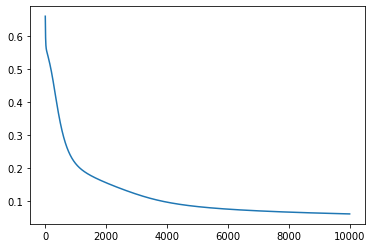

In [7]:
eval_pred_h2 = run_two_hidden_model(1000,5e-3,100)
eval_true = truth_class.detach().numpy()

8859
0.488235
2.132567
2.02628
2.10281
2.080955
2.128761
2.051641
2.066401
2.09309
1.128016
1.386997
2.209619
1.759041
2.1173599999999997
1.628492
2.12472
2.092584
2.066007
2.118491
0.616926
2.076128
2.022886
2.116435
0.986253
2.173569
2.029792
0.756178
2.093987
2.10677
2.102718
0.262859
2.0702160000000003
2.063307
2.115305
2.16783
2.09523
0.863598
1.992584
1.937567
2.06427
2.141948
2.12838
2.131131
2.122036
2.13592
2.1872
2.168095
2.12424
1.70018
2.101277
2.10023
2.1655670000000002
2.083081
2.17151
2.073052
2.011901
2.078346
2.177949
2.061031
2.154091
2.192101
2.119615
0.654413
2.1448679999999998
2.15067
0.510213
2.104025
2.12104
2.199238
2.164813
1.767078
2.109552
2.21282
2.0886
2.131456
2.14323
2.1423579999999998
1.1628530000000001
2.04932
2.16009
1.5529469999999999
2.05754
2.1337729999999997
2.16149
2.103202
2.136711
0.865619
2.06022
2.16085
2.139949
2.09275
2.067468
2.152387
2.12221
2.088613
2.17268
2.05014
2.086061
2.10358
2.173153
0.813013
1.12525
2.15822
2.189067
2.084729
2.143

2.081518
2.0710059999999997
0.706455
2.11132
2.114111
1.14342
2.14853
2.13746
2.13009
2.122245
2.13592
2.07853
2.0441190000000002
2.06364
2.151528
2.132144
1.30749
2.123799
1.179038
2.104256
2.08629
2.1196930000000003
2.164481
2.0953
2.142383
2.128548
1.01564
2.18302
2.183979
2.118976
2.14744
2.080468
1.34279
2.14806
2.179283
2.135595
2.103599
2.11014
2.12566
2.047721
1.194237
2.145523
0.214016
2.1825919999999996
1.7093559999999999
1.63926
2.098964
2.147792
2.17566
0.692569
2.153574
2.15635
2.008758
2.149515
2.149983
2.13527
2.12397
2.1678859999999998
1.70064
2.153431
2.118074
1.8101880000000001
2.081228
2.108225
2.056144
2.12708
2.125396
2.1435
2.0593179999999998
1.5661829999999999
2.123271
2.09886
0.74536
2.076359
2.19092
2.09202
2.1774050000000003
2.22304
2.11326
2.193567
1.10838
2.1023840000000003
2.092317
0.340843
2.148755
2.133587
2.124591
0.668697
2.11333
2.1367559999999997
2.13055
0.152429
2.15918
2.083286
2.100147
0.524786
1.72642
1.923086
2.1016239999999997
2.116998
1.661041


2.165617
2.155675
1.60365
2.16327
0.278794
2.142082
2.1808180000000004
2.16791
2.1200989999999997
2.1092269999999997
0.544085
2.170973
2.101262
2.12514
2.095152
1.4314230000000001
2.147102
2.1420570000000003
2.1105
1.669683
2.099944
2.098027
2.082052
2.126369
1.4721600000000001
2.0363189999999998
2.1528869999999998
2.153107
2.13086
2.147523
2.120722
2.108313
2.0504499999999997
1.61181
2.0936239999999997
2.20417
2.121176
2.12155
2.0983870000000002
2.14789
2.1555
2.137693
2.111181
2.08487
1.14733
0.947523
2.073216
2.14318
2.11062
2.10525
2.14558
2.131868
2.120816
0.834984
2.172015
2.162331
2.095712
1.650832
1.05995
2.142187
2.13545
1.87281
2.12743
1.1750639999999999
1.959317
1.478656
2.138166
2.156488
0.457872
2.0297
2.124854
0.728821
1.0096
2.12684
1.678372
2.19247
2.143142
2.1179040000000002
2.101621
1.850136
2.110948
2.1412150000000003
2.129027
1.4295
2.104493
2.0219
2.11818
2.19079
2.03282
2.144812
2.171893
2.118899
2.118475
2.116741
0.712539
2.104627
2.152453
2.138956
2.151465
2.166

2.106848
2.03431
0.316767
1.9083640000000002
2.12588
2.151729
2.144215
2.092521
2.132403
2.157548
2.158617
0.927066
2.117716
0.903781
2.05945
2.16293
2.045818
2.249035
2.091276
2.06376
2.0417370000000004
2.112275
0.35086
2.22653
1.496995
2.127111
2.044561
2.1231
2.005307
2.12794
0.48314
2.117608
2.143535
2.118751
2.0799060000000003
2.058176
2.151621
2.126784
1.13728
2.054145
2.14948
2.182231
2.082857
2.026526
1.18429
2.12555
2.162636
2.11496
2.073149
2.1650210000000003
2.07166
2.131023
2.1599880000000002
2.133448
2.180719
2.121379
2.19387
2.0876959999999998
2.187852
2.106043
2.136851
2.175234
2.07262
0.684729
2.105586
2.071875
2.083869
2.08121
2.18388
2.16973
1.27903
2.168951
2.14053
1.3459569999999998
2.1753
2.058517
2.11229
2.197803
2.054923
0.759867
2.135624
2.094332
1.341793
0.540803
0.22094
2.1350029999999998
1.9264390000000002
2.0937970000000004
2.135111
2.11151
2.18892
2.068088
2.1194859999999998
2.16547
1.925506
0.705503
2.143521
2.0584290000000003
2.14508
1.2411210000000001
2.

2.100111
1.612401
1.62092
2.15017
1.307229
2.145992
2.168674
2.138979
2.049375
2.032711
0.183768
2.12795
2.0693349999999997
2.11091
2.128176
1.24759
2.106113
2.094696
2.09067
2.091741
1.146772
0.913988
2.13801
2.181736
2.20842
2.123729
2.059163
2.1197880000000002
2.153003
2.1239589999999997
2.188122
2.165533
2.1235779999999997
0.656961
2.209612
1.95208
2.1668060000000002
2.143354
2.1483849999999998
0.502976
0.461407
2.141601
2.15223
2.122756
2.206468
2.128451
2.092164
2.0875220000000003
1.81812
2.146176
2.098257
2.15106
2.116976
0.535937
2.1272640000000003
2.0631
2.14231
2.036257
2.09675
1.7907589999999998
2.11378
2.106228
2.097297
2.017854
2.161453
2.11739
2.110277
2.15656
2.061527
1.60382
2.07124
2.1675570000000004
2.14352
2.12446
0.741269
1.08339
2.14697
2.10299
2.13286
2.066045
2.112623
2.08709
0.628084
2.17385
2.026044
2.1018049999999997
2.153858
2.0422409999999998
2.078566
2.117319
2.125675
1.5814190000000001
2.074013
2.2190149999999997
1.869773
2.137572
2.196151
0.938229
1.26979

2.122575
1.67198
2.102864
2.108131
2.06124
2.171785
2.103414
2.08226
2.14572
2.12557
1.02291
2.110861
2.109446
0.730018
2.136436
2.110071
2.11436
1.21879
2.10501
2.1260169999999996
2.033345
2.134289
2.1779409999999997
0.565341
2.09237
2.111568
1.5999630000000002
2.12171
2.105403
0.794344
2.1698399999999998
1.033051
2.132874
1.8707189999999998
1.883151
1.764473
2.163254
2.073816
1.95893
2.149891
2.12
2.179224
1.79742
2.07535
2.045559
2.163448
2.172664
2.09155
2.088131
1.5637670000000001
1.88717
2.189974
2.1267449999999997
2.126184
2.0974150000000003
2.047059
2.056356
2.169
2.12103
2.149013
2.14336
2.114581
1.94267
2.117968
1.82782
1.601002
2.13828
1.905146
2.067698
0.956499
1.949902
2.126057
2.075694
0.150262
2.183563
2.0384320000000002
2.1528869999999998
1.10145
2.163936
2.115043
0.508566
2.077887
1.660388
1.8284770000000001
2.104075
2.053695
2.181932
2.128023
2.133137
2.075336
0.49638
2.11903
2.150361
2.151666
2.076245
2.120043
2.141826
2.127784
2.1225
1.500715
2.059751
2.203644
2.183

2.117404
0.508554
0.44967
1.1884579999999998
2.08582
2.13448
1.227097
2.17014
2.14366
2.1633180000000003
2.084428
2.017098
2.087147
2.099398
2.07913
0.44099
2.150019
2.09838
2.196436
2.105837
0.282979
2.188615
2.10198
2.156692
2.029586
2.161451
1.465518
2.12939
2.093356
2.107808
2.100749
2.18082
2.12196
2.112013
2.10457
2.147386
2.129158
2.0672439999999996
2.061038
2.122573
2.11659
2.083684
2.092203
2.10326
2.1523000000000003
2.10795
2.072584
2.13023
1.810603
2.159364
1.07827
1.5285130000000002
0.56928
1.91456
2.083336
1.63218
2.17109
2.11275
2.080914
2.13254
1.615964
2.191172
2.166592
2.1473000000000004
0.497275
2.06938
1.58498
2.160516
2.08354
2.125733
2.10462
2.06803
2.154908
1.990481
0.41108
2.132813
2.127404
2.1345
2.13302
2.136359
2.081631
1.17792
2.123402
2.079074
2.09084
1.32943
2.071646
2.098896
1.0043
2.15964
1.61508
0.497151
2.0953
2.11201
2.081235
2.086486
2.1156
2.0857859999999997
2.104132
1.20161
2.05552
2.15638
2.11072
2.108542
2.09193
2.199055
2.070965
1.413089
2.07409


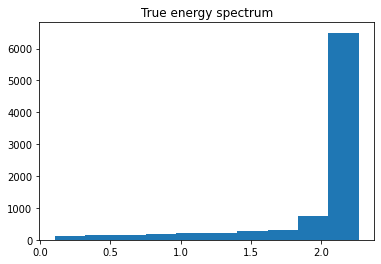

In [8]:
energy_spec = []
unique_ind = np.unique(data[:,0])
print(unique_ind.shape[0])
for i in range(unique_ind.shape[0]):
    ene = np.sum(data[data[:,0] == i,1])
    print (ene)
    energy_spec.append(ene)

plt.hist(energy_spec)
plt.title("True energy spectrum")

print(eval_pred_h2[0].shape)
print(eval_pred_h2[0][1])

print(eval_pred_h2[0])

[[0.00000000e+00 4.88235000e-01 1.10095893e+00 6.23068580e+00
  2.89123963e-01]
 [1.00000000e+00 1.29252000e+00 6.91808373e-01 1.12018198e+00
  9.28225006e-01]
 [1.00000000e+00 4.22443000e-01 7.36274126e-01 1.12050313e+00
  9.03797111e-01]
 ...
 [8.85700000e+03 2.97576000e-01 1.01517949e+00 3.19430160e+00
  5.09072751e-01]
 [8.85700000e+03 1.22752000e-01 1.05914782e+00 3.09010544e+00
  4.95073066e-01]
 [8.85800000e+03 1.47413000e+00 1.33081879e+00 4.77077024e+00
  5.83929863e-01]]
[[0.         0.488235   1.10095893 6.2306858  0.28912396]
 [1.         1.29252    0.69180837 1.12018198 0.92822501]
 [1.         0.422443   0.73627413 1.12050313 0.90379711]
 [1.         0.417604   0.73593553 1.22209001 0.90042416]
 [2.         1.01595    0.89190514 1.91703474 0.64891465]
 [2.         0.553103   0.9309848  2.11134225 0.64793438]
 [2.         0.267183   1.01358076 2.02224319 0.64547825]
 [2.         0.190044   0.97311182 1.91776778 0.628375  ]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), 

[[2.61000000e+02 2.11792000e+00 7.77095632e-01 2.89604228e+00
  1.71198759e-01]
 [2.62000000e+02 1.71752000e+00 7.76868739e-01 4.40505395e-01
  6.69413820e-01]
 [2.62000000e+02 4.52024000e-01 7.38125921e-01 3.39265827e-01
  6.76110486e-01]
 [2.63000000e+02 1.08948000e+00 8.16351578e-01 5.84144247e+00
  5.90887677e-01]
 [2.63000000e+02 5.18745000e-01 8.16217187e-01 5.74948108e+00
  5.68461233e-01]
 [2.63000000e+02 3.28078000e-01 6.09987338e-01 6.03787928e+00
  5.82735819e-01]
 [2.63000000e+02 1.98297000e-01 7.38127666e-01 5.94380603e+00
  5.72881842e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0}, {1, 2}, {3, 4, 5, 6}]
<class 'list'>
this is type of k:
2.11792
<class 'set'>
this is type of k:
2.169544
<class 'set'>
this is type of k:
2.1346000000000003
<class 'set'>
[[2.64000000e+02 7.57097000e-01 7.38298708e-01 6.13877

[[4.47000000e+02 1.07692000e+00 4.75659817e-01 2.65790956e+00
  3.69936884e-01]
 [4.47000000e+02 6.56071000e-01 4.76108367e-01 2.85122223e+00
  3.47925740e-01]
 [4.47000000e+02 4.07730000e-01 5.20858609e-01 2.85090807e+00
  3.74302134e-01]
 [4.48000000e+02 7.39910000e-01 1.23816450e+00 2.80364455e+00
  9.13565862e-01]
 [4.48000000e+02 7.15825000e-01 1.33214524e+00 2.70005926e+00
  9.08096718e-01]
 [4.48000000e+02 6.84188000e-01 1.28278035e+00 2.69848846e+00
  9.39713600e-01]
 [4.49000000e+02 2.10706000e+00 1.05876559e+00 2.60783606e+00
  3.92477547e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3, 4, 5}, {6}]
<class 'list'>
this is type of k:
2.140721
<class 'set'>
this is type of k:
2.139923
<class 'set'>
this is type of k:
2.10706
<class 'set'>
[[4.50000000e+02 1.51357000e+00 8.93104177e-01 3.97331186e+00
  

[[6.21000000e+02 1.08936000e+00 7.38223659e-01 6.03761748e+00
  4.03070226e-01]
 [6.21000000e+02 3.28145000e-01 6.93735216e-01 5.94391075e+00
  4.16878529e-01]
 [6.21000000e+02 2.07391000e-01 7.77198607e-01 5.04485675e-02
  4.16799211e-01]
 [6.21000000e+02 1.85732000e-01 7.38127666e-01 5.94380603e+00
  4.10360631e-01]
 [6.21000000e+02 1.73770000e-01 8.16677954e-01 5.15853004e-02
  4.06587808e-01]
 [6.22000000e+02 2.15819000e+00 8.14463131e-01 5.05948261e+00
  6.68884301e-01]
 [6.23000000e+02 1.75480000e+00 1.28270530e+00 3.67414497e+00
  8.49666917e-01]
 [6.23000000e+02 4.27573000e-01 1.19023077e+00 3.58459212e+00
  9.04785036e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components: [{0, 1, 2, 3, 4}, {5}, {6, 7}]
<class 'list'>
this is type of k:
1.984398
<class 'set'>
this is 

  1.51059530e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components: [{0, 1, 2}, {3, 4, 5}, {6, 7}]
<class 'list'>
this is type of k:
2.185703
<class 'set'>
this is type of k:
2.067379
<class 'set'>
this is type of k:
2.060127
<class 'set'>
[[8.07000000e+02 1.03756000e+00 1.28289729e+00 2.89365118e+00
  7.68159276e-01]
 [8.08000000e+02 1.72598000e+00 1.28237020e+00 5.44940662e+00
  6.11879497e-01]
 [8.08000000e+02 3.36954000e-01 1.09992220e+00 5.35955707e+00
  6.09646327e-01]
 [8.09000000e+02 1.35997000e+00 1.37740163e+00 5.25490713e+00
  6.82669301e-01]
 [8.09000000e+02 4.32666000e-01 1.33139824e+00 5.16282355e+00
  7.07984469e-01]
 [8.09000000e+02 2.40052000e-01 1.33155183e+00 5.25544818e+00
  7.11726112e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), 

[[1.04100000e+03 2.11014000e+00 1.47489398e+00 3.19335912e+00
  4.89766169e-01]
 [1.04200000e+03 2.12566000e+00 4.14786223e-01 2.93058235e-01
  3.90203022e-01]
 [1.04300000e+03 1.32799000e+00 4.12759896e-01 2.07404456e+00
  8.03047360e-01]
 [1.04300000e+03 3.22647000e-01 4.11817418e-01 1.87917855e+00
  8.12877378e-01]
 [1.04300000e+03 2.51026000e-01 9.31867940e-01 2.50236582e+00
  8.11219896e-01]
 [1.04300000e+03 1.46058000e-01 9.32014547e-01 2.60837711e+00
  8.18699899e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0}, {1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
2.11014
<class 'set'>
this is type of k:
2.12566
<class 'set'>
this is type of k:
1.6506370000000001
<class 'set'>
this is type of k:
0.397084
<class 'set'>
[[1.04400000e+03 9.12403000e-01 1.01446041e+00 3.86974402e+00
  5.02502818e-01]
 [1.04400000e+03 2.81834000e-01 8.93104177e-01 3.97331186e+00


[[1.23600000e+03 1.60026000e+00 1.47489398e+00 3.19335912e+00
  7.65475577e-01]
 [1.23600000e+03 4.97974000e-01 1.47494110e+00 3.28488419e+00
  7.70183264e-01]
 [1.23700000e+03 1.27421000e+00 8.51389062e-01 1.11882761e+00
  7.99614239e-01]
 [1.23700000e+03 8.97774000e-01 8.15063525e-01 1.02793261e+00
  7.85738433e-01]
 [1.23800000e+03 1.94294000e+00 8.51073158e-01 5.05777219e+00
  4.20311103e-01]
 [1.23800000e+03 1.87699000e-01 8.14463131e-01 5.05948261e+00
  4.61594662e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
2.098234
<class 'set'>
this is type of k:
2.171984
<class 'set'>
this is type of k:
2.130639
<class 'set'>
[[1.23900000e+03 1.00895000e+00 9.75015969e-01 6.03657028e+00
  4.16569570e-02]
 [1.23900000e+03 8.02113000e-01 9.32408992e-01 6.14033011e+00
  4.90439665e-02]
 [1.23900000e+03 2.95962000e-01 8.

[[1.44900000e+03 7.57531000e-01 1.05914782e+00 6.23169809e+00
  4.82668535e-01]
 [1.44900000e+03 7.14308000e-01 1.01515331e+00 6.14078389e+00
  4.94262606e-01]
 [1.44900000e+03 5.65030000e-01 1.05913386e+00 6.13966688e+00
  4.69131884e-01]
 [1.45000000e+03 1.27224000e+00 9.74937430e-01 5.94450417e+00
  1.66944008e-01]
 [1.45100000e+03 3.59224000e-01 1.37772800e+00 6.37334902e-01
  1.08354476e-01]
 [1.45100000e+03 3.43700000e-01 6.53175510e-01 5.33840368e-01
  9.28354104e-02]
 [1.45100000e+03 3.30491000e-01 6.09324112e-01 6.34840826e-01
  9.76776651e-02]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3}, {4}, {5, 6}]
<class 'list'>
this is type of k:
2.0368690000000003
<class 'set'>
this is type of k:
1.27224
<class 'set'>
this is type of k:
0.359224
<class 'set'>
this is type of k:
0.674191
<class 'set'>
[[1.452000

[[1.72200000e+03 1.79292000e+00 8.13529380e-01 1.62942717e+00
  2.17469315e-01]
 [1.72200000e+03 3.70244000e-01 8.91001055e-01 1.51153716e+00
  1.93405737e-01]
 [1.72300000e+03 1.35260000e+00 9.32346160e-01 3.38895817e+00
  3.18164363e-01]
 [1.72300000e+03 8.23338000e-01 9.74935684e-01 3.48029125e+00
  3.38896565e-01]
 [1.72400000e+03 1.84838000e+00 9.72539347e-01 4.56147036e+00
  3.82950581e-01]
 [1.72400000e+03 2.64191000e-01 4.14582020e-01 4.86671099e-01
  4.26880531e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4}, {5}]
<class 'list'>
this is type of k:
2.163164
<class 'set'>
this is type of k:
2.175938
<class 'set'>
this is type of k:
1.84838
<class 'set'>
this is type of k:
0.264191
<class 'set'>
[[1.72500000e+03 1.57830000e+00 5.20731200e-01 2.93623721e-01
  4.99397158e-01]
 [1.72500000e+03 5.53346000e-01 4.75977467e-01 2.93546927e-01
  5.41804

Connected components: [{0}, {1}, {2}, {3, 4, 5, 6}]
<class 'list'>
this is type of k:
1.86257
<class 'set'>
this is type of k:
0.254178
<class 'set'>
this is type of k:
2.13568
<class 'set'>
this is type of k:
2.184084
<class 'set'>
[[1.83900000e+03 2.05968000e+00 1.42805632e+00 2.11371590e+00
  9.28999592e-01]
 [1.84000000e+03 2.13360000e+00 1.28195132e+00 4.26064541e+00
  4.71381793e-01]
 [1.84100000e+03 1.44637000e+00 9.74935684e-01 3.48029125e+00
  6.14063763e-01]
 [1.84100000e+03 6.29068000e-01 1.05888951e+00 3.58330058e+00
  6.22840213e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1}, {2, 3}]
<class 'list'>
this is type of k:
2.05968
<class 'set'>
this is type of k:
2.1336
<class 'set'>
this is type of k:
2.075438
<class 'set'>
[[1.84200000e+03 1.49550000e+00 1.28260232e+00 5.64483113e+00
  1.43891330e-01]
 [1.84200000e+03 6.10806000e-01 1.33199165e+00 5.64640193e+00
  1.21929419e-01]
 [1.84300000e+03 2.08219000e+00 1.37680298

[[2.01600000e+03 1.08972000e+00 1.37793046e+00 3.47994218e+00
  3.01822574e-01]
 [2.01600000e+03 5.40975000e-01 1.42845425e+00 3.48027379e+00
  2.95485850e-01]
 [2.01600000e+03 5.23269000e-01 1.33220458e+00 3.48039597e+00
  3.15447843e-01]
 [2.01700000e+03 2.10764000e+00 1.05700805e+00 4.45771054e+00
  4.92490020e-01]
 [2.01800000e+03 1.79208000e+00 4.20205471e-01 5.40996218e+00
  1.71795015e-01]
 [2.01800000e+03 2.93976000e-01 4.74972157e-01 5.60591029e+00
  1.35507644e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2}, {3}, {4, 5}]
<class 'list'>
this is type of k:
2.153964
<class 'set'>
this is type of k:
2.10764
<class 'set'>
this is type of k:
2.086056
<class 'set'>
[[2.01900000e+03 1.18034000e+00 5.66284293e-01 5.06253693e+00
  5.72473543e-01]
 [2.01900000e+03 7.18152000e-01 4.73095928e-01 5.01939240e+00
  5.80721349e-01]
 [2.01900000e+03 2.84387000e-01 4.1

[[2.22600000e+03 1.11925000e+00 1.33155183e+00 5.25544818e+00
  6.19230950e-01]
 [2.22600000e+03 4.17446000e-01 1.28222708e+00 5.35981887e+00
  5.56347500e-01]
 [2.22600000e+03 1.05303000e-01 1.28209094e+00 5.25382502e+00
  6.01192512e-01]
 [2.22700000e+03 1.28172000e+00 1.01502066e+00 3.47917424e+00
  1.65302936e-01]
 [2.22700000e+03 4.75706000e-01 9.74935684e-01 3.48029125e+00
  1.44394592e-01]
 [2.22700000e+03 3.15178000e-01 8.93847687e-01 3.58267226e+00
  1.73540021e-01]
 [2.22800000e+03 1.57882000e+00 7.76865249e-01 5.84257694e+00
  7.50088891e-01]
 [2.22800000e+03 5.39311000e-01 8.93723769e-01 5.84063962e+00
  7.63789650e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components: [{0, 1, 2}, {3, 4, 5}, {6, 7}]
<class 'list'>
this is type of k:
1.641999
<class 'set'>
this is 

[[2.39100000e+03 1.09961000e+00 1.28143994e+00 4.86198115e+00
  8.19991970e-01]
 [2.39100000e+03 4.87598000e-01 1.28160574e+00 4.96823680e+00
  8.02742121e-01]
 [2.39200000e+03 2.13251000e+00 9.30709041e-01 5.16343442e+00
  3.77649920e-01]
 [2.39300000e+03 1.13684000e+00 1.10030268e+00 2.41345874e+00
  4.34923422e-01]
 [2.39300000e+03 5.14700000e-01 1.01446216e+00 2.41345874e+00
  4.55110789e-01]
 [2.39300000e+03 4.28416000e-01 1.05821581e+00 2.30931495e+00
  4.67446394e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2}, {3, 4, 5}]
<class 'list'>
this is type of k:
1.587208
<class 'set'>
this is type of k:
2.13251
<class 'set'>
this is type of k:
2.079956
<class 'set'>
[[2.39400000e+03 2.09154000e+00 8.15054798e-01 2.11368099e+00
  4.89752712e-01]
 [2.39500000e+03 2.20073000e+00 6.91454071e-01 5.06136756e+00
  5.72356590e-01]
 [2.39600000e+03 1.71336000e+00 1.0

[[2.54100000e+03 1.62290000e+00 1.10093624e+00 1.42580659e-01
  6.68803342e-01]
 [2.54100000e+03 4.82350000e-01 1.14707925e+00 1.43166566e-01
  6.68166606e-01]
 [2.54200000e+03 2.14558000e+00 6.50794881e-01 1.82594601e+00
  4.16636307e-01]
 [2.54300000e+03 1.60321000e+00 9.32442153e-01 1.41449686e-01
  4.80901101e-01]
 [2.54300000e+03 5.28658000e-01 7.77163700e-01 1.44425647e-01
  5.05704714e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
2.10525
<class 'set'>
this is type of k:
2.14558
<class 'set'>
this is type of k:
2.131868
<class 'set'>
[[2.54400000e+03 1.15421000e+00 6.93208127e-01 2.50615318e+00
  7.92617804e-01]
 [2.54400000e+03 5.20518000e-01 6.93422802e-01 2.60732992e+00
  8.38832564e-01]
 [2.54400000e+03 4.46088000e-01 6.52955598e-01 2.50629281e+00
  8.08744066e-01]
 [2.54500000e+03 8.34984000e-01 1.01405375e+00 5.35953961e+00
  4.78258429e-01]

[[2.73000000e+03 1.76984000e+00 8.53102976e-01 6.03499949e+00
  6.82866230e-01]
 [2.73000000e+03 3.08923000e-01 8.93936699e-01 6.03578489e+00
  6.87885720e-01]
 [2.73100000e+03 2.14260000e+00 1.19013653e+00 5.75054573e+00
  9.00110171e-01]
 [2.73200000e+03 1.14334000e+00 4.75340422e-01 6.80345050e-01
  4.96841058e-01]
 [2.73200000e+03 5.73733000e-01 6.09545769e-01 5.33618711e-01
  4.93802352e-01]
 [2.73200000e+03 3.32038000e-01 5.67963300e-01 7.28111221e-01
  5.12639554e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2}, {3, 4, 5}]
<class 'list'>
this is type of k:
2.078763
<class 'set'>
this is type of k:
2.1426
<class 'set'>
this is type of k:
2.049111
<class 'set'>
[[2.73300000e+03 1.90603000e+00 1.18970892e+00 3.97524917e+00
  5.23851879e-02]
 [2.73300000e+03 2.65081000e-01 1.14611409e+00 4.06579685e+00
  7.60921057e-02]
 [2.73400000e+03 1.26139000e+00 6.07

[[2.91900000e+03 1.20322000e+00 6.90382439e-01 1.62934863e+00
  6.94162271e-02]
 [2.91900000e+03 8.74637000e-01 8.50464038e-01 1.72013368e+00
  7.85044807e-02]
 [2.92000000e+03 1.05983000e+00 6.52955598e-01 5.64788546e+00
  9.33482999e-01]
 [2.92000000e+03 5.12225000e-01 4.76108367e-01 2.85122223e+00
  8.87013327e-01]
 [2.92000000e+03 5.06386000e-01 6.93208127e-01 5.64774583e+00
  9.29107903e-01]
 [2.92100000e+03 2.09104000e+00 1.42808250e+00 2.21698703e+00
  3.51921202e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 4}, {3}, {5}]
<class 'list'>
this is type of k:
2.077857
<class 'set'>
this is type of k:
1.566216
<class 'set'>
this is type of k:
0.512225
<class 'set'>
this is type of k:
2.09104
<class 'set'>
[[2.92200000e+03 1.54280000e+00 1.23695149e+00 1.91715692e+00
  3.98070538e-01]
 [2.92200000e+03 5.71830000e-01 1.23675253e+00 1.82610309e+00
  4.36586

[[3.11700000e+03 1.87620000e+00 1.42842633e+00 3.38817277e+00
  1.98581677e-01]
 [3.11700000e+03 3.38634000e-01 1.28276115e+00 3.58469684e+00
  2.08069258e-01]
 [3.11800000e+03 1.85719000e+00 4.75659817e-01 2.65790956e+00
  2.97541566e-01]
 [3.11800000e+03 2.76332000e-01 4.74972157e-01 2.46431764e+00
  2.94500113e-01]
 [3.11900000e+03 2.19753000e+00 7.38125921e-01 3.48084975e+00
  3.79162988e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.214834
<class 'set'>
this is type of k:
2.133522
<class 'set'>
this is type of k:
2.19753
<class 'set'>
[[3.12000000e+03 1.80321000e+00 9.31220422e-01 5.35912073e+00
  7.03813959e-01]
 [3.12000000e+03 2.46673000e-01 8.92978513e-01 5.45000003e+00
  7.21661158e-01]
 [3.12100000e+03 1.02428000e+00 5.18027685e-01 1.26774608e+00
  8.50643902e-01]
 [3.12200000e+03 1.74686000e+00 1.10009499e+00 2.30821539e+00
  4.94618566e-01

[[3.33900000e+03 8.82161000e-01 9.30183697e-01 4.45584303e+00
  7.94489720e-01]
 [3.34000000e+03 1.04538000e+00 8.15341032e-01 9.24476470e-01
  3.81869662e-01]
 [3.34000000e+03 4.67465000e-01 9.73904195e-01 9.24708599e-01
  4.23460429e-01]
 [3.34000000e+03 4.02348000e-01 1.01425097e+00 8.33747274e-01
  4.39189442e-01]
 [3.34000000e+03 2.28067000e-01 8.51924878e-01 9.23139548e-01
  4.17272933e-01]
 [3.34100000e+03 6.04246000e-01 1.10070760e+00 5.84046509e+00
  4.50636025e-01]
 [3.34100000e+03 3.56631000e-01 1.14686632e+00 5.84109341e+00
  4.57047691e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0}, {1, 2, 3, 4}, {5, 6}]
<class 'list'>
this is type of k:
0.882161
<class 'set'>
this is type of k:
2.1432599999999997
<class 'set'>
this is type of k:
0.960877
<class 'set'>
[[3.34200000e+03 1.77728000e+00 6.91808373e-01 1.1201

2.12254
<class 'set'>
this is type of k:
2.19203
<class 'set'>
[[3.53100000e+03 1.22260000e+00 6.93590354e-01 4.40259304e-01
  3.53650892e-01]
 [3.53100000e+03 5.28095000e-01 6.93733471e-01 3.39162852e-01
  3.55597202e-01]
 [3.53100000e+03 1.55138000e-01 7.38125921e-01 3.39265827e-01
  3.52216595e-01]
 [3.53200000e+03 1.21299000e+00 1.05916004e+00 5.15334642e-02
  1.09211115e-01]
 [3.53200000e+03 8.75572000e-01 9.75078801e-01 6.13963198e+00
  1.13330204e-01]
 [3.53300000e+03 2.16719000e+00 5.68977336e-01 3.28544269e+00
  6.52429825e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2}, {3}, {4}, {5}]
<class 'list'>
this is type of k:
1.9058329999999999
<class 'set'>
this is type of k:
1.21299
<class 'set'>
this is type of k:
0.875572
<class 'set'>
this is type of k:
2.16719
<class 'set'>
[[3.53400000e+03 1.07782000e+00 8.52755655e-01 3.67391808e+00
  2.27021444e-01]

[[3.73800000e+03 9.83407000e-01 1.01276221e+00 1.42122161e+00
  1.95945022e-01]
 [3.73800000e+03 5.34402000e-01 1.01305542e+00 1.31528711e+00
  2.14827190e-01]
 [3.73800000e+03 1.02468000e-01 1.05672879e+00 1.41969968e+00
  1.91207796e-01]
 [3.73900000e+03 1.69150000e+00 5.68441520e-01 5.33205068e-01
  2.19736181e-01]
 [3.73900000e+03 3.72794000e-01 4.20437600e-01 2.46442236e+00
  2.03560687e-01]
 [3.74000000e+03 2.11650000e+00 1.23695149e+00 1.91715692e+00
  3.92137299e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2}, {3}, {4}, {5}]
<class 'list'>
this is type of k:
1.6202770000000002
<class 'set'>
this is type of k:
1.6915
<class 'set'>
this is type of k:
0.372794
<class 'set'>
this is type of k:
2.1165
<class 'set'>
[[3.74100000e+03 1.81768000e+00 9.30412335e-01 4.36623783e+00
  8.90316256e-01]
 [3.74100000e+03 3.13998000e-01 8.92030799e-01 4.36468449e+00
  

[[3.95400000e+03 1.60624000e+00 6.91810118e-01 5.16287591e+00
  6.81415523e-01]
 [3.95400000e+03 2.82004000e-01 7.35607410e-01 4.96671836e+00
  6.79233992e-01]
 [3.95400000e+03 1.71206000e-01 6.91454071e-01 5.06136756e+00
  6.79384970e-01]
 [3.95500000e+03 2.16293000e+00 5.17915984e-01 1.87680490e+00
  3.01953860e-01]
 [3.95600000e+03 1.40120000e+00 8.92599777e-01 1.02729556e+00
  5.49409925e-01]
 [3.95600000e+03 3.71841000e-01 1.01405200e+00 9.23664892e-01
  5.29335683e-01]
 [3.95600000e+03 2.72777000e-01 9.30955132e-01 1.02883494e+00
  5.41600504e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3}, {4, 5, 6}]
<class 'list'>
this is type of k:
2.05945
<class 'set'>
this is type of k:
2.16293
<class 'set'>
this is type of k:
2.045818
<class 'set'>
[[3.95700000e+03 1.93257000e+00 8.52387391e-01 3.86923787e+00
  6

[[4.16100000e+03 2.14604000e+00 1.33187297e+00 2.41237664e+00
  3.63465593e-01]
 [4.16200000e+03 1.33052000e+00 1.42808250e+00 2.21698703e+00
  5.11608108e-01]
 [4.16200000e+03 3.10840000e-01 1.47464439e+00 2.21721392e+00
  4.91229239e-01]
 [4.16200000e+03 2.50242000e-01 1.37747842e+00 2.21730119e+00
  4.80110761e-01]
 [4.16200000e+03 1.75270000e-01 1.37759536e+00 2.30889607e+00
  4.78062376e-01]
 [4.16300000e+03 2.09708000e+00 1.42844553e+00 2.99803932e+00
  8.67445191e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0}, {1, 2, 3, 4}, {5}]
<class 'list'>
this is type of k:
2.14604
<class 'set'>
this is type of k:
2.066872
<class 'set'>
this is type of k:
2.09708
<class 'set'>
[[4.16400000e+03 1.59651000e+00 1.42837746e+00 3.67545397e+00
  6.95978390e-02]
 [4.16400000e+03 5.09184000e-01 1.28258313e+00 3.77996428e+00
  6.75486879e-02]
 [4.16500000e+03 2.02004000e+00 1.47

[[4.37100000e+03 6.80869000e-01 1.18987647e+00 5.55522593e+00
  2.32127365e-01]
 [4.37100000e+03 2.19626000e-01 1.23763217e+00 5.45013966e+00
  2.25326765e-01]
 [4.37200000e+03 1.76288000e+00 8.53197224e-01 3.08849974e+00
  4.94384954e-01]
 [4.37200000e+03 3.47040000e-01 9.32435172e-01 3.19383036e+00
  4.34015691e-01]
 [4.37300000e+03 1.20867000e+00 8.51083630e-01 1.22545326e+00
  8.96849909e-01]
 [4.37300000e+03 9.15314000e-01 8.91624138e-01 1.31539008e+00
  9.31699701e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
0.9004949999999999
<class 'set'>
this is type of k:
2.10992
<class 'set'>
this is type of k:
2.123984
<class 'set'>
[[4.37400000e+03 1.21784000e+00 1.10030268e+00 2.41345874e+00
  8.68888240e-01]
 [4.37500000e+03 5.91805000e-01 8.93400883e-01 5.64538964e+00
  6.56093791e-01]
 [4.37500000e+03 2.199830

pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2, 3}, {4, 5}, {6}]
<class 'list'>
this is type of k:
2.091429
<class 'set'>
this is type of k:
2.075872
<class 'set'>
this is type of k:
2.16804
<class 'set'>
[[4.58400000e+03 1.85371000e+00 1.37737196e+00 4.16990574e+00
  3.33621068e-01]
 [4.58400000e+03 2.46669000e-01 1.28207174e+00 4.17095294e+00
  3.56623419e-01]
 [4.58500000e+03 7.89272000e-01 9.75104981e-01 3.19311477e+00
  4.69552436e-01]
 [4.58500000e+03 7.67056000e-01 9.75103236e-01 3.09008799e+00
  4.23575741e-01]
 [4.58500000e+03 5.83162000e-01 9.32435172e-01 3.19383036e+00
  4.43066966e-01]
 [4.58600000e+03 1.57308000e+00 1.28234925e+00 3.97537134e+00
  7.34783165e-01]
 [4.58600000e+03 5.12502000e-01 1.28250284e+00 3.86946476e+00
  7.31276743e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6),

[[4.77900000e+03 1.34031000e+00 8.51073158e-01 1.91617953e+00
  8.79553016e-01]
 [4.77900000e+03 3.59440000e-01 8.14463131e-01 1.91788996e+00
  8.77498394e-01]
 [4.78000000e+03 2.14708000e+00 7.38331869e-01 5.05112248e-02
  7.93545557e-01]
 [4.78100000e+03 1.23332000e+00 1.23787826e+00 3.77928360e+00
  8.00404141e-01]
 [4.78100000e+03 9.05984000e-01 1.28258313e+00 3.77996428e+00
  8.03823040e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
1.6997499999999999
<class 'set'>
this is type of k:
2.14708
<class 'set'>
this is type of k:
2.139304
<class 'set'>
[[4.78200000e+03 7.16621000e-01 6.93909749e-01 3.28586157e+00
  4.09194595e-01]
 [4.78200000e+03 3.79820000e-01 6.93944656e-01 3.09101301e+00
  3.55907912e-01]
 [4.78200000e+03 1.70261000e-01 6.93946401e-01 3.19205012e+00
  3.97190486e-01]
 [4.78300000e+03 1.80711000e+00 1.28287809e+00 2.47946710e-01
  4.46

[[4.99500000e+03 1.58829000e+00 4.75659817e-01 5.79950221e+00
  1.62673940e-01]
 [4.99500000e+03 5.00865000e-01 5.19521686e-01 5.40720456e+00
  1.82158928e-01]
 [4.99600000e+03 1.39421000e+00 8.93400883e-01 2.50379699e+00
  6.48148817e-01]
 [4.99600000e+03 5.09607000e-01 8.93334560e-01 2.41178323e+00
  6.50241730e-01]
 [4.99600000e+03 2.91687000e-01 9.31661991e-01 2.41303986e+00
  6.05259415e-01]
 [4.99700000e+03 2.16482000e+00 5.19748579e-01 2.46353224e+00
  1.43315861e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3, 4}, {5}]
<class 'list'>
this is type of k:
2.089155
<class 'set'>
this is type of k:
2.195504
<class 'set'>
this is type of k:
2.16482
<class 'set'>
[[4.99800000e+03 6.76709000e-01 1.23789921e+00 5.64552926e+00
  4.09541189e-01]
 [4.99800000e+03 4.40073000e-01 1.28260232e+00 5.64483113e+00
  4.13617064e-01]
 [4.99900000e+03 8.05654000e-01 9.3

[[5.21100000e+03 1.27732000e+00 1.01446216e+00 2.41345874e+00
  4.26722332e-02]
 [5.21100000e+03 7.91046000e-01 8.93334560e-01 2.41178323e+00
  7.13133057e-02]
 [5.21200000e+03 1.36212000e+00 1.23821686e+00 3.38888836e+00
  8.65051415e-01]
 [5.21200000e+03 8.06900000e-01 1.19037913e+00 3.38942941e+00
  8.53316660e-01]
 [5.21300000e+03 1.46016000e+00 1.33139824e+00 2.02123090e+00
  5.91148389e-01]
 [5.21300000e+03 7.09626000e-01 1.23712777e+00 2.02199885e+00
  5.82414388e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
2.068366
<class 'set'>
this is type of k:
2.1690199999999997
<class 'set'>
this is type of k:
2.1697859999999998
<class 'set'>
[[5.21400000e+03 1.02970000e+00 1.28270530e+00 5.32550569e-01
  1.46832130e-01]
 [5.21500000e+03 1.39789000e+00 1.01517600e+00 6.23049382e+00
  9.30138495e-01]
 [5.21500000e+

Connected components: [{0, 1, 2}, {3, 4, 5}, {6}]
<class 'list'>
this is type of k:
2.1906669999999995
<class 'set'>
this is type of k:
2.14947
<class 'set'>
this is type of k:
2.10311
<class 'set'>
[[5.42700000e+03 2.17205000e+00 1.47430231e+00 1.62947953e+00
  8.20208591e-01]
 [5.42800000e+03 2.09493000e+00 1.42775612e+00 4.96699761e+00
  1.99885781e-01]
 [5.42900000e+03 1.13480000e+00 1.19032328e+00 3.37476864e-01
  6.58455839e-01]
 [5.42900000e+03 6.61186000e-01 1.23821686e+00 2.47297447e-01
  6.69676392e-01]
 [5.42900000e+03 3.85826000e-01 1.23818370e+00 3.37969047e-01
  6.46237516e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0}, {1}, {2, 3, 4}]
<class 'list'>
this is type of k:
2.17205
<class 'set'>
this is type of k:
2.09493
<class 'set'>
this is type of k:
2.181812
<class 'set'>
[[5.43000000e+03 1.58942000e+00 9.30984803e-01 2.11134225e+00
  6.21301982e-01]
 [5.43000000e+03 4.81878000e-01 9.736458

[[5.62800000e+03 9.95363000e-01 1.42841760e+00 2.69991963e+00
  4.61960293e-01]
 [5.62800000e+03 4.71600000e-01 1.47488699e+00 2.69958802e+00
  4.59296068e-01]
 [5.62800000e+03 3.89164000e-01 1.42840189e+00 2.80294642e+00
  5.41372723e-01]
 [5.62900000e+03 1.76491000e+00 1.42766013e+00 1.41973808e+00
  8.58814249e-01]
 [5.62900000e+03 3.13871000e-01 1.47435990e+00 1.42003130e+00
  8.71267793e-01]
 [5.63000000e+03 1.20545000e+00 1.37772800e+00 3.77893454e+00
  6.83705364e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2}, {3, 4}, {5}]
<class 'list'>
this is type of k:
1.856127
<class 'set'>
this is type of k:
2.078781
<class 'set'>
this is type of k:
1.20545
<class 'set'>
[[5.63100000e+03 9.45433000e-01 6.92986470e-01 2.41218465e+00
  2.60576979e-01]
 [5.63100000e+03 7.05115000e-01 6.52728706e-01 2.41255117e+00
  2.70091911e-01]
 [5.63100000e+03 4.14282000e-01 5.6

<class 'set'>
this is type of k:
2.166721
<class 'set'>
this is type of k:
0.111441
<class 'set'>
[[5.82300000e+03 1.25622000e+00 8.16208461e-01 3.67531434e+00
  7.68995128e-02]
 [5.82300000e+03 3.30480000e-01 8.93524801e-01 3.77792225e+00
  1.25264076e-01]
 [5.82300000e+03 3.26395000e-01 1.05860153e+00 3.77853311e+00
  8.16367390e-02]
 [5.82400000e+03 1.71823000e+00 1.42827099e+00 3.77855056e+00
  4.56970013e-01]
 [5.82400000e+03 4.48184000e-01 1.47477180e+00 3.77881236e+00
  4.67013917e-01]
 [5.82500000e+03 1.09468000e+00 1.28285191e+00 3.47894734e+00
  2.29646065e-01]
 [5.82500000e+03 5.26004000e-01 1.42842633e+00 3.38817277e+00
  2.33776094e-01]
 [5.82500000e+03 5.03374000e-01 1.23808247e+00 3.58403362e+00
  2.06285960e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components

[[6.03600000e+03 1.11659000e+00 8.92872048e-01 5.35789900e+00
  2.36306627e-01]
 [6.03600000e+03 2.40416000e-01 7.75804088e-01 5.35784664e+00
  3.02345529e-01]
 [6.03700000e+03 1.39486000e+00 1.42845425e+00 3.38679396e-01
  4.61840385e-01]
 [6.03700000e+03 7.55112000e-01 1.47491317e+00 3.38387926e-01
  3.89192122e-01]
 [6.03800000e+03 2.14314000e+00 1.47430231e+00 4.77106695e+00
  2.05559512e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
1.357006
<class 'set'>
this is type of k:
2.149972
<class 'set'>
this is type of k:
2.14314
<class 'set'>
[[6.03900000e+03 2.01417000e+00 1.33096191e+00 1.41962289e+00
  5.61136584e-01]
 [6.04000000e+03 1.96970000e+00 1.14498137e+00 1.42014474e+00
  9.28636368e-01]
 [6.04000000e+03 1.88360000e-01 1.09846834e+00 1.51141324e+00
  9.29499572e-01]
 [6.04100000e+03 1.14241000e+00 8.13529380e-01 1.62942717e+00
  6.90924984e-01

[[6.24900000e+03 1.25394000e+00 8.14176897e-01 1.82557949e+00
  5.40341802e-01]
 [6.24900000e+03 3.39250000e-01 5.16882749e-01 1.68178705e+00
  5.72241933e-01]
 [6.24900000e+03 2.59689000e-01 5.65497150e-01 1.72504329e+00
  5.80856683e-01]
 [6.24900000e+03 1.71306000e-01 6.06683429e-01 1.72462790e+00
  5.78053295e-01]
 [6.24900000e+03 1.12815000e-01 6.50402182e-01 1.72409907e+00
  5.32310946e-01]
 [6.25000000e+03 1.37585000e+00 1.37775768e+00 2.50428568e+00
  2.81768681e-01]
 [6.25000000e+03 5.11813000e-01 1.42821689e+00 2.41246391e+00
  2.97260395e-01]
 [6.25000000e+03 1.94039000e-01 1.42832510e+00 2.50466965e+00
  2.90283654e-01]
 [6.25100000e+03 1.65204000e+00 1.23818370e+00 3.37969047e-01
  4.63508261e-01]
 [6.25100000e+03 4.28480000e-01 1.23821686e+00 2.47297447e-01
  4.66782745e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (0, 9), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (1, 9), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8)

[[6.45900000e+03 2.07980000e+00 1.05843573e+00 5.55412637e+00
  3.44696112e-01]
 [6.46000000e+03 1.14748000e+00 1.14589767e+00 1.02832356e+00
  1.53525514e-01]
 [6.46000000e+03 9.74894000e-01 1.18935636e+00 1.02924684e+00
  1.86284581e-01]
 [6.46100000e+03 1.10985000e+00 1.47448033e+00 1.22399940e+00
  2.58348404e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1, 2}, {3}]
<class 'list'>
this is type of k:
2.0798
<class 'set'>
this is type of k:
2.122374
<class 'set'>
this is type of k:
1.10985
<class 'set'>
[[6.46200000e+03 1.65276000e+00 1.37785192e+00 4.42086664e-01
  3.67228022e-01]
 [6.46200000e+03 4.68265000e-01 1.33211382e+00 4.41606698e-01
  3.54775573e-01]
 [6.46300000e+03 3.27246000e-01 1.14475622e+00 1.51192637e+00
  2.02093570e-01]
 [6.46400000e+03 2.13846000e+00 7.75217658e-01 5.16221269e+00
  9.16469465e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0, 1}, {2}, {3}]
<class '

[[6.65700000e+03 3.03790000e-01 7.35607410e-01 1.82512571e+00
  5.85589752e-01]
 [6.65700000e+03 2.97836000e-01 6.90734995e-01 1.72380236e+00
  5.82164289e-01]
 [6.65700000e+03 2.87319000e-01 6.91115477e-01 1.82545732e+00
  5.74284958e-01]
 [6.65800000e+03 1.62190000e+00 9.30442006e-01 1.91553376e+00
  6.18958532e-01]
 [6.65800000e+03 2.60386000e-01 1.01358076e+00 2.02224319e+00
  6.39394248e-01]
 [6.65800000e+03 2.22194000e-01 9.72846525e-01 1.82530024e+00
  6.26159554e-01]
 [6.65900000e+03 1.23927000e+00 5.18806101e-01 2.07139166e+00
  1.28895220e-01]
 [6.65900000e+03 5.51334000e-01 4.11817418e-01 1.87917855e+00
  1.03261684e-01]
 [6.65900000e+03 2.04977000e-01 4.74006990e-01 2.07222942e+00
  1.10250460e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 5), (4, 6), (4, 7), (4, 8), (5, 6), (5, 7), (5, 8)

[[6.85200000e+03 1.08225000e+00 1.42827099e+00 3.77855056e+00
  7.82354544e-01]
 [6.85200000e+03 2.03628000e-01 1.19000563e+00 3.77984211e+00
  7.78840463e-01]
 [6.85200000e+03 1.47066000e-01 1.23801614e+00 3.67473838e+00
  8.11551392e-01]
 [6.85300000e+03 2.15484000e+00 1.28207174e+00 4.17095294e+00
  9.11522181e-01]
 [6.85400000e+03 1.85029000e+00 8.52567160e-01 2.50297668e+00
  8.57236633e-01]
 [6.85400000e+03 2.82560000e-01 1.14675986e+00 3.67503509e+00
  8.63491303e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2, 5}, {3}, {4}]
<class 'list'>
this is type of k:
1.7155039999999997
<class 'set'>
this is type of k:
2.15484
<class 'set'>
this is type of k:
1.85029
<class 'set'>
[[6.85500000e+03 2.12041000e+00 8.93847687e-01 3.58267226e+00
  3.44624999e-02]
 [6.85600000e+03 2.16516000e+00 8.13520654e-01 1.51218293e+00
  8.24150445e-01]
 [6.85700000e+03 2.0357800

[[7.05900000e+03 1.44026000e+00 1.28276115e+00 3.58469684e+00
  5.12170131e-01]
 [7.05900000e+03 2.00060000e-01 1.23808247e+00 3.58403362e+00
  5.08573635e-01]
 [7.06000000e+03 2.19173000e+00 1.19038087e+00 2.89379081e+00
  2.29228138e-01]
 [7.06100000e+03 2.10529000e+00 8.15822743e-01 3.87059923e+00
  9.13363463e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0, 1}, {2}, {3}]
<class 'list'>
this is type of k:
1.64032
<class 'set'>
this is type of k:
2.19173
<class 'set'>
this is type of k:
2.10529
<class 'set'>
[[7.06200000e+03 1.32599000e+00 9.73647631e-01 4.16962649e+00
  6.87560788e-01]
 [7.06300000e+03 1.27109000e+00 1.28142074e+00 4.56279681e+00
  6.48577683e-01]
 [7.06300000e+03 4.37257000e-01 1.42762871e+00 4.65395536e+00
  6.48073327e-01]
 [7.06300000e+03 2.97829000e-01 1.23637728e+00 4.65325723e+00
  6.97652283e-01]
 [7.06400000e+03 2.18421000e+00 8.53029672e-01 2.80449976e+00
  2.80282964e-01]]
pair indices...
[(0, 1), (0, 2), (

this is type of k:
2.061018
<class 'set'>
this is type of k:
2.149022
<class 'set'>
[[7.27200000e+03 2.19979000e+00 8.16677954e-01 3.19318459e+00
  2.78458093e-01]
 [7.27300000e+03 1.41060000e+00 1.10089435e+00 3.38923742e+00
  7.15616545e-01]
 [7.27300000e+03 6.67243000e-01 1.05912339e+00 3.28514598e+00
  7.11529183e-01]
 [7.27400000e+03 5.53191000e-01 9.31435098e-01 8.33232402e-01
  6.89491782e-01]
 [7.27400000e+03 1.66947000e-01 1.09898322e+00 1.31526616e+00
  6.74758243e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0}, {1, 2}, {3, 4}]
<class 'list'>
this is type of k:
2.19979
<class 'set'>
this is type of k:
2.077843
<class 'set'>
this is type of k:
0.720138
<class 'set'>
[[7.27500000e+03 1.51835000e+00 1.09967960e+00 5.25422645e+00
  2.24484348e-01]
 [7.27500000e+03 6.21669000e-01 1.14589941e+00 5.25488967e+00
  2.20396986e-01]
 [7.27600000e+03 1.50322000e+00 1.18970892e+00 8.33656517e-01
  1.87234215

[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3, 4}, {5, 6}]
<class 'list'>
this is type of k:
2.144141
<class 'set'>
this is type of k:
2.1864179999999998
<class 'set'>
this is type of k:
0.580362
<class 'set'>
[[7.47600000e+03 2.15173000e+00 1.01250564e+00 4.65303033e+00
  9.01370513e-01]
 [7.47700000e+03 1.34304000e+00 1.05822803e+00 8.32319595e-01
  8.20759991e-01]
 [7.47700000e+03 4.53450000e-01 1.01425097e+00 8.33747274e-01
  8.17027101e-01]
 [7.47700000e+03 3.12640000e-01 1.01405200e+00 9.23664892e-01
  7.87471404e-01]
 [7.47800000e+03 1.79487000e+00 4.17796916e-01 4.60316628e+00
  3.44691736e-01]
 [7.47800000e+03 2.74675000e-01 8.94030947e-01 3.08926768e+00
  3.38812324e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected co

this is type of k:
2.13057
<class 'set'>
this is type of k:
2.18426
<class 'set'>
this is type of k:
2.1474
<class 'set'>
[[7.68300000e+03 2.13121000e+00 5.18806101e-01 2.07139166e+00
  7.53622665e-01]
 [7.68400000e+03 1.55273000e+00 1.47464439e+00 2.11336683e+00
  6.97433474e-02]
 [7.68500000e+03 1.64030000e+00 6.93421057e-01 3.67575067e+00
  1.06525228e-01]
 [7.68500000e+03 2.73357000e-01 1.01462098e+00 5.64488349e+00
  7.79804319e-02]
 [7.68500000e+03 2.02375000e-01 1.01446216e+00 5.55505140e+00
  8.25688676e-02]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0}, {1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
2.13121
<class 'set'>
this is type of k:
1.55273
<class 'set'>
this is type of k:
1.6403
<class 'set'>
this is type of k:
0.47573200000000004
<class 'set'>
[[7.68600000e+03 1.30234000e+00 4.74352565e-01 8.78401523e-01
  2.06724673e-01]
 [7.68700000e+03 1.65359000e+00 1.14589767e+00 1.02832356e+00
  

[[7.89900000e+03 1.15632000e+00 1.14686283e+00 4.42123315e-01
  4.04422797e-01]
 [7.89900000e+03 4.43474000e-01 1.10093624e+00 1.42580659e-01
  4.00304145e-01]
 [7.89900000e+03 2.33343000e-01 1.14707925e+00 1.43166566e-01
  3.92070562e-01]
 [7.89900000e+03 1.66956000e-01 1.14696406e+00 3.38258772e-01
  3.94126277e-01]
 [7.90000000e+03 1.36280000e+00 1.42808250e+00 5.35857968e+00
  8.44036948e-01]
 [7.90000000e+03 7.89817000e-01 1.42805632e+00 5.25530855e+00
  8.49153809e-01]
 [7.90100000e+03 8.09985000e-01 5.20108117e-01 6.80891338e-01
  5.73442651e-01]
 [7.90100000e+03 2.15259000e-01 5.68211137e-01 6.34636623e-01
  6.32556450e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components: [{0, 1, 2, 3}, {4, 5}, {6, 7}]
<class 'list'>
this is type of k:
2.000093
<class 'set'>
this is 

[[8.08200000e+03 1.07432000e+00 1.14686632e+00 2.69950075e+00
  2.03932664e-01]
 [8.08200000e+03 3.16351000e-01 1.10070760e+00 2.69887244e+00
  2.21992108e-01]
 [8.08200000e+03 2.08049000e-01 1.14696232e+00 2.80336530e+00
  2.20226315e-01]
 [8.08300000e+03 1.06270000e+00 1.42841760e+00 5.84151229e+00
  2.04414045e-01]
 [8.08400000e+03 2.07172000e+00 4.14786223e-01 3.43465089e+00
  2.67920226e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1, 2}, {3}, {4}]
<class 'list'>
this is type of k:
1.59872
<class 'set'>
this is type of k:
1.0627
<class 'set'>
this is type of k:
2.07172
<class 'set'>
[[8.08500000e+03 2.09706000e+00 6.53346552e-01 2.70128099e+00
  7.08858613e-01]
 [8.08600000e+03 1.75940000e+00 1.10030268e+00 5.55505140e+00
  7.93955825e-01]
 [8.08600000e+03 3.86724000e-01 1.18987647e+00 5.55522593e+00
  7.87438583e-01]
 [8.08700000e+03 1.31227000e+00 8.51073158e-01 5.05777219e+00
  1.75760937e-01]
 

[[8.28000000e+03 1.27104000e+00 1.28126017e+00 1.63049008e+00
  6.79445143e-01]
 [8.28000000e+03 8.54399000e-01 1.23656403e+00 1.72113375e+00
  6.73274714e-01]
 [8.28100000e+03 2.15142000e+00 1.28195132e+00 4.26064541e+00
  5.64481744e-01]
 [8.28200000e+03 9.55443000e-01 7.38223659e-01 6.03761748e+00
  7.54636847e-01]
 [8.28200000e+03 7.82255000e-01 6.93911495e-01 6.13879422e+00
  7.67124307e-01]
 [8.28200000e+03 3.86861000e-01 7.38298708e-01 6.13877676e+00
  7.47616344e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2}, {3, 4, 5}]
<class 'list'>
this is type of k:
2.125439
<class 'set'>
this is type of k:
2.15142
<class 'set'>
this is type of k:
2.124559
<class 'set'>
[[8.28300000e+03 9.07982000e-01 1.01490721e+00 5.84018584e+00
  7.62808289e-01]
 [8.28300000e+03 5.88672000e-01 9.74689593e-01 5.74930654e+00
  7.66270950e-01]
 [8.28300000e+03 3.59589000e-01 8.1

[[8.49300000e+03 4.79025000e-01 1.28292870e+00 3.19444122e+00
  1.93980112e-01]
 [8.49400000e+03 1.46772000e+00 8.53111702e-01 2.48217236e-01
  8.19951490e-01]
 [8.49400000e+03 6.92937000e-01 9.75077056e-01 1.43573053e-01
  8.05726683e-01]
 [8.49500000e+03 1.61325000e+00 1.28126017e+00 1.63049008e+00
  5.76102827e-01]
 [8.49500000e+03 5.15393000e-01 1.23635808e+00 1.62995252e+00
  5.95265947e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0}, {1, 2}, {3, 4}]
<class 'list'>
this is type of k:
0.479025
<class 'set'>
this is type of k:
2.160657
<class 'set'>
this is type of k:
2.1286430000000003
<class 'set'>
[[8.49600000e+03 1.53997000e+00 1.37759536e+00 5.45048872e+00
  3.30402380e-01]
 [8.49600000e+03 5.30640000e-01 1.33179094e+00 5.45101232e+00
  3.49413645e-01]
 [8.49700000e+03 1.09928000e+00 1.05914782e+00 6.23169809e+00
  6.61114375e-01]
 [8.49700000e+03 4.49603000e-01 1.01517600e+00 6.23049382e+00
  6.5

  8.79927180e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0}, {1, 2, 3}, {4, 5}]
<class 'list'>
this is type of k:
1.37899
<class 'set'>
this is type of k:
2.0791269999999997
<class 'set'>
this is type of k:
2.121292
<class 'set'>
[[8.70900000e+03 1.08883000e+00 1.09967960e+00 5.25422645e+00
  4.59434137e-01]
 [8.70900000e+03 4.78268000e-01 1.01358076e+00 5.16383584e+00
  4.69418087e-01]
 [8.70900000e+03 3.01039000e-01 1.09992220e+00 5.35955707e+00
  3.72790161e-01]
 [8.70900000e+03 2.00576000e-01 1.14589941e+00 5.25488967e+00
  4.27231830e-01]
 [8.71000000e+03 2.12435000e+00 1.28143994e+00 1.72039024e+00
  7.40250121e-01]
 [8.71100000e+03 7.07601000e-01 7.38328379e-01 3.09096065e+00
  1.68116827e-01]
 [8.71100000e+03 1.93443000e-01 6.53716562e-01 3.09092575e+00
  1.76025697e-01]
 [8.71100000e+03 1.73694000e-01 6.10104275e-01 3.09097811e+00
  1.65457197e-01]]
pair i

4.703358e-07


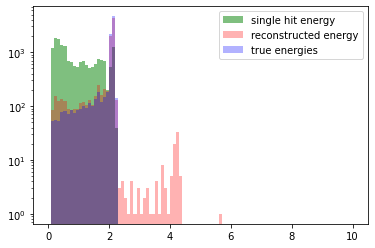

In [9]:
import networkx as nx
print(data)
ene_list = []
idx = 0
for i in range(int(np.min(data,axis=0)[0]),int(np.max(data,axis=0)[0])+1,3):
    mask = ((data[:,0] == i) | (data[:,0] == i+1) | (data[:,0] == i+2))
    evt = data[mask]
    print(evt)
    pair_indices = list(combinations(range(evt.shape[0]), 2))
    print("pair indices...")
    print(pair_indices)
    ##pair indices which belong together...
    pred_comb = []
    for m in range(evt.shape[0]):
        pred_comb.append((m,m))
    for j in range (len(pair_indices)):
        if eval_pred_h2[0][idx+j] > 0.75:
            pred_comb.append(pair_indices[j])
    G = nx.Graph()
    G.add_edges_from(pred_comb)
    connected_components = list(nx.connected_components(G))
    print("Connected components:", connected_components)
    print(type(connected_components))
    for k in range(len(connected_components)):
        print("this is type of k:")
        columns_to_sum = evt[list(connected_components[k]),1]
        ene = np.sum(columns_to_sum)
        ene_list.append(ene)
        print(ene)
        print(type(connected_components[k]))
    idx += len(pair_indices)
single_hit_energies = []
for i in range(data.shape[0]):
    single_hit_energies.append(data[i,1])
    
plt.hist(single_hit_energies,bins=100,range=(0,10),label="single hit energy",color="green",alpha=0.5)    
plt.hist(ene_list,bins=100,range=(0,10),label="reconstructed energy",color="red",alpha=0.3)
plt.hist(energy_spec,bins=100,range=(0,10),label="true energies",color="blue",alpha=0.3)
plt.legend()
plt.yscale('log')
plt.savefig("epoch100.png")
print(eval_pred_h2[0][1])

In [10]:
class feed_forward_model(nn.Module):
        def __init__(self,nodes):
                super().__init__()
                self.linear = torch.nn.Linear(12,nodes)
                #self.another_linear = torch.nn.Linear(100,100)
                self.activation = torch.nn.ReLU()
                self.linear_back = torch.nn.Linear(nodes,1)

        def forward(self, x):
                output_tensor = self.linear(x)
                #output_tensor = self.another_linear(output_tensor)
                output_tensor = self.activation(output_tensor)
                output_tensor = self.linear_back(output_tensor)
                output_tensor = torch.sigmoid(output_tensor)
                output_tensor = torch.squeeze(output_tensor)
                return output_tensor
def run_out_features(features):
    n_epochs = 10000                                             ##set default n_epochs = 1000
    loss_fn = nn.BCELoss()  # binary cross entropy
    loss_step_vals =[]
    model = feed_forward_model(int(features))
    #optimizer = optim.SGD(model.parameters(), lr=9e-3)  ##set default lr
    optimizer = optim.SGD(model.parameters(), lr=5e-3)
    model.train()
    loss_val = []
    for epoch in range(n_epochs):
        y_pred = model(input_data)
        y_true = truth_class
        loss = loss_fn(y_pred,y_true)
        loss_val.append(loss.detach().item())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    plt.plot(loss_val)
    print("this is latest loss val:\t",loss_val[-1])
    torch.save(model,"ff_scripted.pt")
    with torch.no_grad():
        model = torch.load("ff_scripted.pt")
        model.eval()
    eval_pred = model(input_data).detach().numpy()
    return eval_pred,loss_val[-1]





this is latest loss val:	 0.07283727079629898


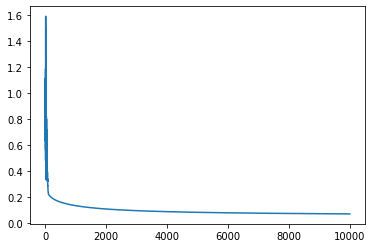

In [11]:
eval_pred_h2 = run_out_features(10000)
eval_true = truth_class.detach().numpy()



[[0.00000000e+00 4.88235000e-01 1.10095893e+00 6.23068580e+00
  2.89123963e-01]
 [1.00000000e+00 1.29252000e+00 6.91808373e-01 1.12018198e+00
  9.28225006e-01]
 [1.00000000e+00 4.22443000e-01 7.36274126e-01 1.12050313e+00
  9.03797111e-01]
 ...
 [8.85700000e+03 2.97576000e-01 1.01517949e+00 3.19430160e+00
  5.09072751e-01]
 [8.85700000e+03 1.22752000e-01 1.05914782e+00 3.09010544e+00
  4.95073066e-01]
 [8.85800000e+03 1.47413000e+00 1.33081879e+00 4.77077024e+00
  5.83929863e-01]]
[[0.         0.488235   1.10095893 6.2306858  0.28912396]
 [1.         1.29252    0.69180837 1.12018198 0.92822501]
 [1.         0.422443   0.73627413 1.12050313 0.90379711]
 [1.         0.417604   0.73593553 1.22209001 0.90042416]
 [2.         1.01595    0.89190514 1.91703474 0.64891465]
 [2.         0.553103   0.9309848  2.11134225 0.64793438]
 [2.         0.267183   1.01358076 2.02224319 0.64547825]
 [2.         0.190044   0.97311182 1.91776778 0.628375  ]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), 

[[225.           2.10449      1.28278035   5.84008112   0.64313589]
 [226.           1.56312      1.37779956   2.60809786   0.88192601]
 [226.           0.566431     1.4283251    2.50466965   0.86439608]
 [227.           2.17115      1.09899369   1.82638234   0.91332408]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1, 2}, {3}]
<class 'list'>
this is type of k:
2.10449
<class 'set'>
this is type of k:
2.129551
<class 'set'>
this is type of k:
2.17115
<class 'set'>
[[228.           0.786273     1.42805632   5.25530855   0.52563758]
 [228.           0.361501     1.47474213   5.45054108   0.48103589]
 [229.           1.35138      0.89190514   1.91703474   0.4567907 ]
 [229.           0.769615     0.89174282   1.82472428   0.44960707]
 [230.           0.758954     1.33096191   1.41962289   0.85006624]
 [230.           0.691663     1.37680298   1.62956854   0.86629097]
 [230.           0.381168     1.33085021   1.51247615   0.85683184]
 [230.

[[4.71000000e+02 1.52205000e+00 1.47488874e+00 2.99828367e+00
  2.95718882e-01]
 [4.71000000e+02 5.57188000e-01 1.47494633e+00 3.08980873e+00
  2.84049770e-01]
 [4.72000000e+02 1.07873000e+00 1.23695149e+00 1.91715692e+00
  7.71121957e-01]
 [4.72000000e+02 4.61060000e-01 1.18896017e+00 1.91658096e+00
  7.40571771e-01]
 [4.73000000e+02 1.70772000e+00 8.13529380e-01 4.77101459e+00
  5.34175859e-01]
 [4.73000000e+02 4.30115000e-01 8.50186531e-01 4.77232359e+00
  5.14931781e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
2.079238
<class 'set'>
this is type of k:
1.53979
<class 'set'>
this is type of k:
2.137835
<class 'set'>
[[4.74000000e+02 1.74527000e+00 1.47468977e+00 3.97421943e+00
  7.34251458e-01]
 [4.74000000e+02 3.31010000e-01 1.42814882e+00 3.97394017e+00
  6.91655808e-01]
 [4.75000000e+02 2.13480000e+00 9.3

[[7.23000000e+02 1.22777000e+00 6.09085002e-01 5.55444053e+00
  6.51363129e-01]
 [7.23000000e+02 6.92427000e-01 6.52728706e-01 5.55414383e+00
  6.69345989e-01]
 [7.24000000e+02 2.14473000e+00 1.19042800e+00 1.42362842e-01
  8.34192708e-01]
 [7.25000000e+02 1.07674000e+00 1.09848056e+00 4.77183489e+00
  3.81370776e-01]
 [7.25000000e+02 5.09021000e-01 9.72258349e-01 4.65404262e+00
  3.88894541e-01]
 [7.25000000e+02 5.03172000e-01 1.14475448e+00 4.77129384e+00
  3.91127493e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2}, {3, 4, 5}]
<class 'list'>
this is type of k:
1.920197
<class 'set'>
this is type of k:
2.14473
<class 'set'>
this is type of k:
2.088933
<class 'set'>
[[7.26000000e+02 6.89601000e-01 1.14647188e+00 3.87033743e+00
  2.63647970e-01]
 [7.27000000e+02 2.05473000e+00 6.06308184e-01 1.63031554e+00
  2.56832054e-01]
 [7.28000000e+02 2.15339000e+00 8.9

[[9.75000000e+02 1.27587000e+00 8.51073158e-01 5.05777219e+00
  3.29341154e-01]
 [9.75000000e+02 7.58442000e-01 9.73111815e-01 5.05936044e+00
  3.43375596e-01]
 [9.76000000e+02 1.43792000e+00 1.42832510e+00 2.50466965e+00
  1.69185711e-01]
 [9.76000000e+02 6.21287000e-01 1.37765645e+00 2.41277806e+00
  9.09273913e-02]
 [9.77000000e+02 1.77301000e+00 1.18917834e+00 5.16404528e+00
  3.76907062e-01]
 [9.77000000e+02 3.66401000e-01 1.18935811e+00 5.25396465e+00
  3.51920108e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 4, 5}, {2, 3}]
<class 'list'>
this is type of k:
4.173723
<class 'set'>
this is type of k:
2.0592070000000002
<class 'set'>
[[9.78000000e+02 2.14054000e+00 8.16026946e-01 6.36987581e-01
  9.45528463e-01]
 [9.79000000e+02 1.54565000e+00 7.75215913e-01 1.12085568e+00
  8.46938362e-01]
 [9.79000000e+02 1.73858000e-01 7.35603920e-01 1.31635874e+00
  8.08

[[1.22700000e+03 1.62460000e+00 1.33139824e+00 5.16282355e+00
  8.98966891e-01]
 [1.22700000e+03 2.82515000e-01 1.47464439e+00 5.25495948e+00
  8.96644228e-01]
 [1.22700000e+03 2.30099000e-01 1.42805632e+00 5.25530855e+00
  9.25743706e-01]
 [1.22800000e+03 1.75984000e+00 6.09882618e-01 5.94425982e+00
  6.48133500e-01]
 [1.22800000e+03 2.95145000e-01 6.09723793e-01 5.84311799e+00
  5.59913658e-01]
 [1.22900000e+03 1.26919000e+00 1.05888951e+00 3.58330058e+00
  7.41066281e-01]
 [1.22900000e+03 8.46690000e-01 1.05907626e+00 3.38819022e+00
  7.47674328e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3, 4}, {5, 6}]
<class 'list'>
this is type of k:
2.137214
<class 'set'>
this is type of k:
2.0549850000000003
<class 'set'>
this is type of k:
2.11588
<class 'set'>
[[1.23000000e+03 9.51235000e-01 1.37707351e+00 1.31591

[[1.48200000e+03 2.09760000e+00 1.23808247e+00 3.58403362e+00
  7.55866557e-01]
 [1.48300000e+03 2.14081000e+00 1.05776727e+00 2.11375080e+00
  6.38224711e-01]
 [1.48400000e+03 1.87817000e+00 5.20677094e-01 3.24168729e+00
  4.46371208e-01]
 [1.48400000e+03 2.57625000e-01 5.20731200e-01 3.43520939e+00
  4.32263464e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1}, {2, 3}]
<class 'list'>
this is type of k:
2.0976
<class 'set'>
this is type of k:
2.14081
<class 'set'>
this is type of k:
2.135795
<class 'set'>
[[1.48500000e+03 2.16240000e+00 8.93936699e-01 6.03578489e+00
  5.35371872e-01]
 [1.48600000e+03 2.10558000e+00 8.52155262e-01 8.34054452e-01
  6.42670920e-01]
 [1.48700000e+03 2.11864000e+00 6.07086600e-01 1.31505847e+00
  5.93924316e-01]]
pair indices...
[(0, 1), (0, 2), (1, 2)]
Connected components: [{0}, {1}, {2}]
<class 'list'>
this is type of k:
2.1624
<class 'set'>
this is type of k:
2.10558
<class 'set'>
this is type of k:


[[1.74900000e+03 1.64890000e+00 1.14686632e+00 5.84109341e+00
  5.98325560e-01]
 [1.74900000e+03 4.73861000e-01 1.10070760e+00 5.84046509e+00
  5.70568150e-01]
 [1.75000000e+03 1.74667000e+00 8.91419934e-01 4.56071987e+00
  2.07146975e-01]
 [1.75000000e+03 2.70349000e-01 9.29831140e-01 4.56227321e+00
  2.13873180e-01]
 [1.75000000e+03 1.04319000e-01 9.29590285e-01 4.65200059e+00
  1.93906811e-01]
 [1.75100000e+03 1.17020000e+00 6.51513956e-01 2.02175450e+00
  9.02133065e-01]
 [1.75100000e+03 9.70435000e-01 5.66676992e-01 2.02278424e+00
  9.02907650e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1}, {2, 3, 4}, {5, 6}]
<class 'list'>
this is type of k:
2.122761
<class 'set'>
this is type of k:
2.1213379999999997
<class 'set'>
this is type of k:
2.140635
<class 'set'>
[[1.75200000e+03 1.53314000e+00 6.09990828e-01 3.3867

[[2.02800000e+03 1.52097000e+00 8.16573234e-01 2.89496018e+00
  7.11041238e-01]
 [2.02900000e+03 2.10500000e+00 4.12759896e-01 5.21563722e+00
  7.57301947e-01]
 [2.03000000e+03 2.00361000e+00 8.51924878e-01 4.06473220e+00
  5.89149236e-01]
 [2.03000000e+03 2.02496000e-01 8.51650862e-01 4.17123219e+00
  5.45495095e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1}, {2, 3}]
<class 'list'>
this is type of k:
1.52097
<class 'set'>
this is type of k:
2.105
<class 'set'>
this is type of k:
2.206106
<class 'set'>
[[2.03100000e+03 2.09292000e+00 1.37785192e+00 3.58368455e+00
  9.31281775e-01]
 [2.03200000e+03 3.44432000e-01 1.33179094e+00 2.30941967e+00
  8.02501430e-01]
 [2.03300000e+03 2.15001000e+00 8.94123449e-01 2.99739355e+00
  3.69708228e-01]]
pair indices...
[(0, 1), (0, 2), (1, 2)]
Connected components: [{0}, {1}, {2}]
<class 'list'>
this is type of k:
2.09292
<class 'set'>
this is type of k:
0.344432
<class 'set'>
this is type of k:

[[2.30100000e+03 2.07606000e+00 9.32014547e-01 5.74996977e+00
  3.23833718e-01]
 [2.30200000e+03 1.61417000e+00 7.38331869e-01 3.19210248e+00
  6.34481974e-02]
 [2.30200000e+03 3.19743000e-01 6.93834700e-01 2.89614700e+00
  7.88611402e-02]
 [2.30200000e+03 1.30986000e-01 7.77196861e-01 3.09103047e+00
  6.73692640e-02]
 [2.30300000e+03 1.86462000e+00 8.51642135e-01 2.11197057e+00
  9.03417477e-01]
 [2.30300000e+03 2.66826000e-01 8.92474113e-01 2.11282578e+00
  8.53464356e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0}, {1, 2, 3}, {4, 5}]
<class 'list'>
this is type of k:
2.07606
<class 'set'>
this is type of k:
2.064899
<class 'set'>
this is type of k:
2.131446
<class 'set'>
[[2.30400000e+03 2.12089000e+00 1.05875338e+00 5.33803716e-01
  6.67631617e-02]
 [2.30500000e+03 2.11867000e+00 1.33220458e+00 3.48039597e+00
  2.59086886e-01]
 [2.30600000e+03 9.70779000e-01 1.0

[[2.57100000e+03 1.64202000e+00 1.42845251e+00 5.15069352e-02
  8.49823366e-01]
 [2.57100000e+03 2.08116000e-01 1.47494110e+00 1.43284899e-01
  8.53426065e-01]
 [2.57200000e+03 1.25131000e+00 8.14168171e-01 4.45762327e+00
  6.07237563e-01]
 [2.57200000e+03 8.59638000e-01 7.35244382e-01 4.55967267e+00
  6.15265028e-01]
 [2.57300000e+03 1.09451000e+00 8.53197224e-01 6.23009239e+00
  4.41208726e-01]
 [2.57300000e+03 5.39241000e-01 8.16669228e-01 6.23161083e+00
  5.18022575e-01]
 [2.57300000e+03 5.07464000e-01 8.94030947e-01 6.23086034e+00
  4.64301883e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1}, {2, 3}, {4, 5, 6}]
<class 'list'>
this is type of k:
1.850136
<class 'set'>
this is type of k:
2.110948
<class 'set'>
this is type of k:
2.1412150000000003
<class 'set'>
[[2.57400000e+03 1.43495000e+00 1.23825874e+00 2.9987

[[2.84100000e+03 1.12350000e+00 5.20731200e-01 3.43520939e+00
  5.41820955e-01]
 [2.84100000e+03 4.85983000e-01 4.14922359e-01 2.85214725e+00
  5.45421684e-01]
 [2.84100000e+03 4.64032000e-01 5.20677094e-01 3.24168729e+00
  5.68986157e-01]
 [2.84200000e+03 7.04516000e-01 6.92714199e-01 2.31092065e+00
  8.15160655e-01]
 [2.84200000e+03 5.21372000e-01 5.68445011e-01 2.60823749e+00
  7.96566222e-01]
 [2.84200000e+03 3.77335000e-01 6.53346552e-01 2.70128099e+00
  8.27863642e-01]
 [2.84200000e+03 3.13407000e-01 6.52445962e-01 2.31111264e+00
  8.00172203e-01]
 [2.84200000e+03 2.09690000e-01 6.53179001e-01 2.60762662e+00
  7.77941156e-01]
 [2.84300000e+03 1.14420000e+00 6.06304693e-01 1.51114272e+00
  8.91388423e-01]
 [2.84300000e+03 9.50444000e-01 6.50405672e-01 1.41736792e+00
  8.51091367e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (0, 8), (0, 9), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (1, 9), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8)

[[3.11700000e+03 1.87620000e+00 1.42842633e+00 3.38817277e+00
  1.98581677e-01]
 [3.11700000e+03 3.38634000e-01 1.28276115e+00 3.58469684e+00
  2.08069258e-01]
 [3.11800000e+03 1.85719000e+00 4.75659817e-01 2.65790956e+00
  2.97541566e-01]
 [3.11800000e+03 2.76332000e-01 4.74972157e-01 2.46431764e+00
  2.94500113e-01]
 [3.11900000e+03 2.19753000e+00 7.38125921e-01 3.48084975e+00
  3.79162988e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.214834
<class 'set'>
this is type of k:
2.133522
<class 'set'>
this is type of k:
2.19753
<class 'set'>
[[3.12000000e+03 1.80321000e+00 9.31220422e-01 5.35912073e+00
  7.03813959e-01]
 [3.12000000e+03 2.46673000e-01 8.92978513e-01 5.45000003e+00
  7.21661158e-01]
 [3.12100000e+03 1.02428000e+00 5.18027685e-01 1.26774608e+00
  8.50643902e-01]
 [3.12200000e+03 1.74686000e+00 1.10009499e+00 2.30821539e+00
  4.94618566e-01

[[3.38100000e+03 1.39336000e+00 7.38298708e-01 6.13877676e+00
  2.02968808e-01]
 [3.38100000e+03 7.76007000e-01 7.38328379e-01 6.23255331e+00
  2.08942308e-01]
 [3.38200000e+03 9.56990000e-01 4.73209375e-01 1.26700781e+00
  3.64758757e-01]
 [3.38200000e+03 6.72318000e-01 4.73867364e-01 1.07256766e+00
  2.74852112e-01]
 [3.38200000e+03 4.75746000e-01 5.18027685e-01 1.26774608e+00
  3.19970636e-01]
 [3.38300000e+03 1.74320000e+00 1.14707751e+00 6.14005086e+00
  7.95251177e-01]
 [3.38300000e+03 3.72583000e-01 1.14710194e+00 6.23129667e+00
  7.89087313e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1}, {2, 3, 4}, {5, 6}]
<class 'list'>
this is type of k:
2.169367
<class 'set'>
this is type of k:
2.105054
<class 'set'>
this is type of k:
2.115783
<class 'set'>
[[3.38400000e+03 1.45059000e+00 1.18935636e+00 4.17083077e+00
 

[[3.63600000e+03 1.51286000e+00 4.73209375e-01 1.26700781e+00
  9.85353985e-02]
 [3.63600000e+03 6.52025000e-01 4.11934355e-01 1.26607231e+00
  1.39747078e-01]
 [3.63700000e+03 2.14112000e+00 6.53179001e-01 5.74921928e+00
  1.24013579e-01]
 [3.63800000e+03 2.16321000e+00 5.67366397e-01 4.06483692e+00
  2.58889957e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0, 1}, {2}, {3}]
<class 'list'>
this is type of k:
2.164885
<class 'set'>
this is type of k:
2.14112
<class 'set'>
this is type of k:
2.16321
<class 'set'>
[[3.63900000e+03 1.37785000e+00 1.33176127e+00 8.32230583e-01
  5.66242395e-01]
 [3.63900000e+03 3.46832000e-01 1.28224802e+00 9.23362950e-01
  5.68270103e-01]
 [3.63900000e+03 2.72254000e-01 1.23748905e+00 9.23938909e-01
  5.69540620e-01]
 [3.64000000e+03 1.84358000e+00 1.28248190e+00 5.55531320e+00
  6.01923117e-02]
 [3.64000000e+03 2.97198000e-01 1.28237020e+00 5.44940662e+00
  8.64921223e-02]
 [3.64100000e+03 1.91107000e+00 6.

[[3.88500000e+03 2.13497000e+00 1.05906579e+00 6.03664010e+00
  2.39145680e-01]
 [3.88600000e+03 1.46170000e+00 8.14176897e-01 1.82557949e+00
  4.49838573e-01]
 [3.88700000e+03 1.70081000e+00 1.14498486e+00 1.72148107e+00
  1.87353466e-01]
 [3.88700000e+03 4.43016000e-01 5.17915984e-01 1.87680490e+00
  2.37837199e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1}, {2}, {3}]
<class 'list'>
this is type of k:
2.13497
<class 'set'>
this is type of k:
1.4617
<class 'set'>
this is type of k:
1.70081
<class 'set'>
this is type of k:
0.443016
<class 'set'>
[[3.88800000e+03 1.20593000e+00 8.14463131e-01 1.91788996e+00
  2.48675929e-01]
 [3.88800000e+03 6.74831000e-01 9.29859066e-01 1.71948616e+00
  2.63602020e-01]
 [3.88800000e+03 2.44961000e-01 8.91742820e-01 1.82472428e+00
  3.17760660e-01]
 [3.88900000e+03 7.82069000e-01 1.33114691e+00 4.45791998e+00
  6.13150234e-01]
 [3.88900000e+03 7.22248000e-01 1.37707351e+00 4.45750110e+00
  6.097245

pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0}, {1, 2}, {3}]
<class 'list'>
this is type of k:
2.17601
<class 'set'>
this is type of k:
2.165276
<class 'set'>
this is type of k:
2.14151
<class 'set'>
[[4.14300000e+03 1.73148000e+00 7.73891208e-01 1.51286710e+00
  3.88369399e-01]
 [4.14300000e+03 4.38251000e-01 6.50035663e-01 1.51161396e+00
  3.86506236e-01]
 [4.14400000e+03 2.15962000e+00 7.37408590e-01 2.41195776e+00
  6.10854484e-01]
 [4.14500000e+03 1.84466000e+00 1.33187297e+00 2.41237664e+00
  5.51295079e-01]
 [4.14500000e+03 2.90550000e-01 1.37759536e+00 2.30889607e+00
  5.54554903e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
2.169731
<class 'set'>
this is type of k:
2.15962
<class 'set'>
this is type of k:
2.13521
<class 'set'>
[[4.14600000e+03 1.07283000e+00 9.74340527e-01 2.41239409e+00
  6.04953629

[[4.38600000e+03 1.82864000e+00 5.66284293e-01 5.06253693e+00
  5.33391427e-01]
 [4.38700000e+03 2.15968000e+00 1.23801614e+00 3.67473838e+00
  8.30918223e-01]
 [4.38800000e+03 9.94086000e-01 1.01250564e+00 4.65303033e+00
  3.03844374e-01]
 [4.38800000e+03 8.91337000e-01 9.29831140e-01 4.56227321e+00
  3.03155124e-01]
 [4.38800000e+03 2.75362000e-01 9.72539347e-01 4.56147036e+00
  2.90943364e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0}, {1}, {2, 3, 4}]
<class 'list'>
this is type of k:
1.82864
<class 'set'>
this is type of k:
2.15968
<class 'set'>
this is type of k:
2.160785
<class 'set'>
[[4.38900000e+03 1.11371000e+00 1.28207174e+00 4.17095294e+00
  2.48623415e-01]
 [4.38900000e+03 4.97920000e-01 1.28224802e+00 4.06495909e+00
  2.25264404e-01]
 [4.38900000e+03 4.80713000e-01 1.28195132e+00 4.26064541e+00
  2.20511861e-01]
 [4.39000000e+03 1.13781000e+00 1.33142791e+00 4.26202422e+00
  2.37277047e-01]

[[4.64100000e+03 1.72140000e+00 5.19521686e-01 2.26561190e+00
  8.35064664e-01]
 [4.64100000e+03 4.06108000e-01 5.67017331e-01 2.11652588e+00
  8.31817530e-01]
 [4.64200000e+03 1.84974000e+00 8.15578397e-01 5.45083779e+00
  2.39496869e-01]
 [4.64200000e+03 2.96287000e-01 7.76055416e-01 5.45205952e+00
  2.55791615e-01]
 [4.64300000e+03 1.11340000e-01 1.37730040e+00 4.26160534e+00
  1.09890519e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.127508
<class 'set'>
this is type of k:
2.146027
<class 'set'>
this is type of k:
0.11134
<class 'set'>
[[4.64400000e+03 2.05003000e+00 6.51143947e-01 5.06164682e+00
  8.56200570e-01]
 [4.64500000e+03 1.58583000e+00 1.01509396e+00 2.89377335e+00
  5.00122358e-01]
 [4.64500000e+03 4.75768000e-01 9.75015969e-01 2.89497763e+00
  4.26759858e-01]
 [4.64600000e+03 2.12701000e+00 8.16492949e-01 5.94464379e+00
  2.92017719e-01

[[4.89300000e+03 1.70200000e+00 1.37707351e+00 1.31591019e+00
  8.17019442e-01]
 [4.89300000e+03 4.04473000e-01 1.47447684e+00 1.31594509e+00
  8.14793055e-01]
 [4.89400000e+03 9.39023000e-01 8.15341032e-01 9.24476470e-01
  3.49631361e-01]
 [4.89400000e+03 6.57205000e-01 8.51650862e-01 1.02964827e+00
  3.93302459e-01]
 [4.89400000e+03 4.79061000e-01 9.31258820e-01 9.22643874e-01
  4.01716342e-01]
 [4.89500000e+03 2.09370000e+00 9.31220422e-01 5.35912073e+00
  5.06753479e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3, 4}, {5}]
<class 'list'>
this is type of k:
2.106473
<class 'set'>
this is type of k:
2.075289
<class 'set'>
this is type of k:
2.0937
<class 'set'>
[[4.89600000e+03 1.21016000e+00 1.33155183e+00 2.11385552e+00
  6.78907965e-01]
 [4.89700000e+03 1.52261000e+00 7.75804088e-01 2.21625399e+00
  8.20796095e-01]
 [4.89700000e+03 4.09828000e-01 8.51

[[5.15100000e+03 1.79261000e+00 1.01462098e+00 2.50329084e+00
  3.93127412e-01]
 [5.15100000e+03 2.19659000e-01 9.74689593e-01 2.60771389e+00
  3.70477344e-01]
 [5.15100000e+03 1.36868000e-01 9.74515060e-01 2.50456493e+00
  3.69437999e-01]
 [5.15200000e+03 2.15227000e+00 7.38125921e-01 3.39265827e-01
  4.83407674e-01]
 [5.15300000e+03 1.87297000e+00 9.72258349e-01 4.65404262e+00
  7.06202265e-01]
 [5.15300000e+03 2.19496000e-01 9.72261840e-01 4.77075279e+00
  7.09625540e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1, 2}, {3}, {4, 5}]
<class 'list'>
this is type of k:
2.1491369999999996
<class 'set'>
this is type of k:
2.15227
<class 'set'>
this is type of k:
2.092466
<class 'set'>
[[5.15400000e+03 2.11925000e+00 9.75017715e-01 2.46622005e-01
  2.16774594e-01]
 [5.15500000e+03 1.25528000e+00 1.42827099e+00 3.87075631e+00
  7.68561885e-01]
 [5.15500000e+03 5.411170

[[5.40300000e+03 1.74558000e+00 9.32265875e-01 2.80359219e+00
  9.52876087e-01]
 [5.40300000e+03 3.57677000e-01 8.53029672e-01 2.80449976e+00
  9.44865470e-01]
 [5.40400000e+03 1.83975000e+00 1.33096191e+00 1.41962289e+00
  8.94941890e-01]
 [5.40400000e+03 2.51662000e-01 8.51642135e-01 5.25356322e+00
  8.67412370e-01]
 [5.40500000e+03 2.16606000e+00 1.33224472e+00 2.99795206e+00
  4.92006888e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3}, {4}]
<class 'list'>
this is type of k:
2.103257
<class 'set'>
this is type of k:
1.83975
<class 'set'>
this is type of k:
0.251662
<class 'set'>
this is type of k:
2.16606
<class 'set'>
[[5.40600000e+03 2.37040000e-01 1.14647188e+00 3.87033743e+00
  9.04160335e-01]
 [5.40600000e+03 1.57210000e-01 1.14628687e+00 3.97434160e+00
  8.55752010e-01]
 [5.40700000e+03 2.13298000e+00 6.50037408e-01 4.77145092e+00
  7.50293478e-01]
 [5.40800000e+03 1.03954000e+00 1.1

[[5.67600000e+03 1.88540000e+00 8.50177804e-01 4.65247183e+00
  6.71570188e-02]
 [5.67600000e+03 2.71844000e-01 8.13520654e-01 4.65378082e+00
  6.51494414e-02]
 [5.67700000e+03 1.78597000e+00 5.18806101e-01 5.21298432e+00
  5.28798178e-01]
 [5.67700000e+03 2.79808000e-01 4.74006990e-01 5.21382207e+00
  5.35362573e-01]
 [5.67800000e+03 1.45259000e+00 1.47473515e+00 2.41269080e+00
  1.82976181e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.157244
<class 'set'>
this is type of k:
2.065778
<class 'set'>
this is type of k:
1.45259
<class 'set'>
[[5.67900000e+03 1.20247000e+00 1.33214524e+00 2.70005926e+00
  8.24103401e-01]
 [5.67900000e+03 5.22017000e-01 1.37779956e+00 2.60809786e+00
  8.19180186e-01]
 [5.67900000e+03 3.97674000e-01 1.14686632e+00 2.69950075e+00
  8.05925800e-01]
 [5.68000000e+03 2.73956000e-01 1.18918009e+00 4.26075013e+00
  3.22034010e-01

[[5.93400000e+03 1.40085000e+00 6.93211618e-01 6.35319046e-01
  9.03136306e-02]
 [5.93400000e+03 5.98380000e-01 6.52959089e-01 6.35177675e-01
  7.49619545e-02]
 [5.93500000e+03 1.03300000e+00 7.77196861e-01 6.23262312e+00
  4.33994685e-01]
 [5.93500000e+03 5.69498000e-01 8.53197224e-01 6.23009239e+00
  4.03162016e-01]
 [5.93500000e+03 5.64103000e-01 8.53205950e-01 5.31183977e-02
  4.23646526e-01]
 [5.93600000e+03 1.97828000e-01 4.12759896e-01 5.21563722e+00
  4.10470911e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3, 4}, {5}]
<class 'list'>
this is type of k:
1.9992299999999998
<class 'set'>
this is type of k:
2.166601
<class 'set'>
this is type of k:
0.197828
<class 'set'>
[[5.93700000e+03 5.03479000e-01 1.01478679e+00 5.32803642e-01
  1.58160993e-01]
 [5.93800000e+03 1.48555000e+00 1.14647013e+00 2.41288278e+00
  1.08055801e-01]
 [5.93800000e+03 6.68396

2.143126
<class 'set'>
this is type of k:
2.08664
<class 'set'>
[[6.19800000e+03 1.42458000e+00 6.91111987e-01 1.31600967e+00
  1.29268290e-01]
 [6.19800000e+03 7.36570000e-01 6.50793135e-01 1.31551225e+00
  1.43763327e-01]
 [6.19900000e+03 2.07736000e+00 7.37145046e-01 2.31060649e+00
  2.05931489e-01]
 [6.20000000e+03 1.77353000e+00 1.23778227e+00 3.87005818e+00
  6.88442590e-01]
 [6.20000000e+03 4.16488000e-01 1.33190264e+00 3.87087848e+00
  7.01665250e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
2.16115
<class 'set'>
this is type of k:
2.07736
<class 'set'>
this is type of k:
2.1900180000000002
<class 'set'>
[[6.20100000e+03 5.39599000e-01 1.23693055e+00 4.36604584e+00
  1.97176920e-01]
 [6.20100000e+03 2.70345000e-01 1.28195132e+00 4.26064541e+00
  2.27583785e-01]
 [6.20100000e+03 2.13120000e-01 1.28175759e+00 4.36676143e+00
  1.97194424e-01]
 [6.2

[[6.44400000e+03 1.23814000e+00 9.72261840e-01 1.62915141e+00
  4.44253570e-01]
 [6.44400000e+03 2.06538000e-01 1.01250739e+00 1.63016719e+00
  4.65895910e-01]
 [6.44500000e+03 1.61979000e+00 1.10029221e+00 7.28196742e-01
  4.91967502e-01]
 [6.44500000e+03 3.74753000e-01 1.10045278e+00 6.38038269e-01
  4.88462064e-01]
 [6.44600000e+03 1.10659000e+00 8.51389062e-01 4.26041852e+00
  3.56766739e-01]
 [6.44600000e+03 1.39479000e-01 9.30747438e-01 4.25992983e+00
  3.53346746e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0, 1}, {2, 3}, {4, 5}]
<class 'list'>
this is type of k:
1.4446780000000001
<class 'set'>
this is type of k:
1.9945430000000002
<class 'set'>
this is type of k:
1.2460689999999999
<class 'set'>
[[6.44700000e+03 1.09658000e+00 1.09848056e+00 4.77183489e+00
  6.86253401e-01]
 [6.44700000e+03 1.06097000e+00 1.05645303e+00 4.65386809e+00
  7.32606010e-01]
 [6.

[[6.69900000e+03 1.17958000e+00 4.14922359e-01 5.99373990e+00
  5.47422697e-01]
 [6.69900000e+03 4.97120000e-01 6.53683401e-01 6.13895130e+00
  5.60828719e-01]
 [6.69900000e+03 4.00974000e-01 5.21045359e-01 6.18591811e+00
  5.51167622e-01]
 [6.70000000e+03 1.19589000e+00 1.23825874e+00 6.14034756e+00
  4.33133451e-01]
 [6.70000000e+03 8.50913000e-01 1.14710194e+00 6.23129667e+00
  4.08880056e-01]
 [6.70100000e+03 1.41644000e+00 9.30442006e-01 1.91553376e+00
  7.31962710e-01]
 [6.70100000e+03 6.05207000e-01 8.50807868e-01 1.82688849e+00
  7.46546365e-01]
 [6.70100000e+03 1.19663000e-01 8.91742820e-01 1.82472428e+00
  7.53543894e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (0, 7), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (3, 4), (3, 5), (3, 6), (3, 7), (4, 5), (4, 6), (4, 7), (5, 6), (5, 7), (6, 7)]
Connected components: [{0, 1, 2}, {3, 4}, {5, 6, 7}]
<class 'list'>
this is type of k:
2.077674
<class 'set'>
this is 

[[6.95100000e+03 1.33905000e+00 1.14686283e+00 3.58371946e+00
  9.73610477e-01]
 [6.95100000e+03 7.72733000e-01 1.14675986e+00 3.67503509e+00
  9.64597713e-01]
 [6.95200000e+03 2.11963000e+00 7.38331869e-01 5.05112248e-02
  3.01984493e-01]
 [6.95300000e+03 1.26024000e+00 1.28283096e+00 2.80423796e+00
  2.30069461e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
Connected components: [{0, 1}, {2}, {3}]
<class 'list'>
this is type of k:
2.111783
<class 'set'>
this is type of k:
2.11963
<class 'set'>
this is type of k:
1.26024
<class 'set'>
[[6.95400000e+03 1.28153000e+00 8.91117992e-01 1.62858069e+00
  7.05513015e-01]
 [6.95400000e+03 5.64794000e-01 9.72261840e-01 1.62915141e+00
  7.08976770e-01]
 [6.95400000e+03 2.35467000e-01 9.29551888e-01 1.62976926e+00
  7.22896338e-01]
 [6.95500000e+03 2.10935000e+00 1.28193212e+00 5.16413255e+00
  8.07784586e-01]
 [6.95600000e+03 2.17551000e+00 8.16484223e-01 3.48015162e+00
  6.27536960e-01]]
pair indices...
[(0, 1), (0, 2), 

this is type of k:
1.765276
<class 'set'>
this is type of k:
1.4931
<class 'set'>
this is type of k:
2.06681
<class 'set'>
[[7.20900000e+03 1.78917000e+00 1.37718172e+00 1.91752344e+00
  5.07931900e-01]
 [7.20900000e+03 3.32542000e-01 1.37704384e+00 1.82571912e+00
  4.40996918e-01]
 [7.21000000e+03 1.69193000e+00 1.47487652e+00 2.46840171e-01
  5.53749575e-01]
 [7.21000000e+03 4.38280000e-01 1.42842633e+00 2.46578371e-01
  5.88598602e-01]
 [7.21100000e+03 1.62577000e+00 4.17423416e-01 1.68349049e+00
  6.23592918e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.121712
<class 'set'>
this is type of k:
2.13021
<class 'set'>
this is type of k:
1.62577
<class 'set'>
[[7.21200000e+03 1.51778000e+00 6.10071113e-01 2.99739355e+00
  6.93206074e-01]
 [7.21200000e+03 5.94525000e-01 6.93911495e-01 2.99720156e+00
  6.83595959e-01]
 [7.21300000e+03 1.59767000e+00 1.19

[[7.46100000e+03 1.82568000e+00 1.47435990e+00 4.56162744e+00
  8.95848855e-01]
 [7.46100000e+03 3.00506000e-01 1.42766013e+00 4.56133073e+00
  8.92202394e-01]
 [7.46200000e+03 1.05757000e+00 1.09898322e+00 4.45685532e+00
  6.39415035e-01]
 [7.46200000e+03 1.03625000e+00 1.05672879e+00 4.56129583e+00
  6.43056025e-01]
 [7.46300000e+03 2.13105000e+00 9.30183697e-01 1.31425213e+00
  6.32763225e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.126186
<class 'set'>
this is type of k:
2.09382
<class 'set'>
this is type of k:
2.13105
<class 'set'>
[[7.46400000e+03 1.22098000e+00 7.77163700e-01 3.28601865e+00
  9.24774380e-01]
 [7.46400000e+03 9.43392000e-01 8.16639557e-01 3.28507617e+00
  9.24041368e-01]
 [7.46500000e+03 1.20630000e+00 8.52567160e-01 2.50297668e+00
  9.13614000e-01]
 [7.46500000e+03 5.22113000e-01 7.37408590e-01 2.41195776e+00
  8.92462778e-01]

[[7.71300000e+03 1.82486000e-01 1.05907626e+00 3.38819022e+00
  3.37568392e-02]
 [7.71400000e+03 1.03830000e+00 1.42800396e+00 4.16950432e+00
  4.71375229e-01]
 [7.71400000e+03 2.24570000e-01 1.37737196e+00 4.16990574e+00
  4.45029468e-01]
 [7.71500000e+03 1.62101000e+00 1.14523968e+00 1.31578103e+00
  5.53212288e-01]
 [7.71500000e+03 3.24531000e-01 1.23654309e+00 1.42048334e+00
  5.84541873e-01]
 [7.71500000e+03 1.90413000e-01 1.18876644e+00 1.31507243e+00
  5.74553218e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (1, 2), (1, 3), (1, 4), (1, 5), (2, 3), (2, 4), (2, 5), (3, 4), (3, 5), (4, 5)]
Connected components: [{0}, {1, 2}, {3, 4, 5}]
<class 'list'>
this is type of k:
0.182486
<class 'set'>
this is type of k:
1.26287
<class 'set'>
this is type of k:
2.135954
<class 'set'>
[[7.71600000e+03 1.71770000e+00 1.42805632e+00 5.25530855e+00
  9.52685723e-01]
 [7.71600000e+03 4.12803000e-01 1.33155183e+00 5.25544818e+00
  9.36544144e-01]
 [7.71700000e+03 1.54746000e+00 1.1

[[7.95600000e+03 2.09392000e+00 1.18876644e+00 1.31507243e+00
  8.33103036e-01]
 [7.95700000e+03 1.02043000e+00 5.18027685e-01 4.40933001e+00
  5.09054896e-01]
 [7.95700000e+03 5.24584000e-01 5.18669966e-01 4.21474325e+00
  5.08670163e-01]
 [7.95700000e+03 3.10184000e-01 5.17240541e-01 4.60424838e+00
  5.02204090e-01]
 [7.95700000e+03 2.10914000e-01 8.93706315e-01 2.60710302e+00
  5.20329155e-01]
 [7.95800000e+03 1.79057000e+00 1.37793046e+00 3.47994218e+00
  4.36100399e-01]
 [7.95800000e+03 3.71962000e-01 1.42845425e+00 3.48027379e+00
  3.85568637e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0}, {1, 2, 3}, {4}, {5, 6}]
<class 'list'>
this is type of k:
2.09392
<class 'set'>
this is type of k:
1.8551980000000001
<class 'set'>
this is type of k:
0.210914
<class 'set'>
this is type of k:
2.162532
<class 'set'>
[[7.959000

[[8.20200000e+03 1.65626000e+00 1.18852908e+00 4.56267464e+00
  2.38060385e-01]
 [8.20200000e+03 4.15386000e-01 1.14475622e+00 4.65351902e+00
  2.47079713e-01]
 [8.20300000e+03 1.67368000e+00 1.47464439e+00 5.35880658e+00
  2.74896968e-01]
 [8.20300000e+03 4.25216000e-01 1.42832510e+00 5.64626230e+00
  2.36161118e-01]
 [8.20400000e+03 1.00430000e+00 1.42827099e+00 3.87075631e+00
  9.13367840e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2, 3}, {4}]
<class 'list'>
this is type of k:
2.071646
<class 'set'>
this is type of k:
2.098896
<class 'set'>
this is type of k:
1.0043
<class 'set'>
[[8.20500000e+03 2.15964000e+00 1.14498486e+00 1.72148107e+00
  3.89787284e-02]
 [8.20600000e+03 1.61508000e+00 1.42849789e+00 3.28518089e+00
  3.37846280e-01]
 [8.20700000e+03 4.97151000e-01 1.14589941e+00 5.25488967e+00
  3.24592987e-01]]
pair indices...
[(0, 1), (0, 2), (1, 2)]
Connected components: [{0}, {1}, {2}]

[[8.46000000e+03 1.58677000e+00 9.72539347e-01 1.41987596e+00
  5.31097756e-01]
 [8.46000000e+03 3.06032000e-01 9.72844780e-01 1.31630463e+00
  5.09547393e-01]
 [8.46000000e+03 2.55858000e-01 1.01305542e+00 1.31528711e+00
  5.22881787e-01]
 [8.46100000e+03 2.16332000e+00 4.20205471e-01 5.40996218e+00
  4.80189423e-01]
 [8.46200000e+03 1.42975000e+00 5.18669966e-01 1.07315234e+00
  6.46591987e-01]
 [8.46200000e+03 4.10174000e-01 5.67366397e-01 9.23247758e-01
  6.55751354e-01]
 [8.46200000e+03 3.47248000e-01 5.19144695e-01 8.78809930e-01
  6.53517308e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5), (0, 6), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (2, 3), (2, 4), (2, 5), (2, 6), (3, 4), (3, 5), (3, 6), (4, 5), (4, 6), (5, 6)]
Connected components: [{0, 1, 2}, {3}, {4, 5, 6}]
<class 'list'>
this is type of k:
2.14866
<class 'set'>
this is type of k:
2.16332
<class 'set'>
this is type of k:
2.1871720000000003
<class 'set'>
[[8.46300000e+03 1.52646000e+00 1.37737196e+00 1.028313

[[8.72400000e+03 1.50788000e+00 7.34902297e-01 1.62899433e+00
  8.02534252e-01]
 [8.72400000e+03 7.12285000e-01 6.06304693e-01 1.51114272e+00
  8.43728427e-01]
 [8.72500000e+03 1.92973000e+00 4.73867364e-01 4.21416729e+00
  3.39746640e-01]
 [8.72600000e+03 1.54497000e+00 5.20420531e-01 2.65733360e+00
  7.27940991e-01]
 [8.72600000e+03 5.74915000e-01 5.68445011e-01 2.60823749e+00
  7.31712174e-01]]
pair indices...
[(0, 1), (0, 2), (0, 3), (0, 4), (1, 2), (1, 3), (1, 4), (2, 3), (2, 4), (3, 4)]
Connected components: [{0, 1}, {2}, {3, 4}]
<class 'list'>
this is type of k:
2.220165
<class 'set'>
this is type of k:
1.92973
<class 'set'>
this is type of k:
2.119885
<class 'set'>
[[8.72700000e+03 1.41543000e+00 8.16669228e-01 3.09001817e+00
  3.65567258e-01]
 [8.72700000e+03 6.66288000e-01 8.16648284e-01 2.99812659e+00
  3.72389739e-01]
 [8.72800000e+03 2.07729000e+00 5.19144695e-01 8.78809930e-01
  4.04319847e-01]
 [8.72900000e+03 1.11982000e+00 1.05876559e+00 5.74942872e+00
  8.22052061e-01

1.4912633e-05


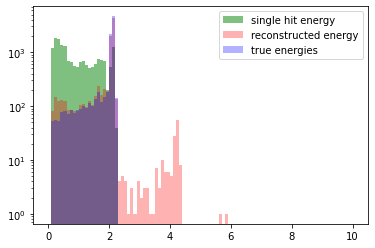

In [12]:
import networkx as nx
print(data)
ene_list = []
idx = 0
for i in range(int(np.min(data,axis=0)[0]),int(np.max(data,axis=0)[0])+1,3):
    mask = ((data[:,0] == i) | (data[:,0] == i+1) | (data[:,0] == i+2))
    evt = data[mask]
    print(evt)
    pair_indices = list(combinations(range(evt.shape[0]), 2))
    print("pair indices...")
    print(pair_indices)
    ##pair indices which belong together...
    pred_comb = []
    for m in range(evt.shape[0]):
        pred_comb.append((m,m))
    for j in range (len(pair_indices)):
        if eval_pred_h2[0][idx+j] > 0.65:
            pred_comb.append(pair_indices[j])
    G = nx.Graph()
    G.add_edges_from(pred_comb)
    connected_components = list(nx.connected_components(G))
    print("Connected components:", connected_components)
    print(type(connected_components))
    for k in range(len(connected_components)):
        print("this is type of k:")
        columns_to_sum = evt[list(connected_components[k]),1]
        ene = np.sum(columns_to_sum)
        ene_list.append(ene)
        print(ene)
        print(type(connected_components[k]))
    idx += len(pair_indices)
single_hit_energies = []
for i in range(data.shape[0]):
    single_hit_energies.append(data[i,1])
    
plt.hist(single_hit_energies,bins=100,range=(0,10),label="single hit energy",color="green",alpha=0.5)    
plt.hist(ene_list,bins=100,range=(0,10),label="reconstructed energy",color="red",alpha=0.3)
plt.hist(energy_spec,bins=100,range=(0,10),label="true energies",color="blue",alpha=0.3)
plt.legend()
plt.yscale('log')
plt.savefig("epoch100.png")
print(eval_pred_h2[0][1])

[5.3176481e-09 1.4912633e-05 1.2983098e-05 ... 9.6649808e-01 2.0995903e-07
 8.7435275e-08]


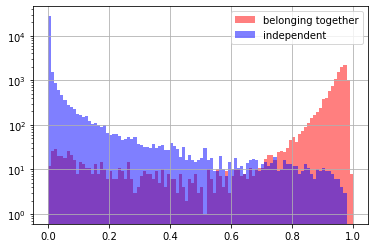

In [13]:
eval_true = eval_true.astype(int)
pred_binaries = eval_pred_h2[0]
print(pred_binaries)

plt.hist(pred_binaries[eval_true == True],bins=100,range=(0,1),label="belonging together",color="red",alpha=0.5)
plt.hist(pred_binaries[eval_true == False],bins=100,range=(0,1),label="independent",color="blue",alpha=0.5)
plt.yscale("log")
plt.grid()
plt.legend()
plt.savefig("pred_val_distr_single_layer12_features.png")

In [14]:
eval_true.shape
eval_true = eval_true.astype(int)
print(eval_true)

[0 0 0 ... 1 0 0]
